In [1]:
import os
import sys
import pickle
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from scipy.linalg import block_diag

module_path = os.path.abspath(os.path.join('../../src'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = os.path.abspath(os.path.join('../../data'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from dynamics import Dynamics
from utils import get_form_initial_conditions
from gauss_newton import GaussNewton

In [2]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [3]:
# Simulation parameters
dt = 60.0  # Time step [s]
K = 395  # Duration [min]
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6 
n_p = 3  
n = N * n_x
o = 3 + 3 + 2 + 1 
H = 30 # Window size [min]
invalid_rmse = 1e20 # [m]
grad_norm_order_mag = True
grad_norm_tol = 1e-6
max_iterations = 20
dyn = Dynamics()

In [4]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P_0 = np.diag(np.concatenate([p_pos_initial * np.ones(3), p_vel_initial * np.ones(3)])) ** 2
P_0 = block_diag(P_0, P_0, P_0, P_0)

In [5]:
def plots(k, algorithm_class):
    iterations = np.arange(0, algorithm_class.iterations + 1)

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Plot 1
    axs[0].semilogy(iterations, 1 / H * np.array(algorithm_class.cost_values), '.-')
    axs[0].set_xlabel(r'$n$')
    axs[0].set_ylabel(r'$\frac{1}{H}J(x_n)$')
    axs[0].set_title('Normalized Cost Function') 
    axs[0].grid()

    # Plot 2
    axs[1].semilogy(iterations, 1 / H * np.array(algorithm_class.gradient_norm_values), '.-')
    axs[1].set_xlabel(r'$n$')
    axs[1].set_ylabel(r'$\frac{1}{H}||\nabla J(x_n)||_2$')
    axs[1].set_title('Normalized Gradient Norm')
    axs[1].grid()
    
    fig.suptitle(f'Solving MHE problem J(k) with k = {k}', fontsize=14)

    plt.tight_layout()
    plt.show()

In [6]:
# Seed for reproducibility
np.random.seed(42)

# Initial conditions for the state vector and true state vectors
X_initial = get_form_initial_conditions(formation)
with open(f"../../data/tudatpy_form{formation}.pkl", "rb") as file:
    X_true = pickle.load(file)[:, :, :K]

# Initial position estimation error
X_est = np.zeros_like(X_true)
X_est[:, :, 0] = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))
for k in range(K - 1):
    X_est[:, :, k + 1] = dyn.f(dt, X_est[:, :, k])
position_estimation_error_1_initial, position_estimation_error_2_initial, position_estimation_error_3_initial, position_estimation_error_4_initial = position_estimation_error(X_est, X_true)

# Algorithm class to use
centralized_newton = GaussNewton(H, K, o, R, grad_norm_order_mag, grad_norm_tol, max_iterations)

# Observations
Y = np.zeros((o, 1, K))
for k in range(K):
    Y[:, :, k] = centralized_newton.h(X_true[:, :, k]) + np.random.multivariate_normal(np.zeros(o), R).reshape((o, 1))

Windows:   0%|          | 0/366 [00:00<?, ?it/s]

[Gauss-Newton] Before applying the algorithm
Cost function: 301224484.3111788
Gradient norm: 2089042806.8821816
Global estimation error: 429.50490519551005
Initial conditions estimation errors: 272.4697073631671 m, 173.20827048054102 m, 227.7797328342984 m, 168.37460816595575 m
Position estimation errors: 779.5967223625395 m, 1207.5951811259074 m, 483.10528556068704 m, 358.43297364756006 m

[Gauss-Newton] Iteration 1
Cost function: 350557.56419258274 (-99.88%)
Gradient norm: 1147267.7486964252 (-99.95%)
Global estimation error: 158.44172619153966 (-63.11%)
Initial conditions estimation errors: 30.420326513356322 m, 101.59294922383073 m, 99.46006988678035 m, 62.96641630423961 m
Position estimation errors: 23.504781558997653 m, 24.577801596260745 m, 235.6114489987729 m, 245.29489231017786 m

[Gauss-Newton] Iteration 2
Cost function: 318961.7252577257 (-9.01%)
Gradient norm: 54352.236901810385 (-95.26%)
Global estimation error: 74.22841607313381 (-53.15%)
Initial conditions estimation err

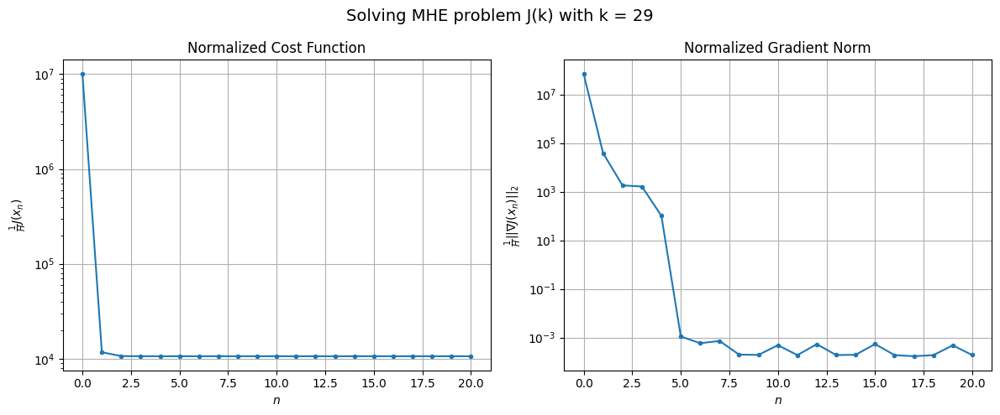

Windows:   0%|          | 1/366 [00:18<1:53:30, 18.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 309964.1664448302
Gradient norm: 2619507.54302509
Global estimation error: 46.8459773838415
Initial conditions estimation errors: 23.64841871461171 m, 23.039027345308536 m, 23.702570384968286 m, 23.29412076706936 m
Position estimation errors: 27.389453154665787 m, 30.26326923171174 m, 26.475702662349214 m, 26.720068175362204 m

[Gauss-Newton] Iteration 1
Cost function: 295681.9505013025 (-4.61%)
Gradient norm: 41.98220867549435 (-100.00%)
Global estimation error: 56.76147634353628 (21.17%)
Initial conditions estimation errors: 29.010174048282813 m, 28.55138060812084 m, 27.781154648178106 m, 28.164167927490297 m
Position estimation errors: 23.43731418522247 m, 26.418724519647004 m, 22.603377144114486 m, 22.91883709303416 m

[Gauss-Newton] Iteration 2
Cost function: 295681.9502092812 (-0.00%)
Gradient norm: 0.012879893276719224 (-99.97%)
Global estimation error: 56.752837220664375 (-0.02%)
Initial conditions estimation errors: 2

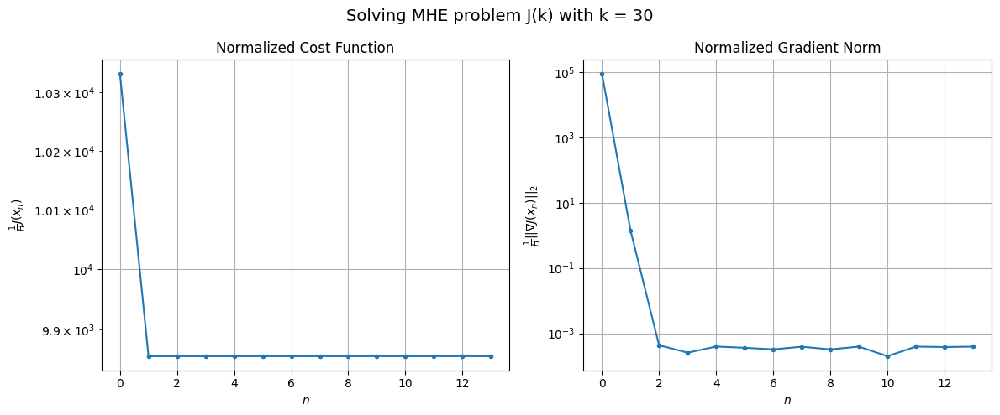

Windows:   1%|          | 2/366 [00:31<1:31:20, 15.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 290767.88292575825
Gradient norm: 2592936.7163940705
Global estimation error: 43.57960403799725
Initial conditions estimation errors: 22.780431000526555 m, 22.228422301403146 m, 21.32530514279201 m, 20.767779764631367 m
Position estimation errors: 27.202711898313687 m, 30.143067278225985 m, 26.494575885480483 m, 26.996390962965666 m

[Gauss-Newton] Iteration 1
Cost function: 277310.314485153 (-4.63%)
Gradient norm: 60.29397942761644 (-100.00%)
Global estimation error: 57.67576076286131 (32.35%)
Initial conditions estimation errors: 27.82146348669796 m, 27.936370953327852 m, 29.4426356802279 m, 30.084578776818756 m
Position estimation errors: 23.144604722137746 m, 25.35150742762253 m, 21.38240650702862 m, 21.570408691820237 m

[Gauss-Newton] Iteration 2
Cost function: 277310.3134527978 (-0.00%)
Gradient norm: 0.034717099770401966 (-99.94%)
Global estimation error: 57.60150149670756 (-0.13%)
Initial conditions estimation errors:

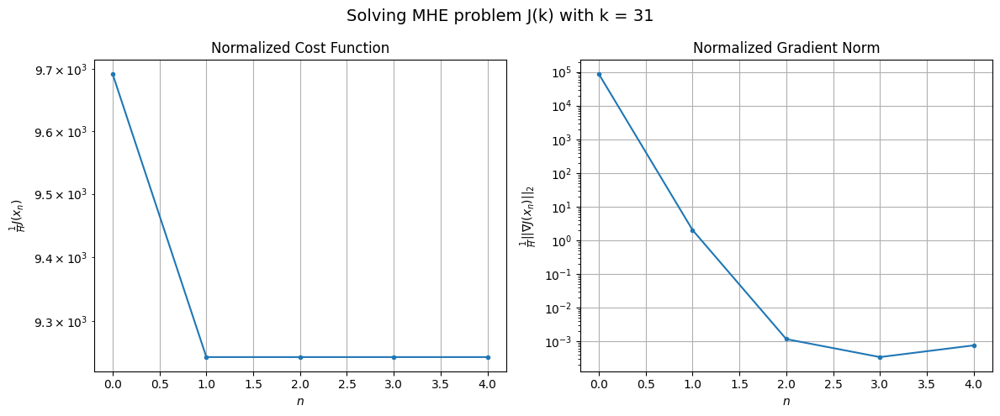

Windows:   1%|          | 3/366 [00:36<1:03:40, 10.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 273824.9925133363
Gradient norm: 2624164.112671229
Global estimation error: 45.599823205602895
Initial conditions estimation errors: 22.08607518187577 m, 22.160451630060734 m, 23.243200179865475 m, 23.667823803709446 m
Position estimation errors: 26.695855071572744 m, 28.833672163207392 m, 24.935729058598334 m, 25.240080372934475 m

[Gauss-Newton] Iteration 1
Cost function: 261052.62981569927 (-4.66%)
Gradient norm: 93.69385598552208 (-100.00%)
Global estimation error: 59.48026089740939 (30.44%)
Initial conditions estimation errors: 26.877452099092597 m, 25.644318556763388 m, 33.45403818193414 m, 32.2280018546794 m
Position estimation errors: 22.548514035140414 m, 25.993863203008214 m, 18.205036940206714 m, 17.19514390845463 m

[Gauss-Newton] Iteration 2
Cost function: 261052.62560619638 (-0.00%)
Gradient norm: 0.20110983150833903 (-99.79%)
Global estimation error: 59.211843882145494 (-0.45%)
Initial conditions estimation erro

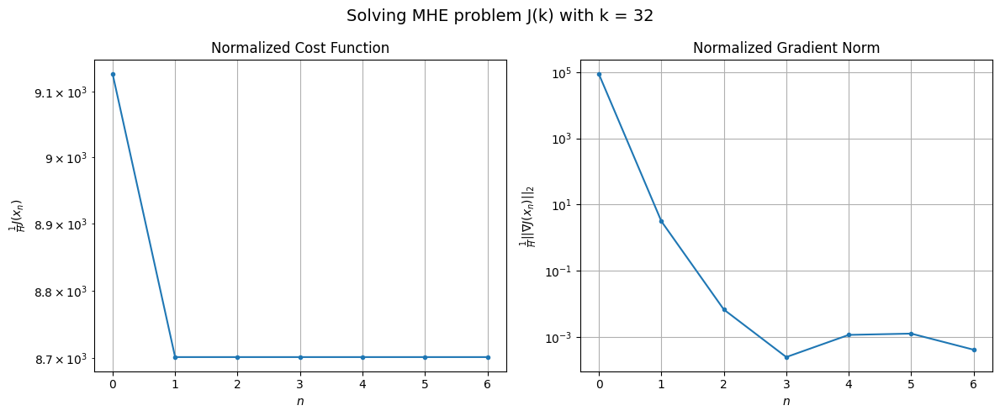

Windows:   1%|          | 4/366 [00:42<54:15,  8.99s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 258016.21381243604
Gradient norm: 2726644.1833717716
Global estimation error: 48.33950472656893
Initial conditions estimation errors: 21.567977411776003 m, 20.3002098628654 m, 27.17058409627576 m, 26.854203361207766 m
Position estimation errors: 25.81010122498643 m, 29.371987377285993 m, 21.46491101399492 m, 20.467906888485555 m

[Gauss-Newton] Iteration 1
Cost function: 246112.46407499432 (-4.61%)
Gradient norm: 21.497548254608375 (-100.00%)
Global estimation error: 59.022294668731874 (22.10%)
Initial conditions estimation errors: 26.1166717190161 m, 25.65309860472171 m, 32.33930399864984 m, 33.129931408269755 m
Position estimation errors: 21.662429453160343 m, 24.364889412517975 m, 17.569288530297335 m, 17.22916040099783 m

[Gauss-Newton] Iteration 2
Cost function: 246112.4640383326 (-0.00%)
Gradient norm: 0.014947016065523936 (-99.93%)
Global estimation error: 59.00295333802526 (-0.03%)
Initial conditions estimation errors:

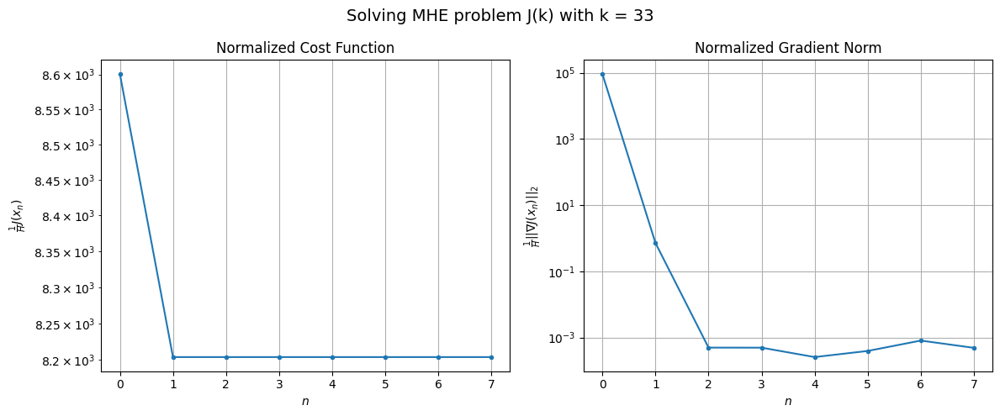

Windows:   1%|▏         | 5/366 [00:50<50:36,  8.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 242488.8708500552
Gradient norm: 2869612.876408475
Global estimation error: 48.87021241720577
Initial conditions estimation errors: 21.139323937468177 m, 20.74658004199615 m, 26.907618541877607 m, 28.052630062171076 m
Position estimation errors: 24.582739540595853 m, 27.465426949034242 m, 20.531015917756765 m, 19.91620625433944 m

[Gauss-Newton] Iteration 1
Cost function: 231381.7710063887 (-4.58%)
Gradient norm: 129.259601623537 (-100.00%)
Global estimation error: 52.449180625618354 (7.32%)
Initial conditions estimation errors: 25.479126739124748 m, 23.20701710330474 m, 29.263017158134147 m, 26.585756086209912 m
Position estimation errors: 20.467517789349074 m, 25.078278497909345 m, 16.057302648798906 m, 15.42753379451435 m

[Gauss-Newton] Iteration 2
Cost function: 231381.76880098708 (-0.00%)
Gradient norm: 0.02649593875257638 (-99.98%)
Global estimation error: 52.394187227823515 (-0.10%)
Initial conditions estimation errors

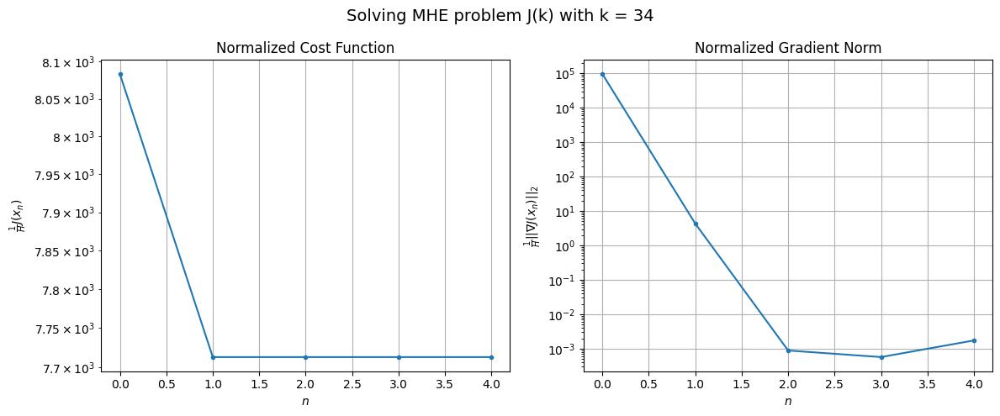

Windows:   2%|▏         | 6/366 [00:55<44:43,  7.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 225795.97690031515
Gradient norm: 2992342.119009463
Global estimation error: 42.90796698423904
Initial conditions estimation errors: 20.742018709322355 m, 18.620193148318695 m, 23.733692864745098 m, 22.379268151948946 m
Position estimation errors: 23.020132962699975 m, 27.793448710955982 m, 19.0258323803671 m, 17.944405461393806 m

[Gauss-Newton] Iteration 1
Cost function: 215523.90014105028 (-4.55%)
Gradient norm: 84.92564347527438 (-100.00%)
Global estimation error: 48.87067963400479 (13.90%)
Initial conditions estimation errors: 24.8819044915578 m, 23.408987516623434 m, 26.131709116352237 m, 23.202451601122075 m
Position estimation errors: 18.99057621186917 m, 22.928094903881618 m, 18.493151987189524 m, 18.581388315772234 m

[Gauss-Newton] Iteration 2
Cost function: 215523.89995656192 (-0.00%)
Gradient norm: 0.010379898762971124 (-99.99%)
Global estimation error: 48.85569549485215 (-0.03%)
Initial conditions estimation erro

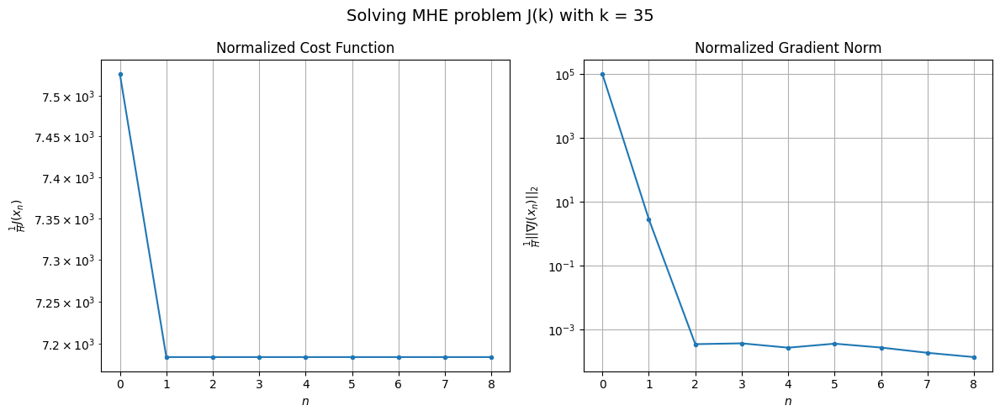

Windows:   2%|▏         | 7/366 [01:03<45:43,  7.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 207015.5306836484
Gradient norm: 3180298.5142761176
Global estimation error: 39.45994331403308
Initial conditions estimation errors: 20.30907670734431 m, 19.007237642567308 m, 20.933179729734967 m, 18.577622419090392 m
Position estimation errors: 21.192277272295353 m, 25.249431213106742 m, 21.097782084650706 m, 20.959610335617278 m

[Gauss-Newton] Iteration 1
Cost function: 197686.20281534083 (-4.51%)
Gradient norm: 192.36346713571533 (-99.99%)
Global estimation error: 41.7109700504945 (5.70%)
Initial conditions estimation errors: 24.236530080361234 m, 22.968314007721776 m, 19.399370140003615 m, 15.763475222136323 m
Position estimation errors: 17.32046558728231 m, 22.289920411843752 m, 15.379761756578054 m, 15.20130010925398 m

[Gauss-Newton] Iteration 2
Cost function: 197686.201779235 (-0.00%)
Gradient norm: 0.007152834910331424 (-100.00%)
Global estimation error: 41.6858235673809 (-0.06%)
Initial conditions estimation errors

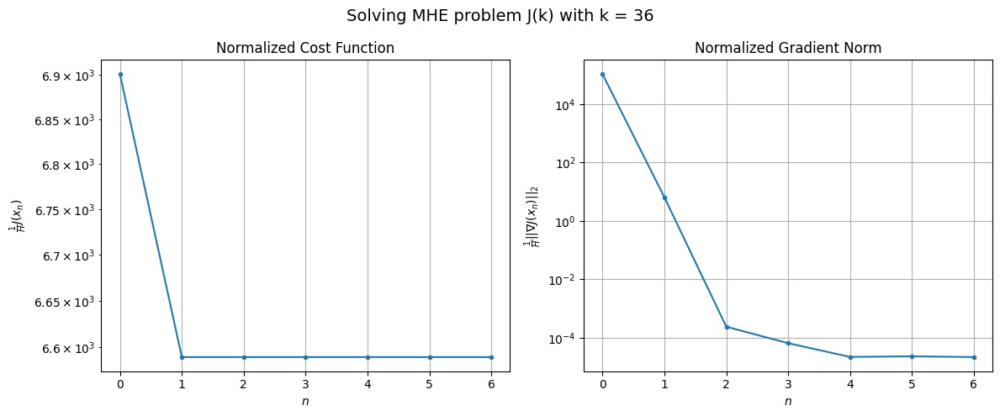

Windows:   2%|▏         | 8/366 [01:10<43:38,  7.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 186655.03934251034
Gradient norm: 3307442.3318703054
Global estimation error: 33.1164477632833
Initial conditions estimation errors: 19.760060121408582 m, 18.765870822779696 m, 14.771458515361896 m, 11.655896656029723 m
Position estimation errors: 19.237661236081188 m, 24.090328379680873 m, 17.967468312267652 m, 17.63366707954485 m

[Gauss-Newton] Iteration 1
Cost function: 178471.78039734397 (-4.38%)
Gradient norm: 141.89825829355968 (-100.00%)
Global estimation error: 38.09960050185469 (15.05%)
Initial conditions estimation errors: 23.422087072846463 m, 22.638609152619377 m, 15.706563113043924 m, 11.989769754510535 m
Position estimation errors: 15.603386090683978 m, 21.069221824280927 m, 11.832696298171623 m, 11.48563322174092 m

[Gauss-Newton] Iteration 2
Cost function: 178471.7801622531 (-0.00%)
Gradient norm: 0.015772627984963785 (-99.99%)
Global estimation error: 38.08980025748687 (-0.03%)
Initial conditions estimation e

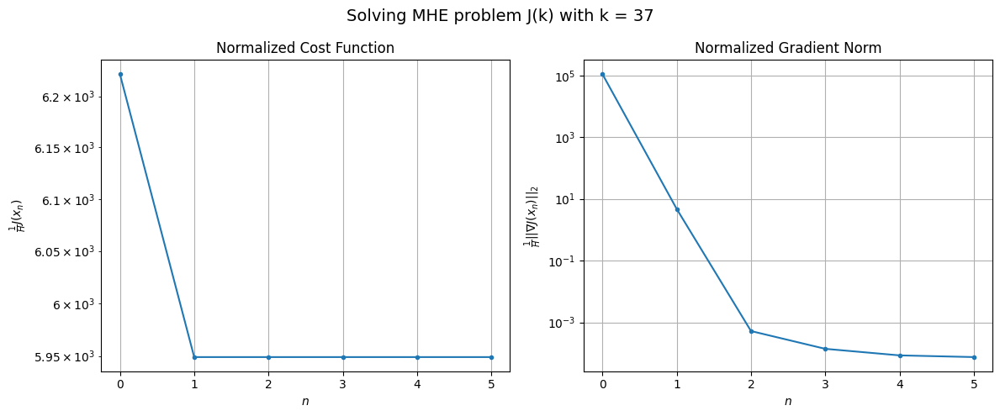

Windows:   2%|▏         | 9/366 [01:16<40:00,  6.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 165956.01008139583
Gradient norm: 3560220.21298174
Global estimation error: 30.422962350492394
Initial conditions estimation errors: 18.98812026757619 m, 18.547060033397166 m, 11.815079993767629 m, 9.021805707542526 m
Position estimation errors: 17.367537802230412 m, 22.51476472460413 m, 14.572495564201136 m, 13.953793356720405 m

[Gauss-Newton] Iteration 1
Cost function: 158787.5393267156 (-4.32%)
Gradient norm: 45.03496007728912 (-100.00%)
Global estimation error: 35.971707342492444 (18.24%)
Initial conditions estimation errors: 22.382435827490056 m, 21.74847119765439 m, 13.371852941557092 m, 11.881094338609305 m
Position estimation errors: 13.97781911419903 m, 19.59661659034689 m, 10.591537184031955 m, 10.51130975803157 m

[Gauss-Newton] Iteration 2
Cost function: 158787.53919122164 (-0.00%)
Gradient norm: 0.05132382696369047 (-99.89%)
Global estimation error: 35.952829424035436 (-0.05%)
Initial conditions estimation errors

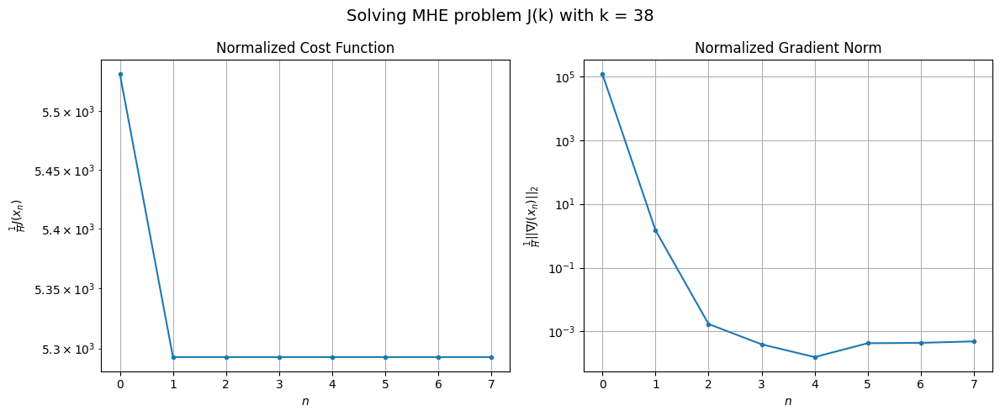

Windows:   3%|▎         | 10/366 [01:23<40:41,  6.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 146311.89505478466
Gradient norm: 3650260.50574237
Global estimation error: 29.712090110647633
Initial conditions estimation errors: 17.96481747798914 m, 17.703479492117268 m, 10.431355522425452 m, 11.739757806881478 m
Position estimation errors: 15.738450098210109 m, 20.943268695081546 m, 13.438614586713408 m, 13.001508285863972 m

[Gauss-Newton] Iteration 1
Cost function: 140122.7855763918 (-4.23%)
Gradient norm: 406.20586238376853 (-99.99%)
Global estimation error: 34.66284264459544 (16.66%)
Initial conditions estimation errors: 21.079674584702826 m, 20.124556222320237 m, 14.260419150680674 m, 12.197444945133117 m
Position estimation errors: 12.640470169128129 m, 16.95640365892715 m, 14.802267396656921 m, 14.796859515964524 m

[Gauss-Newton] Iteration 2
Cost function: 140122.78441888024 (-0.00%)
Gradient norm: 0.022273598545439057 (-99.99%)
Global estimation error: 34.67496961063579 (0.03%)
Initial conditions estimation err

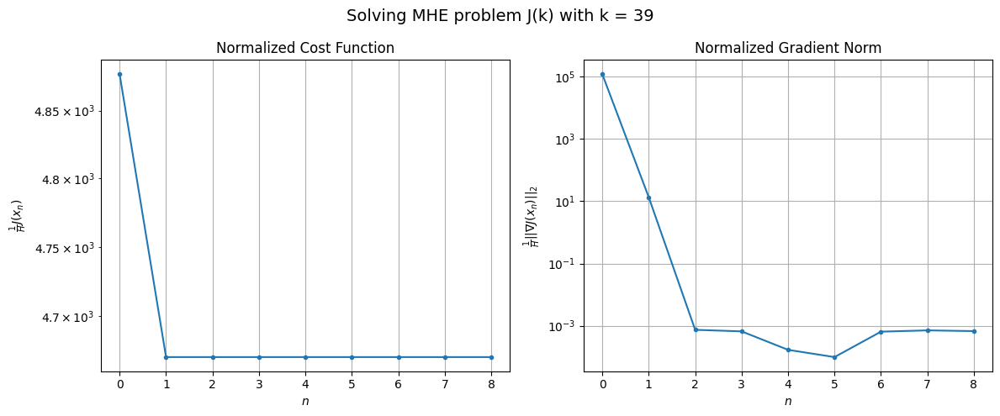

Windows:   3%|▎         | 11/366 [01:31<43:07,  7.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 128086.33699039866
Gradient norm: 3775870.597649033
Global estimation error: 27.25553886775593
Initial conditions estimation errors: 16.704860528624966 m, 16.075247632460844 m, 10.000576421094603 m, 10.26471207922852 m
Position estimation errors: 14.523667329864086 m, 18.463079747535673 m, 16.928686049700417 m, 17.021134314641515 m

[Gauss-Newton] Iteration 1
Cost function: 122938.20011705544 (-4.02%)
Gradient norm: 681.7762152407579 (-99.98%)
Global estimation error: 34.311334135099514 (25.89%)
Initial conditions estimation errors: 19.49673951402948 m, 19.302347326534388 m, 13.659279734363167 m, 15.426011683443026 m
Position estimation errors: 11.765992023477835 m, 16.861039657059525 m, 11.048030496922497 m, 10.8924823324287 m

[Gauss-Newton] Iteration 2
Cost function: 122938.19174124331 (-0.00%)
Gradient norm: 0.03288503234949067 (-100.00%)
Global estimation error: 34.27571941695807 (-0.10%)
Initial conditions estimation err

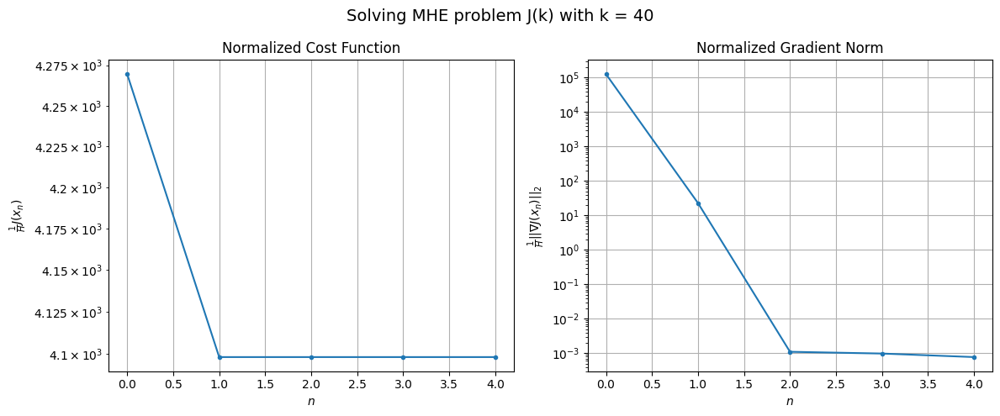

Windows:   3%|▎         | 12/366 [01:36<39:31,  6.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 113278.44885304203
Gradient norm: 3983209.621629784
Global estimation error: 31.117999904513166
Initial conditions estimation errors: 15.239384546080577 m, 15.495022770206479 m, 12.919206052854678 m, 18.140184244322963 m
Position estimation errors: 13.813258761990948 m, 18.310233862443646 m, 13.935508198611846 m, 13.672467603279701 m

[Gauss-Newton] Iteration 1
Cost function: 108919.34434442772 (-3.85%)
Gradient norm: 253.34291881394495 (-99.99%)
Global estimation error: 35.73692137008536 (14.84%)
Initial conditions estimation errors: 17.73979655427418 m, 18.763881366636678 m, 20.743192859100457 m, 13.417765541467196 m
Position estimation errors: 11.328186882316 m, 15.960279403269837 m, 10.772951929400188 m, 10.979724780200351 m

[Gauss-Newton] Iteration 2
Cost function: 108919.34333219912 (-0.00%)
Gradient norm: 0.009371200704195625 (-100.00%)
Global estimation error: 35.749506047047824 (0.04%)
Initial conditions estimation e

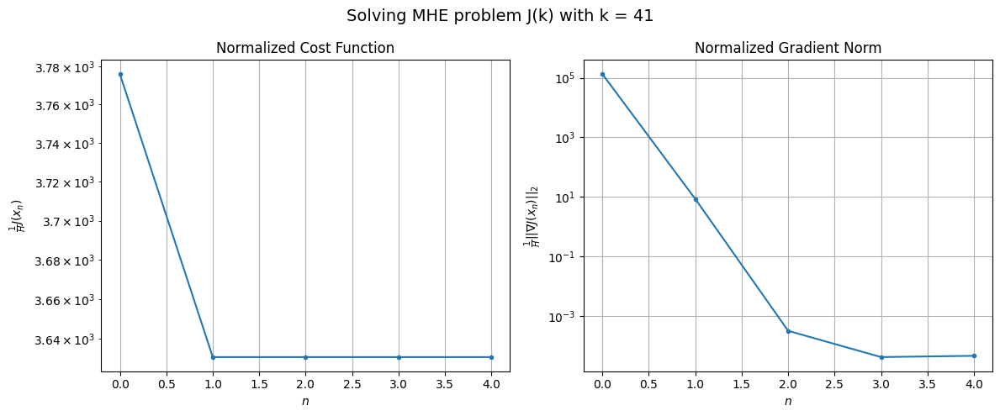

Windows:   4%|▎         | 13/366 [01:41<36:11,  6.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 102157.8014278278
Gradient norm: 4161299.377574807
Global estimation error: 34.138902036507005
Initial conditions estimation errors: 13.686371634358087 m, 15.18906460964811 m, 20.6390635510859 m, 17.928921511700267 m
Position estimation errors: 13.511277997122505 m, 17.797758474944846 m, 13.837629935327382 m, 13.66562221005705 m

[Gauss-Newton] Iteration 1
Cost function: 98532.31145424386 (-3.55%)
Gradient norm: 47.131775388270704 (-100.00%)
Global estimation error: 38.61501615244197 (13.11%)
Initial conditions estimation errors: 15.879667920879797 m, 17.553060041006958 m, 19.343687220940467 m, 23.59331014232543 m
Position estimation errors: 11.241861190543528 m, 14.877528437283022 m, 11.377219704305238 m, 11.494936376224103 m

[Gauss-Newton] Iteration 2
Cost function: 98532.31099671117 (-0.00%)
Gradient norm: 0.023593342216455294 (-99.95%)
Global estimation error: 38.49323934980822 (-0.32%)
Initial conditions estimation error

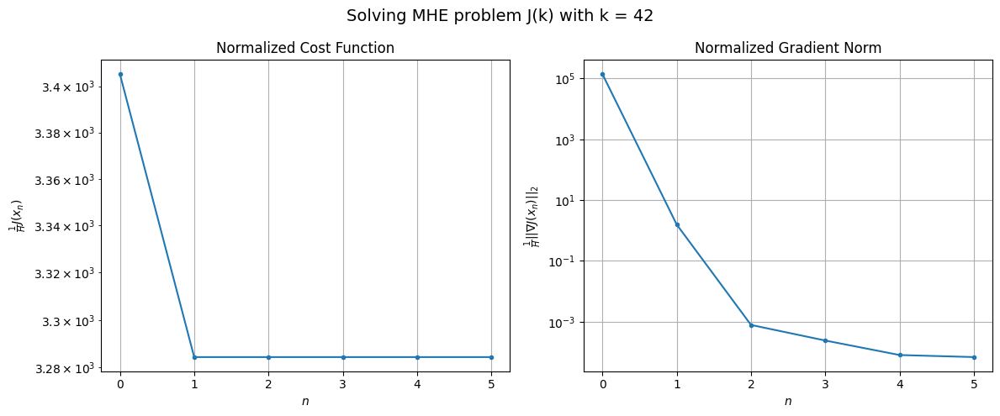

Windows:   4%|▍         | 14/366 [01:47<34:51,  5.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 95050.96945246981
Gradient norm: 4271321.861319219
Global estimation error: 38.88918040083378
Initial conditions estimation errors: 12.121453244254747 m, 14.117358785349873 m, 20.91330864916641 m, 26.995431148156595 m
Position estimation errors: 13.505262269979468 m, 16.818034547480313 m, 14.629213821560977 m, 14.65962444601327 m

[Gauss-Newton] Iteration 1
Cost function: 92003.72632274544 (-3.21%)
Gradient norm: 32.43945771205157 (-100.00%)
Global estimation error: 35.65790859103826 (-8.31%)
Initial conditions estimation errors: 14.043966528983816 m, 16.11268987875766 m, 15.345295293560271 m, 24.065250744882196 m
Position estimation errors: 11.376285174704014 m, 14.44635119977823 m, 10.975993768380338 m, 10.88127608257525 m

[Gauss-Newton] Iteration 2
Cost function: 92003.7261889906 (-0.00%)
Gradient norm: 0.020365994067863734 (-99.94%)
Global estimation error: 35.57019991810333 (-0.25%)
Initial conditions estimation errors: 

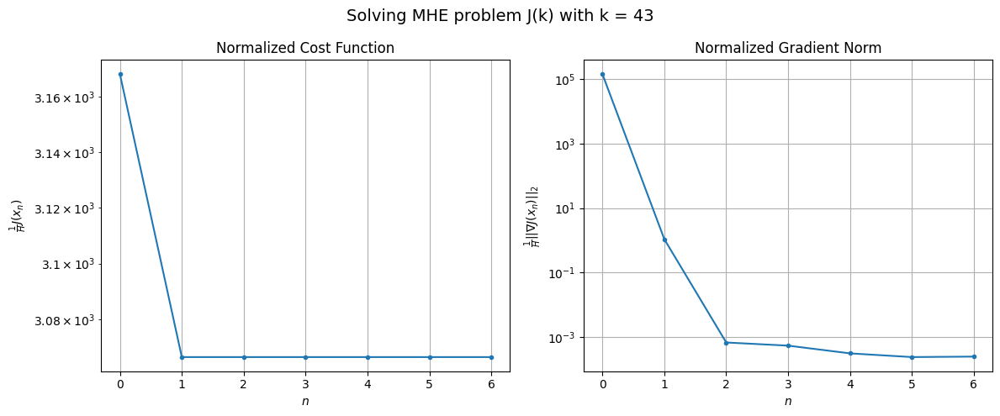

Windows:   4%|▍         | 15/366 [01:53<34:51,  5.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 91617.83071248124
Gradient norm: 4482967.326989542
Global estimation error: 36.753499307301816
Initial conditions estimation errors: 10.68282268816531 m, 13.06675400674539 m, 18.006856839536045 m, 27.234053470839147 m
Position estimation errors: 13.675450522274794 m, 16.414933366760877 m, 13.87403652315719 m, 13.490693424974555 m

[Gauss-Newton] Iteration 1
Cost function: 88886.3892281578 (-2.98%)
Gradient norm: 3181.3004507308883 (-99.93%)
Global estimation error: 32.653755728529546 (-11.15%)
Initial conditions estimation errors: 12.412242711419315 m, 12.191724563082722 m, 16.17985227177151 m, 22.400113867134323 m
Position estimation errors: 11.556561898394659 m, 12.352469960684928 m, 15.024714783150268 m, 16.025117867013375 m

[Gauss-Newton] Iteration 2
Cost function: 88886.19898626296 (-0.00%)
Gradient norm: 0.015563920003130588 (-100.00%)
Global estimation error: 32.68283349290917 (0.09%)
Initial conditions estimation erro

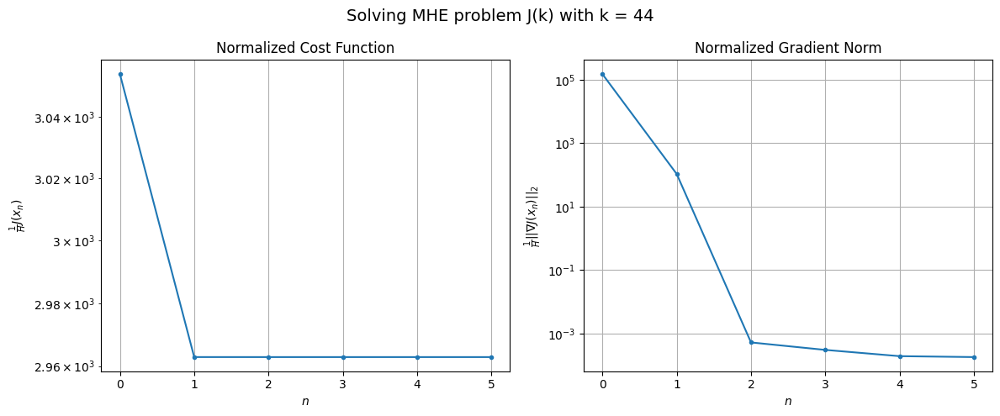

Windows:   4%|▍         | 16/366 [01:58<34:31,  5.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 90641.77567287508
Gradient norm: 4523124.848793636
Global estimation error: 27.679895891593443
Initial conditions estimation errors: 9.547862047662173 m, 9.379640826510373 m, 14.002573276536257 m, 19.772578045707704 m
Position estimation errors: 13.864285977104016 m, 14.616637812342075 m, 16.576322649478044 m, 17.494143647854937 m

[Gauss-Newton] Iteration 1
Cost function: 88166.47211038448 (-2.73%)
Gradient norm: 373.6625443082521 (-99.99%)
Global estimation error: 41.78444818182907 (50.96%)
Initial conditions estimation errors: 11.126177747194737 m, 9.830795538326822 m, 25.929645801853336 m, 29.208692915818915 m
Position estimation errors: 11.737834623884904 m, 11.562010583107654 m, 16.413595478601742 m, 18.52501532551342 m

[Gauss-Newton] Iteration 2
Cost function: 88166.46980672899 (-0.00%)
Gradient norm: 0.03094979886626911 (-99.99%)
Global estimation error: 41.8600429062893 (0.18%)
Initial conditions estimation errors: 1

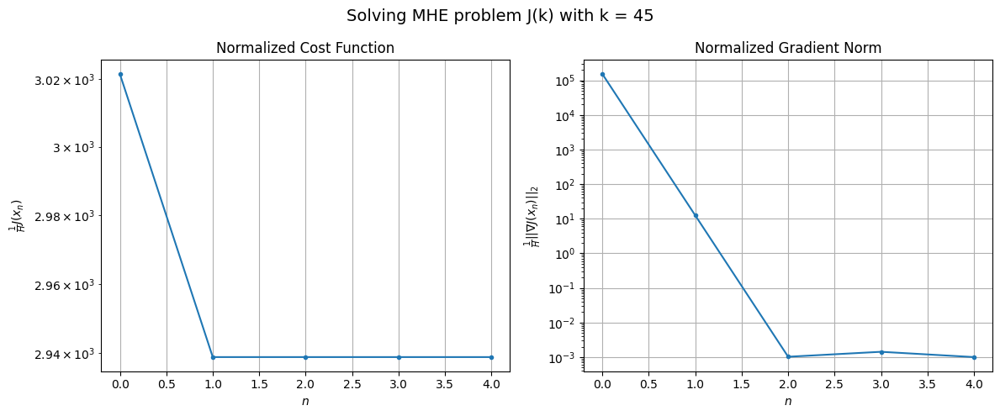

Windows:   5%|▍         | 17/366 [02:04<34:01,  5.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 91979.11479600909
Gradient norm: 4752435.759346045
Global estimation error: 38.255792858518056
Initial conditions estimation errors: 8.79880082588637 m, 7.717313533503345 m, 24.36628953028135 m, 27.070397529840484 m
Position estimation errors: 14.060128562907307 m, 13.795996386524436 m, 17.53460456865358 m, 19.373433644098906 m

[Gauss-Newton] Iteration 1
Cost function: 89549.13352130096 (-2.64%)
Gradient norm: 479.97656366490395 (-99.99%)
Global estimation error: 23.540318881058848 (-38.47%)
Initial conditions estimation errors: 10.2981493023102 m, 12.020107653498858 m, 7.754848014858148 m, 15.60339606594686 m
Position estimation errors: 11.83849146127772 m, 11.737855609451312 m, 17.270781690570647 m, 18.540199314873682 m

[Gauss-Newton] Iteration 2
Cost function: 89549.12301655115 (-0.00%)
Gradient norm: 0.015501239656857416 (-100.00%)
Global estimation error: 23.567308485726926 (0.11%)
Initial conditions estimation errors: 

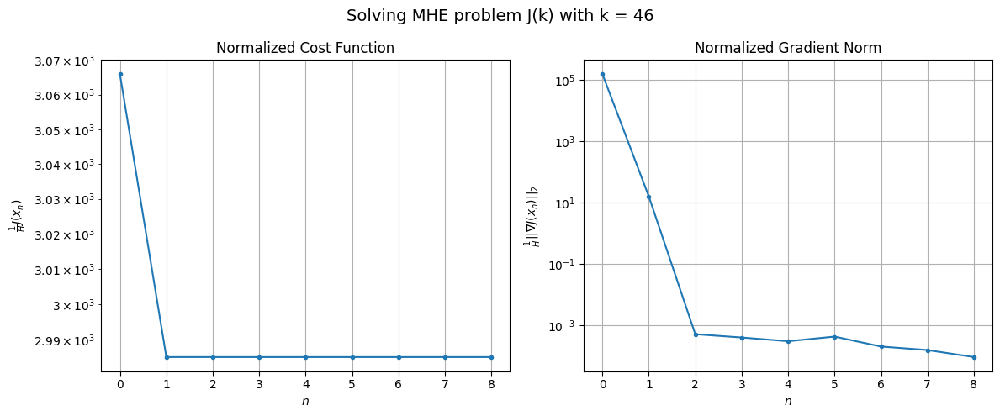

Windows:   5%|▍         | 18/366 [02:12<37:58,  6.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 94189.6708108297
Gradient norm: 4782420.444908955
Global estimation error: 20.308064370843148
Initial conditions estimation errors: 8.471268216451607 m, 10.230526201782803 m, 6.671783924548211 m, 13.837354624076912 m
Position estimation errors: 14.193757670889426 m, 14.04586648887828 m, 19.160753077145475 m, 20.55038066409366 m

[Gauss-Newton] Iteration 1
Cost function: 91766.18296106772 (-2.57%)
Gradient norm: 2236.8384148807477 (-99.95%)
Global estimation error: 54.27186203932844 (167.24%)
Initial conditions estimation errors: 9.96945601963325 m, 8.776149013948096 m, 35.94133842590174 m, 38.434880792076434 m
Position estimation errors: 11.916832657863234 m, 11.552945724039546 m, 21.84481775865268 m, 26.011831994845704 m

[Gauss-Newton] Iteration 2
Cost function: 91766.07768777097 (-0.00%)
Gradient norm: 0.072832283033279 (-100.00%)
Global estimation error: 54.62756956972751 (0.66%)
Initial conditions estimation errors: 9.969

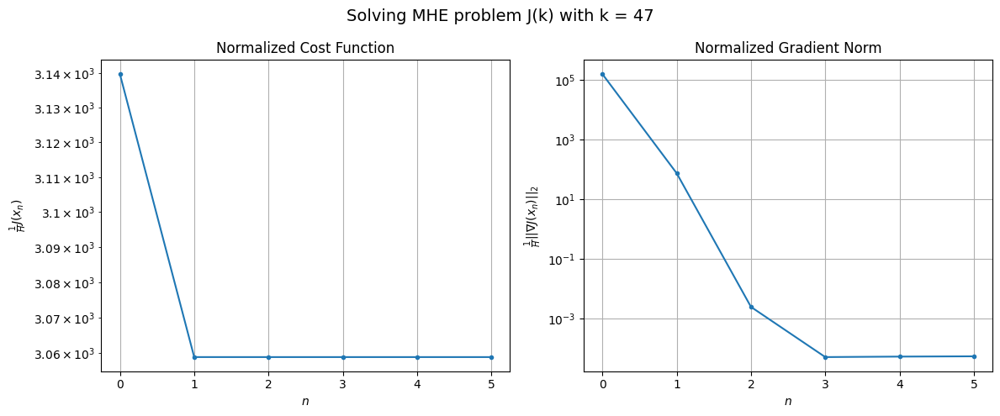

Windows:   5%|▌         | 19/366 [02:18<36:16,  6.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 96959.76972613414
Gradient norm: 4895047.09468659
Global estimation error: 53.53133593143439
Initial conditions estimation errors: 8.562879676545096 m, 8.304262326663023 m, 35.42369420074338 m, 38.320734656184804 m
Position estimation errors: 14.327198419676877 m, 14.04569806161286 m, 22.569275116641663 m, 26.01797113753611 m

[Gauss-Newton] Iteration 1
Cost function: 94470.7126259783 (-2.57%)
Gradient norm: 523.0285060068001 (-99.99%)
Global estimation error: 77.26452733594463 (44.34%)
Initial conditions estimation errors: 10.076604019106751 m, 9.787486631760723 m, 50.782520211959806 m, 56.51200188625914 m
Position estimation errors: 11.97277050128678 m, 10.435128577485496 m, 22.250245792225755 m, 26.883760778205758 m

[Gauss-Newton] Iteration 2
Cost function: 94470.7079367643 (-0.00%)
Gradient norm: 0.017218117799015845 (-100.00%)
Global estimation error: 77.29816684988813 (0.04%)
Initial conditions estimation errors: 10.076

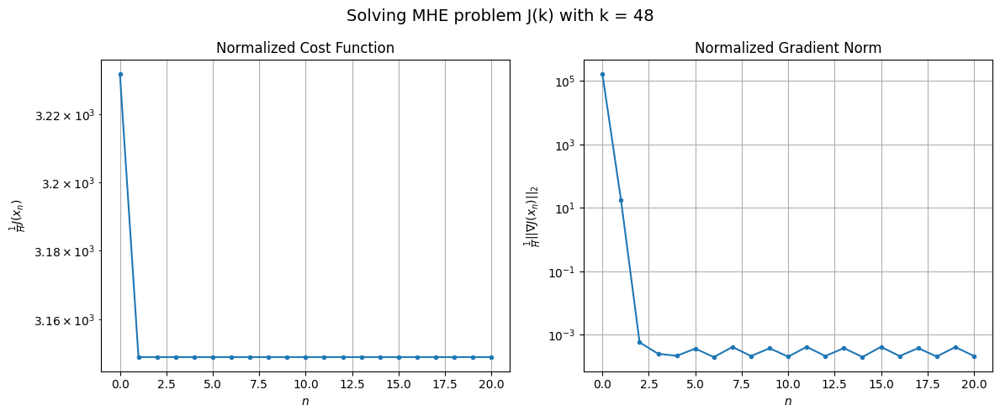

Windows:   5%|▌         | 20/366 [02:36<57:13,  9.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 100217.37165307725
Gradient norm: 4997614.659742402
Global estimation error: 76.94476588433955
Initial conditions estimation errors: 8.960279902946063 m, 9.605294974847476 m, 50.30098875681366 m, 56.725267583086236 m
Position estimation errors: 14.42722940431761 m, 12.80436018043317 m, 22.804516807598628 m, 25.87810352268373 m

[Gauss-Newton] Iteration 1
Cost function: 97593.8395360054 (-2.62%)
Gradient norm: 135.1036487814331 (-100.00%)
Global estimation error: 60.67664063106609 (-21.14%)
Initial conditions estimation errors: 10.545620807371277 m, 11.37405274956462 m, 40.06985023185475 m, 42.84249433832162 m
Position estimation errors: 12.00272538485164 m, 11.096120501332837 m, 24.5844099699132 m, 30.400336284657854 m

[Gauss-Newton] Iteration 2
Cost function: 97593.83774959111 (-0.00%)
Gradient norm: 0.02390004028249169 (-99.98%)
Global estimation error: 60.74274534591347 (0.11%)
Initial conditions estimation errors: 10.5456

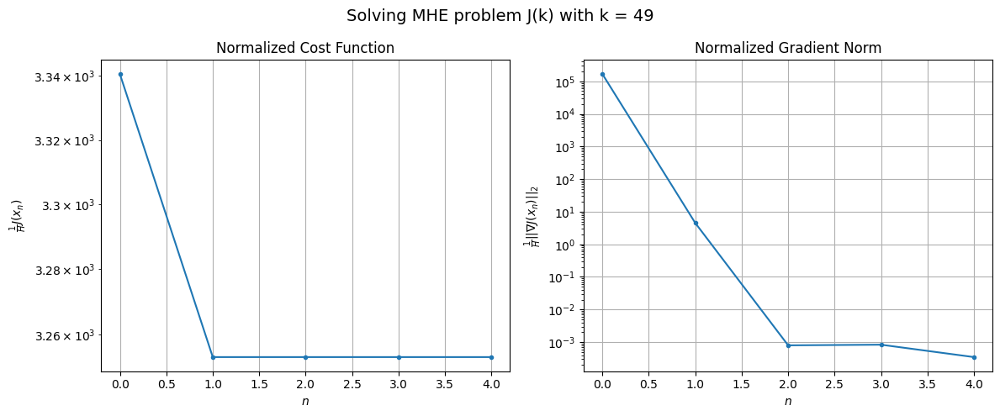

Windows:   6%|▌         | 21/366 [02:41<48:32,  8.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 102441.41221333052
Gradient norm: 4800602.468679466
Global estimation error: 60.641274220718195
Initial conditions estimation errors: 9.517009879086267 m, 10.88408487730856 m, 39.675343959024346 m, 43.52230317607596 m
Position estimation errors: 14.478106332746634 m, 13.563992236096555 m, 25.050785593432103 m, 29.69105958394576 m

[Gauss-Newton] Iteration 1
Cost function: 99779.13233099389 (-2.60%)
Gradient norm: 1110.4851606566688 (-99.98%)
Global estimation error: 47.02087527648252 (-22.46%)
Initial conditions estimation errors: 11.226639779696113 m, 12.207721569482722 m, 30.27059183399589 m, 31.930922480311626 m
Position estimation errors: 12.105517523862632 m, 10.939969870957086 m, 13.116573604235153 m, 14.030901708472639 m

[Gauss-Newton] Iteration 2
Cost function: 99779.12433602018 (-0.00%)
Gradient norm: 0.028379649709831402 (-100.00%)
Global estimation error: 47.07242921307379 (0.11%)
Initial conditions estimation erro

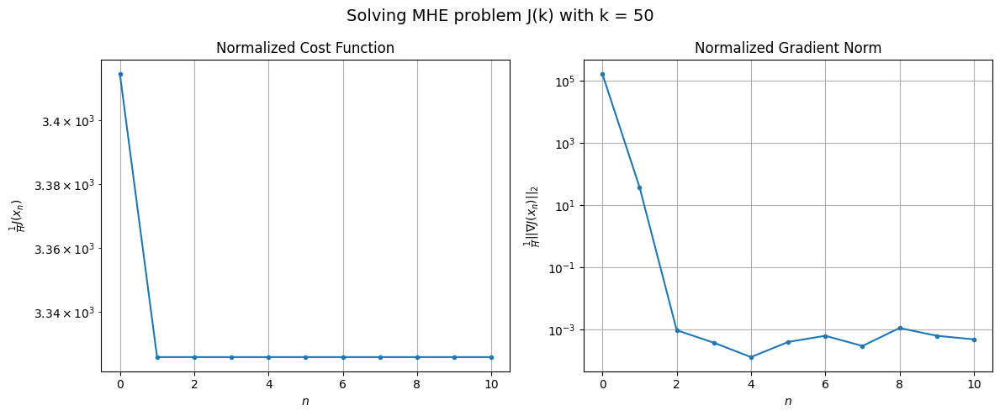

Windows:   6%|▌         | 22/366 [02:51<50:48,  8.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 104407.50062661804
Gradient norm: 4757678.520177671
Global estimation error: 45.09257567318929
Initial conditions estimation errors: 10.047370863720861 m, 10.905993602945157 m, 28.89628556707075 m, 31.280183509115886 m
Position estimation errors: 14.58929167135767 m, 13.26194157083663 m, 14.647275634061625 m, 14.222796548688692 m

[Gauss-Newton] Iteration 1
Cost function: 101615.60891091652 (-2.67%)
Gradient norm: 5810.497308386092 (-99.88%)
Global estimation error: 39.04802614450959 (-13.40%)
Initial conditions estimation errors: 11.913872807666133 m, 16.74355158821684 m, 20.542305181610566 m, 26.08575277506831 m
Position estimation errors: 12.237640287468272 m, 10.977818473069648 m, 8.76594285038972 m, 9.213212610733365 m

[Gauss-Newton] Iteration 2
Cost function: 101615.06344802734 (-0.00%)
Gradient norm: 0.02966273792677061 (-100.00%)
Global estimation error: 38.95014441054185 (-0.25%)
Initial conditions estimation errors:

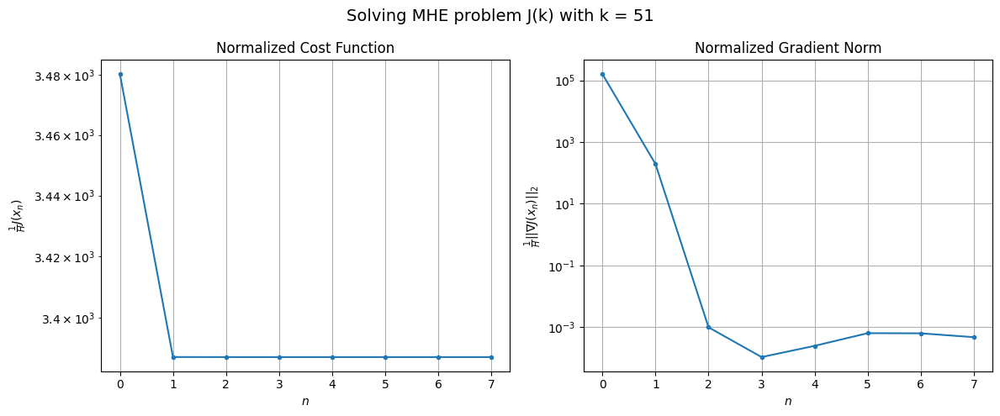

Windows:   6%|▋         | 23/366 [02:58<46:53,  8.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 105755.34549413575
Gradient norm: 4681826.921425383
Global estimation error: 39.676466462043905
Initial conditions estimation errors: 10.409546076965954 m, 14.985858978377786 m, 22.478616731475878 m, 27.12913971623705 m
Position estimation errors: 14.724692038985475 m, 13.0308548167911 m, 10.366645456701375 m, 9.4396225160688 m

[Gauss-Newton] Iteration 1
Cost function: 102679.52336608543 (-2.91%)
Gradient norm: 1658.4247844518418 (-99.96%)
Global estimation error: 69.68959005559111 (75.64%)
Initial conditions estimation errors: 12.526056897176927 m, 19.129338474373778 m, 41.6565143241016 m, 50.975745314902895 m
Position estimation errors: 12.360304056277311 m, 11.514692520831598 m, 10.323866034713312 m, 17.214135981071447 m

[Gauss-Newton] Iteration 2
Cost function: 102679.4935097949 (-0.00%)
Gradient norm: 0.004668608474687896 (-100.00%)
Global estimation error: 69.67084113151198 (-0.03%)
Initial conditions estimation errors

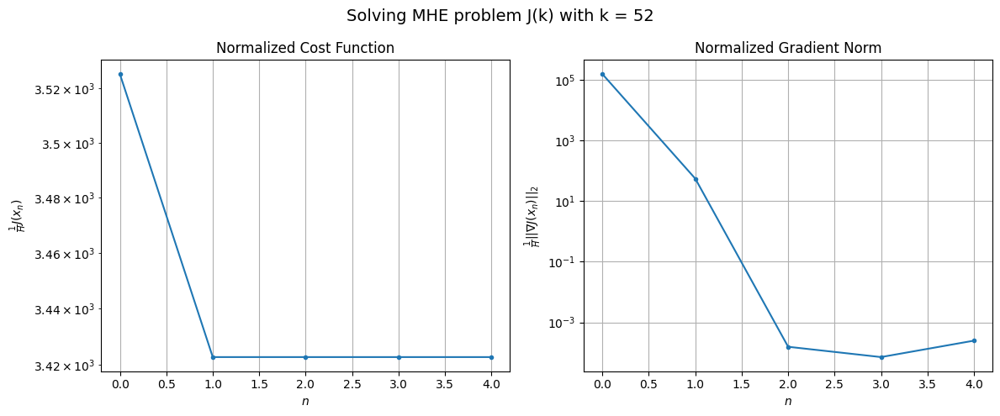

Windows:   7%|▋         | 24/366 [03:03<40:44,  7.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 105790.85544040521
Gradient norm: 4490657.401365017
Global estimation error: 72.42839101790254
Initial conditions estimation errors: 10.624522881008645 m, 17.350509165822125 m, 44.50169865089047 m, 53.39978036375411 m
Position estimation errors: 14.84510833066198 m, 13.435470813380137 m, 9.065417223849483 m, 14.277760094118365 m

[Gauss-Newton] Iteration 1
Cost function: 102471.10965525004 (-3.14%)
Gradient norm: 200.19495197580113 (-100.00%)
Global estimation error: 67.93566536886097 (-6.20%)
Initial conditions estimation errors: 13.013567962019438 m, 18.31882621249253 m, 39.65688708003595 m, 50.37496260688248 m
Position estimation errors: 12.51779571212077 m, 10.982489796799006 m, 13.177302380218137 m, 23.930494607729283 m

[Gauss-Newton] Iteration 2
Cost function: 102471.10917946685 (-0.00%)
Gradient norm: 0.06123134098192527 (-99.97%)
Global estimation error: 67.98655078490658 (0.07%)
Initial conditions estimation errors: 

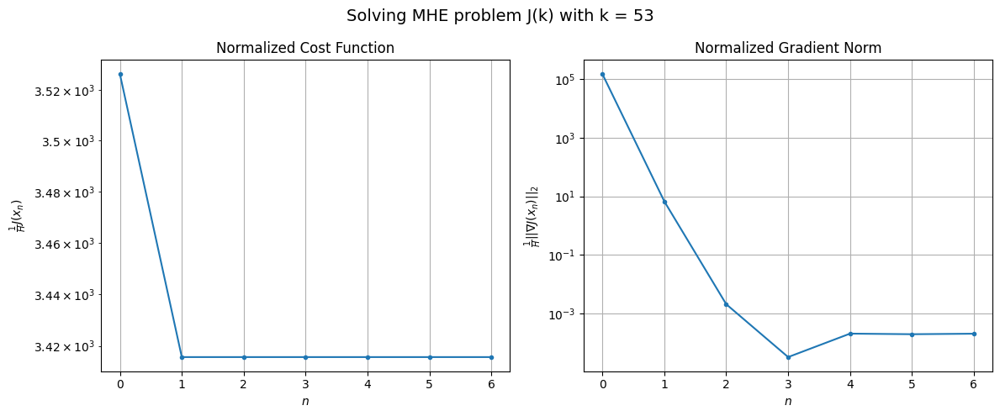

Windows:   7%|▋         | 25/366 [03:09<39:22,  6.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 105059.78735758242
Gradient norm: 4314545.785138681
Global estimation error: 70.44617710819568
Initial conditions estimation errors: 10.716221165958443 m, 16.520616558356167 m, 42.427362493864486 m, 52.676347468994194 m
Position estimation errors: 15.007620466984905 m, 12.857915539160995 m, 11.072222633314688 m, 20.918746852593962 m

[Gauss-Newton] Iteration 1
Cost function: 101451.98762021246 (-3.43%)
Gradient norm: 24.845379959646444 (-100.00%)
Global estimation error: 66.28807552765011 (-5.90%)
Initial conditions estimation errors: 13.382732748353016 m, 18.07405140697565 m, 38.67002049357346 m, 48.91779808353299 m
Position estimation errors: 12.691768206227689 m, 11.972371704923031 m, 11.620232158327324 m, 22.866713892326935 m

[Gauss-Newton] Iteration 2
Cost function: 101451.98760815262 (-0.00%)
Gradient norm: 0.011879261695953257 (-99.95%)
Global estimation error: 66.24653321593959 (-0.06%)
Initial conditions estimation e

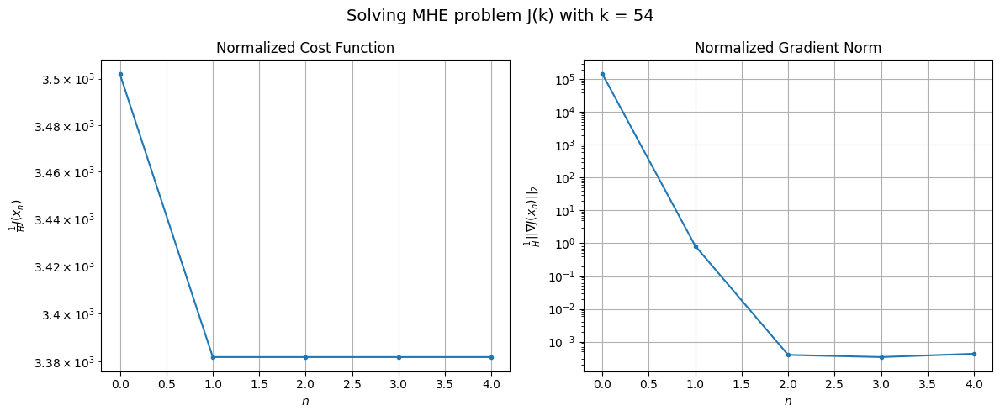

Windows:   7%|▋         | 26/366 [03:14<35:55,  6.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 104537.66795009338
Gradient norm: 4277640.944258368
Global estimation error: 68.0472971338218
Initial conditions estimation errors: 10.732006363546372 m, 16.269538210287543 m, 40.91590480985105 m, 50.7585516158551 m
Position estimation errors: 15.202782003210498 m, 13.832493837805783 m, 9.76671263471652 m, 20.029110592674552 m

[Gauss-Newton] Iteration 1
Cost function: 100684.36821779878 (-3.69%)
Gradient norm: 1926.5676657781187 (-99.95%)
Global estimation error: 73.43345602725954 (7.92%)
Initial conditions estimation errors: 13.574790135355869 m, 17.18812429770685 m, 39.34345618953653 m, 58.007142480185 m
Position estimation errors: 12.83015736350837 m, 15.257809635236653 m, 25.532717728250258 m, 45.85612375203412 m

[Gauss-Newton] Iteration 2
Cost function: 100684.35519179425 (-0.00%)
Gradient norm: 0.011904584262570751 (-100.00%)
Global estimation error: 73.37508124503044 (-0.08%)
Initial conditions estimation errors: 13.5

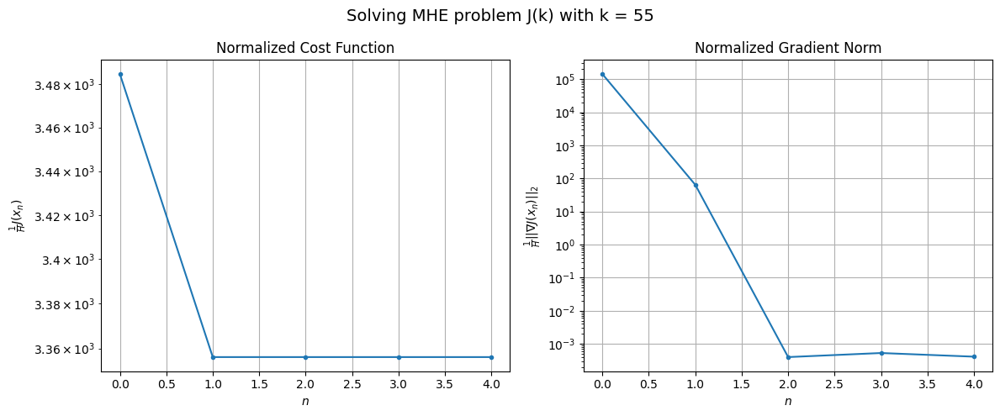

Windows:   7%|▋         | 27/366 [03:18<31:57,  5.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 103110.60417748352
Gradient norm: 4124717.6204126417
Global estimation error: 76.0380446555893
Initial conditions estimation errors: 10.670193543462346 m, 15.53550273885226 m, 42.77656830782242 m, 59.9726267132027 m
Position estimation errors: 15.368942597381636 m, 16.988286505513774 m, 21.369056123760654 m, 41.11628178985707 m

[Gauss-Newton] Iteration 1
Cost function: 99004.48274235618 (-3.98%)
Gradient norm: 3833.0067972462607 (-99.91%)
Global estimation error: 44.38119352277716 (-41.63%)
Initial conditions estimation errors: 13.697117384766251 m, 16.291383719720645 m, 21.08100248663233 m, 32.74504209551359 m
Position estimation errors: 12.953990427229206 m, 11.274431075933254 m, 10.534940820192721 m, 20.213572983461646 m

[Gauss-Newton] Iteration 2
Cost function: 99004.38069330895 (-0.00%)
Gradient norm: 0.021439038696976064 (-100.00%)
Global estimation error: 44.40867061559548 (0.06%)
Initial conditions estimation errors:

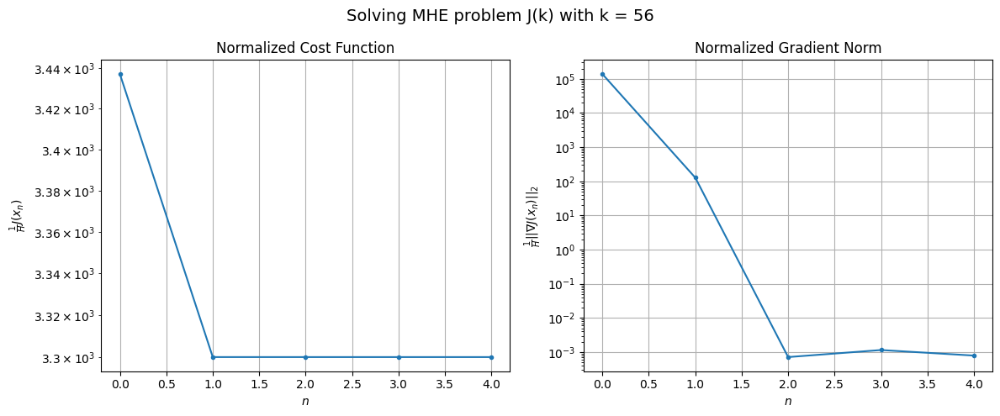

Windows:   8%|▊         | 28/366 [03:22<29:19,  5.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 101719.863973621
Gradient norm: 3990902.6560982014
Global estimation error: 41.75150243218104
Initial conditions estimation errors: 10.674349907712969 m, 14.1138586352808 m, 21.244725691709792 m, 31.28393213418776 m
Position estimation errors: 15.515837593520123 m, 13.471907534938426 m, 11.711828530022741 m, 20.206161397687122 m

[Gauss-Newton] Iteration 1
Cost function: 97471.4197060007 (-4.18%)
Gradient norm: 3290.725919836557 (-99.92%)
Global estimation error: 30.316272373340443 (-27.39%)
Initial conditions estimation errors: 13.750559792732199 m, 13.569552832644199 m, 14.258544880975776 m, 18.507791630909836 m
Position estimation errors: 13.015920042303724 m, 10.918757024765009 m, 15.158000349915024 m, 15.006908034654444 m

[Gauss-Newton] Iteration 2
Cost function: 97471.3295633687 (-0.00%)
Gradient norm: 0.06383929407252067 (-100.00%)
Global estimation error: 30.349927596529366 (0.11%)
Initial conditions estimation errors

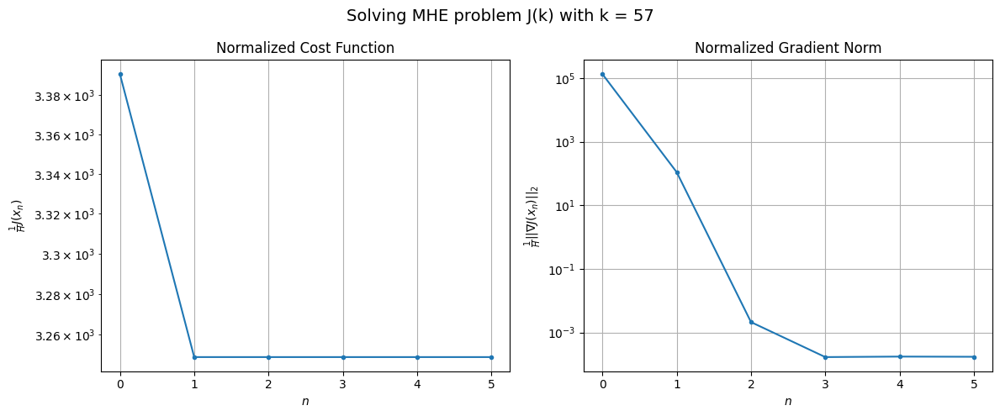

Windows:   8%|▊         | 29/366 [03:27<27:56,  4.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 99961.78096987147
Gradient norm: 3977566.6613415494
Global estimation error: 25.097442040513858
Initial conditions estimation errors: 10.771967947515774 m, 11.153231309949918 m, 12.008872006769021 m, 15.659501215985838 m
Position estimation errors: 15.585587236953263 m, 13.418865282359622 m, 17.40933701083385 m, 17.351262975101758 m

[Gauss-Newton] Iteration 1
Cost function: 95648.85568084993 (-4.31%)
Gradient norm: 60.025691522777805 (-100.00%)
Global estimation error: 35.72044435820966 (42.33%)
Initial conditions estimation errors: 13.817397758475394 m, 13.93631008414361 m, 18.338330701211724 m, 23.54768289536971 m
Position estimation errors: 13.001675478434457 m, 10.077604282985549 m, 15.880736776747396 m, 15.187575985119457 m

[Gauss-Newton] Iteration 2
Cost function: 95648.85562630414 (-0.00%)
Gradient norm: 0.013921759856214445 (-99.98%)
Global estimation error: 35.731237967109635 (0.03%)
Initial conditions estimation er

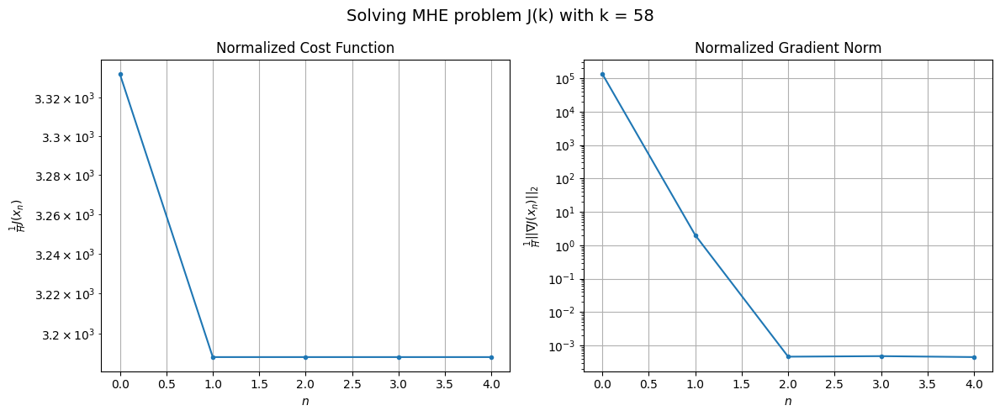

Windows:   8%|▊         | 30/366 [03:31<26:24,  4.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 97793.40718328053
Gradient norm: 3926291.522925619
Global estimation error: 31.689834433209374
Initial conditions estimation errors: 10.994814668629799 m, 11.700264886102698 m, 16.905626628926463 m, 21.4626742118451 m
Position estimation errors: 15.564651456138467 m, 12.617117389743285 m, 17.982576767829286 m, 17.17754795177843 m

[Gauss-Newton] Iteration 1
Cost function: 93435.49412009347 (-4.46%)
Gradient norm: 700.7745817337048 (-99.98%)
Global estimation error: 46.32405272624218 (46.18%)
Initial conditions estimation errors: 13.974574627551704 m, 13.295455414641335 m, 26.440478632442364 m, 32.78325347930354 m
Position estimation errors: 12.879937104426391 m, 9.554753296245197 m, 22.707821698558494 m, 25.33056978765151 m

[Gauss-Newton] Iteration 2
Cost function: 93435.49140770764 (-0.00%)
Gradient norm: 0.044335322939220684 (-99.99%)
Global estimation error: 46.273382531899315 (-0.11%)
Initial conditions estimation errors:

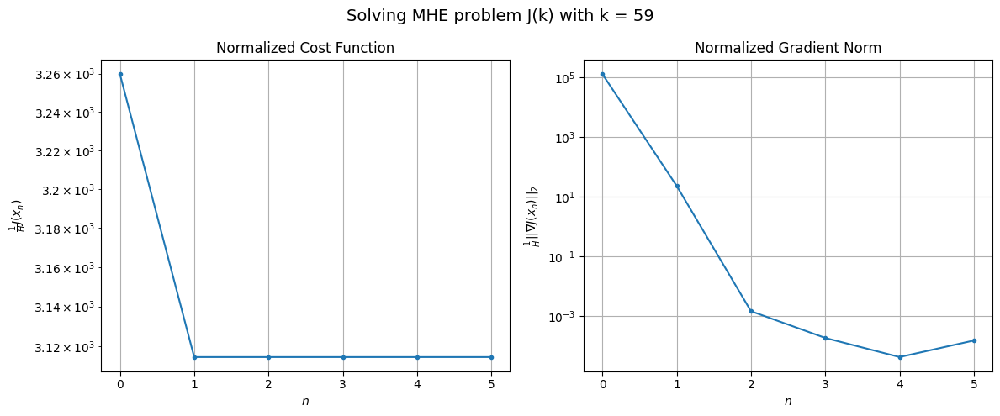

Windows:   8%|▊         | 31/366 [03:35<25:47,  4.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 95231.78569946635
Gradient norm: 3989375.73310015
Global estimation error: 44.72630416208462
Initial conditions estimation errors: 11.350630832686042 m, 11.100140523708852 m, 26.007412575220126 m, 32.741299309191334 m
Position estimation errors: 15.427907501348303 m, 12.18922081332746 m, 23.887452020510796 m, 25.570157454588557 m

[Gauss-Newton] Iteration 1
Cost function: 90827.65897148615 (-4.62%)
Gradient norm: 3497.9986139055054 (-99.91%)
Global estimation error: 31.675535256382858 (-29.18%)
Initial conditions estimation errors: 14.248936744069567 m, 15.323599997117357 m, 13.216088630330741 m, 19.768977656575395 m
Position estimation errors: 12.63873415256441 m, 12.122948257638642 m, 9.578603311041457 m, 14.865692270414653 m

[Gauss-Newton] Iteration 2
Cost function: 90827.58795206332 (-0.00%)
Gradient norm: 0.0489195843755276 (-100.00%)
Global estimation error: 31.71307865862183 (0.12%)
Initial conditions estimation errors

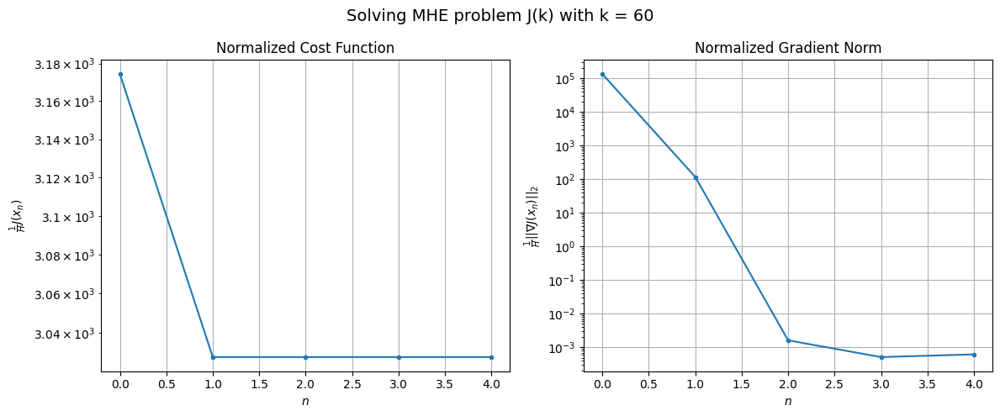

Windows:   9%|▊         | 32/366 [03:39<25:05,  4.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 92016.10621018504
Gradient norm: 3929607.802301482
Global estimation error: 26.15636673891037
Initial conditions estimation errors: 11.789079902227032 m, 13.542403975253915 m, 10.944869472555402 m, 15.555509404489287 m
Position estimation errors: 15.163363727534 m, 14.413921304161699 m, 12.174060524651466 m, 16.95004894013695 m

[Gauss-Newton] Iteration 1
Cost function: 87656.98048578373 (-4.74%)
Gradient norm: 2972.4661318617405 (-99.92%)
Global estimation error: 54.36755949875749 (107.86%)
Initial conditions estimation errors: 14.608105092517375 m, 13.480361740911967 m, 31.524586828517247 m, 39.58411142560433 m
Position estimation errors: 12.322733546740714 m, 10.589305670215712 m, 20.927734690852123 m, 21.255597603700295 m

[Gauss-Newton] Iteration 2
Cost function: 87656.91592667448 (-0.00%)
Gradient norm: 0.3502266335959295 (-99.99%)
Global estimation error: 54.205384554412106 (-0.30%)
Initial conditions estimation errors:

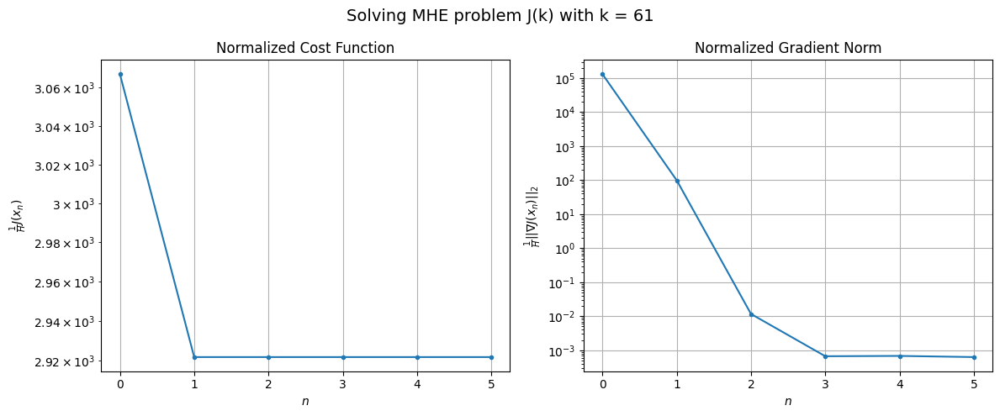

Windows:   9%|▉         | 33/366 [03:44<25:39,  4.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 88018.8018811841
Gradient norm: 3927648.9315528898
Global estimation error: 52.05597428807236
Initial conditions estimation errors: 12.23660584406424 m, 11.267387709864042 m, 30.868124841002544 m, 38.47447934430361 m
Position estimation errors: 14.832859011946384 m, 13.146967270356333 m, 22.485357452978512 m, 21.925496825785117 m

[Gauss-Newton] Iteration 1
Cost function: 83676.5718880198 (-4.93%)
Gradient norm: 213.95229008655775 (-99.99%)
Global estimation error: 53.623786837755375 (3.01%)
Initial conditions estimation errors: 15.00953530087741 m, 13.991547863696455 m, 31.056907593844908 m, 38.599466818704265 m
Position estimation errors: 11.950801943831282 m, 11.158304308154749 m, 15.041882508770376 m, 12.179024350269023 m

[Gauss-Newton] Iteration 2
Cost function: 83676.57169928013 (-0.00%)
Gradient norm: 0.045661902151289346 (-99.98%)
Global estimation error: 53.70765058752353 (0.16%)
Initial conditions estimation errors:

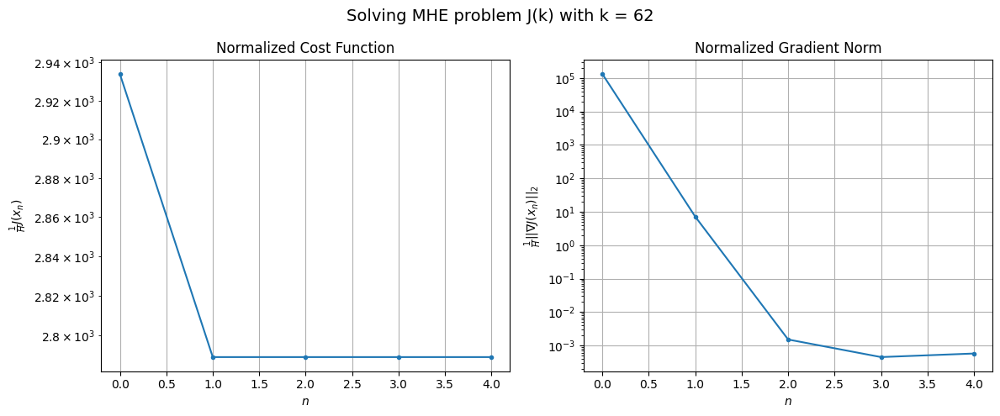

Windows:   9%|▉         | 34/366 [03:49<25:17,  4.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 83187.74292515968
Gradient norm: 4015284.2869285624
Global estimation error: 50.43895609978987
Initial conditions estimation errors: 12.61801640291861 m, 11.716195426891684 m, 30.01697514892043 m, 36.695742449046634 m
Position estimation errors: 14.485165039782181 m, 13.679143334176175 m, 17.35216351772054 m, 14.2283938414726 m

[Gauss-Newton] Iteration 1
Cost function: 78850.71610572138 (-5.21%)
Gradient norm: 587.0331835233025 (-99.99%)
Global estimation error: 57.54303869514621 (14.08%)
Initial conditions estimation errors: 15.36283125122792 m, 14.694092008405821 m, 34.32053011764715 m, 41.00440595281187 m
Position estimation errors: 11.578484933107095 m, 11.09515365867341 m, 15.197436204203239 m, 20.765398642735633 m

[Gauss-Newton] Iteration 2
Cost function: 78850.71481688079 (-0.00%)
Gradient norm: 0.05460913153637858 (-99.99%)
Global estimation error: 57.460589448464 (-0.14%)
Initial conditions estimation errors: 15.362

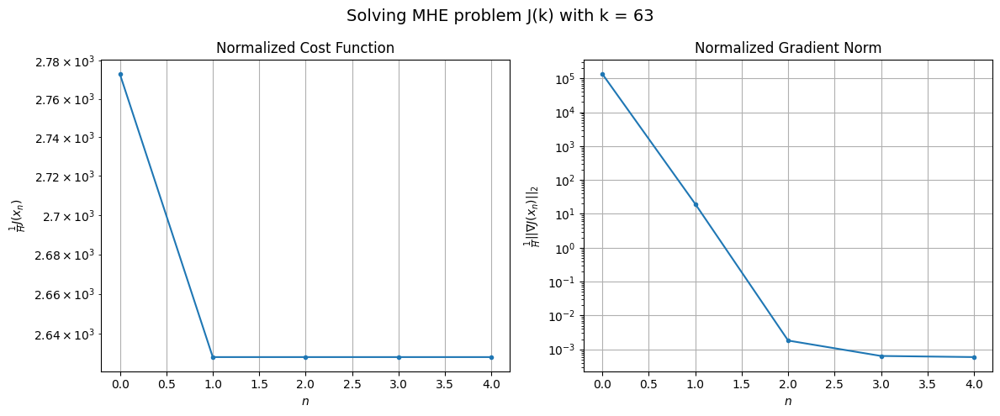

Windows:  10%|▉         | 35/366 [03:53<24:31,  4.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 77341.74787891288
Gradient norm: 4093004.5636114953
Global estimation error: 55.2744447940069
Initial conditions estimation errors: 12.826862381444185 m, 12.264778940173457 m, 33.27167153440878 m, 40.414101153446886 m
Position estimation errors: 14.215322283875516 m, 13.736994558700552 m, 16.2326590928225 m, 20.511980905442883 m

[Gauss-Newton] Iteration 1
Cost function: 72907.6552465047 (-5.73%)
Gradient norm: 110.28875205382754 (-100.00%)
Global estimation error: 54.22697101410755 (-1.90%)
Initial conditions estimation errors: 15.59959242063325 m, 16.148035717933492 m, 31.915490636552292 m, 37.65436367363743 m
Position estimation errors: 11.270741357115742 m, 10.756195644422425 m, 8.496464464617675 m, 14.077679149675003 m

[Gauss-Newton] Iteration 2
Cost function: 72907.65515375098 (-0.00%)
Gradient norm: 0.00605205063947069 (-99.99%)
Global estimation error: 54.242895523627695 (0.03%)
Initial conditions estimation errors: 1

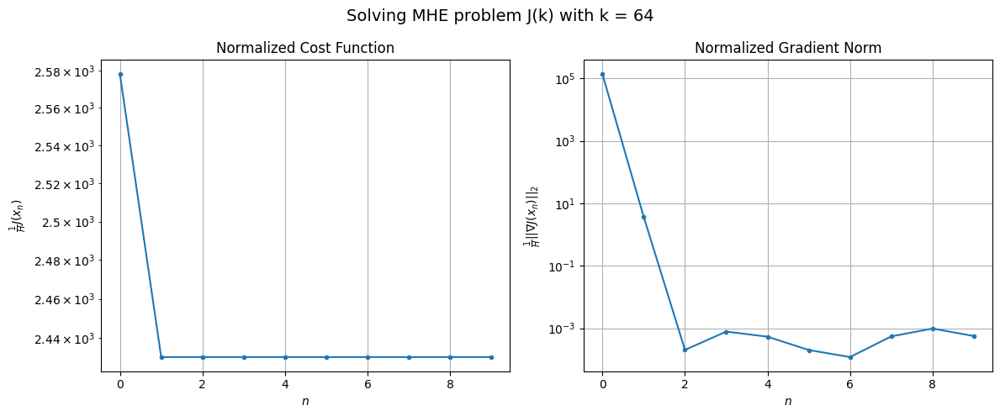

Windows:  10%|▉         | 36/366 [04:00<28:48,  5.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 70439.75228579517
Gradient norm: 4190274.2230363
Global estimation error: 50.89665769549842
Initial conditions estimation errors: 12.816225184965427 m, 13.489241960117385 m, 30.224789247436107 m, 36.478871054071156 m
Position estimation errors: 14.116621932938857 m, 13.517234109103406 m, 9.58146288281002 m, 13.97564920372018 m

[Gauss-Newton] Iteration 1
Cost function: 66044.33516306353 (-6.24%)
Gradient norm: 318.5446539201858 (-99.99%)
Global estimation error: 55.722484191441836 (9.48%)
Initial conditions estimation errors: 15.577665633490584 m, 14.123347223273166 m, 32.81608017398302 m, 39.82409663953837 m
Position estimation errors: 11.181009820348836 m, 12.66241790108763 m, 11.405476392152085 m, 25.175388701414306 m

[Gauss-Newton] Iteration 2
Cost function: 66044.33480437934 (-0.00%)
Gradient norm: 0.03820035468604255 (-99.99%)
Global estimation error: 55.80995511228653 (0.16%)
Initial conditions estimation errors: 15.57

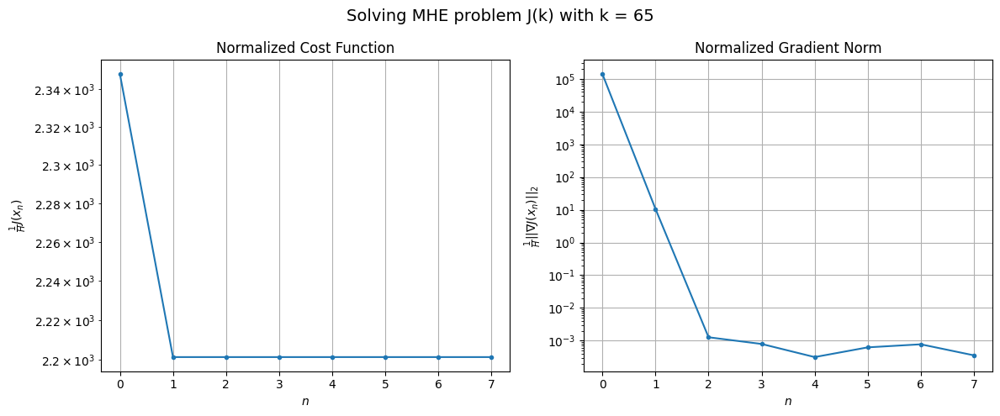

Windows:  10%|█         | 37/366 [04:06<30:08,  5.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 64030.3461067304
Gradient norm: 4431739.4153787065
Global estimation error: 52.84834760195222
Initial conditions estimation errors: 12.502573673232849 m, 11.253147286010105 m, 31.099562557999512 m, 39.27859738596391 m
Position estimation errors: 14.35442366560637 m, 15.595520333754374 m, 11.496323048051199 m, 24.52480252054196 m

[Gauss-Newton] Iteration 1
Cost function: 59583.181589128246 (-6.95%)
Gradient norm: 410.4446431185587 (-99.99%)
Global estimation error: 65.35253834880733 (23.66%)
Initial conditions estimation errors: 15.259240234829651 m, 11.642135325434174 m, 37.8313418579791 m, 49.71267688531263 m
Position estimation errors: 11.376005656110594 m, 13.47907649408615 m, 15.344398306385521 m, 34.08663239614374 m

[Gauss-Newton] Iteration 2
Cost function: 59583.18050929504 (-0.00%)
Gradient norm: 0.11404584948989421 (-99.97%)
Global estimation error: 65.50408439491792 (0.23%)
Initial conditions estimation errors: 15.2

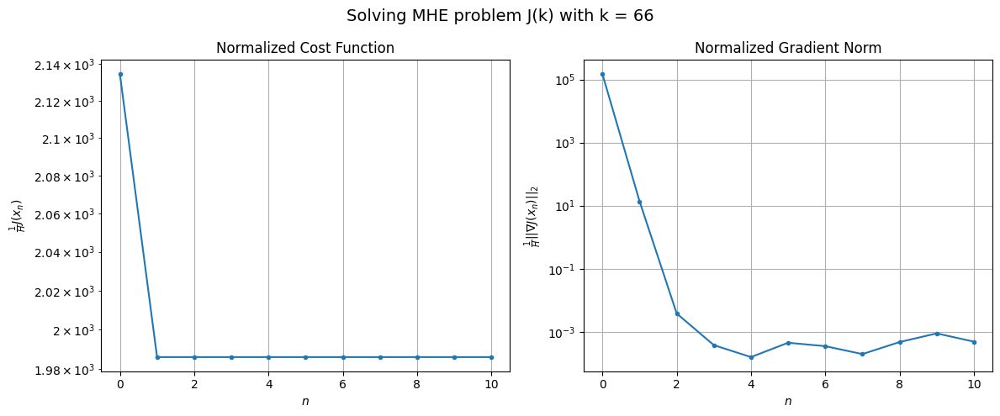

Windows:  10%|█         | 38/366 [04:14<33:57,  6.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 59472.24330128085
Gradient norm: 4885472.951478859
Global estimation error: 63.35003536269982
Initial conditions estimation errors: 11.910524461587501 m, 8.571110472296604 m, 36.35386967877059 m, 49.76232247534099 m
Position estimation errors: 14.968050706131521 m, 16.879649565361017 m, 15.247225880990632 m, 32.68737211462885 m

[Gauss-Newton] Iteration 1
Cost function: 54898.97570506863 (-7.69%)
Gradient norm: 4272.807623313893 (-99.91%)
Global estimation error: 36.265725564828145 (-42.75%)
Initial conditions estimation errors: 14.650096551323928 m, 12.65345939989663 m, 20.588584821679508 m, 22.728000862136927 m
Position estimation errors: 11.880884241999274 m, 13.094113031605186 m, 4.860795315422635 m, 7.124162031086229 m

[Gauss-Newton] Iteration 2
Cost function: 54898.87487549188 (-0.00%)
Gradient norm: 1.5694838888394278 (-99.96%)
Global estimation error: 35.86285870404788 (-1.11%)
Initial conditions estimation errors: 14

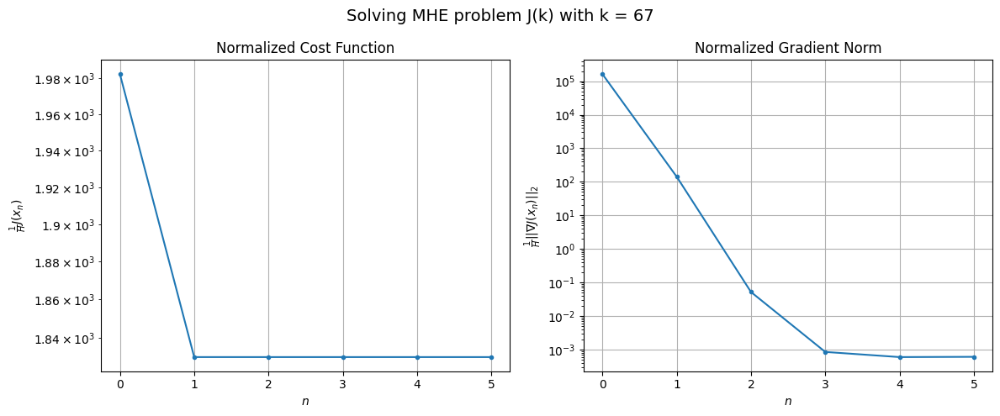

Windows:  11%|█         | 39/366 [04:19<32:12,  5.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 57345.1456144308
Gradient norm: 5274791.57926455
Global estimation error: 28.998050727098732
Initial conditions estimation errors: 11.111161003190462 m, 9.378526564168201 m, 16.90210095265461 m, 18.54119510949628 m
Position estimation errors: 15.91766359904015 m, 16.890322070356913 m, 7.385691781572375 m, 6.89042723951658 m

[Gauss-Newton] Iteration 1
Cost function: 52700.463442429376 (-8.10%)
Gradient norm: 1671.6120176110535 (-99.97%)
Global estimation error: 22.605263668247748 (-22.05%)
Initial conditions estimation errors: 13.81443195487582 m, 11.698679207685617 m, 10.581177370163289 m, 8.4448554407103 m
Position estimation errors: 12.732025071194172 m, 14.532163225978554 m, 13.188828522445787 m, 27.837625998659643 m

[Gauss-Newton] Iteration 2
Cost function: 52700.4477663588 (-0.00%)
Gradient norm: 0.6007061118700081 (-99.96%)
Global estimation error: 22.593642898099024 (-0.05%)
Initial conditions estimation errors: 13.81

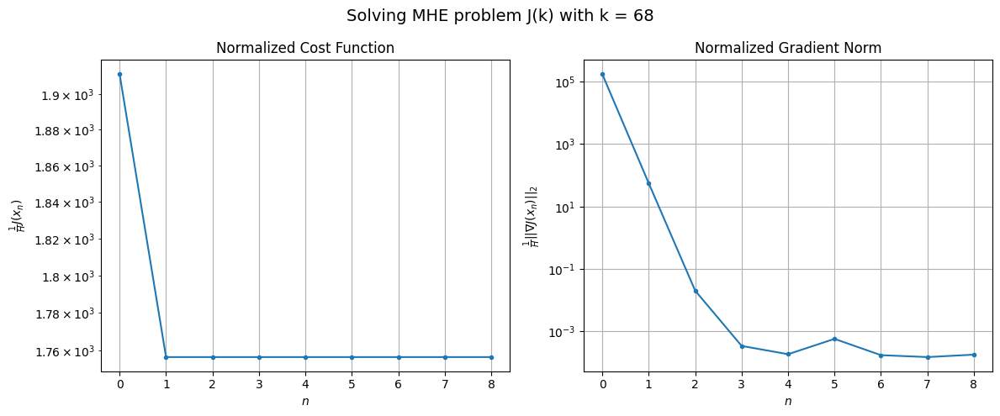

Windows:  11%|█         | 40/366 [04:26<33:03,  6.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 57611.053996262744
Gradient norm: 5737475.368601386
Global estimation error: 17.135703521870358
Initial conditions estimation errors: 10.212668683398707 m, 8.37112790076025 m, 7.1448853441651385 m, 8.257548623687619 m
Position estimation errors: 17.17949542573929 m, 18.683691887636872 m, 12.676142419261678 m, 25.437734572648587 m

[Gauss-Newton] Iteration 1
Cost function: 52664.20894792964 (-8.59%)
Gradient norm: 131.57427245171655 (-100.00%)
Global estimation error: 20.482382670512987 (19.53%)
Initial conditions estimation errors: 12.954770953981138 m, 9.761733089911681 m, 10.400289180509443 m, 6.944305587388532 m
Position estimation errors: 13.819037925844288 m, 16.60574516708276 m, 11.47162723626305 m, 20.56008847424432 m

[Gauss-Newton] Iteration 2
Cost function: 52664.20884518657 (-0.00%)
Gradient norm: 0.02535442690445946 (-99.98%)
Global estimation error: 20.497559363207554 (0.07%)
Initial conditions estimation errors: 

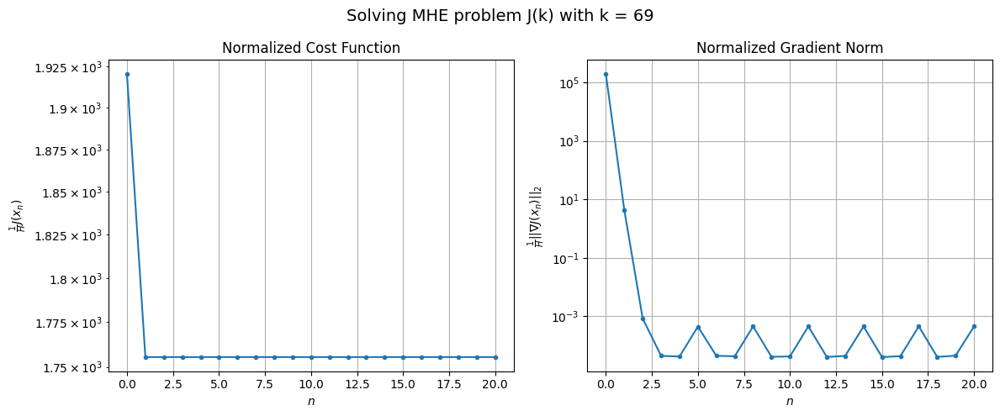

Windows:  11%|█         | 41/366 [04:40<46:59,  8.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 61586.795767803866
Gradient norm: 6244429.945916443
Global estimation error: 14.821598595423806
Initial conditions estimation errors: 9.417905846112475 m, 6.697249253616176 m, 6.924144960731136 m, 6.1780130531173105 m
Position estimation errors: 18.59616296648379 m, 21.11682589800817 m, 9.973373498409423 m, 17.587770440064613 m

[Gauss-Newton] Iteration 1
Cost function: 56348.6922479178 (-8.51%)
Gradient norm: 86.1258333874451 (-100.00%)
Global estimation error: 19.304460922928236 (30.25%)
Initial conditions estimation errors: 12.16106875170654 m, 9.373720883798292 m, 8.117040088997452 m, 8.426005777637764 m
Position estimation errors: 15.048259078201825 m, 15.934962492297508 m, 10.183158216034457 m, 20.104618394474087 m

[Gauss-Newton] Iteration 2
Cost function: 56348.692203712155 (-0.00%)
Gradient norm: 0.012376472563560434 (-99.99%)
Global estimation error: 19.299115595434117 (-0.03%)
Initial conditions estimation errors: 1

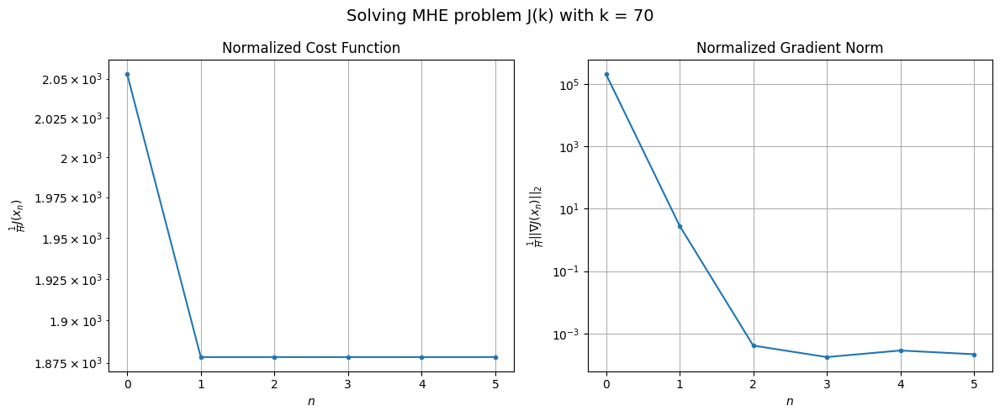

Windows:  11%|█▏        | 42/366 [04:45<40:24,  7.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 69098.71315439891
Gradient norm: 6691203.324634483
Global estimation error: 15.400722601425198
Initial conditions estimation errors: 8.77958819103628 m, 6.353798846476843 m, 5.6975996135360685 m, 9.34084389910978 m
Position estimation errors: 20.086553362468948 m, 20.851470428301457 m, 11.09994618610946 m, 18.152846167229697 m

[Gauss-Newton] Iteration 1
Cost function: 63535.285858259376 (-8.05%)
Gradient norm: 2407.961678379106 (-99.96%)
Global estimation error: 36.90762694651316 (139.65%)
Initial conditions estimation errors: 11.518116352068745 m, 15.842608270864961 m, 15.09257424643236 m, 27.398983900983012 m
Position estimation errors: 16.35171459938381 m, 13.612200667455044 m, 18.978219235010236 m, 46.544830310360084 m

[Gauss-Newton] Iteration 2
Cost function: 63535.254614876154 (-0.00%)
Gradient norm: 0.1079439986797949 (-100.00%)
Global estimation error: 36.97455412274621 (0.18%)
Initial conditions estimation errors: 1

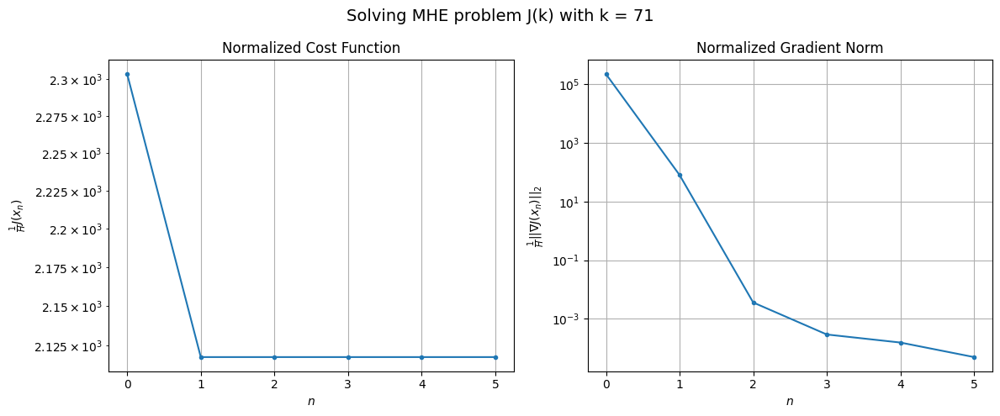

Windows:  12%|█▏        | 43/366 [04:50<35:29,  6.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 79947.03574243451
Gradient norm: 6963559.077913363
Global estimation error: 39.78770284033371
Initial conditions estimation errors: 8.348713652209726 m, 12.680410981559678 m, 17.170127855462606 m, 32.52278934062545 m
Position estimation errors: 21.587628255989458 m, 18.538764464714685 m, 19.840114934564294 m, 43.103634412300195 m

[Gauss-Newton] Iteration 1
Cost function: 74090.50089141479 (-7.33%)
Gradient norm: 970.1936480132185 (-99.99%)
Global estimation error: 28.730712959658938 (-27.79%)
Initial conditions estimation errors: 11.102134625650741 m, 12.395616720120566 m, 11.230918213113522 m, 20.55220882968438 m
Position estimation errors: 17.71798962266622 m, 16.469962023774507 m, 14.558826388431179 m, 27.133891372330574 m

[Gauss-Newton] Iteration 2
Cost function: 74090.49578224187 (-0.00%)
Gradient norm: 0.030102434593841213 (-100.00%)
Global estimation error: 28.699478895992446 (-0.11%)
Initial conditions estimation err

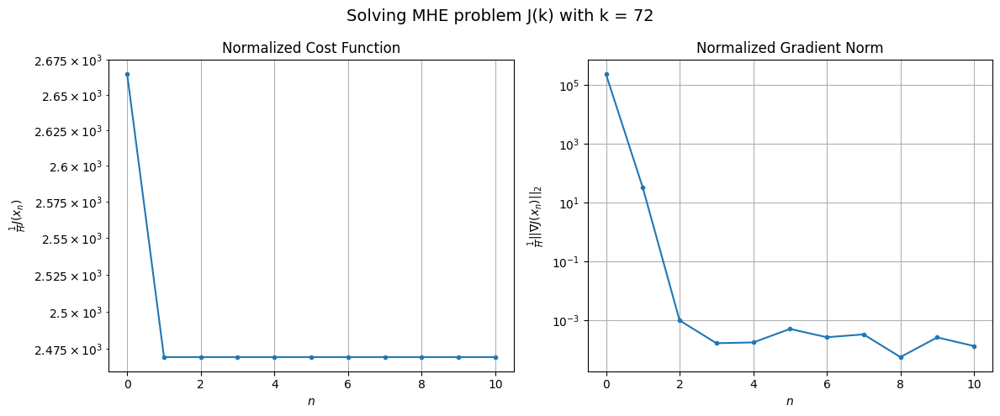

Windows:  12%|█▏        | 44/366 [04:58<39:05,  7.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 94537.7501561486
Gradient norm: 7247879.412971656
Global estimation error: 29.010856753374338
Initial conditions estimation errors: 8.176429111706373 m, 9.409279513250977 m, 11.772620795523734 m, 23.40155370059036 m
Position estimation errors: 23.081262150843425 m, 21.78725561605833 m, 18.043602443252567 m, 26.862464337009595 m

[Gauss-Newton] Iteration 1
Cost function: 88198.8597058587 (-6.71%)
Gradient norm: 314.4720355721521 (-100.00%)
Global estimation error: 25.40148991384423 (-12.44%)
Initial conditions estimation errors: 10.981089166039336 m, 11.022600355373465 m, 9.479892494693624 m, 17.699503724373198 m
Position estimation errors: 19.041658347938387 m, 18.769263473204468 m, 15.224001435881878 m, 18.435108730754155 m

[Gauss-Newton] Iteration 2
Cost function: 88198.85924294488 (-0.00%)
Gradient norm: 0.01772879251160762 (-99.99%)
Global estimation error: 25.353547163989486 (-0.19%)
Initial conditions estimation errors:

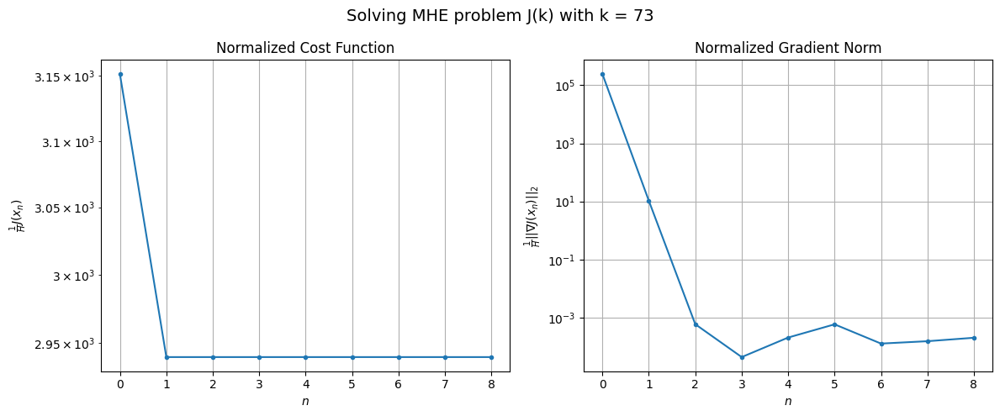

Windows:  12%|█▏        | 45/366 [05:05<38:24,  7.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 112006.47799498728
Gradient norm: 7265997.144006422
Global estimation error: 24.638005669082936
Initial conditions estimation errors: 8.309493544322626 m, 8.348861890045704 m, 8.831501212543014 m, 19.755388584530326 m
Position estimation errors: 24.42725678135765 m, 24.17766187330218 m, 20.05733535530103 m, 22.07337332449141 m

[Gauss-Newton] Iteration 1
Cost function: 105229.63804491458 (-6.05%)
Gradient norm: 805.0980480517717 (-99.99%)
Global estimation error: 20.82002149302053 (-15.50%)
Initial conditions estimation errors: 11.19194611497046 m, 12.496910348166825 m, 8.469609961900277 m, 8.960925893783749 m
Position estimation errors: 20.28337553947201 m, 20.310119307880093 m, 21.66544123456065 m, 21.258467944634813 m

[Gauss-Newton] Iteration 2
Cost function: 105229.6342266605 (-0.00%)
Gradient norm: 0.11492620279824113 (-99.99%)
Global estimation error: 20.817817597669347 (-0.01%)
Initial conditions estimation errors: 11.

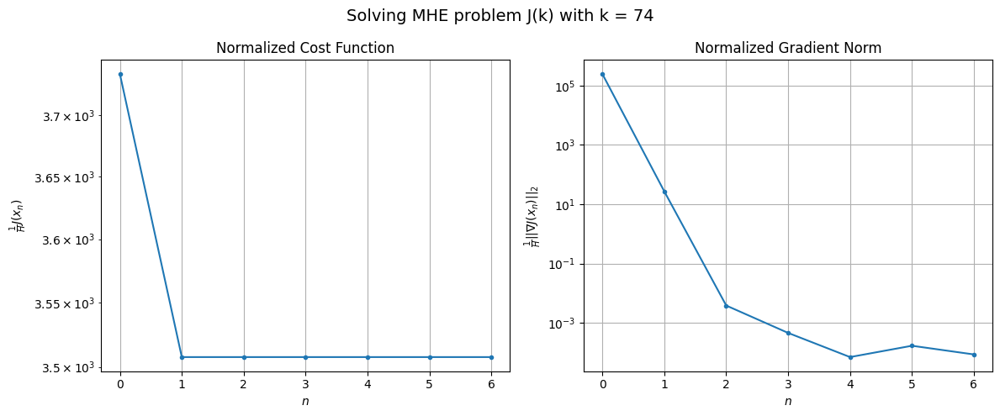

Windows:  13%|█▎        | 46/366 [05:10<34:52,  6.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 131564.1436568687
Gradient norm: 7099721.5120673785
Global estimation error: 16.7286592502617
Initial conditions estimation errors: 8.746666607558303 m, 10.058436063654131 m, 6.189054832417266 m, 7.991335262017122 m
Position estimation errors: 25.60176029265877 m, 25.668506920491602 m, 27.165591733219582 m, 27.31580351442001 m

[Gauss-Newton] Iteration 1
Cost function: 124402.87973044201 (-5.44%)
Gradient norm: 1698.727390742466 (-99.98%)
Global estimation error: 35.15050742069591 (110.12%)
Initial conditions estimation errors: 11.720758433963738 m, 15.329519984749677 m, 13.369024969889617 m, 26.161926576432553 m
Position estimation errors: 21.407101501349587 m, 19.378632897220864 m, 22.925074212984455 m, 26.03797610730562 m

[Gauss-Newton] Iteration 2
Cost function: 124402.86205810227 (-0.00%)
Gradient norm: 0.026834391881813496 (-100.00%)
Global estimation error: 35.113490870655724 (-0.11%)
Initial conditions estimation erro

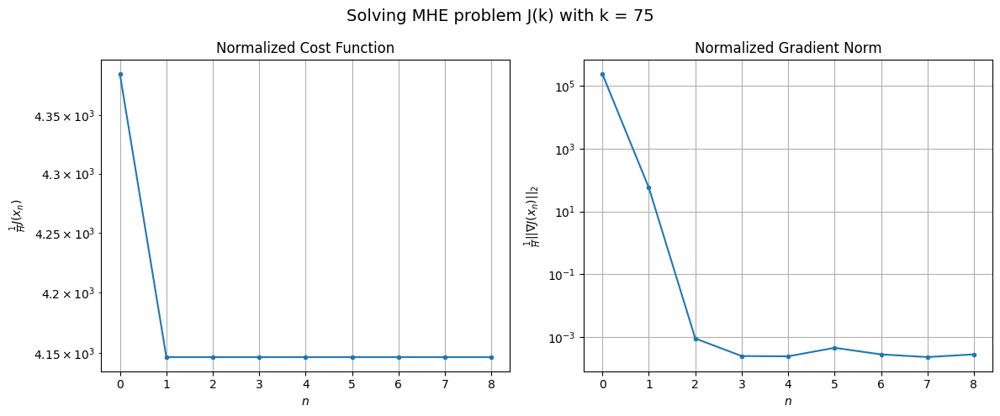

Windows:  13%|█▎        | 47/366 [05:17<34:37,  6.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 152739.2158971045
Gradient norm: 6859249.873524742
Global estimation error: 35.579473882685896
Initial conditions estimation errors: 9.444144582901485 m, 12.980781199115624 m, 13.741770289760021 m, 28.624502357832398 m
Position estimation errors: 26.619938451282973 m, 24.43017734235178 m, 28.37959693457 m, 30.044220624044428 m

[Gauss-Newton] Iteration 1
Cost function: 145151.76252196165 (-4.97%)
Gradient norm: 7290.4993351447665 (-99.89%)
Global estimation error: 22.651225848247353 (-36.34%)
Initial conditions estimation errors: 12.548028244281962 m, 10.955900291621848 m, 12.05147567407358 m, 9.505261861047082 m
Position estimation errors: 22.40378399186618 m, 27.363105783045764 m, 32.39347683833555 m, 57.13032478532917 m

[Gauss-Newton] Iteration 2
Cost function: 145151.53267608368 (-0.00%)
Gradient norm: 1.9640324672753053 (-99.97%)
Global estimation error: 22.701106151362506 (0.22%)
Initial conditions estimation errors: 12

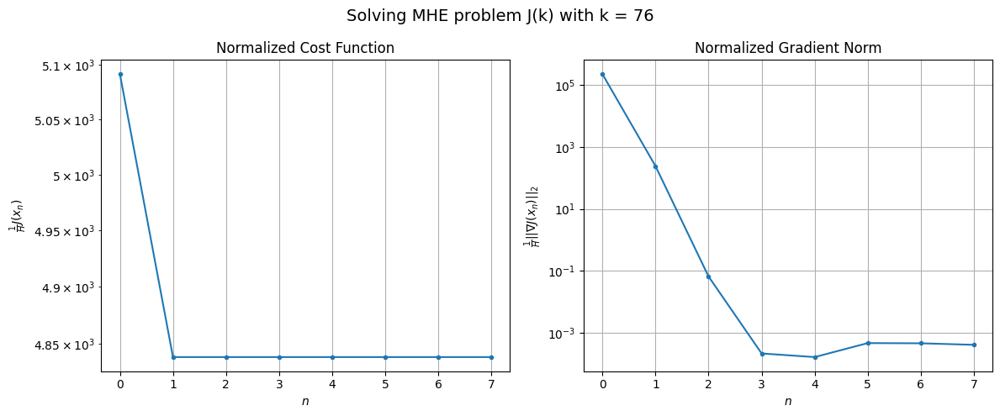

Windows:  13%|█▎        | 48/366 [05:23<33:12,  6.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 175078.95950053626
Gradient norm: 6387075.179464633
Global estimation error: 18.79674429504448
Initial conditions estimation errors: 10.369472169208409 m, 9.016656839858506 m, 9.975241817302287 m, 8.061153064990219 m
Position estimation errors: 27.525049228724 m, 32.557084281147226 m, 37.74176090196352 m, 61.76131130152148 m

[Gauss-Newton] Iteration 1
Cost function: 167033.09633532245 (-4.60%)
Gradient norm: 589.6242835564715 (-99.99%)
Global estimation error: 25.868875366094628 (37.62%)
Initial conditions estimation errors: 13.636800155154864 m, 11.260867925720353 m, 16.722535482086204 m, 8.762443183688076 m
Position estimation errors: 23.30354692417533 m, 30.764402727282214 m, 34.924140111165045 m, 72.28901116792215 m

[Gauss-Newton] Iteration 2
Cost function: 167033.09493995763 (-0.00%)
Gradient norm: 0.02883825172739512 (-100.00%)
Global estimation error: 25.855708317191702 (-0.05%)
Initial conditions estimation errors: 1

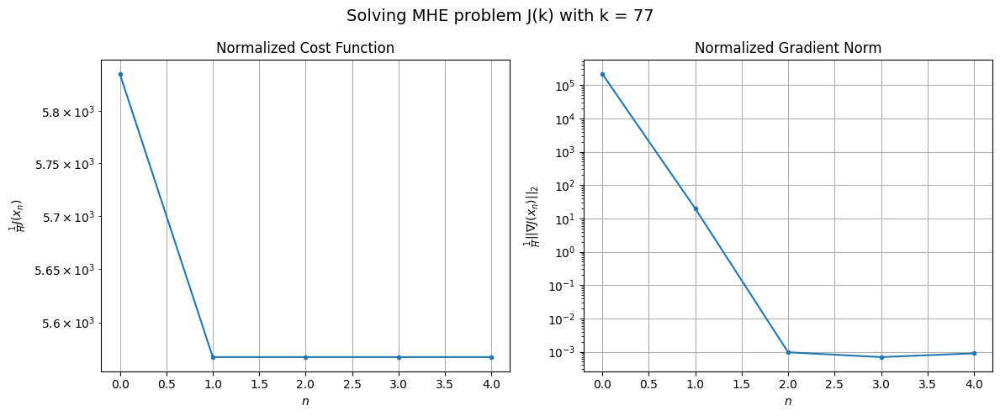

Windows:  13%|█▎        | 49/366 [05:27<30:11,  5.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 198068.05791480138
Gradient norm: 5792597.664994009
Global estimation error: 22.700625926328712
Initial conditions estimation errors: 11.481909698401942 m, 9.404750856554248 m, 15.257175712658045 m, 7.88978267560693 m
Position estimation errors: 28.351221001041505 m, 35.996423100076875 m, 39.949504234639384 m, 76.6116605512936 m

[Gauss-Newton] Iteration 1
Cost function: 189548.44804636447 (-4.30%)
Gradient norm: 59.00507679677597 (-100.00%)
Global estimation error: 33.398830318917724 (47.13%)
Initial conditions estimation errors: 14.950217973995855 m, 11.902922621975348 m, 21.880113659721037 m, 16.478716220308968 m
Position estimation errors: 24.15028772124451 m, 32.7685790684031 m, 34.115916768569825 m, 72.26919137053957 m

[Gauss-Newton] Iteration 2
Cost function: 189548.4479969331 (-0.00%)
Gradient norm: 0.01038310742410291 (-99.98%)
Global estimation error: 33.40647514473776 (0.02%)
Initial conditions estimation errors: 1

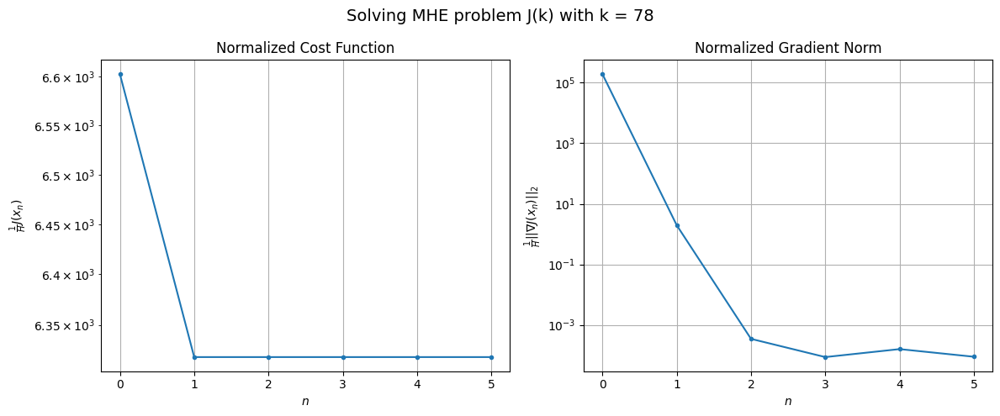

Windows:  14%|█▎        | 50/366 [05:32<29:16,  5.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 220735.45250034414
Gradient norm: 5246988.000395875
Global estimation error: 31.44067794186606
Initial conditions estimation errors: 12.731585220800767 m, 10.066280009471807 m, 20.538139787203708 m, 17.414721009606758 m
Position estimation errors: 29.125667218622155 m, 37.92136479651525 m, 38.73462389807923 m, 75.87536135460758 m

[Gauss-Newton] Iteration 1
Cost function: 211604.7867941663 (-4.14%)
Gradient norm: 1923.2145568391893 (-99.96%)
Global estimation error: 44.81860670767942 (42.55%)
Initial conditions estimation errors: 16.42606532456696 m, 12.924162483137623 m, 31.233399238313776 m, 24.41973078199383 m
Position estimation errors: 24.919929927617407 m, 37.47688352396188 m, 38.919890333887714 m, 99.78557547297571 m

[Gauss-Newton] Iteration 2
Cost function: 211604.77204591065 (-0.00%)
Gradient norm: 0.1563555575511299 (-99.99%)
Global estimation error: 44.913754904338525 (0.21%)
Initial conditions estimation errors: 1

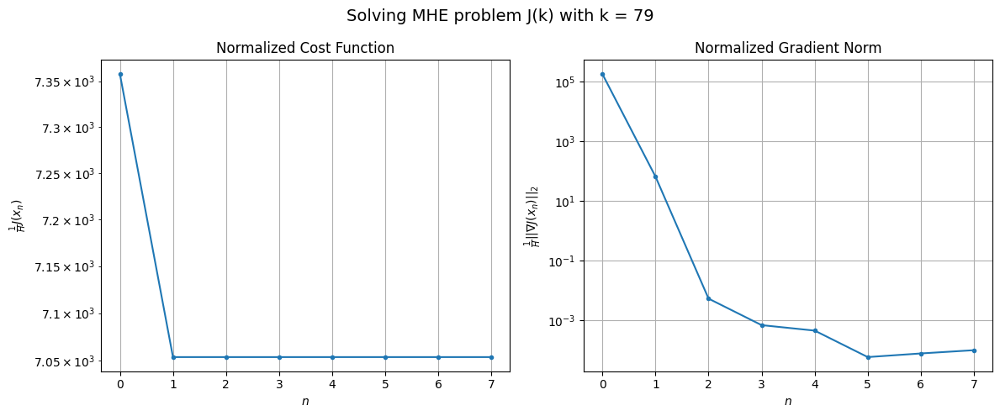

Windows:  14%|█▍        | 51/366 [05:38<29:50,  5.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 242745.22760863364
Gradient norm: 4616597.60330922
Global estimation error: 44.81314215679539
Initial conditions estimation errors: 14.058729455461641 m, 11.13627400877764 m, 30.233935263536477 m, 27.79304186338665 m
Position estimation errors: 29.813152878988884 m, 42.520021278233536 m, 42.89269403716094 m, 102.1632034475652 m

[Gauss-Newton] Iteration 1
Cost function: 232887.40800288907 (-4.06%)
Gradient norm: 11579.750189015018 (-99.75%)
Global estimation error: 44.39518106338887 (-0.93%)
Initial conditions estimation errors: 17.987986213799687 m, 21.052563855020786 m, 19.63235181647845 m, 28.613233782361633 m
Position estimation errors: 25.575273833759038 m, 24.51016324693842 m, 26.202315293702213 m, 28.58872935032363 m

[Gauss-Newton] Iteration 2
Cost function: 232886.87877774052 (-0.00%)
Gradient norm: 0.08644079141506147 (-100.00%)
Global estimation error: 44.34845918590891 (-0.11%)
Initial conditions estimation errors:

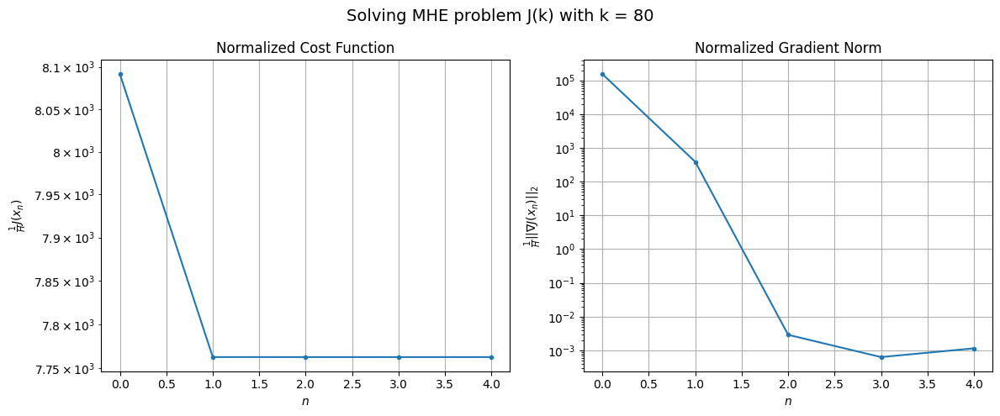

Windows:  14%|█▍        | 52/366 [05:43<28:26,  5.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 263281.59946769656
Gradient norm: 3927453.2681744494
Global estimation error: 39.835852831661064
Initial conditions estimation errors: 15.411072301492416 m, 18.605537280215586 m, 17.562883908361655 m, 26.35840105481127 m
Position estimation errors: 30.390070768669954 m, 29.08605790554727 m, 30.75391136525571 m, 32.73827890397118 m

[Gauss-Newton] Iteration 1
Cost function: 252924.85462988648 (-3.93%)
Gradient norm: 169.67548978614244 (-100.00%)
Global estimation error: 44.06528975140328 (10.62%)
Initial conditions estimation errors: 19.500501547145173 m, 23.97192129447549 m, 18.401873126720712 m, 25.459535532467264 m
Position estimation errors: 26.15090301574366 m, 22.16901894857751 m, 26.139157425793908 m, 23.205877155401176 m

[Gauss-Newton] Iteration 2
Cost function: 252924.85444675747 (-0.00%)
Gradient norm: 0.027460307626339255 (-99.98%)
Global estimation error: 44.03173034451265 (-0.08%)
Initial conditions estimation err

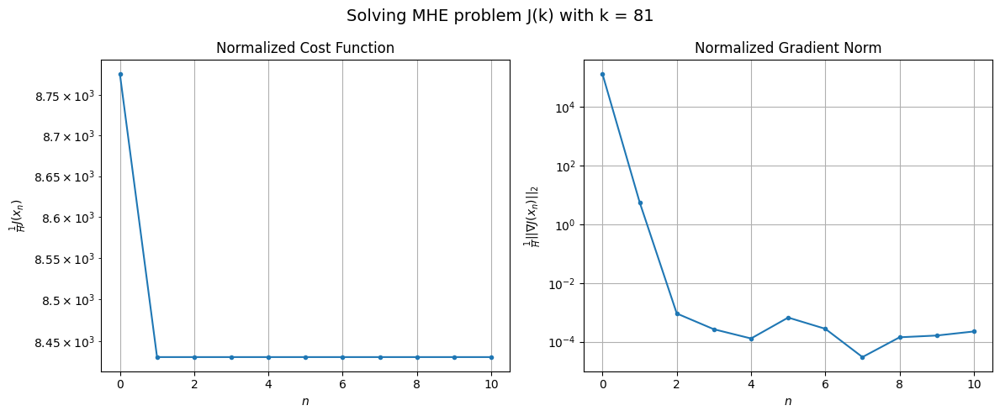

Windows:  14%|█▍        | 53/366 [05:52<33:30,  6.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 280967.6390730793
Gradient norm: 3345249.8656840636
Global estimation error: 38.481114803316785
Initial conditions estimation errors: 16.685552334799013 m, 21.17148408817151 m, 15.956239853837648 m, 22.35049419619733 m
Position estimation errors: 30.918307077204755 m, 26.566021221522345 m, 30.863665896466983 m, 27.532623707002234 m

[Gauss-Newton] Iteration 1
Cost function: 269927.0353845536 (-3.93%)
Gradient norm: 57.13533004479473 (-100.00%)
Global estimation error: 50.541706590978905 (31.34%)
Initial conditions estimation errors: 20.975246663235716 m, 26.492671144418043 m, 21.620652585204425 m, 30.74370856157563 m
Position estimation errors: 26.64646430320827 m, 20.571346527393725 m, 23.970894132010695 m, 16.442834947241774 m

[Gauss-Newton] Iteration 2
Cost function: 269927.0353360126 (-0.00%)
Gradient norm: 0.025188049303416084 (-99.96%)
Global estimation error: 50.586007196758516 (0.09%)
Initial conditions estimation err

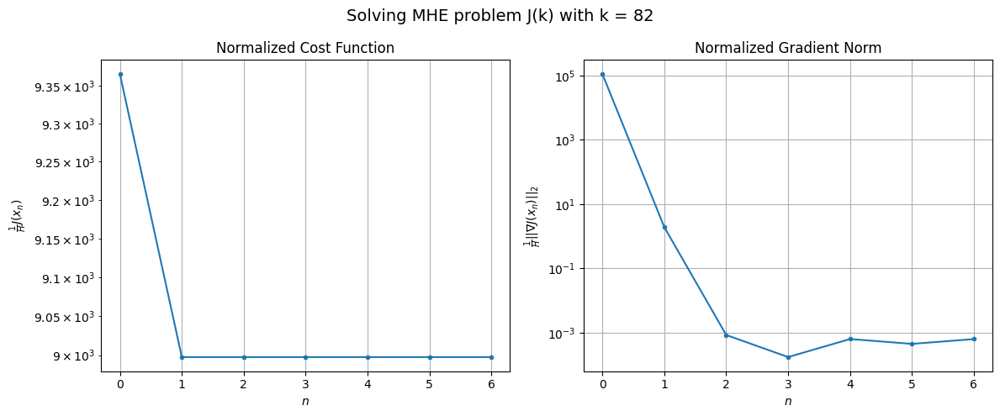

Windows:  15%|█▍        | 54/366 [05:58<32:50,  6.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 297092.05940073327
Gradient norm: 2988034.540257233
Global estimation error: 44.363557651182056
Initial conditions estimation errors: 17.9105021527464 m, 23.399634252135225 m, 18.87593343032641 m, 27.266862881636108 m
Position estimation errors: 31.412375770486612 m, 24.99808042270381 m, 28.711752907580966 m, 20.386679142141148 m

[Gauss-Newton] Iteration 1
Cost function: 285238.9375230817 (-3.99%)
Gradient norm: 21.847131737258863 (-100.00%)
Global estimation error: 49.36352025926193 (11.27%)
Initial conditions estimation errors: 22.37976776588343 m, 27.56947089251705 m, 21.50331290774241 m, 26.709912939233046 m
Position estimation errors: 27.049517756209365 m, 21.15292021244429 m, 26.4147156547135 m, 20.31653315423802 m

[Gauss-Newton] Iteration 2
Cost function: 285238.9374959454 (-0.00%)
Gradient norm: 0.01939237227457622 (-99.91%)
Global estimation error: 49.320315592002856 (-0.09%)
Initial conditions estimation errors: 22

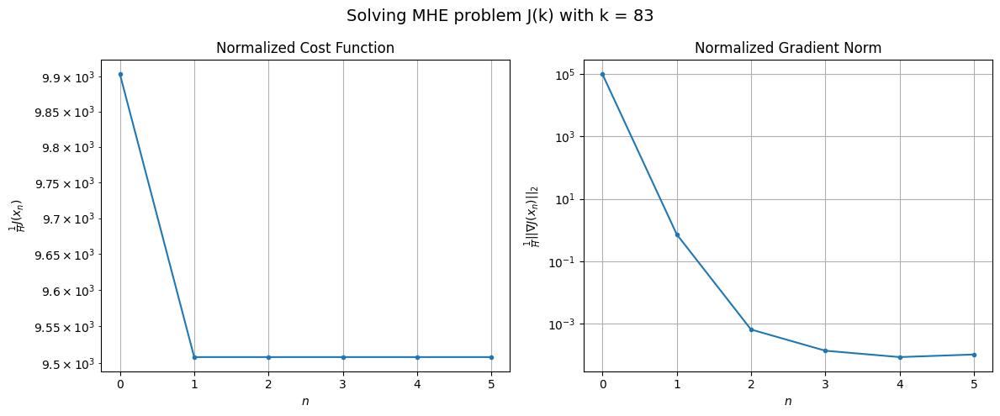

Windows:  15%|█▌        | 55/366 [06:03<30:51,  5.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 310704.93058314396
Gradient norm: 2860495.878605002
Global estimation error: 42.59255830093606
Initial conditions estimation errors: 19.072639067531465 m, 24.16446462972144 m, 18.438180609978463 m, 22.944654303760448 m
Position estimation errors: 31.85834034264024 m, 25.68125088854314 m, 31.346466277683636 m, 24.79516164989324 m

[Gauss-Newton] Iteration 1
Cost function: 298104.4794464412 (-4.06%)
Gradient norm: 67.92628670085787 (-100.00%)
Global estimation error: 53.15680447982812 (24.80%)
Initial conditions estimation errors: 23.67077495751409 m, 28.268886401961105 m, 24.798806449528772 m, 29.1755445878171 m
Position estimation errors: 27.382618083606292 m, 22.616473259637175 m, 26.352862020056573 m, 23.57243395098249 m

[Gauss-Newton] Iteration 2
Cost function: 298104.47943779477 (-0.00%)
Gradient norm: 0.015708872263073107 (-99.98%)
Global estimation error: 53.1620472767109 (0.01%)
Initial conditions estimation errors: 23

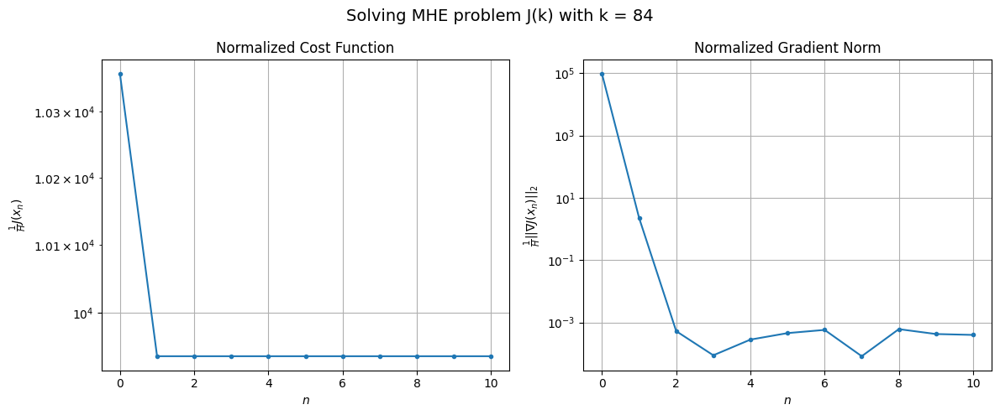

Windows:  15%|█▌        | 56/366 [06:11<33:30,  6.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 321832.4673138704
Gradient norm: 2977617.060331665
Global estimation error: 46.19145841206328
Initial conditions estimation errors: 20.142070719249162 m, 24.693915390145417 m, 21.476885140466642 m, 25.629767135999433 m
Position estimation errors: 32.26586140829327 m, 27.272093673524758 m, 31.219273184685512 m, 28.077595104718068 m

[Gauss-Newton] Iteration 1
Cost function: 308428.2026378849 (-4.16%)
Gradient norm: 16.718836512167933 (-100.00%)
Global estimation error: 51.588479602038944 (11.68%)
Initial conditions estimation errors: 24.863437853506387 m, 28.243531560702902 m, 25.202645560840168 m, 24.704076229491605 m
Position estimation errors: 27.652189728460492 m, 23.71416273988942 m, 27.93925799356253 m, 27.340691890131577 m

[Gauss-Newton] Iteration 2
Cost function: 308428.20261905855 (-0.00%)
Gradient norm: 0.01648737483822173 (-99.90%)
Global estimation error: 51.56398013910179 (-0.05%)
Initial conditions estimation err

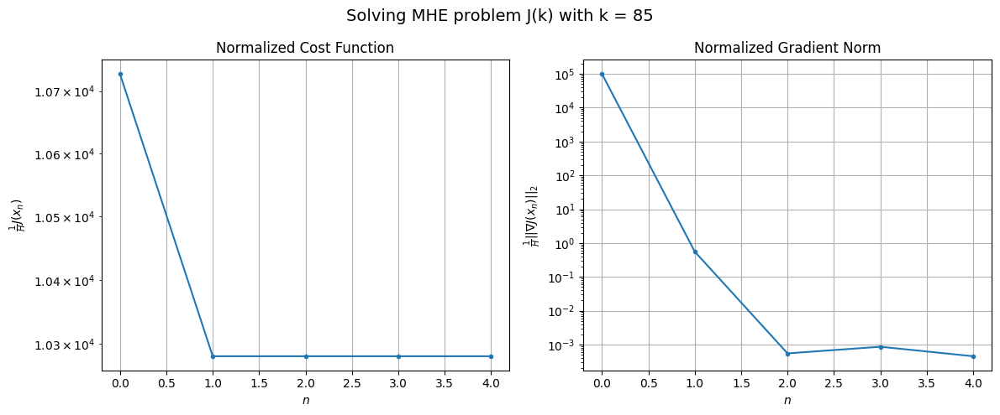

Windows:  16%|█▌        | 57/366 [06:16<30:53,  6.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 330670.5937560177
Gradient norm: 3252060.281263315
Global estimation error: 44.141310800918035
Initial conditions estimation errors: 21.122051267071996 m, 24.423626775681402 m, 21.550786297752875 m, 21.008238318122984 m
Position estimation errors: 32.61311358507514 m, 28.520293550374276 m, 32.92479938880123 m, 32.31112323671846 m

[Gauss-Newton] Iteration 1
Cost function: 316582.8760345119 (-4.26%)
Gradient norm: 40.726339965670476 (-100.00%)
Global estimation error: 51.6406405113548 (16.99%)
Initial conditions estimation errors: 25.92831736429685 m, 27.962476745545988 m, 27.7254328109685 m, 21.067933740949115 m
Position estimation errors: 27.863461923198642 m, 25.144001273690787 m, 27.93646438152005 m, 32.3885883741491 m

[Gauss-Newton] Iteration 2
Cost function: 316582.8760171854 (-0.00%)
Gradient norm: 0.005368938155575511 (-99.99%)
Global estimation error: 51.636640559301576 (-0.01%)
Initial conditions estimation errors: 2

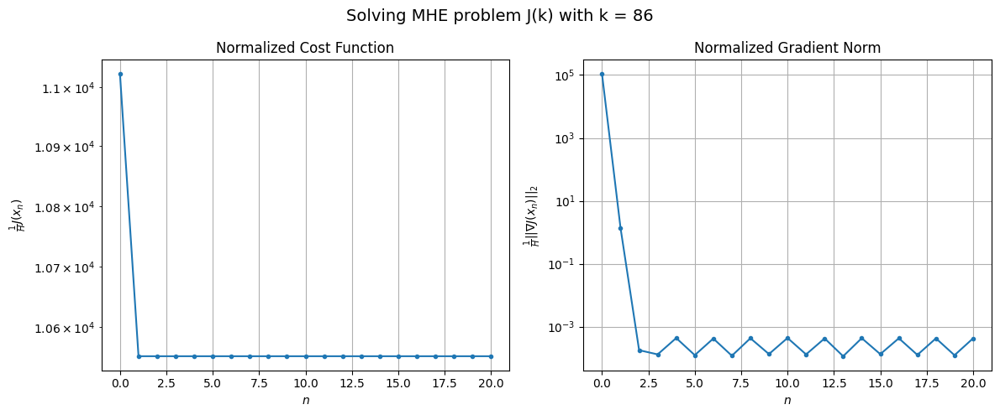

Windows:  16%|█▌        | 58/366 [06:30<44:06,  8.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 335990.75907591125
Gradient norm: 3545694.1462304117
Global estimation error: 43.82599840451176
Initial conditions estimation errors: 21.976698311446107 m, 23.933140937702763 m, 23.648979879462676 m, 17.48295128030843 m
Position estimation errors: 32.87298644573897 m, 30.139364724298765 m, 32.844486811931496 m, 37.750381512835375 m

[Gauss-Newton] Iteration 1
Cost function: 321206.78340373485 (-4.40%)
Gradient norm: 15.39141732132678 (-100.00%)
Global estimation error: 55.70880046038933 (27.11%)
Initial conditions estimation errors: 26.8668685960165 m, 28.364290150527786 m, 29.492696457085806 m, 26.59449938156631 m
Position estimation errors: 27.97451614947169 m, 26.44928454300133 m, 27.284058009478212 m, 31.178988799174874 m

[Gauss-Newton] Iteration 2
Cost function: 321206.7833923065 (-0.00%)
Gradient norm: 0.00931630607428284 (-99.94%)
Global estimation error: 55.726859245393435 (0.03%)
Initial conditions estimation errors:

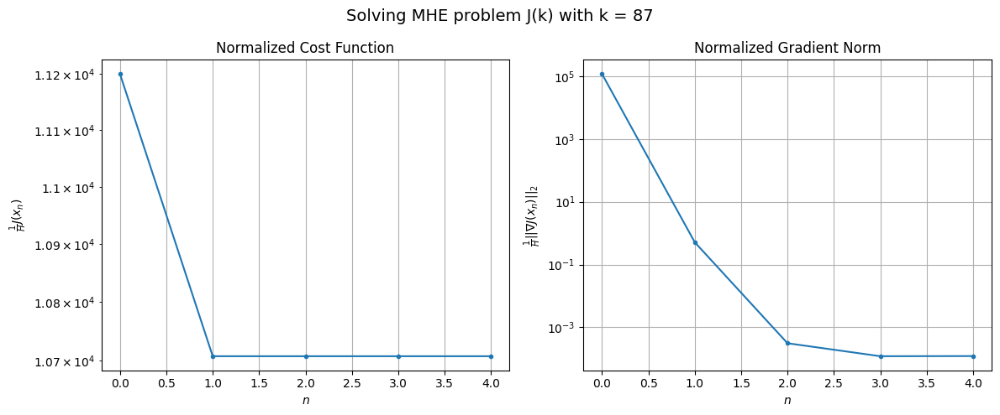

Windows:  16%|█▌        | 59/366 [06:34<36:52,  7.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 339669.67855016934
Gradient norm: 3903398.770996055
Global estimation error: 47.541388069003226
Initial conditions estimation errors: 22.713419039622767 m, 24.192377572649182 m, 25.264031236131967 m, 22.81929363975838 m
Position estimation errors: 32.98044197816288 m, 31.494443592915072 m, 32.1051954357432 m, 36.25385708592074 m

[Gauss-Newton] Iteration 1
Cost function: 324430.9307505301 (-4.49%)
Gradient norm: 47.00420652414381 (-100.00%)
Global estimation error: 54.49828038115717 (14.63%)
Initial conditions estimation errors: 27.627356552035714 m, 27.356824521791594 m, 31.02166811067057 m, 22.27169162112105 m
Position estimation errors: 27.954271081641448 m, 28.21115590121057 m, 27.332580711012422 m, 36.812067782502766 m

[Gauss-Newton] Iteration 2
Cost function: 324430.9307229245 (-0.00%)
Gradient norm: 0.022354136707689144 (-99.95%)
Global estimation error: 54.48305698183916 (-0.03%)
Initial conditions estimation errors: 

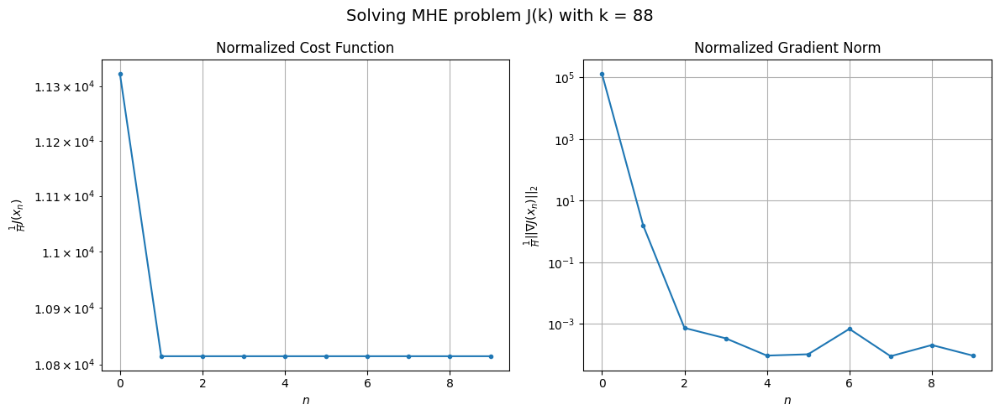

Windows:  16%|█▋        | 60/366 [06:42<37:02,  7.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 340900.1575667357
Gradient norm: 4197567.298778894
Global estimation error: 46.0238798715674
Initial conditions estimation errors: 23.289267464460547 m, 23.016911432386777 m, 26.453730931258125 m, 18.606625673420535 m
Position estimation errors: 32.908976076659286 m, 33.32078150365597 m, 31.911205052128857 m, 42.25817553744523 m

[Gauss-Newton] Iteration 1
Cost function: 325245.6212942153 (-4.59%)
Gradient norm: 143.34784538928497 (-100.00%)
Global estimation error: 52.83458801842675 (14.80%)
Initial conditions estimation errors: 28.227824948102818 m, 27.15494459175414 m, 30.075068320848626 m, 18.781804938614773 m
Position estimation errors: 27.76644461091235 m, 27.025675614799468 m, 27.85476958573507 m, 32.380034161920356 m

[Gauss-Newton] Iteration 2
Cost function: 325245.621178722 (-0.00%)
Gradient norm: 0.008858666525021172 (-99.99%)
Global estimation error: 52.844268847385656 (0.02%)
Initial conditions estimation errors: 

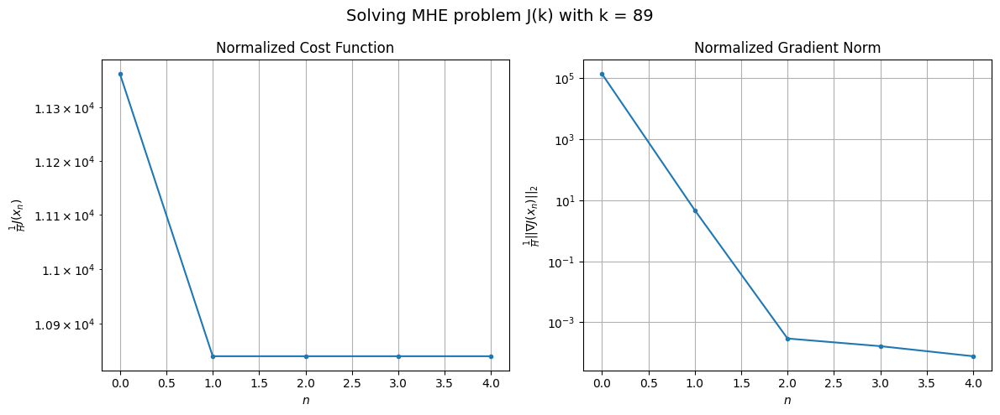

Windows:  17%|█▋        | 61/366 [06:46<32:04,  6.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 338903.5981247772
Gradient norm: 4342111.290113728
Global estimation error: 43.98021583913738
Initial conditions estimation errors: 23.718979768347765 m, 22.55014031805447 m, 25.328344154124235 m, 14.886559167357147 m
Position estimation errors: 32.643596287902355 m, 32.17928593508826 m, 32.49721648426199 m, 38.108958513659765 m

[Gauss-Newton] Iteration 1
Cost function: 323182.25842112815 (-4.64%)
Gradient norm: 145.81045702759886 (-100.00%)
Global estimation error: 50.098377636356155 (13.91%)
Initial conditions estimation errors: 28.634296215166742 m, 25.993020737912598 m, 28.90799490189651 m, 13.363582155597479 m
Position estimation errors: 27.447316776479525 m, 25.57140820616253 m, 29.449557410921813 m, 30.28284945350722 m

[Gauss-Newton] Iteration 2
Cost function: 323182.2582484619 (-0.00%)
Gradient norm: 0.024431701359183263 (-99.98%)
Global estimation error: 50.105950874423534 (0.02%)
Initial conditions estimation error

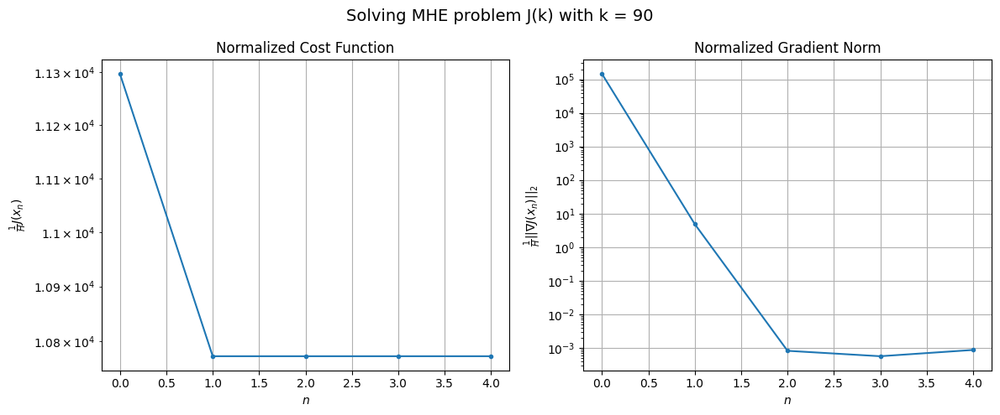

Windows:  17%|█▋        | 62/366 [06:50<29:05,  5.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 334424.27775032126
Gradient norm: 4438218.637861171
Global estimation error: 41.160292770971836
Initial conditions estimation errors: 23.959874772898157 m, 21.07947322257816 m, 23.95268355293649 m, 10.098994193580445 m
Position estimation errors: 32.248648720810856 m, 30.74595186931621 m, 34.08430923019349 m, 36.41037257746087 m

[Gauss-Newton] Iteration 1
Cost function: 318523.81925763394 (-4.75%)
Gradient norm: 336.5279215364112 (-99.99%)
Global estimation error: 55.528162486691166 (34.91%)
Initial conditions estimation errors: 28.87459173398641 m, 26.14454018701153 m, 33.20378553193756 m, 21.530807342151483 m
Position estimation errors: 26.98549164938143 m, 28.12277485934775 m, 25.706086555367506 m, 36.67591171170593 m

[Gauss-Newton] Iteration 2
Cost function: 318523.81848704437 (-0.00%)
Gradient norm: 0.011796950517744922 (-100.00%)
Global estimation error: 55.50778575382093 (-0.04%)
Initial conditions estimation errors: 

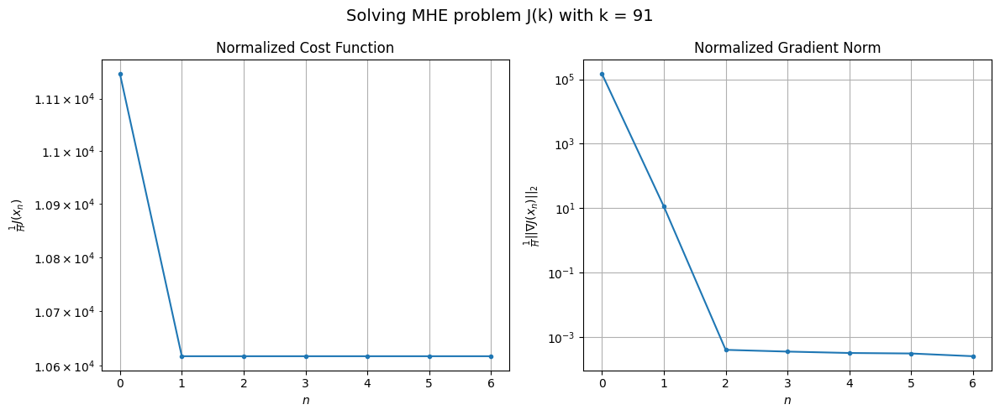

Windows:  17%|█▋        | 63/366 [06:55<28:22,  5.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 326773.4832611751
Gradient norm: 4389700.864874808
Global estimation error: 45.91370293397506
Initial conditions estimation errors: 24.031601820741965 m, 21.25594408728829 m, 27.990538275342672 m, 17.18239416308329 m
Position estimation errors: 31.726589630848427 m, 33.13682422417144 m, 29.93618949371923 m, 42.03715104762854 m

[Gauss-Newton] Iteration 1
Cost function: 311020.48072580714 (-4.82%)
Gradient norm: 81.51987127833573 (-100.00%)
Global estimation error: 58.81396534153049 (28.10%)
Initial conditions estimation errors: 28.904348916487244 m, 27.568129112486332 m, 33.220892438582226 m, 27.56732737082112 m
Position estimation errors: 26.462666735734114 m, 26.76583288696222 m, 24.694311413506643 m, 30.27211653229032 m

[Gauss-Newton] Iteration 2
Cost function: 311020.4806841644 (-0.00%)
Gradient norm: 0.02228090801678583 (-99.97%)
Global estimation error: 58.8105001850017 (-0.01%)
Initial conditions estimation errors: 28.

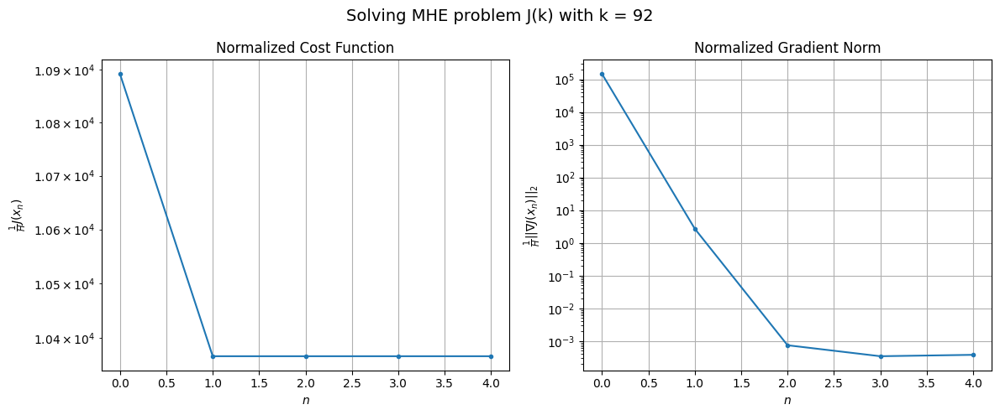

Windows:  17%|█▋        | 64/366 [07:00<26:25,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 317525.534881863
Gradient norm: 4233653.353697357
Global estimation error: 48.60864623710686
Initial conditions estimation errors: 23.90111875824038 m, 22.44726835814108 m, 27.896094886847877 m, 22.570595284776605 m
Position estimation errors: 31.1679760655838 m, 31.645695886580633 m, 28.99334554024747 m, 35.1106987580106 m

[Gauss-Newton] Iteration 1
Cost function: 302088.73438682733 (-4.86%)
Gradient norm: 36.72440020988152 (-100.00%)
Global estimation error: 62.62485529333522 (28.83%)
Initial conditions estimation errors: 28.71166951362729 m, 28.83520838611939 m, 33.06231034865152 m, 34.24748470789074 m
Position estimation errors: 25.943278776393928 m, 25.59511898567271 m, 23.7002755945673 m, 25.430437374208765 m

[Gauss-Newton] Iteration 2
Cost function: 302088.73434627923 (-0.00%)
Gradient norm: 0.024987993027082395 (-99.93%)
Global estimation error: 62.6868511672607 (0.10%)
Initial conditions estimation errors: 28.711669

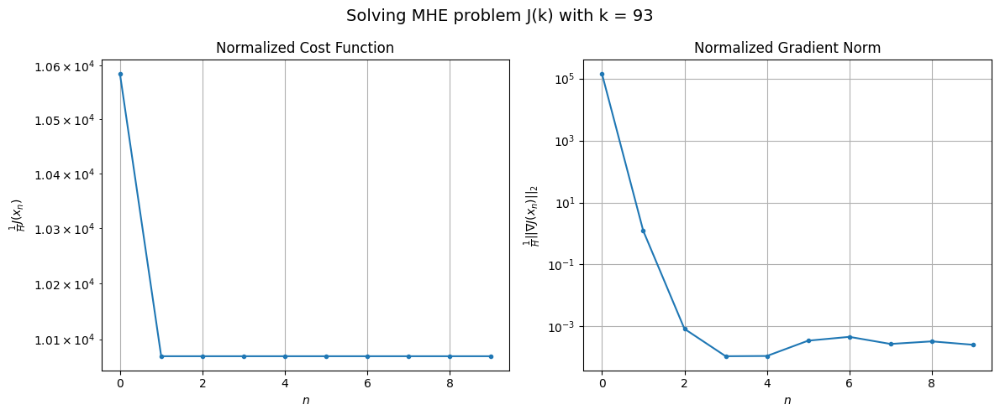

Windows:  18%|█▊        | 65/366 [07:07<30:02,  5.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 307360.7333518386
Gradient norm: 3933492.7131235986
Global estimation error: 52.13617438469771
Initial conditions estimation errors: 23.58087660332251 m, 23.57829662680078 m, 27.677089209012426 m, 28.985003236356082 m
Position estimation errors: 30.631465174878834 m, 30.337041975734216 m, 28.051712550442875 m, 29.68082640262732 m

[Gauss-Newton] Iteration 1
Cost function: 292231.40471198194 (-4.92%)
Gradient norm: 162.23688182057262 (-100.00%)
Global estimation error: 65.74967978420439 (26.11%)
Initial conditions estimation errors: 28.34557193399501 m, 29.987362272296316 m, 32.86948674438571 m, 39.24110106126656 m
Position estimation errors: 25.469243216978956 m, 23.029843266988653 m, 22.695493868461494 m, 16.039504662260416 m

[Gauss-Newton] Iteration 2
Cost function: 292231.4046021021 (-0.00%)
Gradient norm: 0.012530101300566506 (-99.99%)
Global estimation error: 65.77855498363401 (0.04%)
Initial conditions estimation errors

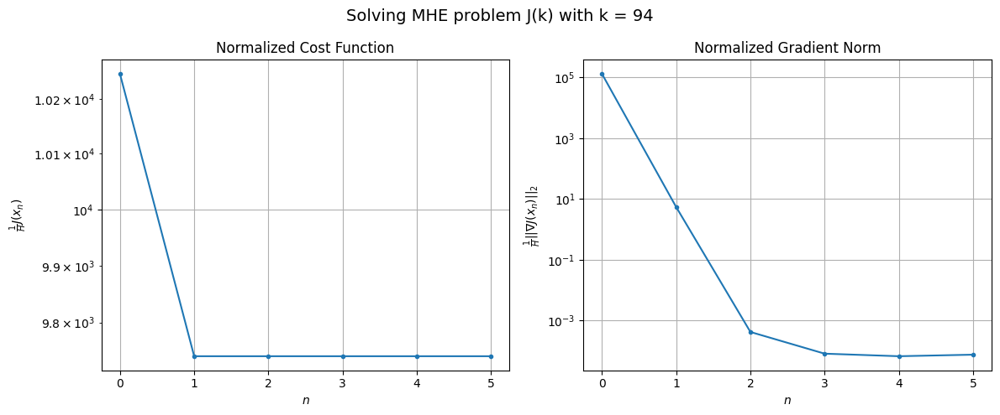

Windows:  18%|█▊        | 66/366 [07:13<28:53,  5.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 297165.02248065313
Gradient norm: 3544391.6232950226
Global estimation error: 54.82691377781416
Initial conditions estimation errors: 23.143578651252447 m, 24.524828565119616 m, 27.38646806366254 m, 33.44909566157149 m
Position estimation errors: 30.131592252025843 m, 27.64127172162141 m, 27.08708927553902 m, 20.021568815918698 m

[Gauss-Newton] Iteration 1
Cost function: 282655.4147824423 (-4.88%)
Gradient norm: 13.842825029809132 (-100.00%)
Global estimation error: 62.42349048704047 (13.86%)
Initial conditions estimation errors: 27.83430562356195 m, 29.350974151807993 m, 30.118321910422377 m, 36.78737421797895 m
Position estimation errors: 25.108129844184834 m, 22.90262349873878 m, 23.541947639298957 m, 15.917169542724707 m

[Gauss-Newton] Iteration 2
Cost function: 282655.41477859206 (-0.00%)
Gradient norm: 0.033488792159891416 (-99.76%)
Global estimation error: 62.436198479323544 (0.02%)
Initial conditions estimation error

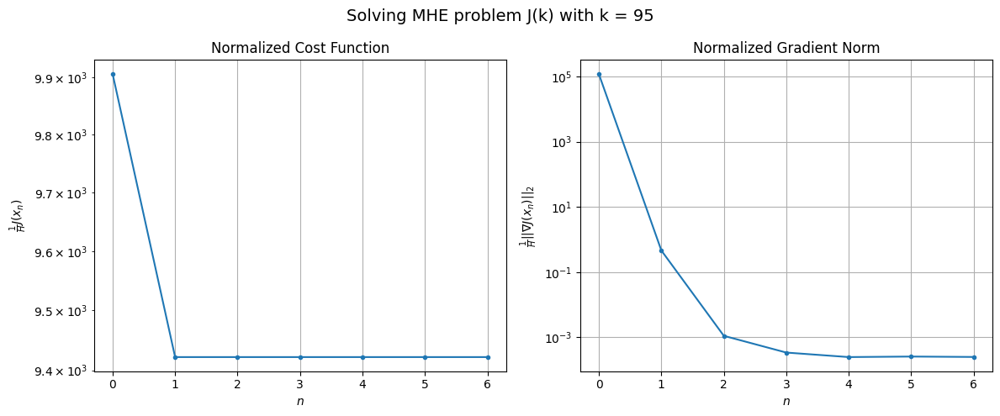

Windows:  18%|█▊        | 67/366 [07:19<29:17,  5.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 287628.2905224547
Gradient norm: 3210639.310073889
Global estimation error: 51.58205068330382
Initial conditions estimation errors: 22.640224816085276 m, 23.910411592116663 m, 24.782000756736704 m, 31.019939241861234 m
Position estimation errors: 29.72705164144483 m, 27.39563171566016 m, 28.020059796104768 m, 20.03941594246636 m

[Gauss-Newton] Iteration 1
Cost function: 273579.383608067 (-4.88%)
Gradient norm: 535.5295565897022 (-99.98%)
Global estimation error: 69.56875367414669 (34.87%)
Initial conditions estimation errors: 27.282853243846436 m, 30.93265022542523 m, 30.52061156155276 m, 46.97961455176691 m
Position estimation errors: 24.825880552745748 m, 25.168571924623425 m, 19.73457927780235 m, 21.102850480893036 m

[Gauss-Newton] Iteration 2
Cost function: 273579.3816822431 (-0.00%)
Gradient norm: 0.03444419887243027 (-99.99%)
Global estimation error: 69.4628636422106 (-0.15%)
Initial conditions estimation errors: 27.28

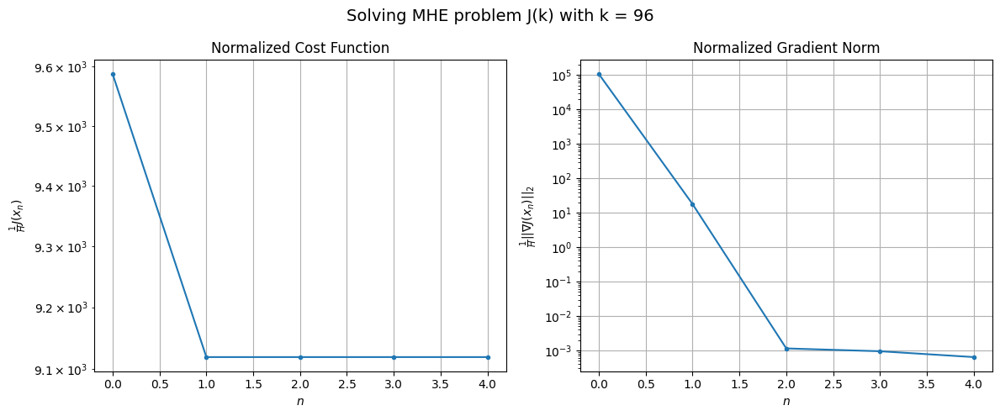

Windows:  19%|█▊        | 68/366 [07:24<27:44,  5.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 279177.0992884413
Gradient norm: 2928880.38885539
Global estimation error: 59.40016403324867
Initial conditions estimation errors: 22.151526513155954 m, 25.790109384191826 m, 24.993519743594444 m, 41.80730414423424 m
Position estimation errors: 29.409023640736514 m, 29.433404994129525 m, 24.271985401346978 m, 24.39732824799797 m

[Gauss-Newton] Iteration 1
Cost function: 265528.7216352516 (-4.89%)
Gradient norm: 13.67640129919482 (-100.00%)
Global estimation error: 71.35226739735187 (20.12%)
Initial conditions estimation errors: 26.76580632624885 m, 30.54687313658086 m, 30.44232696215454 m, 50.14833589989367 m
Position estimation errors: 24.62476281258445 m, 25.0268412926528 m, 19.028882783738453 m, 18.151606932340236 m

[Gauss-Newton] Iteration 2
Cost function: 265528.7216088387 (-0.00%)
Gradient norm: 0.04540623020782384 (-99.67%)
Global estimation error: 71.4526660874915 (0.14%)
Initial conditions estimation errors: 26.7658

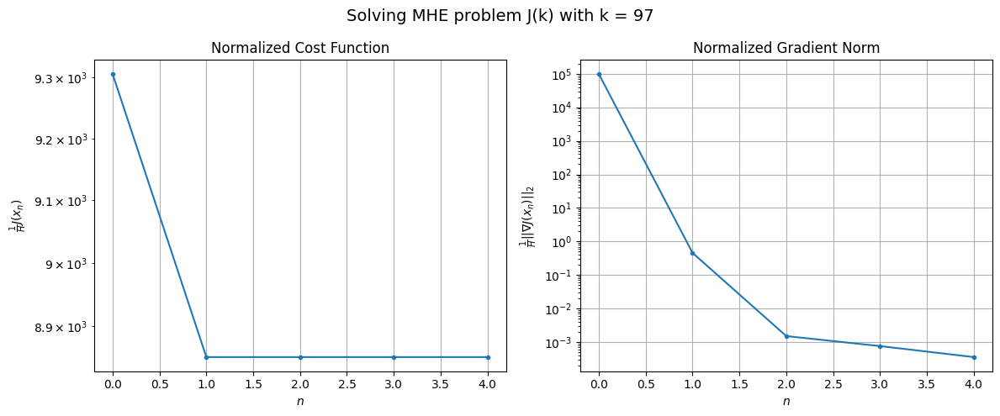

Windows:  19%|█▉        | 69/366 [07:28<25:56,  5.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 271618.79636263696
Gradient norm: 2755542.6920015193
Global estimation error: 61.60881329207803
Initial conditions estimation errors: 21.716082749951408 m, 25.523802710662004 m, 24.918462222129143 m, 45.29493973471926 m
Position estimation errors: 29.235110740807144 m, 29.29981603305826 m, 23.485984216391007 m, 21.30070354648927 m

[Gauss-Newton] Iteration 1
Cost function: 258344.0968892647 (-4.89%)
Gradient norm: 175.6539932586222 (-99.99%)
Global estimation error: 75.86397109971269 (23.14%)
Initial conditions estimation errors: 26.315475647199605 m, 31.624998275372814 m, 28.098222433165905 m, 57.211489862015085 m
Position estimation errors: 24.56940226175284 m, 26.292476851187374 m, 19.663633596439357 m, 19.913282227950386 m

[Gauss-Newton] Iteration 2
Cost function: 258344.0965209266 (-0.00%)
Gradient norm: 0.08728288617700825 (-99.95%)
Global estimation error: 75.6394221450961 (-0.30%)
Initial conditions estimation errors:

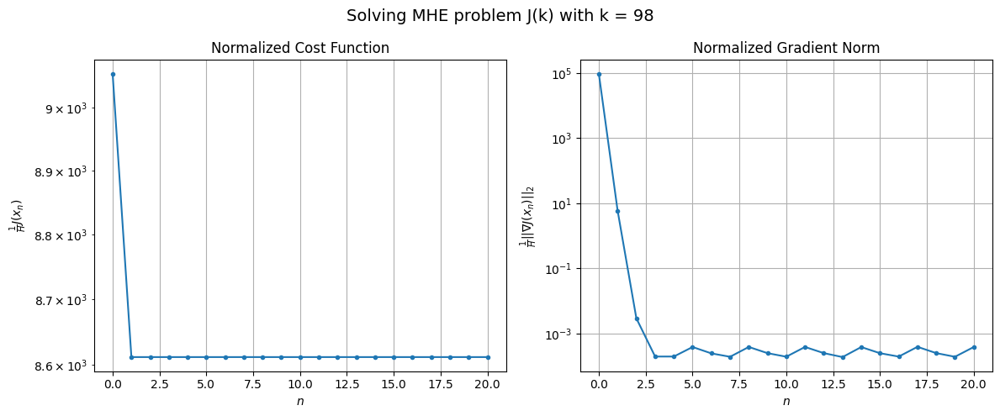

Windows:  19%|█▉        | 70/366 [07:43<40:18,  8.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 266732.9360908665
Gradient norm: 2732980.266658823
Global estimation error: 66.54477621318314
Initial conditions estimation errors: 21.33908626328433 m, 26.771913457731983 m, 22.522745784642098 m, 52.4291089457456 m
Position estimation errors: 29.300609126451377 m, 30.622020871647766 m, 24.417786821782247 m, 22.971894729298914 m

[Gauss-Newton] Iteration 1
Cost function: 253637.92685665542 (-4.91%)
Gradient norm: 354.16866030069815 (-99.99%)
Global estimation error: 60.57407202493444 (-8.97%)
Initial conditions estimation errors: 25.930884751547463 m, 28.177018852974978 m, 25.67438334138702 m, 39.28938802750788 m
Position estimation errors: 24.696346230808107 m, 23.639869689423524 m, 23.982765479620667 m, 21.06610638380302 m

[Gauss-Newton] Iteration 2
Cost function: 253637.92466225708 (-0.00%)
Gradient norm: 0.11389360877698017 (-99.97%)
Global estimation error: 60.3349772739369 (-0.39%)
Initial conditions estimation errors: 

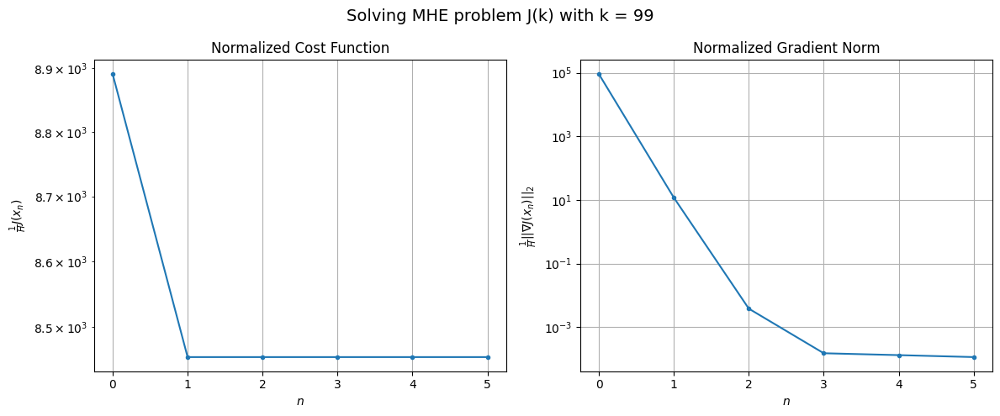

Windows:  19%|█▉        | 71/366 [07:48<35:01,  7.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 263375.63271150546
Gradient norm: 2805001.651720851
Global estimation error: 50.66565504663498
Initial conditions estimation errors: 21.018110450478826 m, 23.1535139541487 m, 20.51190036326926 m, 34.18177978183384 m
Position estimation errors: 29.615439665426976 m, 28.421304761530745 m, 28.958960318757555 m, 25.39903030070523 m

[Gauss-Newton] Iteration 1
Cost function: 250366.2082274449 (-4.94%)
Gradient norm: 40.51793003486354 (-100.00%)
Global estimation error: 64.08510960188292 (26.49%)
Initial conditions estimation errors: 25.61775198511387 m, 29.469709647278794 m, 25.33891065802338 m, 44.04628476435249 m
Position estimation errors: 25.054885425780988 m, 23.972819861031123 m, 22.930186560311856 m, 20.371096431503798 m

[Gauss-Newton] Iteration 2
Cost function: 250366.2082037821 (-0.00%)
Gradient norm: 0.009126544202295118 (-99.98%)
Global estimation error: 64.08537349481506 (0.00%)
Initial conditions estimation errors: 25

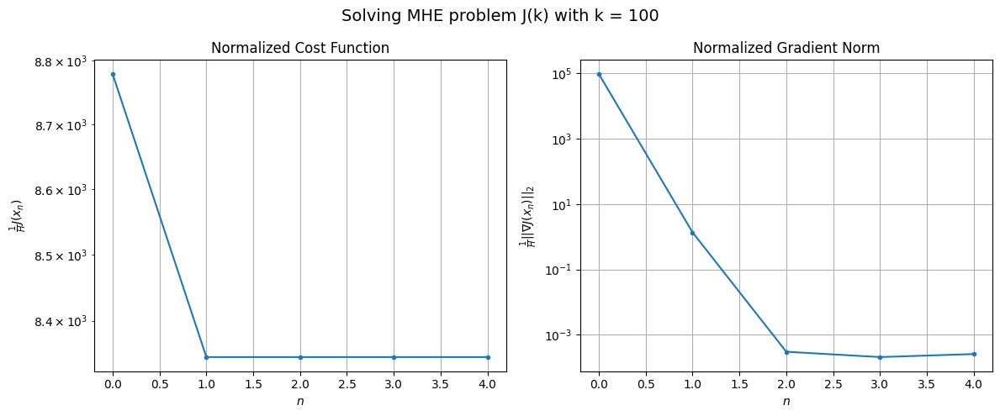

Windows:  20%|█▉        | 72/366 [07:52<30:12,  6.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 263751.4531801751
Gradient norm: 2974943.719404422
Global estimation error: 54.73543403526684
Initial conditions estimation errors: 20.7778002876824 m, 24.61268490683472 m, 20.11068503892219 m, 39.42076612420822 m
Position estimation errors: 30.170764520327072 m, 28.89607241939171 m, 28.02683965505259 m, 24.561818646922255 m

[Gauss-Newton] Iteration 1
Cost function: 250647.82709902036 (-4.97%)
Gradient norm: 401.26708187857366 (-99.99%)
Global estimation error: 79.75883603960085 (45.72%)
Initial conditions estimation errors: 25.36978208797186 m, 35.083261273366304 m, 25.348491780206903 m, 62.003484139221264 m
Position estimation errors: 25.589952739084172 m, 23.494982327662154 m, 18.32372910984329 m, 17.706692324779358 m

[Gauss-Newton] Iteration 2
Cost function: 250647.8245074575 (-0.00%)
Gradient norm: 0.021488281601775835 (-99.99%)
Global estimation error: 79.82157342737726 (0.08%)
Initial conditions estimation errors: 25.

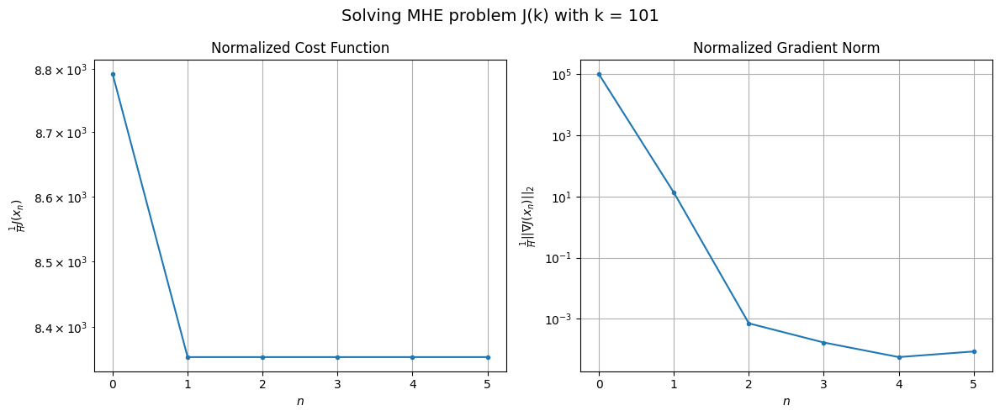

Windows:  20%|█▉        | 73/366 [07:57<27:57,  5.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 266434.48116836144
Gradient norm: 3220456.632270568
Global estimation error: 71.15576250913017
Initial conditions estimation errors: 20.614191785658193 m, 30.362510498141106 m, 19.663109632706664 m, 57.703098059951905 m
Position estimation errors: 30.864757129862703 m, 28.27355340242106 m, 23.409536587317746 m, 21.423210206759528 m

[Gauss-Newton] Iteration 1
Cost function: 253219.70399732926 (-4.96%)
Gradient norm: 22.307865072723168 (-100.00%)
Global estimation error: 76.49505087980504 (7.50%)
Initial conditions estimation errors: 25.19519945683087 m, 34.20300026772252 m, 22.71324965225672 m, 59.42158522814481 m
Position estimation errors: 26.257833353812718 m, 24.252866191631664 m, 21.036163008072663 m, 17.471745523510652 m

[Gauss-Newton] Iteration 2
Cost function: 253219.70399114012 (-0.00%)
Gradient norm: 0.007224275295629913 (-99.97%)
Global estimation error: 76.48819524236652 (-0.01%)
Initial conditions estimation erro

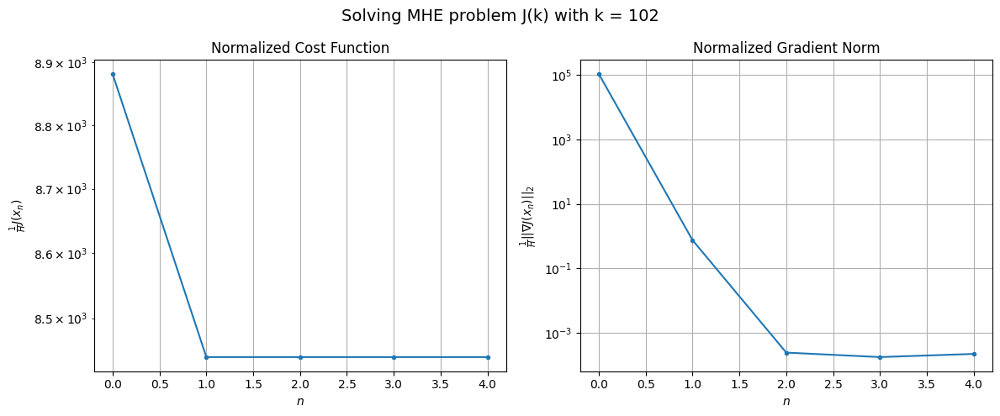

Windows:  20%|██        | 74/366 [08:01<25:24,  5.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 271497.40802036977
Gradient norm: 3485545.3149877083
Global estimation error: 67.83563442729942
Initial conditions estimation errors: 20.529902778472643 m, 29.501543662656317 m, 17.207689344345656 m, 54.89736542175558 m
Position estimation errors: 31.650049210732693 m, 29.199969542231194 m, 26.26886452434429 m, 21.58341507270457 m

[Gauss-Newton] Iteration 1
Cost function: 258022.70893773192 (-4.96%)
Gradient norm: 5355.053922145082 (-99.85%)
Global estimation error: 45.58661124223161 (-32.80%)
Initial conditions estimation errors: 25.10335616363119 m, 15.839827734708829 m, 33.272314926233406 m, 9.48581153106769 m
Position estimation errors: 26.970475744143222 m, 21.66917638371999 m, 36.33556009966091 m, 28.054535323296495 m

[Gauss-Newton] Iteration 2
Cost function: 258022.24042687097 (-0.00%)
Gradient norm: 0.05880201679280964 (-100.00%)
Global estimation error: 45.59639199731104 (0.02%)
Initial conditions estimation errors:

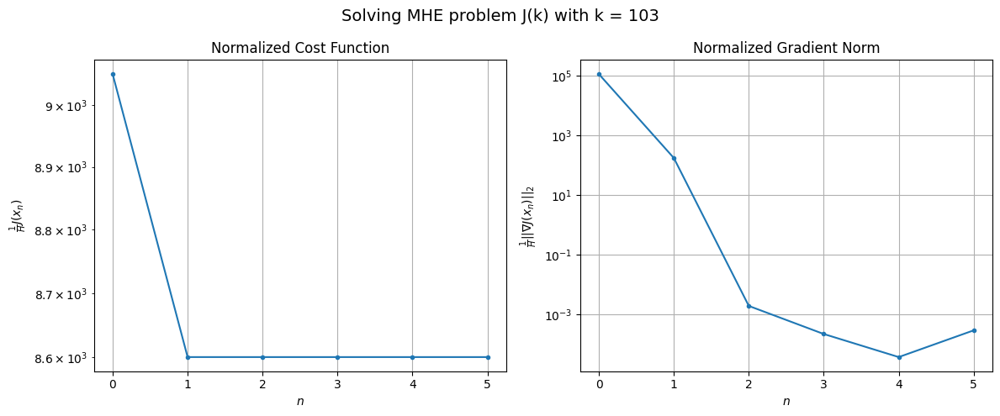

Windows:  20%|██        | 75/366 [08:05<24:33,  5.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 278449.86527858727
Gradient norm: 3702100.811377315
Global estimation error: 39.21340275300907
Initial conditions estimation errors: 20.532606736047136 m, 11.44653908926961 m, 29.83888011944244 m, 9.730998340996853 m
Position estimation errors: 32.477740805642235 m, 28.08800850758275 m, 41.348426206649755 m, 34.94224440174011 m

[Gauss-Newton] Iteration 1
Cost function: 264645.1985995851 (-4.96%)
Gradient norm: 1464.8781372567537 (-99.96%)
Global estimation error: 47.245972686527836 (20.48%)
Initial conditions estimation errors: 25.10354093781172 m, 22.07350246999471 m, 26.31372314424813 m, 20.55023845915784 m
Position estimation errors: 27.70116932974225 m, 27.79654416282087 m, 29.321975496985758 m, 29.718741556891814 m

[Gauss-Newton] Iteration 2
Cost function: 264645.177576355 (-0.00%)
Gradient norm: 0.101123809659221 (-99.99%)
Global estimation error: 47.17399936246832 (-0.15%)
Initial conditions estimation errors: 25.1035

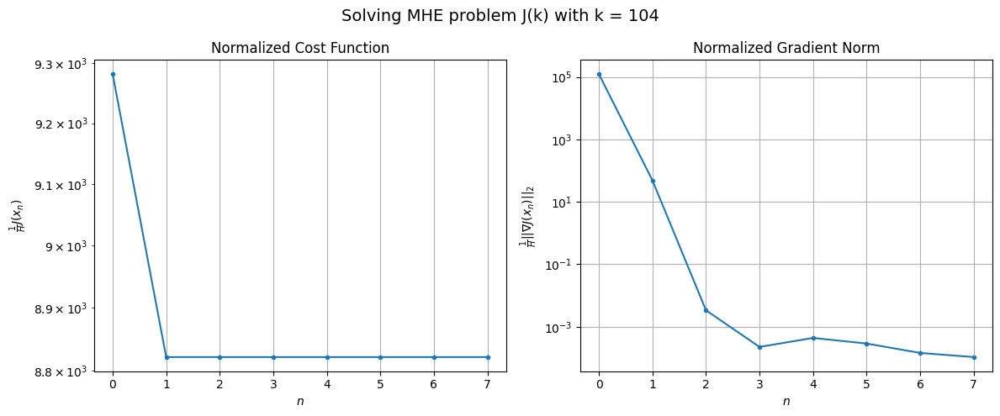

Windows:  21%|██        | 76/366 [08:11<25:36,  5.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 288943.76379813487
Gradient norm: 3909286.489293766
Global estimation error: 38.24697883724168
Initial conditions estimation errors: 20.63329920936915 m, 17.37291697131789 m, 22.079939549901813 m, 15.739445880076996 m
Position estimation errors: 33.38273974546728 m, 33.715833845117366 m, 34.95385277155853 m, 35.6228464404045 m

[Gauss-Newton] Iteration 1
Cost function: 274605.3904637275 (-4.96%)
Gradient norm: 206.98183844437287 (-99.99%)
Global estimation error: 56.673493144971665 (48.18%)
Initial conditions estimation errors: 25.23211180103858 m, 26.886469244674437 m, 23.997455711229147 m, 35.72723529979175 m
Position estimation errors: 28.46516024532029 m, 26.158666832213804 m, 28.64641625459819 m, 22.227509321235836 m

[Gauss-Newton] Iteration 2
Cost function: 274605.38959748234 (-0.00%)
Gradient norm: 0.004583780725479728 (-100.00%)
Global estimation error: 56.66075050379214 (-0.02%)
Initial conditions estimation errors: 

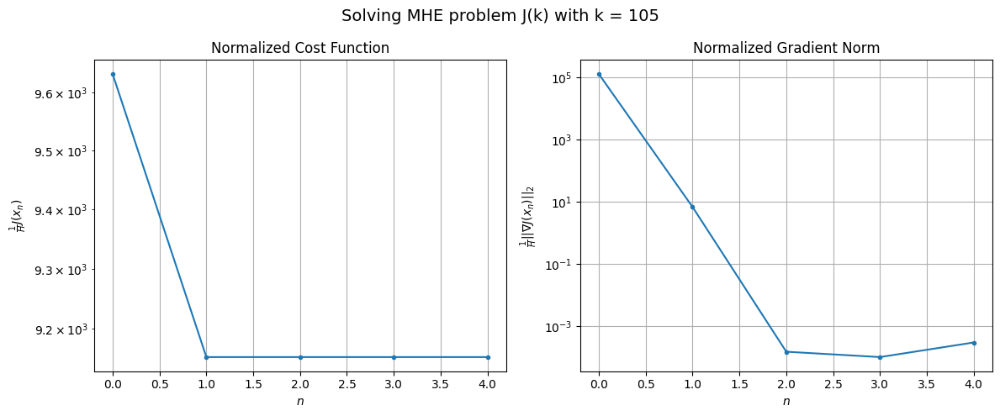

Windows:  21%|██        | 77/366 [08:15<23:39,  4.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 302521.74872391054
Gradient norm: 4094169.349475529
Global estimation error: 47.69761614033737
Initial conditions estimation errors: 20.859174542703656 m, 22.240987004084925 m, 19.71447825184225 m, 30.929098047033982 m
Position estimation errors: 34.41628076258632 m, 32.08758515797308 m, 34.538843888207545 m, 27.75866950708551 m

[Gauss-Newton] Iteration 1
Cost function: 287699.58674407384 (-4.90%)
Gradient norm: 7.708674989751255 (-100.00%)
Global estimation error: 54.797001034438324 (14.88%)
Initial conditions estimation errors: 25.482661570085977 m, 25.161832271408496 m, 23.765981017954804 m, 33.9908316023405 m
Position estimation errors: 29.36277542888879 m, 27.221469382583525 m, 29.343713607296344 m, 22.56497610975376 m

[Gauss-Newton] Iteration 2
Cost function: 287699.58673600276 (-0.00%)
Gradient norm: 0.026571073583963264 (-99.66%)
Global estimation error: 54.80199009706202 (0.01%)
Initial conditions estimation errors:

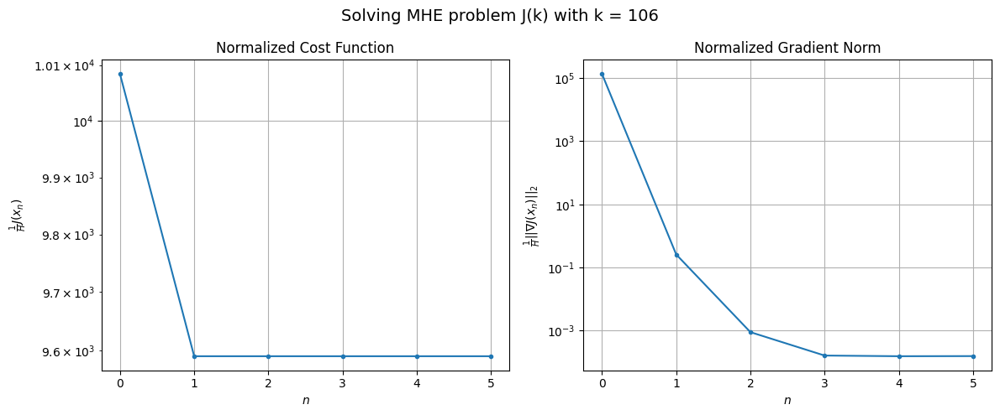

Windows:  21%|██▏       | 78/366 [08:20<23:03,  4.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 319158.53303006163
Gradient norm: 4229353.02055547
Global estimation error: 45.85190671121012
Initial conditions estimation errors: 21.182005430327102 m, 20.569866366220616 m, 19.52631665602137 m, 29.14271496792749 m
Position estimation errors: 35.646365077669245 m, 33.59938134532042 m, 35.617187661850906 m, 28.495943861799166 m

[Gauss-Newton] Iteration 1
Cost function: 303496.15528630564 (-4.91%)
Gradient norm: 142.47111407795185 (-100.00%)
Global estimation error: 52.57611686718462 (14.67%)
Initial conditions estimation errors: 25.910325649464745 m, 23.278556020084217 m, 26.15074056101346 m, 29.44693643253883 m
Position estimation errors: 30.411985601610652 m, 27.33467257752817 m, 32.591871499835825 m, 21.234380595679177 m

[Gauss-Newton] Iteration 2
Cost function: 303496.1551432702 (-0.00%)
Gradient norm: 0.010344139700123581 (-99.99%)
Global estimation error: 52.57895416687962 (0.01%)
Initial conditions estimation errors:

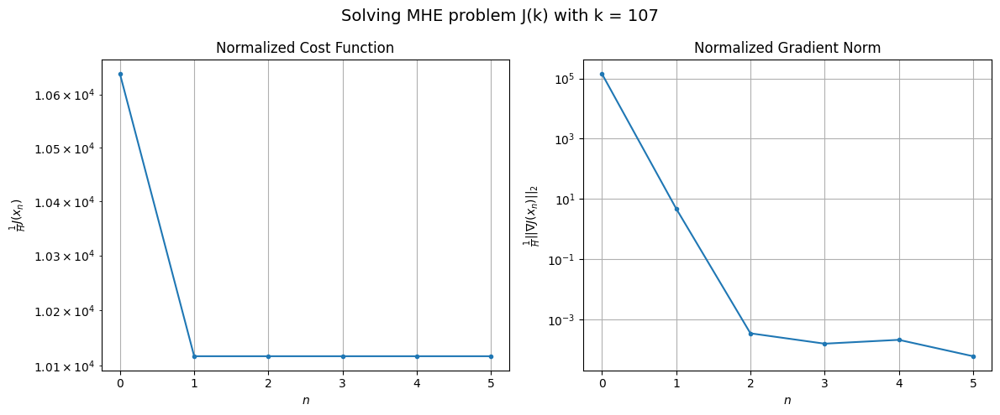

Windows:  22%|██▏       | 79/366 [08:25<23:03,  4.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 338338.2542775008
Gradient norm: 4389346.688444201
Global estimation error: 43.55194190470778
Initial conditions estimation errors: 21.630619128986048 m, 18.64367994247966 m, 22.130183440580883 m, 24.32139360310159 m
Position estimation errors: 37.007632847073275 m, 34.18898120621908 m, 39.020710130690226 m, 27.70830620835407 m

[Gauss-Newton] Iteration 1
Cost function: 321605.6364090909 (-4.95%)
Gradient norm: 107.59450597376636 (-100.00%)
Global estimation error: 48.14270498930631 (10.54%)
Initial conditions estimation errors: 26.504345404885733 m, 21.290844671448852 m, 25.951899146955412 m, 22.100025135676926 m
Position estimation errors: 31.56367935002917 m, 31.92710225812446 m, 32.9926000697185 m, 26.798894822889963 m

[Gauss-Newton] Iteration 2
Cost function: 321605.63631298876 (-0.00%)
Gradient norm: 0.06301446913332726 (-99.94%)
Global estimation error: 48.08384120103534 (-0.12%)
Initial conditions estimation errors: 2

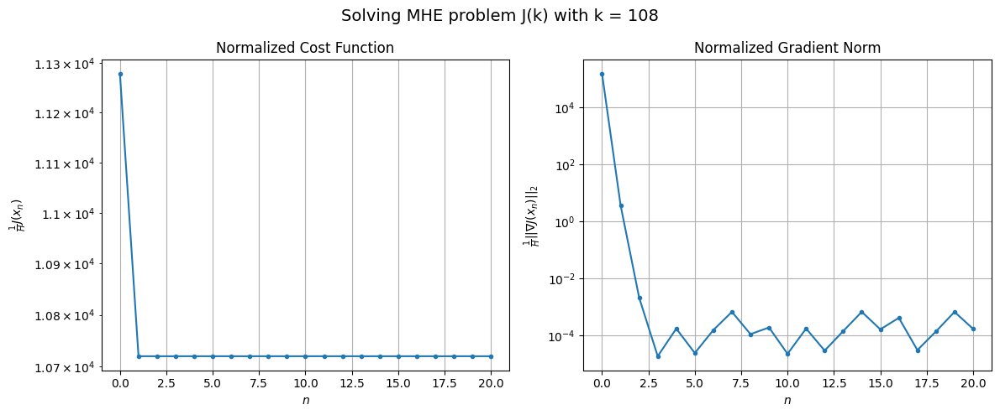

Windows:  22%|██▏       | 80/366 [08:40<38:26,  8.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 359143.7644604894
Gradient norm: 4502945.4361414
Global estimation error: 39.23822276987986
Initial conditions estimation errors: 22.1848703667407 m, 16.733820801667022 m, 21.80689482220369 m, 17.08458521785108 m
Position estimation errors: 38.36727099277796 m, 39.02325563308119 m, 39.777846325206795 m, 33.85284676018294 m

[Gauss-Newton] Iteration 1
Cost function: 341438.3445351809 (-4.93%)
Gradient norm: 2398.4962911243083 (-99.95%)
Global estimation error: 55.82690747300179 (42.28%)
Initial conditions estimation errors: 27.212452124881757 m, 29.346110068766873 m, 19.100611059908722 m, 33.91273515196282 m
Position estimation errors: 32.749441895711655 m, 39.16931024903051 m, 26.956417639563565 m, 42.739499618138105 m

[Gauss-Newton] Iteration 2
Cost function: 341438.31461009046 (-0.00%)
Gradient norm: 0.03813755808875874 (-100.00%)
Global estimation error: 55.90141924411933 (0.13%)
Initial conditions estimation errors: 27.21

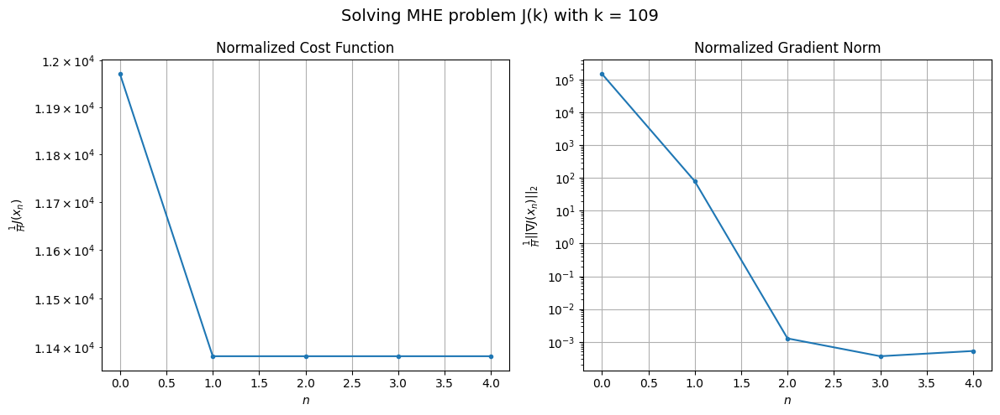

Windows:  22%|██▏       | 81/366 [08:45<33:08,  6.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 382750.05433977715
Gradient norm: 4603736.748672459
Global estimation error: 47.87150333381293
Initial conditions estimation errors: 22.809451245125512 m, 25.44398164812271 m, 14.205186272805143 m, 30.367797532428618 m
Position estimation errors: 39.63227884380038 m, 45.67392017499353 m, 34.29236579780868 m, 49.02147875910703 m

[Gauss-Newton] Iteration 1
Cost function: 363648.58571467415 (-4.99%)
Gradient norm: 129.0857976203082 (-100.00%)
Global estimation error: 56.20823440197318 (17.41%)
Initial conditions estimation errors: 28.052094297119073 m, 30.6967712343441 m, 19.149163224193753 m, 32.61040869973668 m
Position estimation errors: 33.78260144338746 m, 42.22157769444569 m, 27.40755904659773 m, 49.85006097203318 m

[Gauss-Newton] Iteration 2
Cost function: 363648.5856710049 (-0.00%)
Gradient norm: 0.024452247866329064 (-99.98%)
Global estimation error: 56.18408682931213 (-0.04%)
Initial conditions estimation errors: 28.0

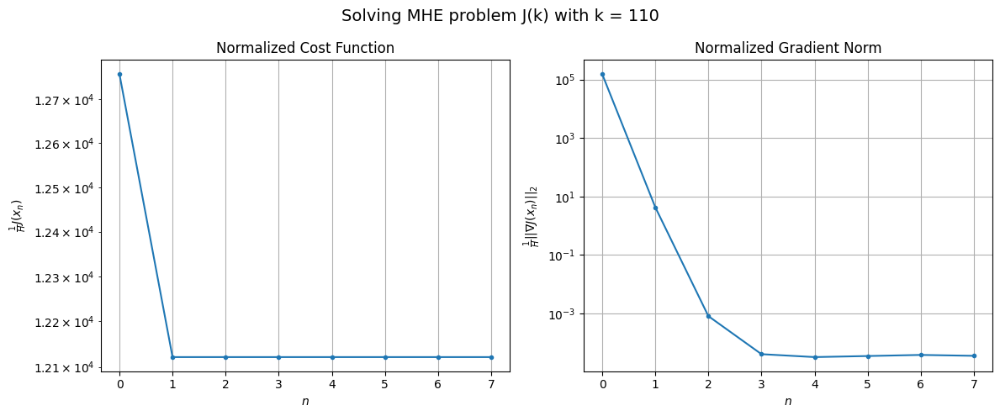

Windows:  22%|██▏       | 82/366 [08:51<31:33,  6.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 406773.1097138183
Gradient norm: 4556074.888948475
Global estimation error: 48.207519267849456
Initial conditions estimation errors: 23.539552651580617 m, 26.823764830747596 m, 14.172007402559691 m, 29.145689927786464 m
Position estimation errors: 40.634962333406015 m, 48.61400553502832 m, 34.79425576295654 m, 56.13037749364822 m

[Gauss-Newton] Iteration 1
Cost function: 386583.6707411125 (-4.96%)
Gradient norm: 234.06807998473317 (-99.99%)
Global estimation error: 63.30533175962718 (31.32%)
Initial conditions estimation errors: 28.973172833749366 m, 35.8606738050386 m, 19.364878796522767 m, 38.8215030593299 m
Position estimation errors: 34.62502915225785 m, 43.78382326149403 m, 27.37861714143675 m, 55.88982263366951 m

[Gauss-Newton] Iteration 2
Cost function: 386583.67044130474 (-0.00%)
Gradient norm: 0.051504748494595895 (-99.98%)
Global estimation error: 63.343483499961714 (0.06%)
Initial conditions estimation errors: 28.

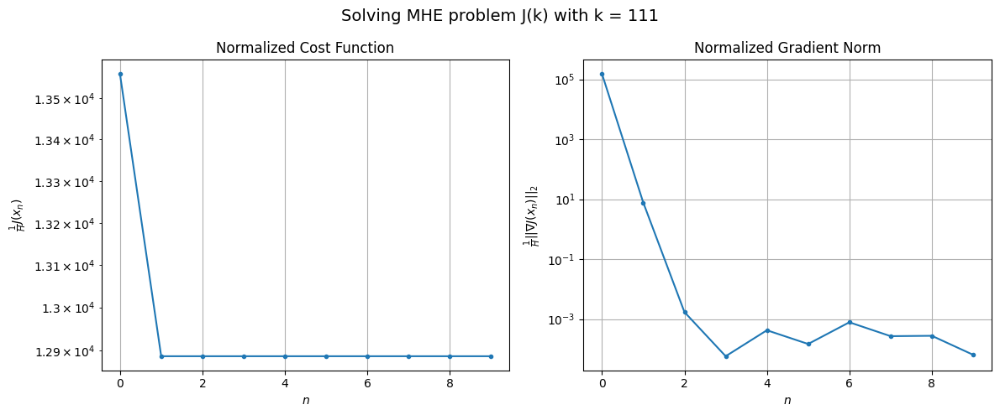

Windows:  23%|██▎       | 83/366 [08:58<32:16,  6.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 430421.66887395625
Gradient norm: 4532411.21037938
Global estimation error: 55.60572173665587
Initial conditions estimation errors: 24.34030237225265 m, 32.05868956205329 m, 14.320541669668007 m, 35.59052241331358 m
Position estimation errors: 41.386825342855516 m, 49.83266951657513 m, 34.72055165728675 m, 61.75119959188177 m

[Gauss-Newton] Iteration 1
Cost function: 409371.09870294534 (-4.89%)
Gradient norm: 462.8574514695483 (-99.99%)
Global estimation error: 72.95774198660837 (31.21%)
Initial conditions estimation errors: 29.92543049534997 m, 40.1655896807917 m, 22.52429621429792 m, 48.027649528418 m
Position estimation errors: 35.25492084584066 m, 39.597950030995655 m, 30.310816558711434 m, 43.16568827333584 m

[Gauss-Newton] Iteration 2
Cost function: 409371.098175046 (-0.00%)
Gradient norm: 0.0224383170614156 (-100.00%)
Global estimation error: 72.95846799910481 (0.00%)
Initial conditions estimation errors: 29.925431498

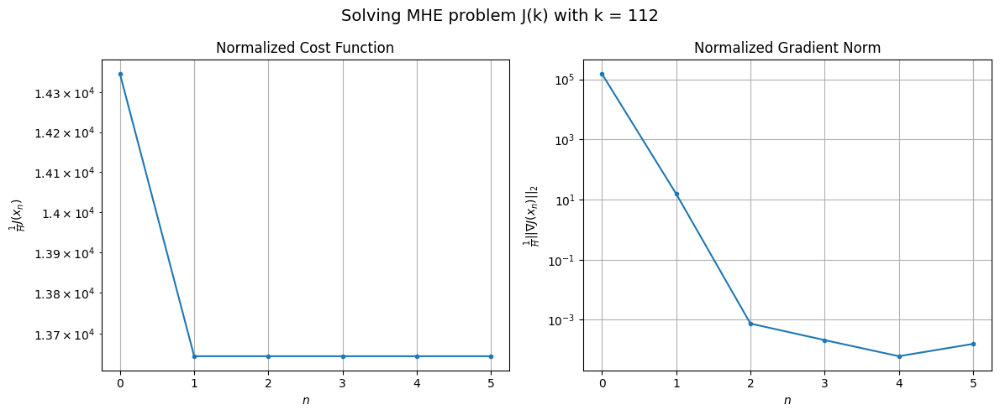

Windows:  23%|██▎       | 84/366 [09:02<28:49,  6.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 451841.5226610736
Gradient norm: 4363395.842438804
Global estimation error: 64.566877032021
Initial conditions estimation errors: 25.172896178658164 m, 35.94036431649896 m, 17.66869089065716 m, 43.9464327500762 m
Position estimation errors: 41.918258084863204 m, 45.44944190944603 m, 37.52062529602049 m, 48.65768910663371 m

[Gauss-Newton] Iteration 1
Cost function: 429743.9587510609 (-4.89%)
Gradient norm: 117.7617384742985 (-100.00%)
Global estimation error: 69.23035422889681 (7.22%)
Initial conditions estimation errors: 30.954335568129675 m, 38.17777352084009 m, 26.037089909311963 m, 41.22099227267922 m
Position estimation errors: 35.664493624359594 m, 38.732636766106474 m, 32.43804010618823 m, 44.18605923074978 m

[Gauss-Newton] Iteration 2
Cost function: 429743.9584216571 (-0.00%)
Gradient norm: 0.007315229174596584 (-99.99%)
Global estimation error: 69.2217887566305 (-0.01%)
Initial conditions estimation errors: 30.954336

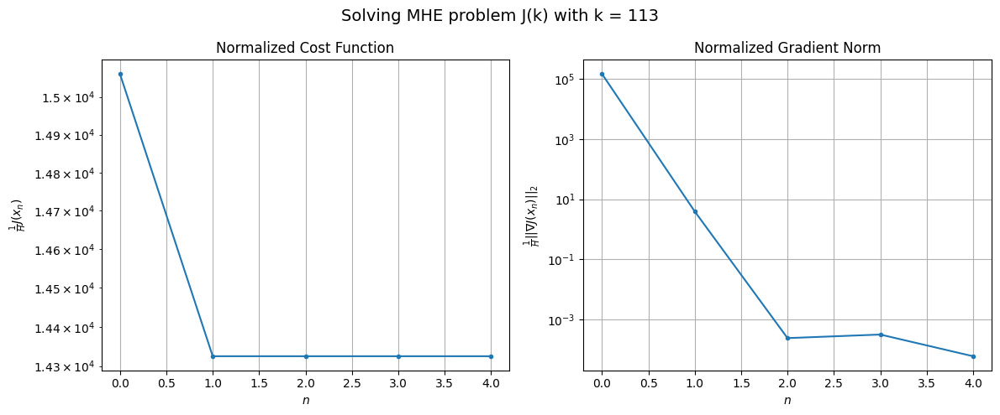

Windows:  23%|██▎       | 85/366 [09:06<25:42,  5.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 470742.13192993857
Gradient norm: 4231403.357049374
Global estimation error: 60.180700509151855
Initial conditions estimation errors: 26.085176263208663 m, 33.66119379591067 m, 21.027651987218476 m, 36.95964560135684 m
Position estimation errors: 42.26291765826794 m, 44.76191826531462 m, 39.40243223659945 m, 50.01334592868755 m

[Gauss-Newton] Iteration 1
Cost function: 447724.9662933726 (-4.89%)
Gradient norm: 3360.5806787654906 (-99.92%)
Global estimation error: 77.33677786978313 (28.51%)
Initial conditions estimation errors: 32.03833235706125 m, 37.16886570209203 m, 38.205059384095414 m, 45.97103365815107 m
Position estimation errors: 35.91611031419515 m, 28.861738915143334 m, 39.78167035533742 m, 16.853677277610466 m

[Gauss-Newton] Iteration 2
Cost function: 447724.92695906566 (-0.00%)
Gradient norm: 0.8516751735850263 (-99.97%)
Global estimation error: 77.32133244872664 (-0.02%)
Initial conditions estimation errors: 32.0

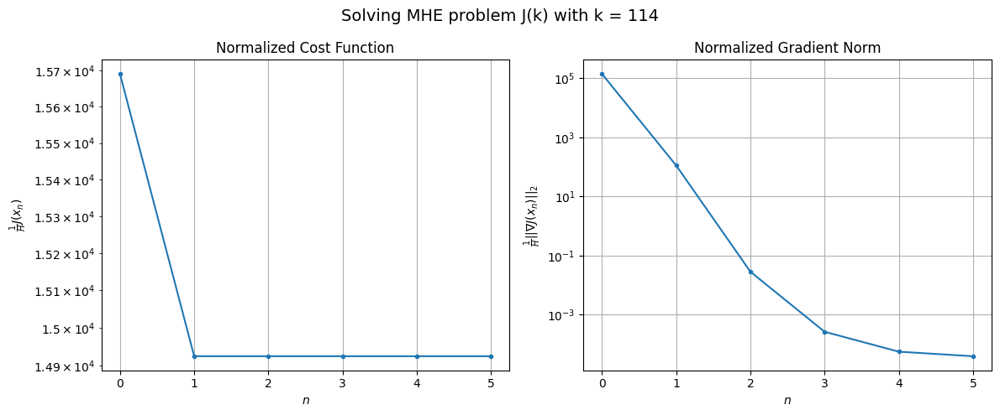

Windows:  23%|██▎       | 86/366 [09:11<24:13,  5.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 487245.8221662607
Gradient norm: 4064919.746488759
Global estimation error: 66.73286000141775
Initial conditions estimation errors: 27.040978371437294 m, 31.86497393725924 m, 33.24488892478321 m, 40.017834123895106 m
Position estimation errors: 42.49937878742873 m, 35.34001837734745 m, 45.92559139291508 m, 22.782946215491677 m

[Gauss-Newton] Iteration 1
Cost function: 463215.91601815086 (-4.93%)
Gradient norm: 969.43475121498 (-99.98%)
Global estimation error: 79.41108847504512 (19.00%)
Initial conditions estimation errors: 33.16406976210597 m, 40.22579502176771 m, 34.15643223450124 m, 49.2082765655848 m
Position estimation errors: 36.052239287359996 m, 33.689958044627936 m, 35.09848216415319 m, 29.057566947938835 m

[Gauss-Newton] Iteration 2
Cost function: 463215.91205182264 (-0.00%)
Gradient norm: 0.0464521267135639 (-100.00%)
Global estimation error: 79.47089104606414 (0.08%)
Initial conditions estimation errors: 33.16407

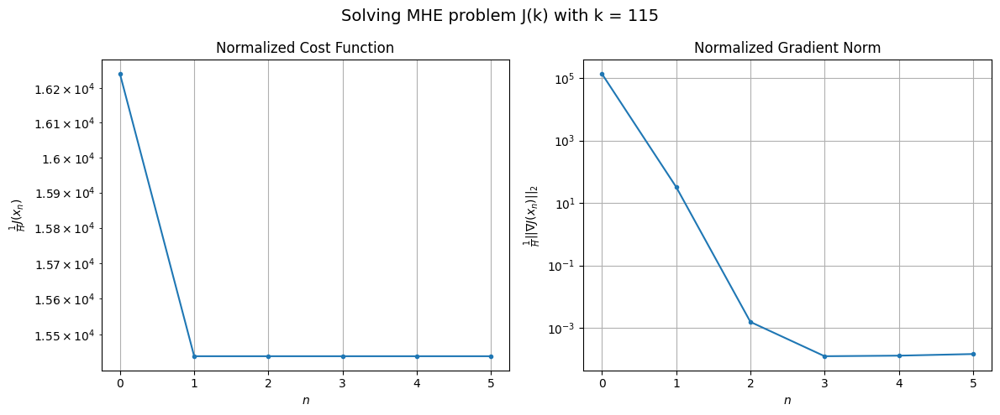

Windows:  24%|██▍       | 87/366 [09:15<23:27,  5.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 499264.15353079577
Gradient norm: 3920361.9082879443
Global estimation error: 69.11284735030436
Initial conditions estimation errors: 27.998380013950218 m, 35.02207092523537 m, 28.965561141683715 m, 43.898673329347034 m
Position estimation errors: 42.64625747222797 m, 39.80707270435976 m, 41.76650196181526 m, 34.4208004031577 m

[Gauss-Newton] Iteration 1
Cost function: 474502.10252099205 (-4.96%)
Gradient norm: 5294.223735312105 (-99.86%)
Global estimation error: 86.55303600976062 (25.23%)
Initial conditions estimation errors: 34.2511672203612 m, 35.732859784353224 m, 47.89245466560866 m, 52.41863764654942 m
Position estimation errors: 36.14966009536608 m, 23.36289318544539 m, 44.229403192598724 m, 11.062522140501102 m

[Gauss-Newton] Iteration 2
Cost function: 474502.00469115365 (-0.00%)
Gradient norm: 0.21565748571695012 (-100.00%)
Global estimation error: 86.55459647592335 (0.00%)
Initial conditions estimation errors: 34.2

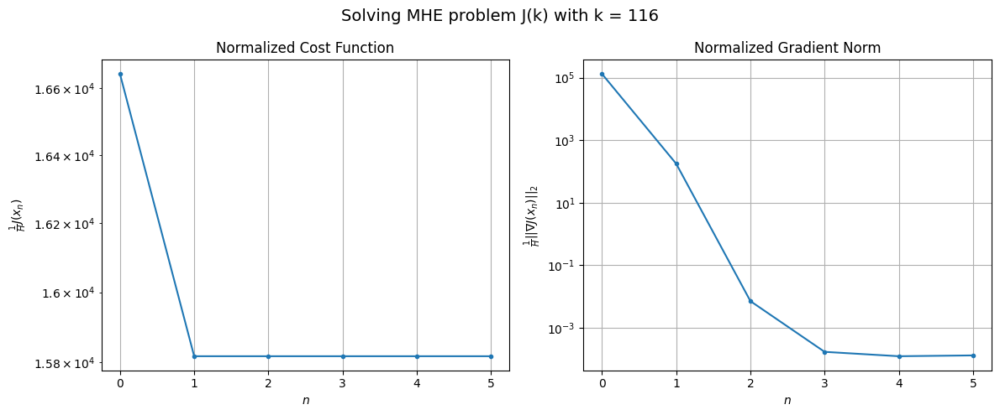

Windows:  24%|██▍       | 88/366 [09:20<22:46,  4.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 507222.70431242505
Gradient norm: 3885106.3745505027
Global estimation error: 74.34012837151892
Initial conditions estimation errors: 28.861771283074155 m, 29.48854795936848 m, 42.746278345085166 m, 44.68318475896979 m
Position estimation errors: 42.741794803499914 m, 30.10358057841818 m, 49.87714039020823 m, 5.850963089228185 m

[Gauss-Newton] Iteration 1
Cost function: 481902.36367617873 (-4.99%)
Gradient norm: 2311.877299041676 (-99.94%)
Global estimation error: 92.64257981059338 (24.62%)
Initial conditions estimation errors: 35.2063613384711 m, 32.03772887185935 m, 56.403545622812224 m, 55.99394648340602 m
Position estimation errors: 36.215020995261334 m, 17.631026945515593 m, 48.01966181070399 m, 35.833793214565794 m

[Gauss-Newton] Iteration 2
Cost function: 481902.34793174523 (-0.00%)
Gradient norm: 0.023930051032917832 (-100.00%)
Global estimation error: 92.65651855909488 (0.02%)
Initial conditions estimation errors: 3

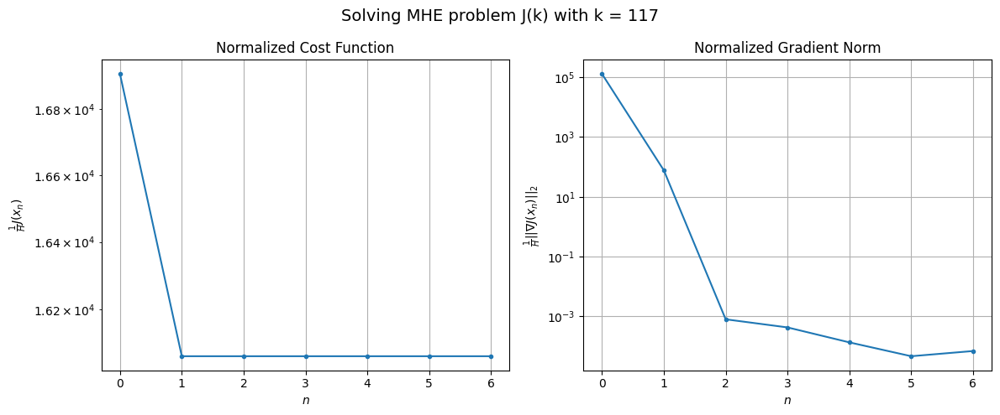

Windows:  24%|██▍       | 89/366 [09:25<23:11,  5.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 510969.68486429326
Gradient norm: 4034581.765945975
Global estimation error: 79.22907030951986
Initial conditions estimation errors: 29.556045984836835 m, 25.023228817181163 m, 51.2388365240874 m, 46.390127901646004 m
Position estimation errors: 42.763602283084964 m, 24.561328818896534 m, 52.9863492318804 m, 29.122672911954467 m

[Gauss-Newton] Iteration 1
Cost function: 484967.02708583174 (-5.09%)
Gradient norm: 586.5958508290959 (-99.99%)
Global estimation error: 100.09628886421584 (26.34%)
Initial conditions estimation errors: 35.9946769010166 m, 30.589598530197698 m, 60.68095511654598 m, 64.0755471898742 m
Position estimation errors: 36.18385645489083 m, 16.577707465565044 m, 45.335354037683175 m, 53.28016331126317 m

[Gauss-Newton] Iteration 2
Cost function: 484967.02581114543 (-0.00%)
Gradient norm: 0.04280548340069699 (-99.99%)
Global estimation error: 100.06957662401864 (-0.03%)
Initial conditions estimation errors: 35

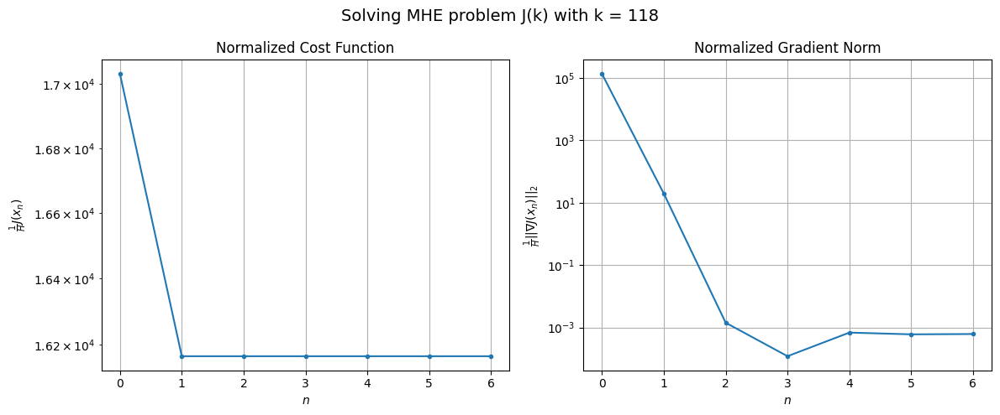

Windows:  25%|██▍       | 90/366 [09:31<24:08,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 510175.8419465762
Gradient norm: 4388511.020719581
Global estimation error: 85.59901270628926
Initial conditions estimation errors: 30.079925352374826 m, 23.238507322887887 m, 55.25641304701689 m, 53.18850741490583 m
Position estimation errors: 42.6283067925519 m, 23.6603809947808 m, 49.80167269604048 m, 47.095040731246925 m

[Gauss-Newton] Iteration 1
Cost function: 483943.847894714 (-5.14%)
Gradient norm: 2826.84941146788 (-99.94%)
Global estimation error: 88.23664937003346 (3.08%)
Initial conditions estimation errors: 36.52484287480541 m, 33.78037789163601 m, 51.78073265793973 m, 51.27591318681351 m
Position estimation errors: 36.01983270882917 m, 23.920353156700823 m, 37.57694117032832 m, 23.646818693577043 m

[Gauss-Newton] Iteration 2
Cost function: 483943.82126945525 (-0.00%)
Gradient norm: 0.37368070610010423 (-99.99%)
Global estimation error: 88.1198245633571 (-0.13%)
Initial conditions estimation errors: 36.524844217

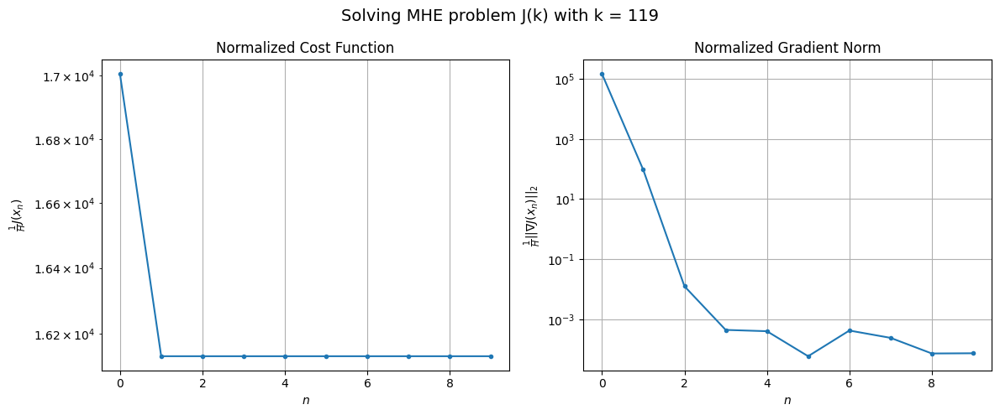

Windows:  25%|██▍       | 91/366 [09:38<26:36,  5.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 506783.5517767352
Gradient norm: 4718909.433877951
Global estimation error: 74.1283234181385
Initial conditions estimation errors: 30.380430874414095 m, 26.88389887951304 m, 45.82046452611929 m, 41.82959916679862 m
Position estimation errors: 42.28070909221602 m, 30.803330957829026 m, 42.56318441273173 m, 18.830083270167716 m

[Gauss-Newton] Iteration 1
Cost function: 480512.43450599303 (-5.18%)
Gradient norm: 136.3259463804132 (-100.00%)
Global estimation error: 86.48684513576853 (16.67%)
Initial conditions estimation errors: 36.80458113909891 m, 30.926731222493586 m, 54.948679750699135 m, 46.36276358593989 m
Position estimation errors: 35.661525531408536 m, 23.630156462815062 m, 36.57257533790852 m, 29.973098850104737 m

[Gauss-Newton] Iteration 2
Cost function: 480512.4343990286 (-0.00%)
Gradient norm: 0.006873452340932385 (-99.99%)
Global estimation error: 86.4824402580566 (-0.01%)
Initial conditions estimation errors: 36.

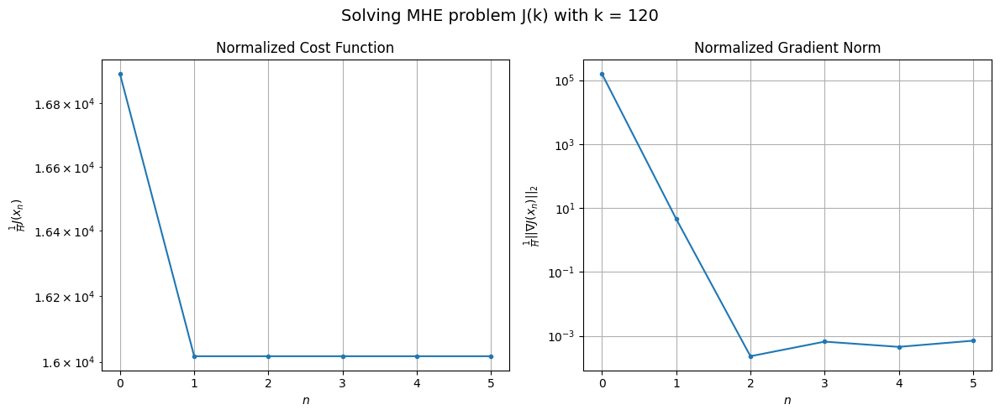

Windows:  25%|██▌       | 92/366 [09:43<24:44,  5.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 498652.5435144725
Gradient norm: 5064467.502289193
Global estimation error: 72.23752674981088
Initial conditions estimation errors: 30.48279668393883 m, 23.741576087325694 m, 48.95284632959142 m, 36.454723469792874 m
Position estimation errors: 41.6382828203777 m, 30.393568441808323 m, 40.90224360099733 m, 26.30660244772182 m

[Gauss-Newton] Iteration 1
Cost function: 472663.54926286626 (-5.21%)
Gradient norm: 1577.9181503537643 (-99.97%)
Global estimation error: 81.39503854003773 (12.68%)
Initial conditions estimation errors: 36.84561450869325 m, 33.55123154487255 m, 47.571584089767335 m, 43.3445152228981 m
Position estimation errors: 35.03694819046098 m, 28.569207576134332 m, 33.296316860405305 m, 13.331974275510463 m

[Gauss-Newton] Iteration 2
Cost function: 472663.54022036365 (-0.00%)
Gradient norm: 0.13598934022213652 (-99.99%)
Global estimation error: 81.33019298332218 (-0.08%)
Initial conditions estimation errors: 36.8

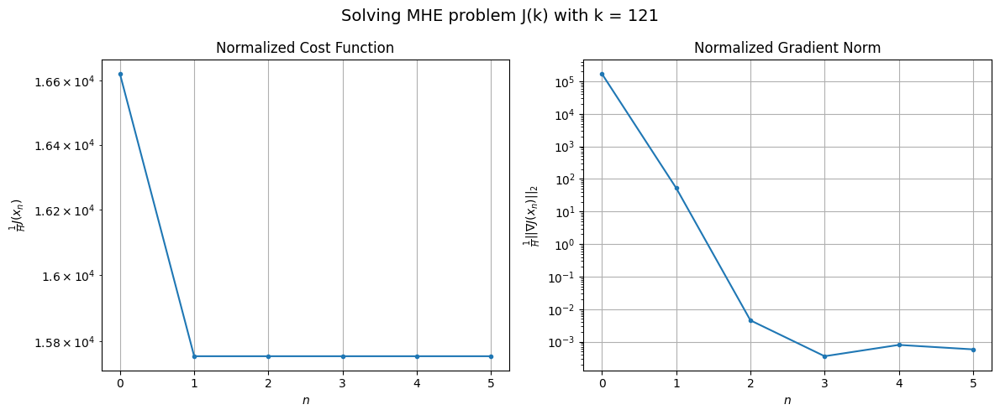

Windows:  25%|██▌       | 93/366 [09:47<23:45,  5.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 487267.0798854302
Gradient norm: 5365719.924302402
Global estimation error: 67.26552919818265
Initial conditions estimation errors: 30.412750769920695 m, 26.674269749118725 m, 41.19301121886452 m, 34.5148260475219 m
Position estimation errors: 40.59551288194467 m, 34.68015662443791 m, 38.00538135612715 m, 15.582181313658587 m

[Gauss-Newton] Iteration 1
Cost function: 461969.0754040458 (-5.19%)
Gradient norm: 324.8368337099096 (-99.99%)
Global estimation error: 74.96267863322099 (11.44%)
Initial conditions estimation errors: 36.65725418920348 m, 30.990626086703006 m, 45.83277004910614 m, 34.8500336777399 m
Position estimation errors: 34.04650826088254 m, 30.707964698546647 m, 32.56273011510024 m, 13.660132425622715 m

[Gauss-Newton] Iteration 2
Cost function: 461969.0751714087 (-0.00%)
Gradient norm: 0.018687217641648882 (-99.99%)
Global estimation error: 74.94377762359117 (-0.03%)
Initial conditions estimation errors: 36.6572

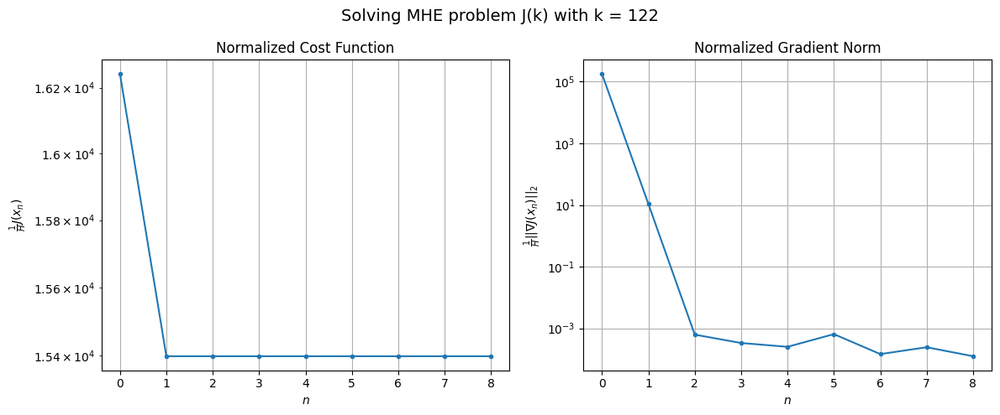

Windows:  26%|██▌       | 94/366 [09:54<25:27,  5.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 470916.8743652615
Gradient norm: 5484248.266376862
Global estimation error: 61.35521080887129
Initial conditions estimation errors: 30.16930411998124 m, 24.133636424205328 m, 39.53483310821407 m, 26.622944830325682 m
Position estimation errors: 39.035165734331464 m, 36.20107092845709 m, 36.721665771510025 m, 19.6150858354605 m

[Gauss-Newton] Iteration 1
Cost function: 446752.9490845034 (-5.13%)
Gradient norm: 1270.7250180646802 (-99.98%)
Global estimation error: 71.5971839773493 (16.69%)
Initial conditions estimation errors: 36.26155459294607 m, 33.37062232275242 m, 40.19702269353922 m, 32.89074845617276 m
Position estimation errors: 32.611770772851536 m, 32.35838279566702 m, 31.503830271133463 m, 28.194095735104035 m

[Gauss-Newton] Iteration 2
Cost function: 446752.944385293 (-0.00%)
Gradient norm: 0.05139124858382606 (-100.00%)
Global estimation error: 71.68251963335496 (0.12%)
Initial conditions estimation errors: 36.2615

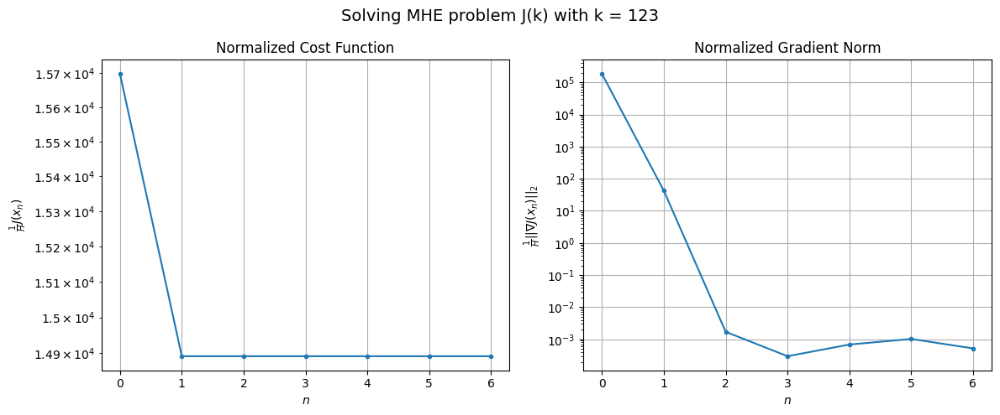

Windows:  26%|██▌       | 95/366 [10:00<25:25,  5.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 449439.53588846384
Gradient norm: 5368877.203277323
Global estimation error: 58.50904323294532
Initial conditions estimation errors: 29.747336244026627 m, 26.688881648145095 m, 33.85022164875442 m, 26.08099531084885 m
Position estimation errors: 36.88720019634586 m, 36.81336975640624 m, 35.51247637525444 m, 33.05313804502461 m

[Gauss-Newton] Iteration 1
Cost function: 426718.599445846 (-5.06%)
Gradient norm: 1077.266086778461 (-99.98%)
Global estimation error: 66.51521685746943 (13.68%)
Initial conditions estimation errors: 35.662941527356935 m, 34.10710553554933 m, 35.38924730745189 m, 27.141942041112227 m
Position estimation errors: 30.644611844557932 m, 33.807193647381 m, 30.84610875036959 m, 46.01713893452773 m

[Gauss-Newton] Iteration 2
Cost function: 426718.5965237655 (-0.00%)
Gradient norm: 0.0707205615025501 (-99.99%)
Global estimation error: 66.60224927330138 (0.13%)
Initial conditions estimation errors: 35.66294136

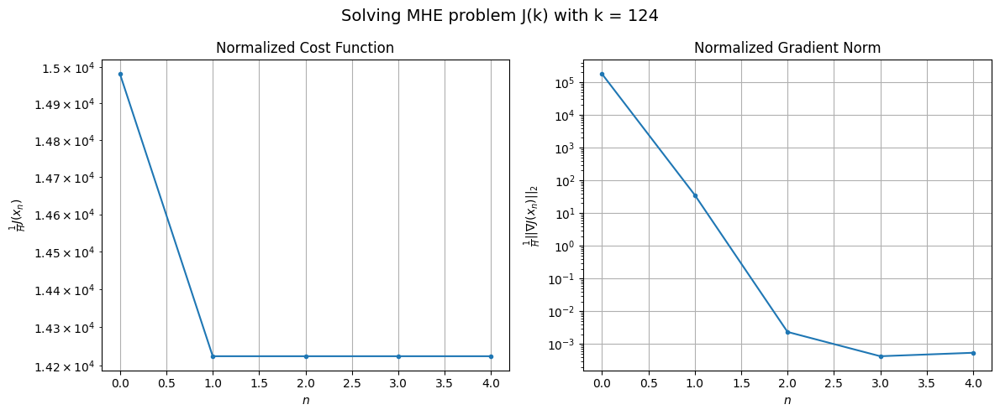

Windows:  26%|██▌       | 96/366 [10:04<23:39,  5.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 421377.8381675365
Gradient norm: 5072743.657184792
Global estimation error: 54.12582810970743
Initial conditions estimation errors: 29.1399276748939 m, 27.72621904858886 m, 29.095329748038985 m, 21.567166053330595 m
Position estimation errors: 34.094875771614326 m, 37.228629533943845 m, 34.61709536298787 m, 49.34893165424765 m

[Gauss-Newton] Iteration 1
Cost function: 400774.13222145557 (-4.89%)
Gradient norm: 203.6940724400584 (-100.00%)
Global estimation error: 62.36925223614002 (15.23%)
Initial conditions estimation errors: 34.80430956521657 m, 34.38485244577091 m, 33.93466107385059 m, 18.564939754980486 m
Position estimation errors: 28.158075851261884 m, 31.778818224523405 m, 29.520267241439157 m, 54.570145449166965 m

[Gauss-Newton] Iteration 2
Cost function: 400774.13170199684 (-0.00%)
Gradient norm: 0.2259431451848211 (-99.89%)
Global estimation error: 62.440253016752294 (0.11%)
Initial conditions estimation errors: 34

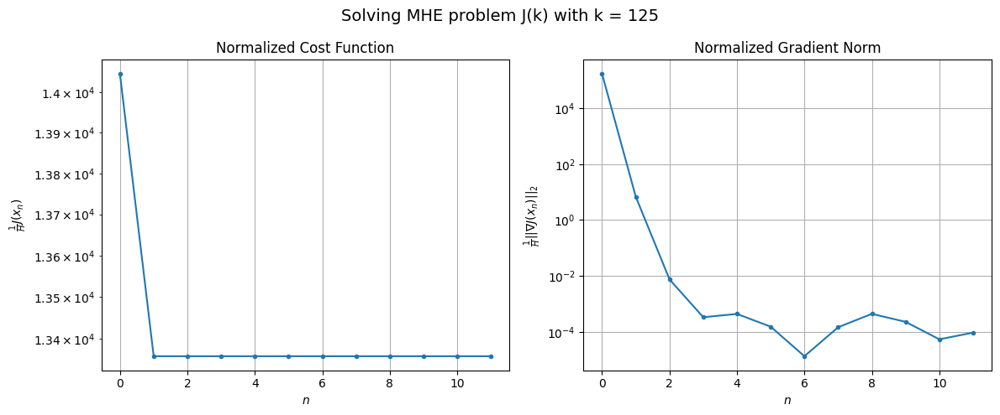

Windows:  27%|██▋       | 97/366 [10:13<28:05,  6.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 386858.9329660805
Gradient norm: 4752458.065643576
Global estimation error: 50.41197356394625
Initial conditions estimation errors: 28.30680954165362 m, 28.12453801656595 m, 27.66934245919132 m, 13.545000462498177 m
Position estimation errors: 30.73473035759946 m, 34.28623113997827 m, 32.57696987338877 m, 57.00437462113896 m

[Gauss-Newton] Iteration 1
Cost function: 368757.6776209526 (-4.68%)
Gradient norm: 1485.3755380927862 (-99.97%)
Global estimation error: 58.698932867585555 (16.44%)
Initial conditions estimation errors: 33.66330896677358 m, 35.31344785664775 m, 26.88286971658344 m, 18.508856162384127 m
Position estimation errors: 25.191856844403905 m, 32.32631433363012 m, 31.755354444976444 m, 74.77802522632588 m

[Gauss-Newton] Iteration 2
Cost function: 368757.6713574897 (-0.00%)
Gradient norm: 0.11689410203700544 (-99.99%)
Global estimation error: 58.781503317886276 (0.14%)
Initial conditions estimation errors: 33.663

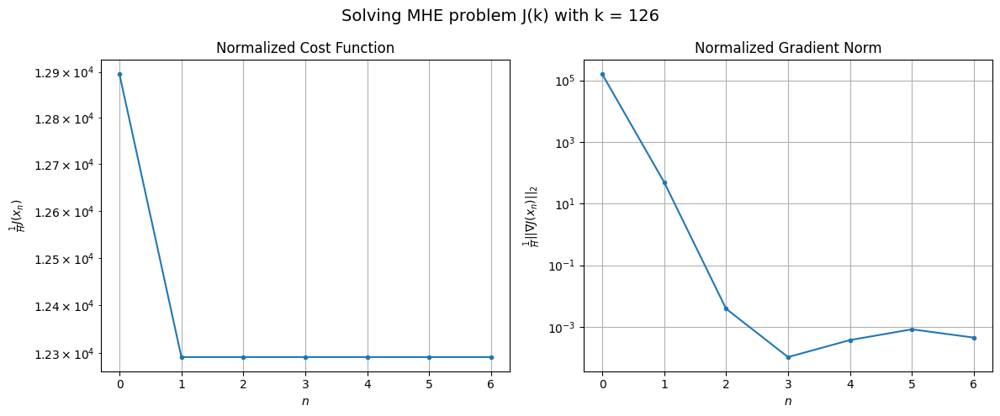

Windows:  27%|██▋       | 98/366 [10:18<26:29,  5.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 348735.61634825467
Gradient norm: 4397199.925655566
Global estimation error: 47.791421485423264
Initial conditions estimation errors: 27.259651758010193 m, 29.442396906922575 m, 20.826728691116998 m, 15.501251822970271 m
Position estimation errors: 26.937933975761712 m, 33.774975988216454 m, 34.47682540188537 m, 75.5757908450749 m

[Gauss-Newton] Iteration 1
Cost function: 332993.0772975943 (-4.51%)
Gradient norm: 862.9634047132427 (-99.98%)
Global estimation error: 59.11745216522072 (23.70%)
Initial conditions estimation errors: 32.306012753638896 m, 33.23675965139631 m, 28.651567409718098 m, 22.925074028696937 m
Position estimation errors: 21.803973886085245 m, 26.399670893130413 m, 26.554462938474384 m, 51.8408422918248 m

[Gauss-Newton] Iteration 2
Cost function: 332993.07546722173 (-0.00%)
Gradient norm: 0.03271712615233056 (-100.00%)
Global estimation error: 59.06829415383675 (-0.08%)
Initial conditions estimation errors

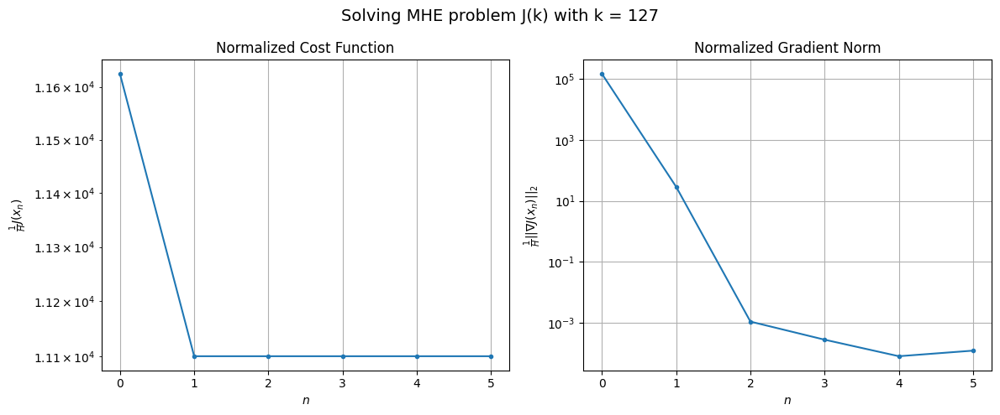

Windows:  27%|██▋       | 99/366 [10:23<24:50,  5.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 307876.70883563696
Gradient norm: 3932396.9783929437
Global estimation error: 47.77716290124552
Initial conditions estimation errors: 26.06836969724859 m, 27.343085772126056 m, 22.55603166628907 m, 18.618346363009234 m
Position estimation errors: 22.85356536082149 m, 27.300381523717743 m, 28.412002817453363 m, 52.48943263483055 m

[Gauss-Newton] Iteration 1
Cost function: 294778.9387442325 (-4.25%)
Gradient norm: 307.4158657781347 (-99.99%)
Global estimation error: 60.39748752277272 (26.41%)
Initial conditions estimation errors: 30.73060154993463 m, 32.32291099784888 m, 29.43905495252501 m, 28.142806880029635 m
Position estimation errors: 18.231665088557595 m, 19.831148798249338 m, 20.954004556968247 m, 35.59444138183218 m

[Gauss-Newton] Iteration 2
Cost function: 294778.93846936384 (-0.00%)
Gradient norm: 0.03303980252887181 (-99.99%)
Global estimation error: 60.35764745273851 (-0.07%)
Initial conditions estimation errors: 3

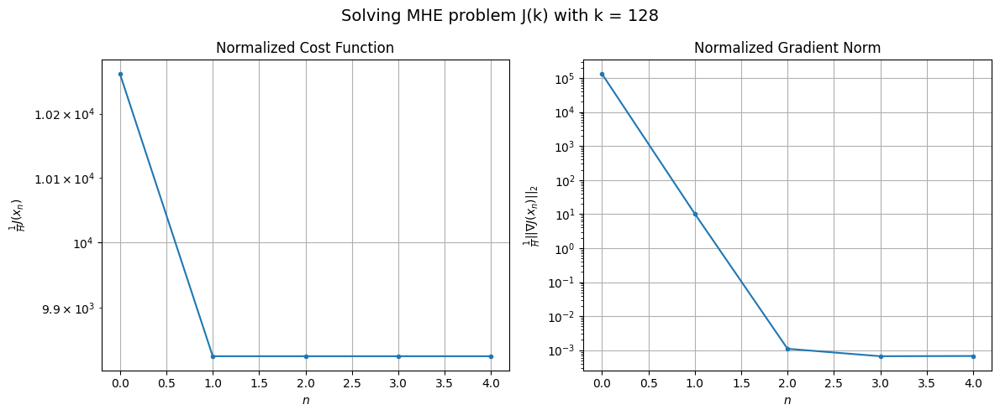

Windows:  27%|██▋       | 100/366 [10:27<22:53,  5.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 265146.3991588388
Gradient norm: 3406402.21579381
Global estimation error: 49.01750701841619
Initial conditions estimation errors: 24.706162155989652 m, 26.409423876375854 m, 23.484066438625426 m, 23.309379137573092 m
Position estimation errors: 18.77700985245639 m, 20.268051868997716 m, 21.883387335164812 m, 35.545764377139015 m

[Gauss-Newton] Iteration 1
Cost function: 254532.7884787013 (-4.00%)
Gradient norm: 8.063182313263708 (-100.00%)
Global estimation error: 55.926645632490576 (14.10%)
Initial conditions estimation errors: 28.98158886120198 m, 30.184263861139733 m, 27.554216200442735 m, 24.849453183561902 m
Position estimation errors: 14.739907730756755 m, 16.53179363992533 m, 18.18405785182318 m, 33.402237054453686 m

[Gauss-Newton] Iteration 2
Cost function: 254532.78849069626 (0.00%)
Gradient norm: 0.01411466468722621 (-99.82%)
Global estimation error: 55.934464659143465 (0.01%)
Initial conditions estimation errors:

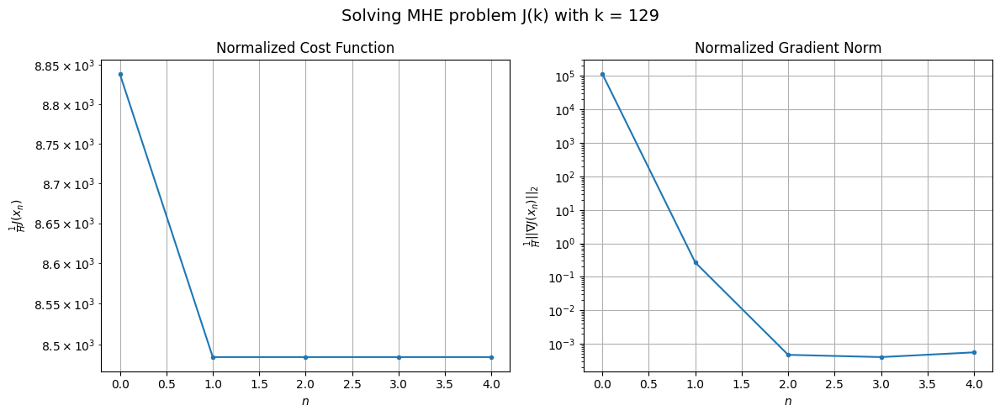

Windows:  28%|██▊       | 101/366 [10:31<21:57,  4.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 224191.20514658387
Gradient norm: 2864624.2128928774
Global estimation error: 45.04497804127322
Initial conditions estimation errors: 23.16732313055137 m, 24.480011639322115 m, 21.842577767970003 m, 20.39419136656709 m
Position estimation errors: 14.98591926108189 m, 16.699028394155363 m, 18.834935977748252 m, 32.88267734835864 m

[Gauss-Newton] Iteration 1
Cost function: 215861.0742651316 (-3.72%)
Gradient norm: 19.498131635448527 (-100.00%)
Global estimation error: 54.4101826164297 (20.79%)
Initial conditions estimation errors: 27.020491484353695 m, 29.021466501659983 m, 24.518432755131137 m, 28.052229511252907 m
Position estimation errors: 11.57440056488757 m, 13.304198089542114 m, 16.094637978838204 m, 30.41140207618886 m

[Gauss-Newton] Iteration 2
Cost function: 215861.07424929287 (-0.00%)
Gradient norm: 0.006852192200860638 (-99.96%)
Global estimation error: 54.416366048528616 (0.01%)
Initial conditions estimation error

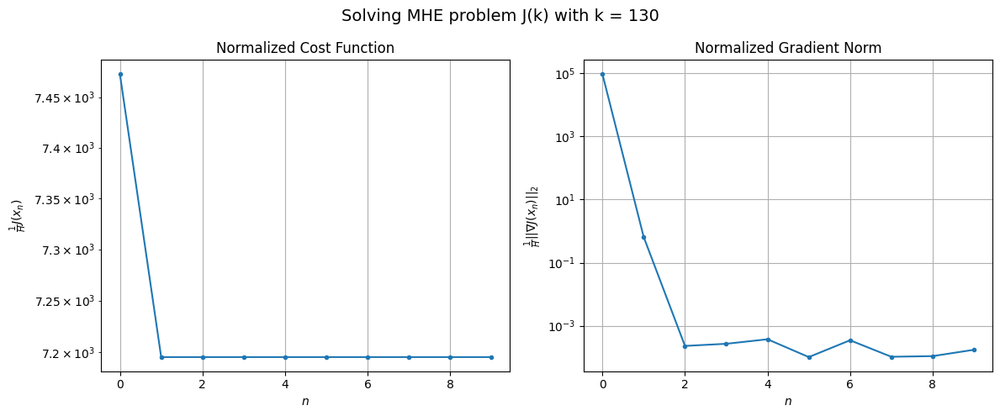

Windows:  28%|██▊       | 102/366 [10:39<25:29,  5.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 186157.017339785
Gradient norm: 2291562.9915889767
Global estimation error: 44.01135883069323
Initial conditions estimation errors: 21.37640945242281 m, 23.475167207628964 m, 19.071585872605795 m, 23.77412180624937 m
Position estimation errors: 11.695239181536934 m, 13.314681985730111 m, 16.536600047852446 m, 29.36300853655711 m

[Gauss-Newton] Iteration 1
Cost function: 179649.2465638796 (-3.50%)
Gradient norm: 153.16125179156094 (-99.99%)
Global estimation error: 53.41190263462465 (21.36%)
Initial conditions estimation errors: 24.84537531525941 m, 28.20519219788943 m, 21.349557862786643 m, 31.37150211479508 m
Position estimation errors: 8.96632550584796 m, 10.363995632714822 m, 14.783575728590213 m, 32.44152347246046 m

[Gauss-Newton] Iteration 2
Cost function: 179649.24644186726 (-0.00%)
Gradient norm: 0.004560753695845515 (-100.00%)
Global estimation error: 53.4080454691483 (-0.01%)
Initial conditions estimation errors: 24

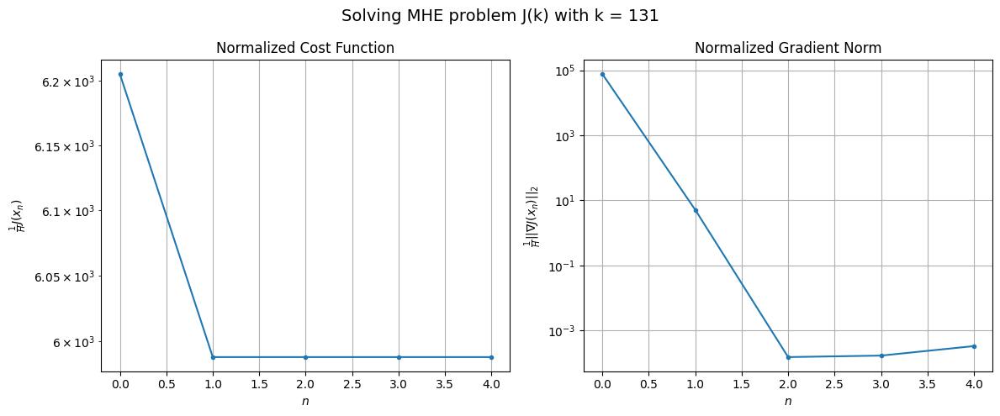

Windows:  28%|██▊       | 103/366 [10:43<22:57,  5.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 152878.85985226202
Gradient norm: 1666039.8332783838
Global estimation error: 43.79581921054555
Initial conditions estimation errors: 19.340013629800808 m, 22.80951642389621 m, 16.261714216622575 m, 27.55525448226004 m
Position estimation errors: 9.127659492672286 m, 10.27914888835019 m, 14.99618171139844 m, 30.654803235083534 m

[Gauss-Newton] Iteration 1
Cost function: 148119.5330635334 (-3.11%)
Gradient norm: 236.36588371213168 (-99.99%)
Global estimation error: 46.30616652609594 (5.73%)
Initial conditions estimation errors: 22.373343285045614 m, 24.23735610656461 m, 20.656315507686458 m, 25.09044364292449 m
Position estimation errors: 7.289919796191964 m, 8.297952532115465 m, 11.889972215445757 m, 21.01613818293298 m

[Gauss-Newton] Iteration 2
Cost function: 148119.53279027756 (-0.00%)
Gradient norm: 0.03163946828370214 (-99.99%)
Global estimation error: 46.30536157244187 (-0.00%)
Initial conditions estimation errors: 22.

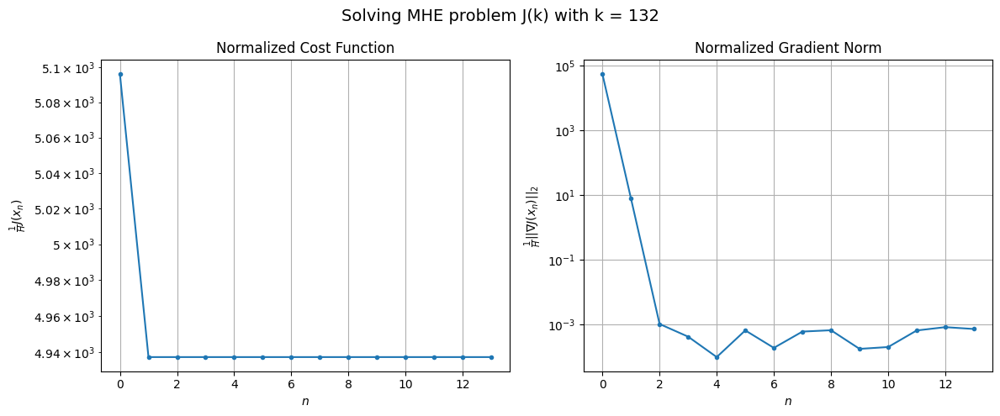

Windows:  28%|██▊       | 104/366 [10:53<29:08,  6.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 126179.70945798368
Gradient norm: 986229.2260272338
Global estimation error: 36.43122802086238
Initial conditions estimation errors: 17.053851375896798 m, 18.97242983704499 m, 15.544513275997787 m, 20.851567524294303 m
Position estimation errors: 7.705412772521993 m, 8.509208101987369 m, 12.219692991777633 m, 19.721650045338013 m

[Gauss-Newton] Iteration 1
Cost function: 122803.43093251872 (-2.68%)
Gradient norm: 123.01957183678488 (-99.99%)
Global estimation error: 41.07672864984603 (12.75%)
Initial conditions estimation errors: 19.65648521611738 m, 20.716399265467818 m, 18.74479289443983 m, 22.811256650842843 m
Position estimation errors: 6.783172068921519 m, 7.321823402877333 m, 9.373825130760888 m, 12.206485386990026 m

[Gauss-Newton] Iteration 2
Cost function: 122803.43088063043 (-0.00%)
Gradient norm: 0.01618616954859089 (-99.99%)
Global estimation error: 41.084156851622296 (0.02%)
Initial conditions estimation errors: 

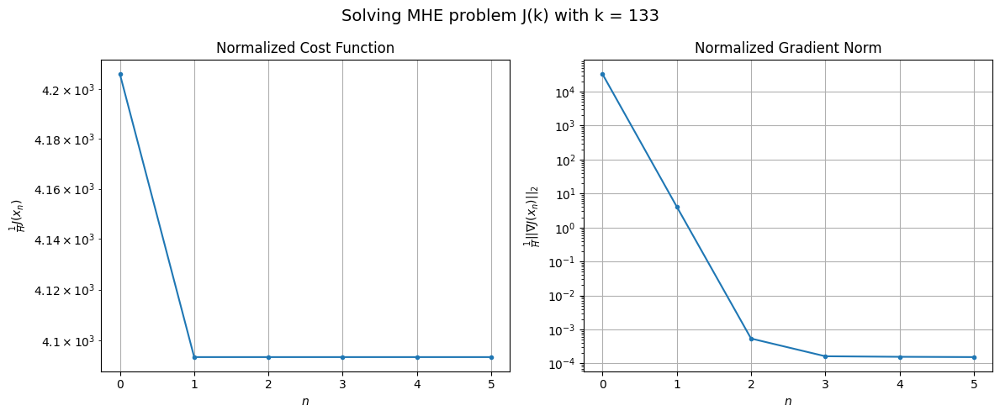

Windows:  29%|██▊       | 105/366 [10:58<26:46,  6.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 106839.29829064531
Gradient norm: 932698.4653216399
Global estimation error: 31.51956951181451
Initial conditions estimation errors: 14.66891892995173 m, 15.71463976717614 m, 13.924659495679998 m, 18.3693990006831 m
Position estimation errors: 7.659145027626542 m, 8.03828521698195 m, 9.809826053518911 m, 11.460581227918734 m

[Gauss-Newton] Iteration 1
Cost function: 104492.54107275904 (-2.20%)
Gradient norm: 9.668714495068901 (-100.00%)
Global estimation error: 34.703822274085596 (10.10%)
Initial conditions estimation errors: 16.85187952998829 m, 17.64362425631637 m, 15.868822446645156 m, 18.90043666557298 m
Position estimation errors: 7.332592247004808 m, 7.928937612031008 m, 9.279291448465953 m, 12.86267787430742 m

[Gauss-Newton] Iteration 2
Cost function: 104492.54106894086 (-0.00%)
Gradient norm: 0.00697883750749732 (-99.93%)
Global estimation error: 34.70607478306214 (0.01%)
Initial conditions estimation errors: 16.8518

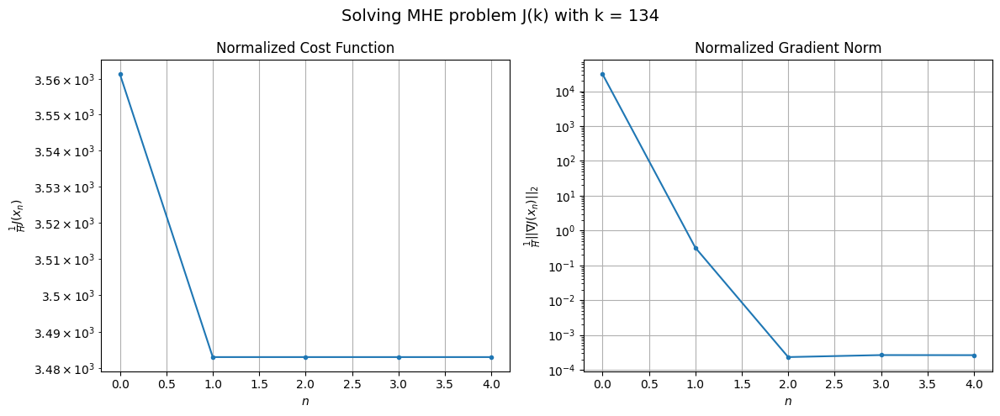

Windows:  29%|██▉       | 106/366 [11:02<24:13,  5.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 93709.53423115812
Gradient norm: 1463651.4991426321
Global estimation error: 26.270456584539332
Initial conditions estimation errors: 12.397334314047953 m, 13.151010298041028 m, 11.694835095250115 m, 15.056712530183127 m
Position estimation errors: 8.771288545271558 m, 8.963580908036425 m, 9.836970664327119 m, 12.138544644691224 m

[Gauss-Newton] Iteration 1
Cost function: 92073.31582337945 (-1.75%)
Gradient norm: 67.77443182201155 (-100.00%)
Global estimation error: 30.123893018443237 (14.67%)
Initial conditions estimation errors: 14.206328311935362 m, 15.461350206734783 m, 13.209177757794832 m, 17.090162645563883 m
Position estimation errors: 8.62344246019491 m, 8.744893132999021 m, 9.370767191693728 m, 15.643522193870634 m

[Gauss-Newton] Iteration 2
Cost function: 92073.31581474455 (-0.00%)
Gradient norm: 0.015118708808717145 (-99.98%)
Global estimation error: 30.115228939368468 (-0.03%)
Initial conditions estimation error

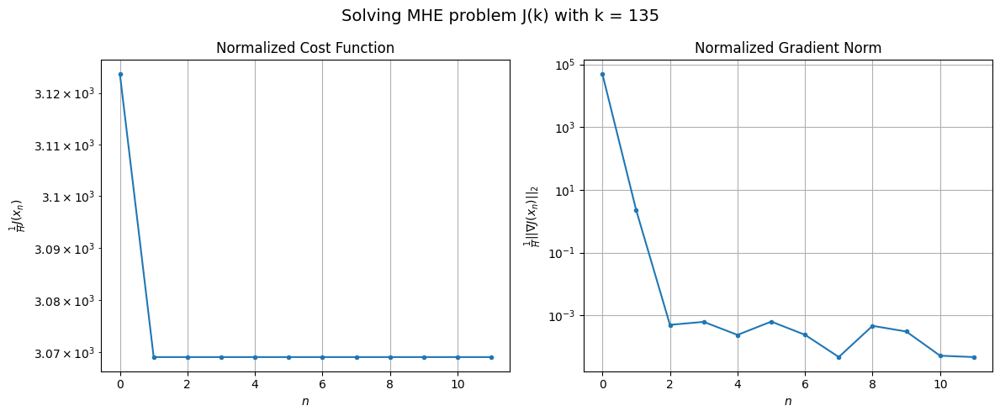

Windows:  29%|██▉       | 107/366 [11:11<28:26,  6.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 87776.58464568788
Gradient norm: 2343507.4392231447
Global estimation error: 23.18616268327362
Initial conditions estimation errors: 10.444055632965693 m, 11.562222269525089 m, 9.942373211657639 m, 13.998899248420262 m
Position estimation errors: 10.607822813603166 m, 10.293548359404424 m, 10.235762073862862 m, 14.748748580884074 m

[Gauss-Newton] Iteration 1
Cost function: 86569.13766195487 (-1.38%)
Gradient norm: 349.14545181134355 (-99.99%)
Global estimation error: 22.60031630442271 (-2.53%)
Initial conditions estimation errors: 11.832675559186821 m, 11.036268010814759 m, 12.084198088496207 m, 10.144873740337582 m
Position estimation errors: 10.18998074310929 m, 9.65197826379353 m, 10.60896257602828 m, 7.793551108454444 m

[Gauss-Newton] Iteration 2
Cost function: 86569.13710024123 (-0.00%)
Gradient norm: 0.013033888111161056 (-100.00%)
Global estimation error: 22.608924401288096 (0.04%)
Initial conditions estimation errors

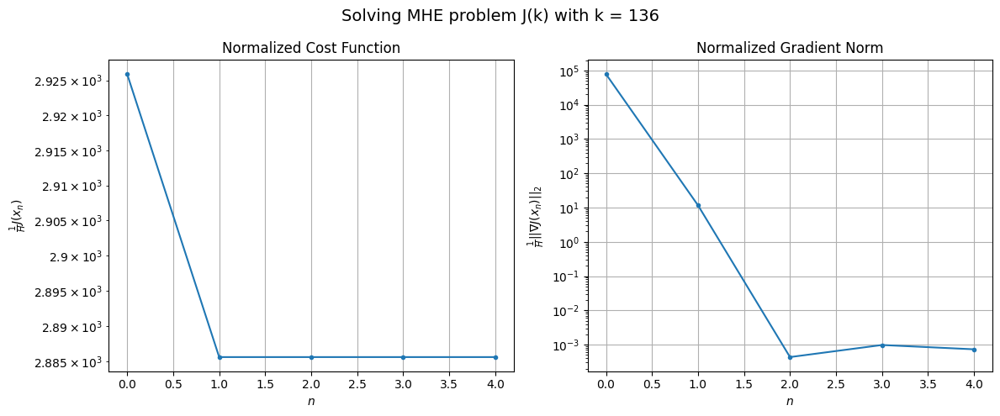

Windows:  30%|██▉       | 108/366 [11:16<25:27,  5.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 87332.4787230128
Gradient norm: 3046459.2310134983
Global estimation error: 16.927363673594694
Initial conditions estimation errors: 8.827817603836833 m, 7.992133700002404 m, 8.889923958401775 m, 8.104783702625062 m
Position estimation errors: 12.665717045010854 m, 11.797743580239157 m, 12.413204723101009 m, 9.556262036610207 m

[Gauss-Newton] Iteration 1
Cost function: 86236.3695694082 (-1.26%)
Gradient norm: 702.9652119078446 (-99.98%)
Global estimation error: 18.781655585548428 (10.95%)
Initial conditions estimation errors: 9.915887607669628 m, 7.668980909980935 m, 10.573961871721371 m, 9.153604802593007 m
Position estimation errors: 11.902456163614875 m, 11.296705553951355 m, 14.535895207880055 m, 17.907840779639145 m

[Gauss-Newton] Iteration 2
Cost function: 86236.367673821 (-0.00%)
Gradient norm: 0.009677871512071806 (-100.00%)
Global estimation error: 18.771422484127893 (-0.05%)
Initial conditions estimation errors: 9.

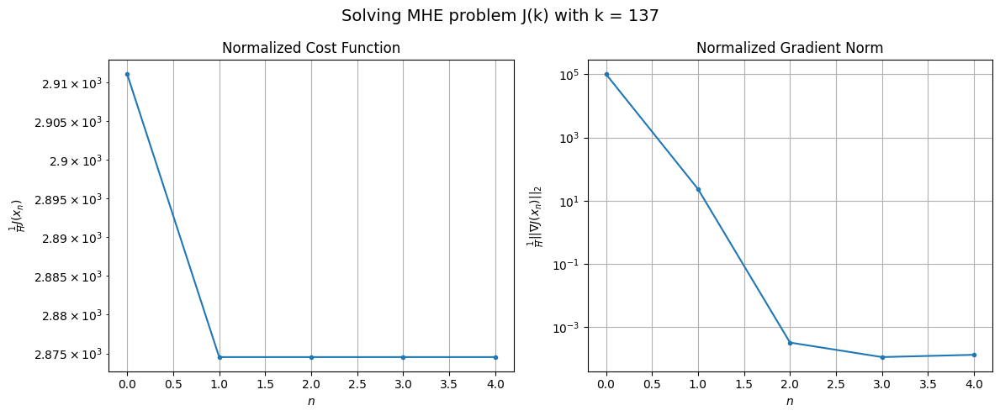

Windows:  30%|██▉       | 109/366 [11:20<22:56,  5.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 92418.81448087661
Gradient norm: 3918254.861084046
Global estimation error: 16.752280735711743
Initial conditions estimation errors: 7.656582214455443 m, 6.115610916456089 m, 7.383608330122669 m, 11.405474707813918 m
Position estimation errors: 14.80845355321973 m, 13.997195931240366 m, 17.07325009490276 m, 19.84635750413724 m

[Gauss-Newton] Iteration 1
Cost function: 91118.53157320763 (-1.41%)
Gradient norm: 31.25807264293485 (-100.00%)
Global estimation error: 16.95872751844309 (1.23%)
Initial conditions estimation errors: 8.49713355817393 m, 7.272095585156147 m, 8.276834630488395 m, 9.695137557249984 m
Position estimation errors: 13.560772376514834 m, 12.65616123244644 m, 15.14603453716847 m, 17.52472047800685 m

[Gauss-Newton] Iteration 2
Cost function: 91118.53155283476 (-0.00%)
Gradient norm: 0.021231779268626825 (-99.93%)
Global estimation error: 16.960650174516676 (0.01%)
Initial conditions estimation errors: 8.497133

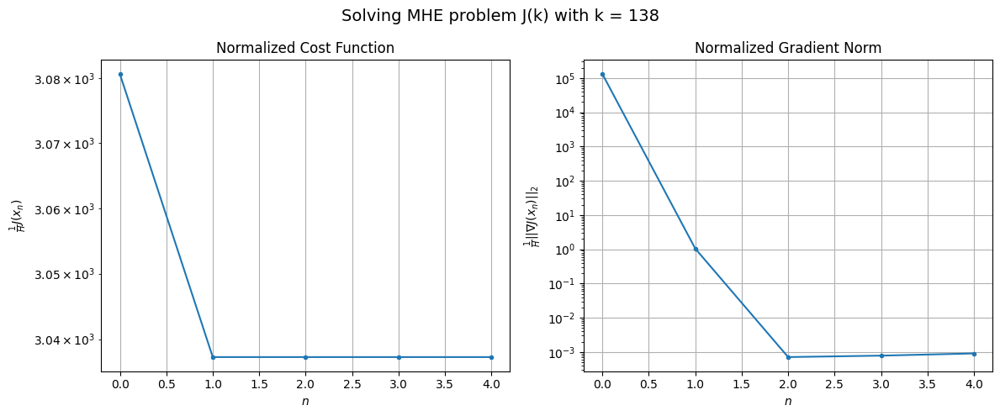

Windows:  30%|███       | 110/366 [11:24<21:39,  5.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 101839.01620410974
Gradient norm: 4570190.006489289
Global estimation error: 15.629252997023208
Initial conditions estimation errors: 6.993843164669868 m, 6.520768156531911 m, 6.083462725369524 m, 10.762000964408573 m
Position estimation errors: 16.815778657348762 m, 15.731484424269768 m, 18.24468847004246 m, 19.960265972580178 m

[Gauss-Newton] Iteration 1
Cost function: 100125.1976872956 (-1.68%)
Gradient norm: 57.48314718800868 (-100.00%)
Global estimation error: 14.723838664129513 (-5.79%)
Initial conditions estimation errors: 7.760210796703433 m, 7.207708605884844 m, 7.072216245718827 m, 7.38869769814085 m
Position estimation errors: 15.105987045902735 m, 14.870216899350511 m, 18.434907864382875 m, 25.537085464028912 m

[Gauss-Newton] Iteration 2
Cost function: 100125.19764932641 (-0.00%)
Gradient norm: 0.02074192522194157 (-99.96%)
Global estimation error: 14.722661343642676 (-0.01%)
Initial conditions estimation errors:

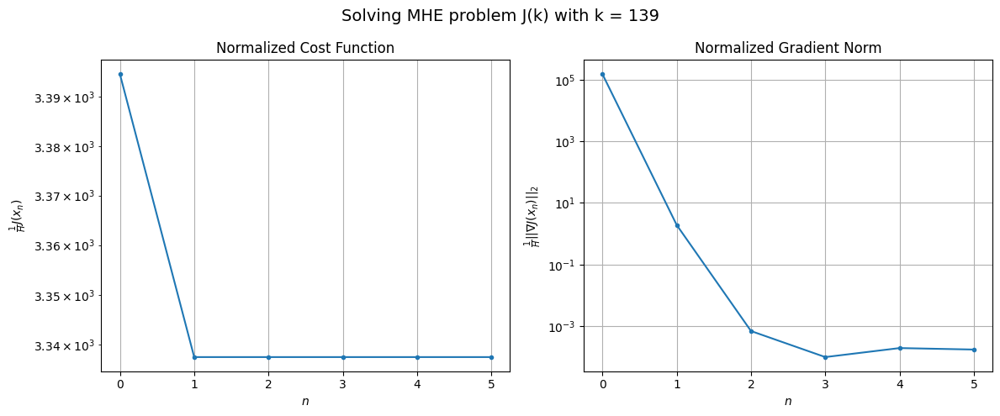

Windows:  30%|███       | 111/366 [11:29<20:53,  4.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 114700.83582436701
Gradient norm: 5098016.878882147
Global estimation error: 13.647312075760626
Initial conditions estimation errors: 7.024413172795998 m, 7.137780288998783 m, 5.673532865935886 m, 7.332198384309571 m
Position estimation errors: 18.628917313981088 m, 18.385526143040494 m, 22.122234961375945 m, 28.340602689973515 m

[Gauss-Newton] Iteration 1
Cost function: 112457.10402528578 (-1.96%)
Gradient norm: 79.92651422988686 (-100.00%)
Global estimation error: 21.120586549148925 (54.76%)
Initial conditions estimation errors: 7.866701765582886 m, 8.56232142089431 m, 7.6332360668831845 m, 15.893599274854386 m
Position estimation errors: 16.49311536666905 m, 15.79363322861827 m, 17.947865426829864 m, 19.413898463905532 m

[Gauss-Newton] Iteration 2
Cost function: 112457.10395378573 (-0.00%)
Gradient norm: 0.014301243345680234 (-99.98%)
Global estimation error: 21.177896968961363 (0.27%)
Initial conditions estimation errors

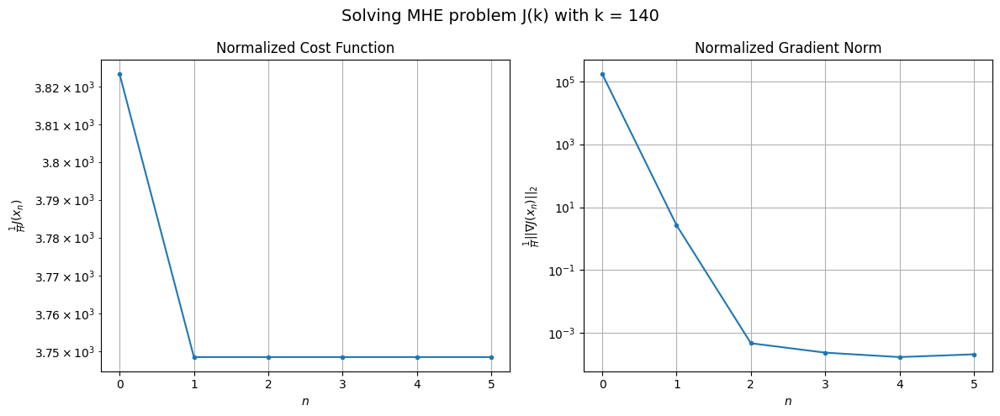

Windows:  31%|███       | 112/366 [11:33<20:28,  4.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 129836.7695773585
Gradient norm: 5551711.381835925
Global estimation error: 22.131491897799112
Initial conditions estimation errors: 7.756268395893423 m, 8.88533776521714 m, 7.402795882206418 m, 17.201334182576694 m
Position estimation errors: 20.199711892233577 m, 19.46923077101293 m, 21.612126430165397 m, 22.67357191577583 m

[Gauss-Newton] Iteration 1
Cost function: 126950.77704439787 (-2.22%)
Gradient norm: 19.728021926114263 (-100.00%)
Global estimation error: 30.03505380767707 (35.71%)
Initial conditions estimation errors: 8.812224529782386 m, 11.186895813953207 m, 9.419695151567064 m, 24.70961241871216 m
Position estimation errors: 17.67197994473607 m, 16.078316413565023 m, 18.986040921776258 m, 18.4888935297032 m

[Gauss-Newton] Iteration 2
Cost function: 126950.7770230689 (-0.00%)
Gradient norm: 0.004167913475535037 (-99.98%)
Global estimation error: 30.04450197970433 (0.03%)
Initial conditions estimation errors: 8.81

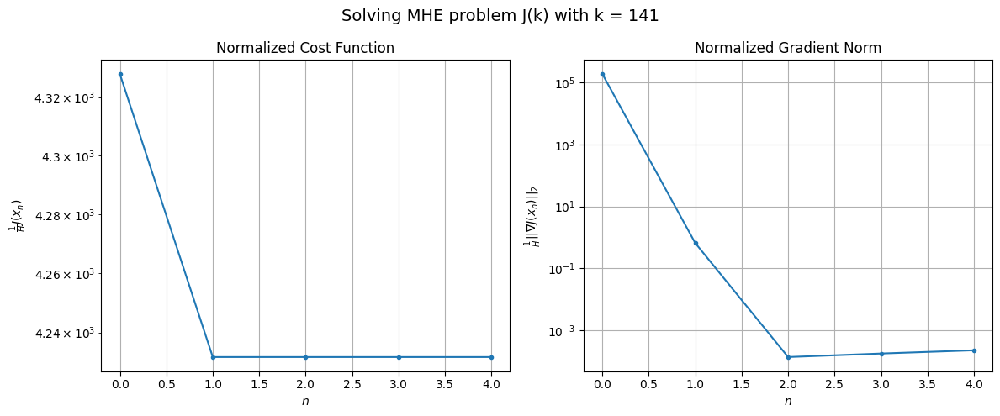

Windows:  31%|███       | 113/366 [11:37<19:19,  4.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 146058.98533548426
Gradient norm: 5793933.711665791
Global estimation error: 30.950443073415606
Initial conditions estimation errors: 8.99736904377424 m, 11.473790154316575 m, 9.562005787580413 m, 25.571303071632084 m
Position estimation errors: 21.48030441179562 m, 19.672738156252315 m, 22.63959622516537 m, 21.477545193704955 m

[Gauss-Newton] Iteration 1
Cost function: 142404.3796956129 (-2.50%)
Gradient norm: 160.35600595089244 (-100.00%)
Global estimation error: 38.84064307547717 (25.49%)
Initial conditions estimation errors: 10.406434897746387 m, 14.448118252277188 m, 11.156930045582666 m, 32.66604744530669 m
Position estimation errors: 18.593088727845323 m, 16.717942963435732 m, 21.446845973648987 m, 23.977046255163614 m

[Gauss-Newton] Iteration 2
Cost function: 142404.37957710074 (-0.00%)
Gradient norm: 0.008282241659373175 (-99.99%)
Global estimation error: 38.840046018425355 (-0.00%)
Initial conditions estimation err

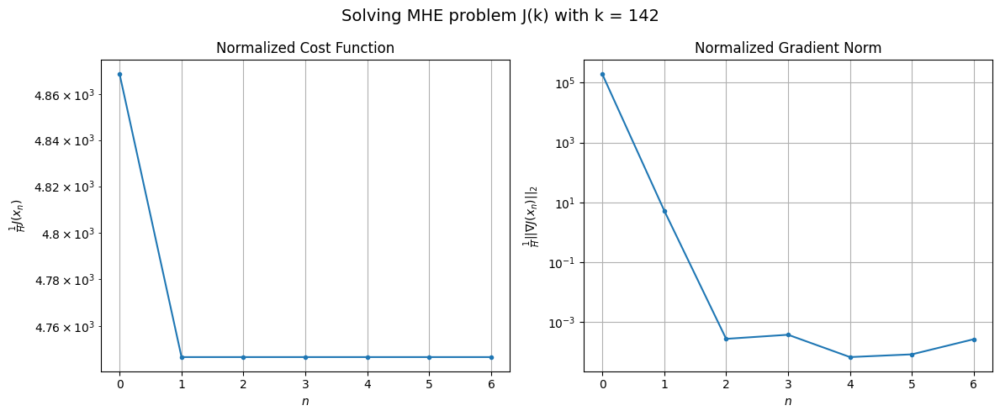

Windows:  31%|███       | 114/366 [11:43<20:24,  4.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 162072.2812889752
Gradient norm: 5968824.791389246
Global estimation error: 40.03706142890202
Initial conditions estimation errors: 10.54024853682436 m, 14.587984931533516 m, 11.556540008698908 m, 33.84525645843275 m
Position estimation errors: 22.443604546991615 m, 20.34083063987487 m, 25.070734842442562 m, 26.4682699661748 m

[Gauss-Newton] Iteration 1
Cost function: 157602.1338888665 (-2.76%)
Gradient norm: 78.06106488456496 (-100.00%)
Global estimation error: 43.78903360682572 (9.37%)
Initial conditions estimation errors: 12.31798035007701 m, 16.168633646809255 m, 13.703231972115493 m, 36.284138094998966 m
Position estimation errors: 19.24686146406816 m, 16.61607655610502 m, 20.509214605359947 m, 17.749462150271004 m

[Gauss-Newton] Iteration 2
Cost function: 157602.13387282167 (-0.00%)
Gradient norm: 0.015758509859688175 (-99.98%)
Global estimation error: 43.83664270367852 (0.11%)
Initial conditions estimation errors: 12.

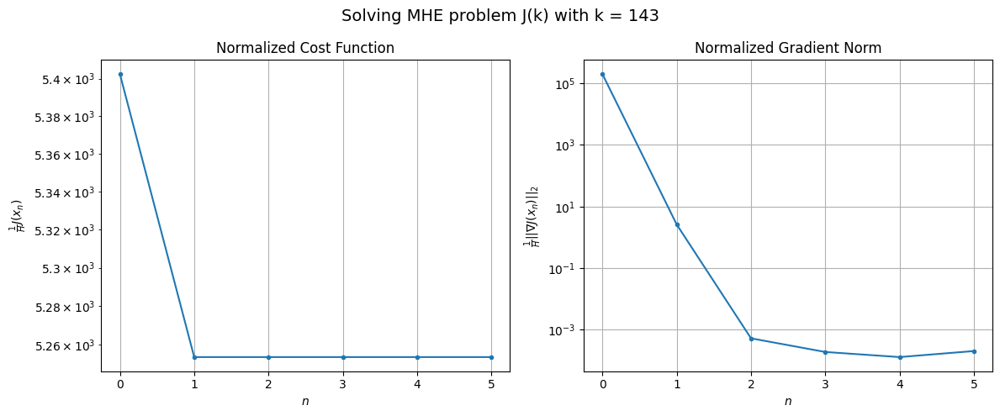

Windows:  31%|███▏      | 115/366 [11:48<20:31,  4.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 176486.1841636485
Gradient norm: 5988568.157703138
Global estimation error: 43.56480266332206
Initial conditions estimation errors: 12.112049192233373 m, 15.822218318093242 m, 13.68654038515913 m, 36.242535467922224 m
Position estimation errors: 23.097499991531777 m, 20.155282173283595 m, 24.087004288636276 m, 20.56275675309444 m

[Gauss-Newton] Iteration 1
Cost function: 171181.20487596624 (-3.01%)
Gradient norm: 1529.2017978315591 (-99.97%)
Global estimation error: 65.30517678454594 (49.90%)
Initial conditions estimation errors: 14.301820316305525 m, 21.24265431136826 m, 16.821195145279916 m, 57.67162159653505 m
Position estimation errors: 19.65964936037656 m, 17.12598572034897 m, 27.866478013339147 m, 35.34924107152265 m

[Gauss-Newton] Iteration 2
Cost function: 171181.19224544344 (-0.00%)
Gradient norm: 0.6317468175525529 (-99.96%)
Global estimation error: 64.86123066092868 (-0.68%)
Initial conditions estimation errors: 1

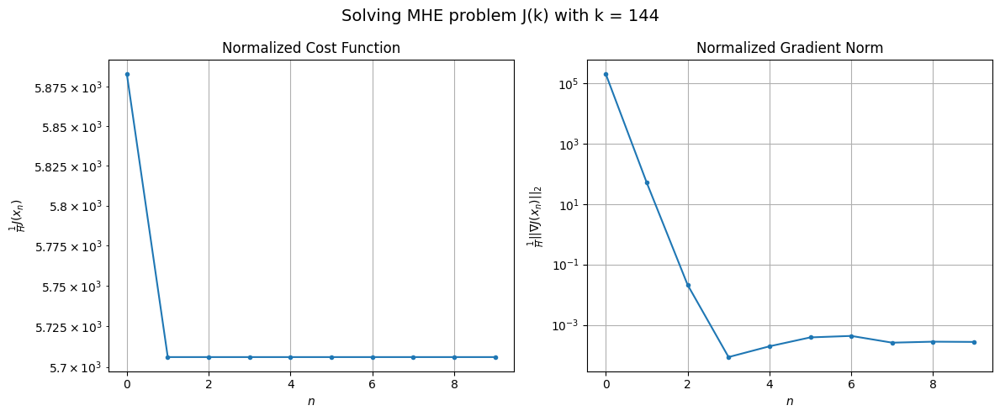

Windows:  32%|███▏      | 116/366 [11:55<23:31,  5.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 188593.59361456492
Gradient norm: 5940793.43240176
Global estimation error: 65.53319566187626
Initial conditions estimation errors: 13.56449616652245 m, 20.363240262739247 m, 17.15113401175895 m, 58.3247456642773 m
Position estimation errors: 23.498909811865854 m, 20.55397413752686 m, 31.034851006362356 m, 35.860339790193954 m

[Gauss-Newton] Iteration 1
Cost function: 182479.1023133001 (-3.24%)
Gradient norm: 1649.1541618312383 (-99.97%)
Global estimation error: 44.243446394794645 (-32.49%)
Initial conditions estimation errors: 16.160594253999967 m, 19.13981533616721 m, 16.940208580621402 m, 32.29565474577746 m
Position estimation errors: 19.872161077752246 m, 17.23764890100095 m, 22.05293756190471 m, 17.12947605996741 m

[Gauss-Newton] Iteration 2
Cost function: 182479.08003088456 (-0.00%)
Gradient norm: 0.1519262055311989 (-99.99%)
Global estimation error: 44.44270326347741 (0.45%)
Initial conditions estimation errors: 16.1

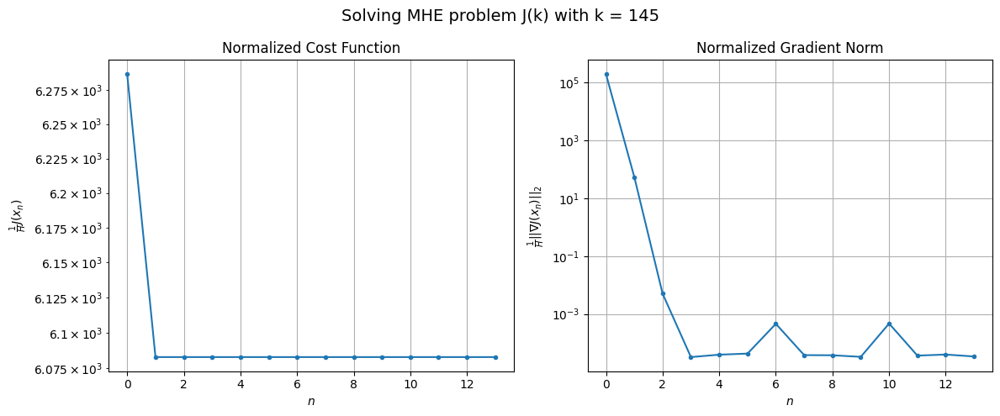

Windows:  32%|███▏      | 117/366 [12:05<28:54,  6.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 197052.51669499686
Gradient norm: 5764256.252374978
Global estimation error: 41.85344059826039
Initial conditions estimation errors: 14.801981014635313 m, 17.671955906003834 m, 15.908661697769817 m, 31.100182180916253 m
Position estimation errors: 23.706861909625026 m, 20.86985120589969 m, 25.841908438663452 m, 20.286336736191238 m

[Gauss-Newton] Iteration 1
Cost function: 190235.02891304623 (-3.46%)
Gradient norm: 85.81230097426689 (-100.00%)
Global estimation error: 49.384159754173716 (17.99%)
Initial conditions estimation errors: 17.771749872102127 m, 21.41233635898915 m, 19.535903498382076 m, 35.81638916956207 m
Position estimation errors: 19.958974587255593 m, 16.897281153231226 m, 22.414076769301232 m, 21.036547480418193 m

[Gauss-Newton] Iteration 2
Cost function: 190235.02889315132 (-0.00%)
Gradient norm: 0.0038791705273504154 (-100.00%)
Global estimation error: 49.41517860429663 (0.06%)
Initial conditions estimation 

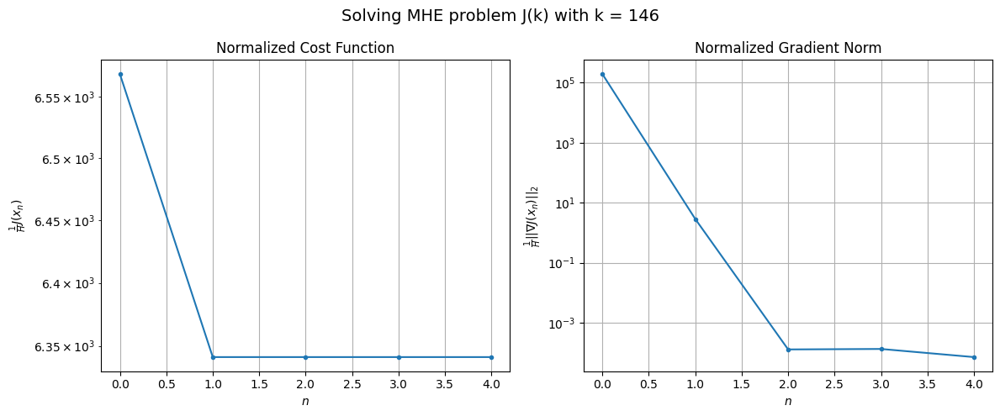

Windows:  32%|███▏      | 118/366 [12:09<25:06,  6.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 202186.4922823115
Gradient norm: 5693309.712783364
Global estimation error: 45.98721487600939
Initial conditions estimation errors: 15.76438806137955 m, 19.25408625773596 m, 18.00053177777026 m, 34.22805703790902 m
Position estimation errors: 23.79715867060694 m, 20.523017788138468 m, 26.034009588551264 m, 23.773561512848275 m

[Gauss-Newton] Iteration 1
Cost function: 194502.16425510249 (-3.80%)
Gradient norm: 3659.8729033321483 (-99.94%)
Global estimation error: 95.90991033954279 (108.56%)
Initial conditions estimation errors: 19.12622741158447 m, 27.907725599862843 m, 29.012095427824743 m, 84.92553564759164 m
Position estimation errors: 19.904889980574467 m, 15.926194983786125 m, 29.443222906020964 m, 42.589606401437905 m

[Gauss-Newton] Iteration 2
Cost function: 194502.03799224703 (-0.00%)
Gradient norm: 0.4036987622741428 (-99.99%)
Global estimation error: 96.32304121773258 (0.43%)
Initial conditions estimation errors: 1

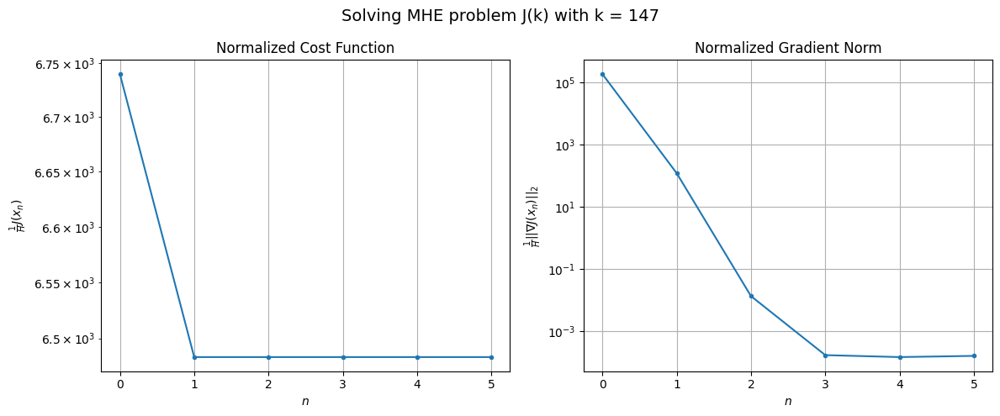

Windows:  33%|███▎      | 119/366 [12:14<23:19,  5.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 204210.52507633273
Gradient norm: 5707679.84331998
Global estimation error: 94.89560200641073
Initial conditions estimation errors: 16.479493965549057 m, 25.22165311742568 m, 28.169751726483167 m, 85.46299641621687 m
Position estimation errors: 23.744331813902907 m, 19.2737087235154 m, 32.123485854850095 m, 42.10918452567883 m

[Gauss-Newton] Iteration 1
Cost function: 195761.34974574056 (-4.14%)
Gradient norm: 652.3199975159745 (-99.99%)
Global estimation error: 112.33827233534207 (18.38%)
Initial conditions estimation errors: 20.173783023613204 m, 30.427410347524436 m, 34.10966344196958 m, 100.61608377259338 m
Position estimation errors: 19.736940591422115 m, 15.659067990802207 m, 32.77546832590438 m, 53.175753879037366 m

[Gauss-Newton] Iteration 2
Cost function: 195761.34770662544 (-0.00%)
Gradient norm: 0.4831569574833804 (-99.93%)
Global estimation error: 112.85505030444932 (0.46%)
Initial conditions estimation errors: 2

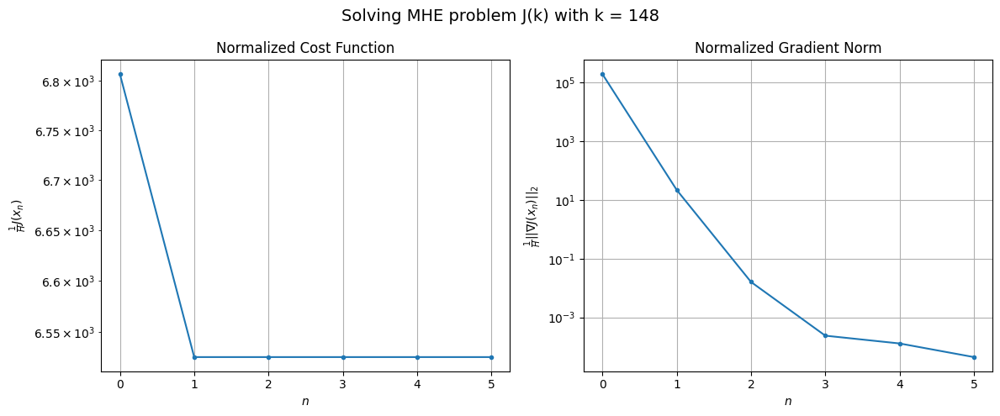

Windows:  33%|███▎      | 120/366 [12:18<21:57,  5.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 202210.3404177234
Gradient norm: 5510592.282342395
Global estimation error: 111.56836391804387
Initial conditions estimation errors: 16.915315922372578 m, 27.14878326628608 m, 33.02824514416818 m, 101.65350597530463 m
Position estimation errors: 23.56876749662531 m, 18.971609526008756 m, 35.07675166805305 m, 51.46968462616225 m

[Gauss-Newton] Iteration 1
Cost function: 193236.8235163808 (-4.44%)
Gradient norm: 6074.778462507125 (-99.89%)
Global estimation error: 62.87511883321048 (-43.64%)
Initial conditions estimation errors: 20.875061510375097 m, 25.34254007853765 m, 26.084415257801233 m, 46.849241663970886 m
Position estimation errors: 19.515056185436745 m, 14.825812187583304 m, 20.06483745743816 m, 18.262938157192174 m

[Gauss-Newton] Iteration 2
Cost function: 193236.50750882004 (-0.00%)
Gradient norm: 0.02764872625280362 (-100.00%)
Global estimation error: 62.76793626566916 (-0.17%)
Initial conditions estimation errors:

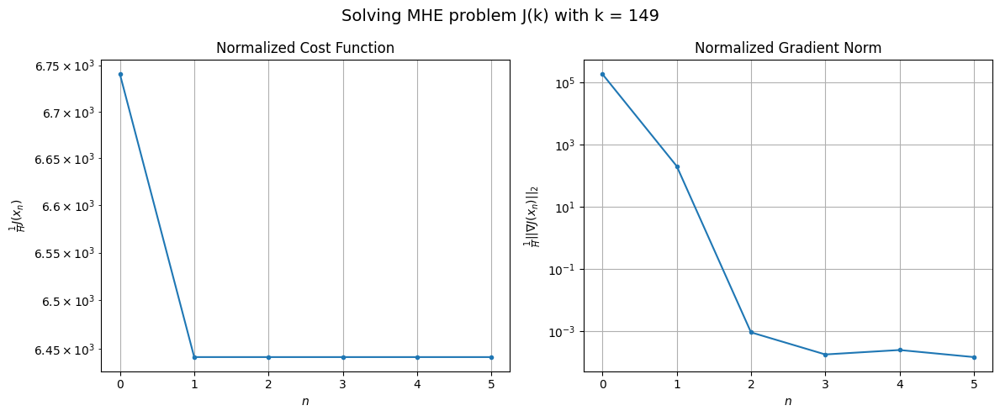

Windows:  33%|███▎      | 121/366 [12:23<21:17,  5.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 198449.3655156115
Gradient norm: 5492636.8114670515
Global estimation error: 55.76159675009314
Initial conditions estimation errors: 17.066100512918723 m, 21.25374662369285 m, 22.657946840005803 m, 43.046224262349 m
Position estimation errors: 23.328815354567194 m, 18.468201559078306 m, 23.43492686908344 m, 21.328252731702595 m

[Gauss-Newton] Iteration 1
Cost function: 189069.83898880333 (-4.73%)
Gradient norm: 760.4731602194006 (-99.99%)
Global estimation error: 40.10038001232994 (-28.09%)
Initial conditions estimation errors: 21.211593056693253 m, 21.123186002910806 m, 20.24169026407801 m, 17.38297081129502 m
Position estimation errors: 19.24182955178802 m, 16.397976508169947 m, 16.611730808286122 m, 13.230120534253768 m

[Gauss-Newton] Iteration 2
Cost function: 189069.82621061915 (-0.00%)
Gradient norm: 0.18186960056026544 (-99.98%)
Global estimation error: 39.96331900625578 (-0.34%)
Initial conditions estimation errors: 

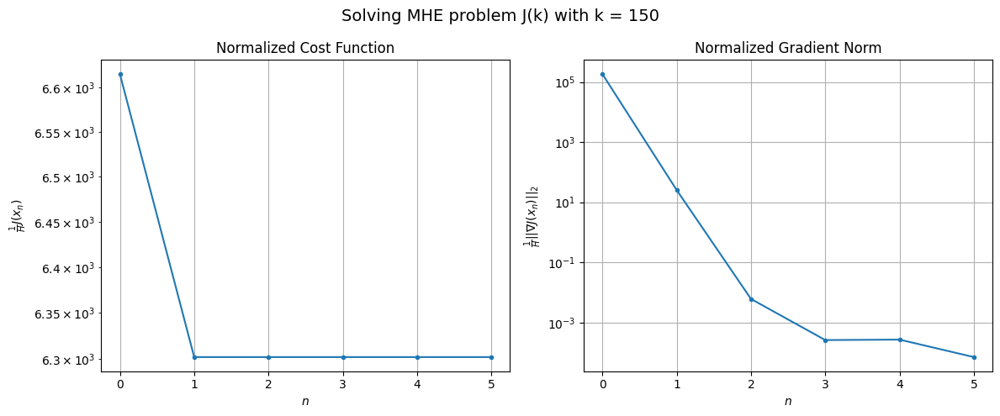

Windows:  33%|███▎      | 122/366 [12:28<20:24,  5.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 193019.92074831025
Gradient norm: 5412984.2534187315
Global estimation error: 31.432094447386305
Initial conditions estimation errors: 16.953153223544135 m, 16.727144604991597 m, 15.781596942772236 m, 13.102848617737058 m
Position estimation errors: 23.02956200557092 m, 20.206037809278154 m, 20.409321560749273 m, 17.219932928750964 m

[Gauss-Newton] Iteration 1
Cost function: 183469.23270760808 (-4.95%)
Gradient norm: 10177.20858113814 (-99.81%)
Global estimation error: 78.89565217172127 (151.00%)
Initial conditions estimation errors: 21.197520501252065 m, 16.49646417850783 m, 15.747942848450526 m, 72.49143234922882 m
Position estimation errors: 18.93785724955745 m, 15.262985923255403 m, 12.73776448016022 m, 35.17682794440731 m

[Gauss-Newton] Iteration 2
Cost function: 183468.30950929335 (-0.00%)
Gradient norm: 2.3779762625559893 (-99.98%)
Global estimation error: 80.2946060354853 (1.77%)
Initial conditions estimation errors:

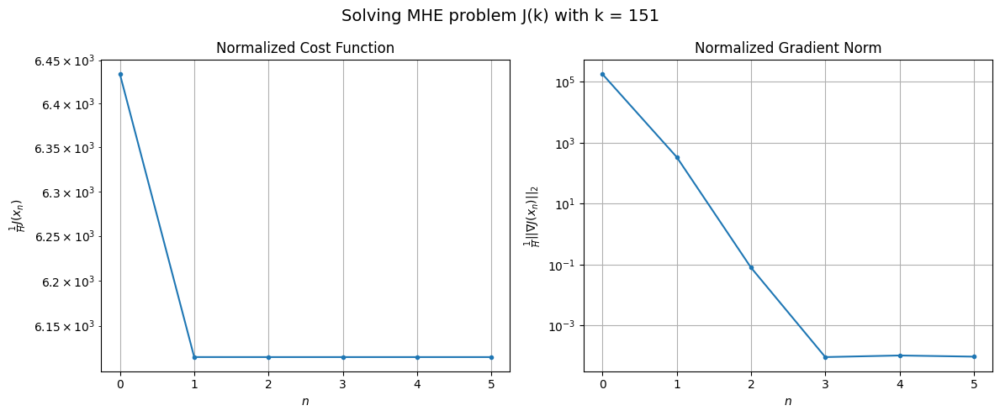

Windows:  34%|███▎      | 123/366 [12:33<20:14,  5.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 186344.5950713702
Gradient norm: 5223289.291732975
Global estimation error: 86.04663657316144
Initial conditions estimation errors: 16.66119552995166 m, 12.014258242672778 m, 13.922599704975172 m, 82.39054044805997 m
Position estimation errors: 22.690878059617255 m, 19.488480449472405 m, 15.68699286392862 m, 26.316602790365895 m

[Gauss-Newton] Iteration 1
Cost function: 176964.702588406 (-5.03%)
Gradient norm: 11129.9091084127 (-99.79%)
Global estimation error: 39.135876278006634 (-54.52%)
Initial conditions estimation errors: 20.919789963240028 m, 19.760786799683725 m, 17.394084483801187 m, 20.022672947124725 m
Position estimation errors: 18.673154709815645 m, 17.966249069711022 m, 17.89815737233462 m, 26.097946210218513 m

[Gauss-Newton] Iteration 2
Cost function: 176963.80756089385 (-0.00%)
Gradient norm: 0.7047567021521056 (-99.99%)
Global estimation error: 39.21169263571058 (0.19%)
Initial conditions estimation errors: 2

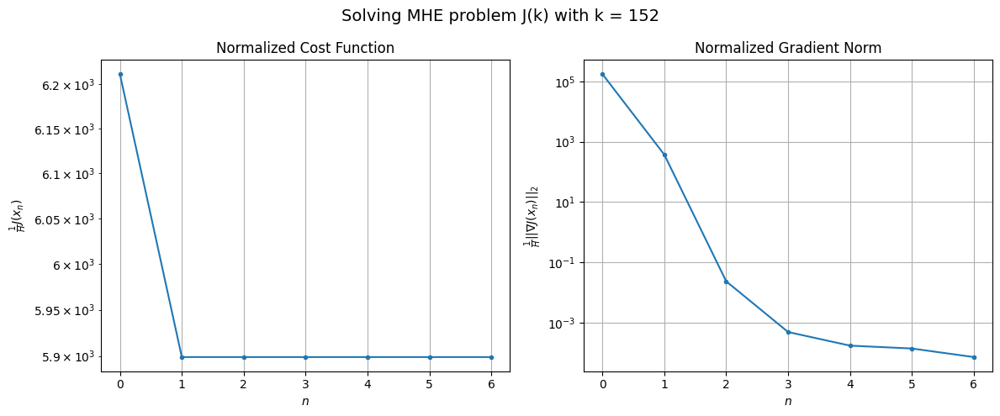

Windows:  34%|███▍      | 124/366 [12:38<20:30,  5.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 179603.8612192481
Gradient norm: 5131594.225432604
Global estimation error: 31.38790077048963
Initial conditions estimation errors: 16.318264299332142 m, 15.231743850051123 m, 13.001370928826635 m, 17.828308497867724 m
Position estimation errors: 22.395763074014038 m, 21.709131126420274 m, 21.87760377704975 m, 30.950549508311955 m

[Gauss-Newton] Iteration 1
Cost function: 170366.14668944594 (-5.14%)
Gradient norm: 642.274845948235 (-99.99%)
Global estimation error: 36.31092026966588 (15.68%)
Initial conditions estimation errors: 20.573432081444288 m, 19.347870101551486 m, 16.938458474275617 m, 15.294942119475538 m
Position estimation errors: 18.42966225725522 m, 17.01752700484862 m, 16.798498113807888 m, 10.679372596670852 m

[Gauss-Newton] Iteration 2
Cost function: 170366.14556357483 (-0.00%)
Gradient norm: 0.06291000485538921 (-99.99%)
Global estimation error: 36.311456856730295 (0.00%)
Initial conditions estimation errors

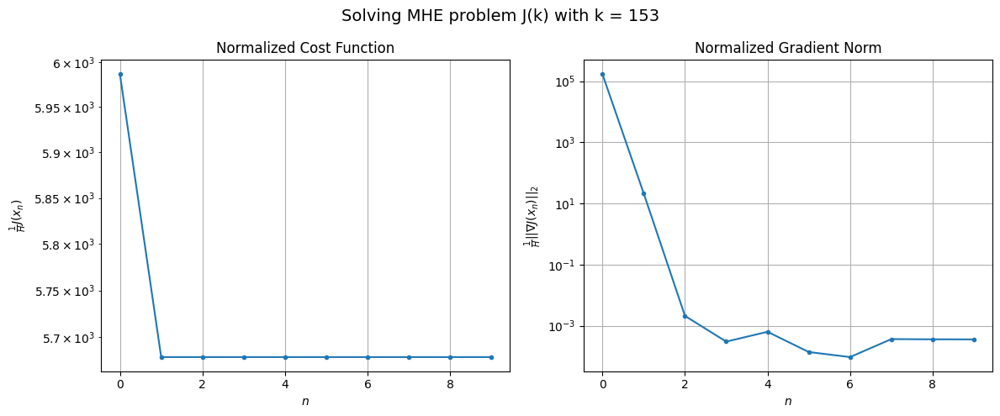

Windows:  34%|███▍      | 125/366 [12:45<23:07,  5.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 173685.83339381573
Gradient norm: 5106061.943869341
Global estimation error: 29.18829356018688
Initial conditions estimation errors: 16.09576071445859 m, 14.901008386546602 m, 12.31949240331602 m, 14.800300671545369 m
Position estimation errors: 22.130848970138512 m, 20.76165972687946 m, 20.824089991589425 m, 15.282424865560225 m

[Gauss-Newton] Iteration 1
Cost function: 164653.3697592036 (-5.20%)
Gradient norm: 4420.92031947695 (-99.91%)
Global estimation error: 40.73852489562377 (39.57%)
Initial conditions estimation errors: 20.311580229456325 m, 19.09529033495588 m, 18.419713613257574 m, 23.304715413098663 m
Position estimation errors: 18.218638166286365 m, 12.772500021232315 m, 11.679979674245399 m, 42.92634824589799 m

[Gauss-Newton] Iteration 2
Cost function: 164653.3044798096 (-0.00%)
Gradient norm: 1.1451391138429257 (-99.97%)
Global estimation error: 40.612034881471295 (-0.31%)
Initial conditions estimation errors: 2

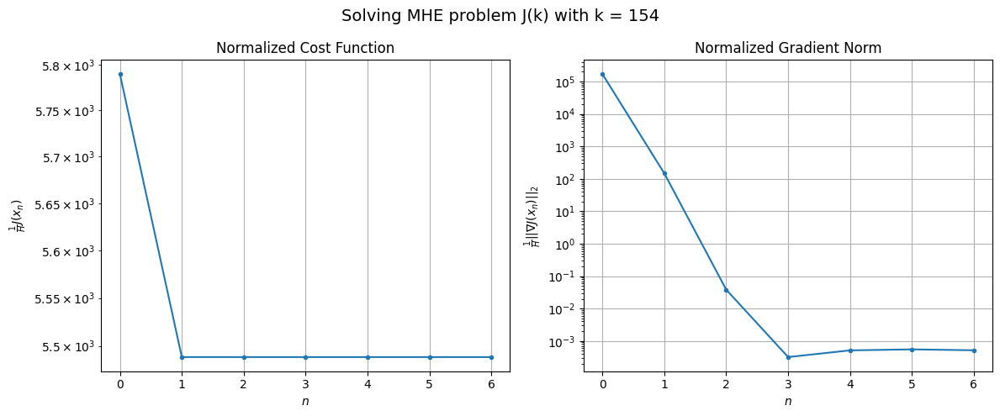

Windows:  34%|███▍      | 126/366 [12:51<23:00,  5.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 168661.08770942228
Gradient norm: 5123690.279481092
Global estimation error: 39.30240221601217
Initial conditions estimation errors: 16.058760895694743 m, 14.6557872363716 m, 14.236449544596216 m, 29.483770584317362 m
Position estimation errors: 21.900864147125098 m, 16.655766060564847 m, 16.153735236399708 m, 36.45218340851673 m

[Gauss-Newton] Iteration 1
Cost function: 159766.91708599316 (-5.27%)
Gradient norm: 6467.442870455824 (-99.87%)
Global estimation error: 36.173634161244514 (-7.96%)
Initial conditions estimation errors: 20.227886202925667 m, 18.51442750201166 m, 17.65814481391958 m, 15.644414599980259 m
Position estimation errors: 18.00512862560825 m, 18.976396175844478 m, 20.291011337965344 m, 18.83184315387774 m

[Gauss-Newton] Iteration 2
Cost function: 159766.73823316247 (-0.00%)
Gradient norm: 12.52357845558018 (-99.81%)
Global estimation error: 35.95014169424878 (-0.62%)
Initial conditions estimation errors: 2

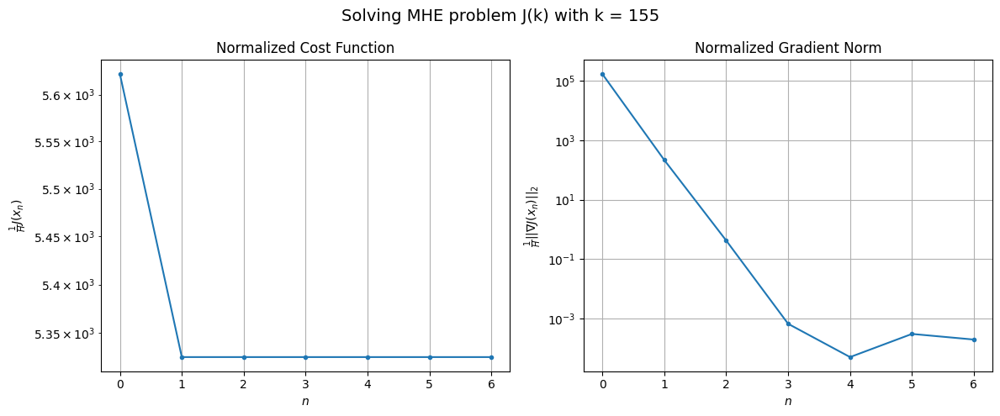

Windows:  35%|███▍      | 127/366 [12:56<22:10,  5.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 162537.18605025834
Gradient norm: 5023437.5698551955
Global estimation error: 28.20203568090107
Initial conditions estimation errors: 16.196176853344728 m, 14.63406136590386 m, 13.690787799236874 m, 11.464138057811047 m
Position estimation errors: 21.652011944126798 m, 22.230092672295203 m, 23.52835344731464 m, 20.627731761639495 m

[Gauss-Newton] Iteration 1
Cost function: 153801.9547077255 (-5.37%)
Gradient norm: 2290.3502060965347 (-99.95%)
Global estimation error: 41.165899400111066 (45.97%)
Initial conditions estimation errors: 20.336688501221847 m, 18.192070853696332 m, 19.182276175306594 m, 24.127139802820228 m
Position estimation errors: 17.80307185996373 m, 23.37308931943588 m, 24.05050395268791 m, 53.92256614490242 m

[Gauss-Newton] Iteration 2
Cost function: 153801.93915526243 (-0.00%)
Gradient norm: 0.13682059670813976 (-99.99%)
Global estimation error: 41.114212961652974 (-0.13%)
Initial conditions estimation erro

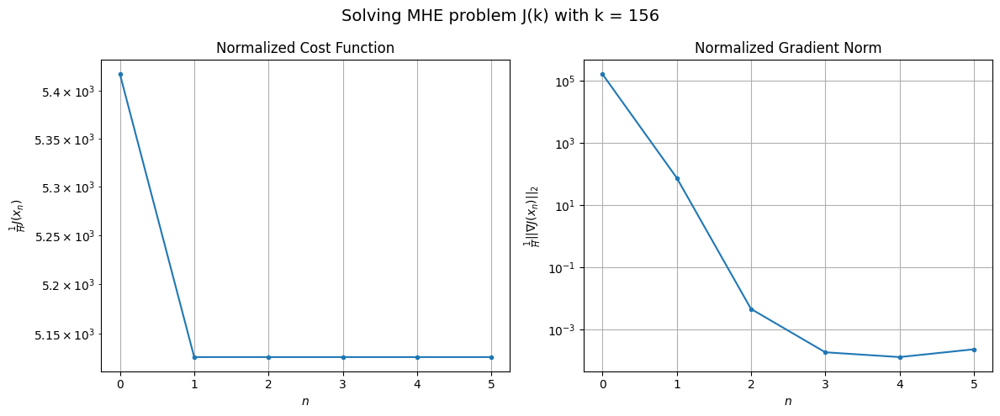

Windows:  35%|███▍      | 128/366 [13:01<21:04,  5.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 156350.28898879988
Gradient norm: 5071554.11851324
Global estimation error: 34.124368109444895
Initial conditions estimation errors: 16.440130481869176 m, 14.648153570499364 m, 16.354981610743923 m, 20.30080781973283 m
Position estimation errors: 21.39736228386334 m, 26.680824435542114 m, 27.19336779079375 m, 55.99167636015291 m

[Gauss-Newton] Iteration 1
Cost function: 147698.68168529434 (-5.53%)
Gradient norm: 8376.748564599626 (-99.83%)
Global estimation error: 36.433426394872924 (6.77%)
Initial conditions estimation errors: 20.54609609695909 m, 18.416675855902774 m, 16.693659867633453 m, 16.95206959324201 m
Position estimation errors: 17.559687804318695 m, 15.595446166221473 m, 15.570759476473295 m, 17.80884262951844 m

[Gauss-Newton] Iteration 2
Cost function: 147698.43516356498 (-0.00%)
Gradient norm: 10.507352682739274 (-99.87%)
Global estimation error: 36.61429123021955 (0.50%)
Initial conditions estimation errors: 20

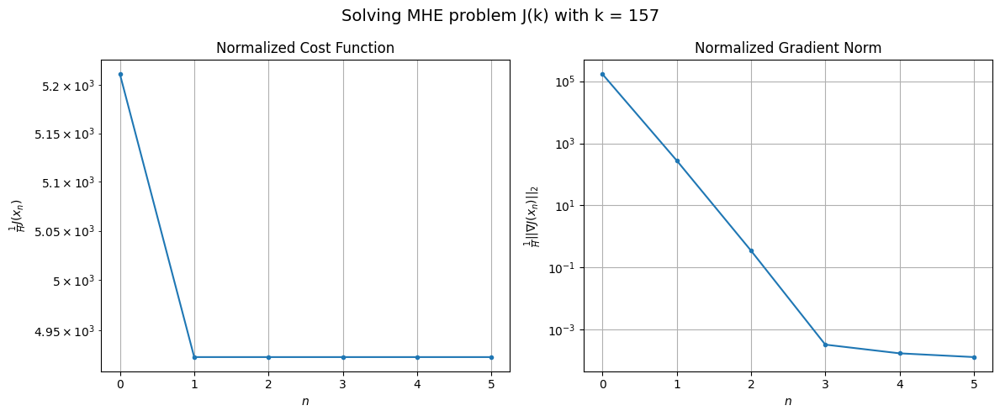

Windows:  35%|███▌      | 129/366 [13:06<20:00,  5.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 149657.53791242314
Gradient norm: 5075541.72534598
Global estimation error: 31.958202904025132
Initial conditions estimation errors: 16.66160550845882 m, 14.624744587952335 m, 12.262954706866868 m, 19.478926266829074 m
Position estimation errors: 21.097842723848366 m, 18.876039587341563 m, 19.28333576617288 m, 17.426940887603283 m

[Gauss-Newton] Iteration 1
Cost function: 141073.09960884455 (-5.74%)
Gradient norm: 4601.815325816384 (-99.91%)
Global estimation error: 37.65902622711 (17.84%)
Initial conditions estimation errors: 20.726747776734754 m, 18.250323641179342 m, 18.743403915058625 m, 17.44111253637402 m
Position estimation errors: 17.258424007539432 m, 20.289134005502323 m, 20.764295064630883 m, 33.362793170788066 m

[Gauss-Newton] Iteration 2
Cost function: 141073.02055744172 (-0.00%)
Gradient norm: 5.286781280221786 (-99.89%)
Global estimation error: 37.86861959372744 (0.56%)
Initial conditions estimation errors: 20

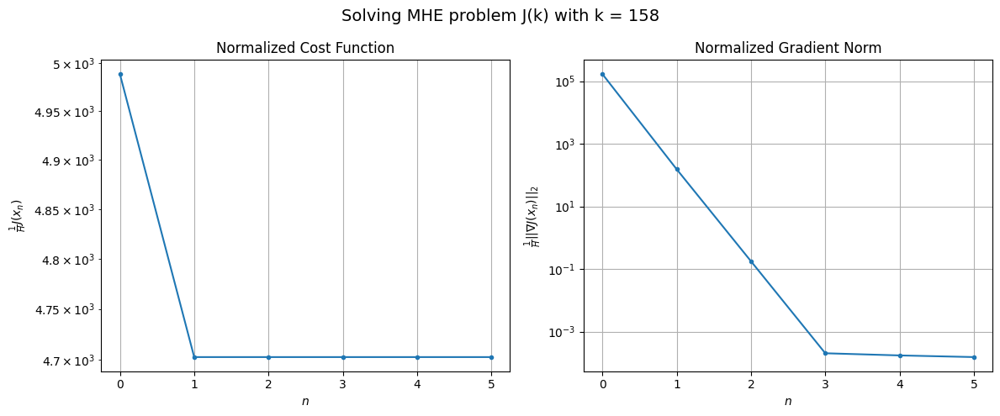

Windows:  36%|███▌      | 130/366 [13:11<19:57,  5.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 141212.98144708612
Gradient norm: 5271663.871155151
Global estimation error: 30.328441014559168
Initial conditions estimation errors: 16.743785999123613 m, 14.540654307861622 m, 15.32436481107949 m, 13.898646777430658 m
Position estimation errors: 20.785589889426376 m, 23.782430634164392 m, 24.19000873234775 m, 37.767347787949326 m

[Gauss-Newton] Iteration 1
Cost function: 132596.4486469936 (-6.10%)
Gradient norm: 28.988231821867636 (-100.00%)
Global estimation error: 36.85329939807938 (21.51%)
Initial conditions estimation errors: 20.782630685897978 m, 17.938334159610665 m, 17.720460516610572 m, 17.04186295475009 m
Position estimation errors: 16.920231604814823 m, 19.198205363103632 m, 20.328976019763953 m, 32.798589773961886 m

[Gauss-Newton] Iteration 2
Cost function: 132596.44863266533 (-0.00%)
Gradient norm: 0.009215830894377308 (-99.97%)
Global estimation error: 36.849212461241734 (-0.01%)
Initial conditions estimation 

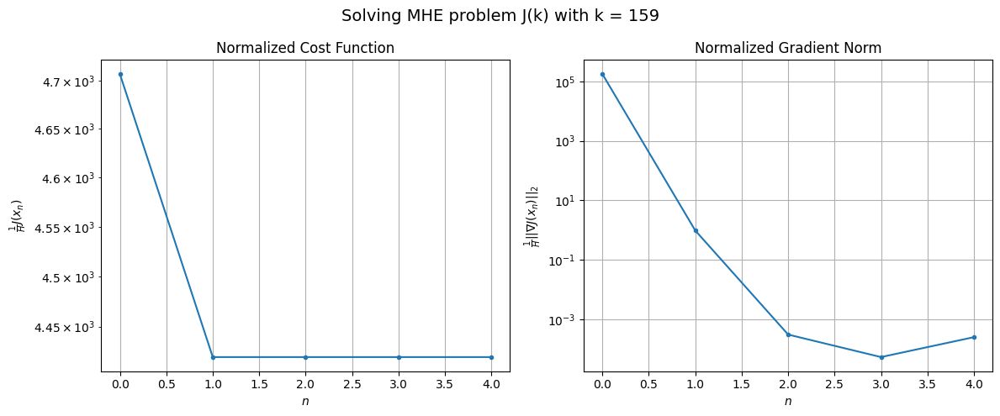

Windows:  36%|███▌      | 131/366 [13:15<19:18,  4.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 131882.80228417274
Gradient norm: 5370660.578088011
Global estimation error: 28.901990971808424
Initial conditions estimation errors: 16.626607539218995 m, 14.068287761204365 m, 13.96904307207075 m, 12.876629796591528 m
Position estimation errors: 20.51916937561245 m, 22.640234763043804 m, 23.735590068090943 m, 35.67379223126803 m

[Gauss-Newton] Iteration 1
Cost function: 123494.68475583979 (-6.36%)
Gradient norm: 5162.19438751619 (-99.90%)
Global estimation error: 53.3484582914058 (84.58%)
Initial conditions estimation errors: 20.559570740083576 m, 18.55901041319858 m, 24.97280684728356 m, 38.14783108305026 m
Position estimation errors: 16.661871558537243 m, 25.552478345371515 m, 24.574368885725544 m, 80.00098996298709 m

[Gauss-Newton] Iteration 2
Cost function: 123494.57142168836 (-0.00%)
Gradient norm: 2.9869620722684376 (-99.94%)
Global estimation error: 52.92558238025431 (-0.79%)
Initial conditions estimation errors: 20

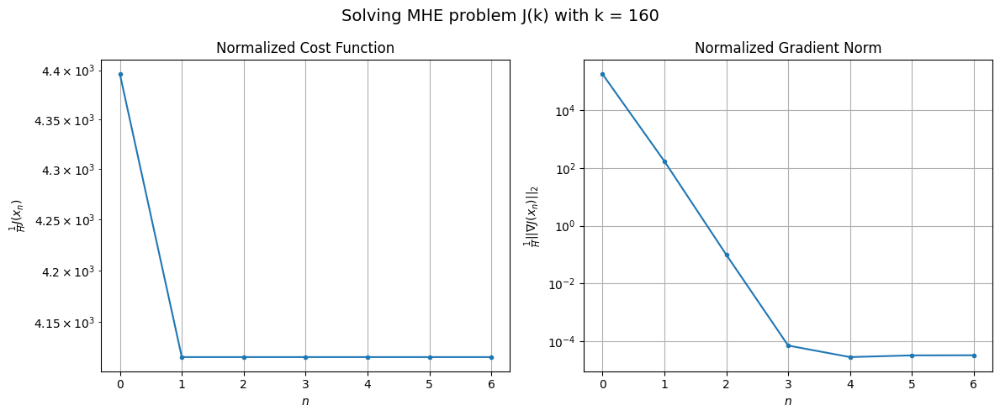

Windows:  36%|███▌      | 132/366 [13:21<20:38,  5.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 123851.43801757056
Gradient norm: 5769552.969704837
Global estimation error: 48.669195386597
Initial conditions estimation errors: 16.22780567287524 m, 14.83612122153962 m, 21.91136562083779 m, 37.48475266887444 m
Position estimation errors: 20.44324366247105 m, 28.428291173965288 m, 27.17497894913114 m, 78.12935595764834 m

[Gauss-Newton] Iteration 1
Cost function: 115615.07287443854 (-6.65%)
Gradient norm: 652.4255835461187 (-99.99%)
Global estimation error: 63.53746817886268 (30.55%)
Initial conditions estimation errors: 20.026801470263017 m, 18.046566159598303 m, 27.640150877387615 m, 50.46039444871103 m
Position estimation errors: 16.52933585461543 m, 28.06729387277902 m, 25.97410744352318 m, 93.02608750964535 m

[Gauss-Newton] Iteration 2
Cost function: 115615.07109385285 (-0.00%)
Gradient norm: 0.0050135413772397774 (-100.00%)
Global estimation error: 63.54673025770633 (0.01%)
Initial conditions estimation errors: 20.02

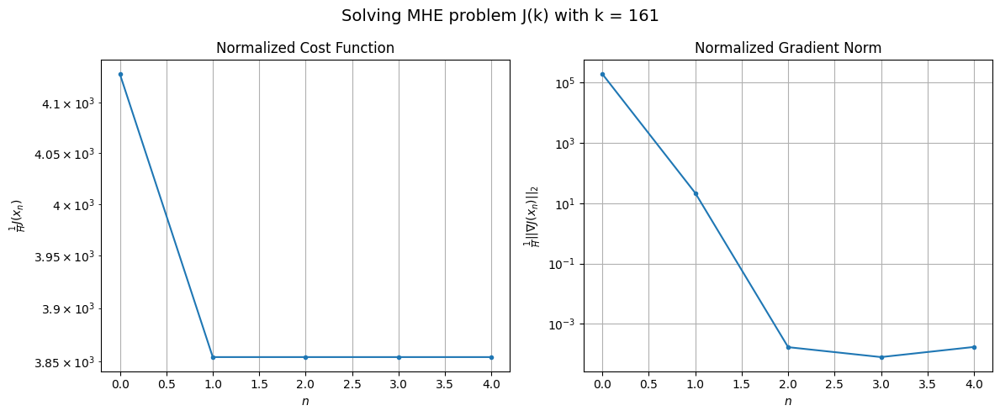

Windows:  36%|███▋      | 133/366 [13:26<19:40,  5.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116644.97397388358
Gradient norm: 6245543.186637429
Global estimation error: 61.38214828968862
Initial conditions estimation errors: 15.575035630925965 m, 14.426062035550707 m, 24.80291096131727 m, 51.97947682211481 m
Position estimation errors: 20.55209666953276 m, 30.945885177892322 m, 28.375396879240533 m, 90.94880856975652 m

[Gauss-Newton] Iteration 1
Cost function: 108397.88944519653 (-7.07%)
Gradient norm: 148.0944632866237 (-100.00%)
Global estimation error: 75.06840535437608 (22.30%)
Initial conditions estimation errors: 19.280877870540298 m, 17.49535321648789 m, 30.52575746186555 m, 63.44741905851664 m
Position estimation errors: 16.548150142796523 m, 30.742385491916213 m, 24.69140917381901 m, 93.04555519724218 m

[Gauss-Newton] Iteration 2
Cost function: 108397.88933035544 (-0.00%)
Gradient norm: 0.02037427147667754 (-99.99%)
Global estimation error: 75.08855418707499 (0.03%)
Initial conditions estimation errors: 19

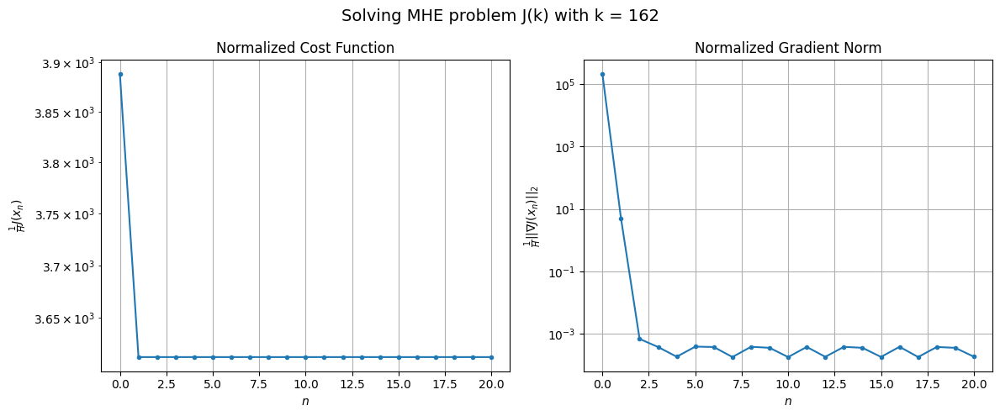

Windows:  37%|███▋      | 134/366 [13:42<32:10,  8.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 111210.09986467159
Gradient norm: 6606222.5837128945
Global estimation error: 73.98307713521726
Initial conditions estimation errors: 14.795415990731751 m, 13.887297142943192 m, 27.425548963974045 m, 65.6471624930176 m
Position estimation errors: 20.790768221014442 m, 33.4477628332356 m, 27.17737149110705 m, 90.31956884217438 m

[Gauss-Newton] Iteration 1
Cost function: 103341.47965257733 (-7.08%)
Gradient norm: 4879.944648282035 (-99.93%)
Global estimation error: 40.4270244765934 (-45.36%)
Initial conditions estimation errors: 18.30616741845894 m, 13.650238275134502 m, 20.314428228681265 m, 26.461302855131844 m
Position estimation errors: 16.776084390734134 m, 24.75524928837118 m, 20.42228172878048 m, 48.55251420165751 m

[Gauss-Newton] Iteration 2
Cost function: 103341.34026307205 (-0.00%)
Gradient norm: 0.5007385950584078 (-99.99%)
Global estimation error: 40.2617093524337 (-0.41%)
Initial conditions estimation errors: 18.3

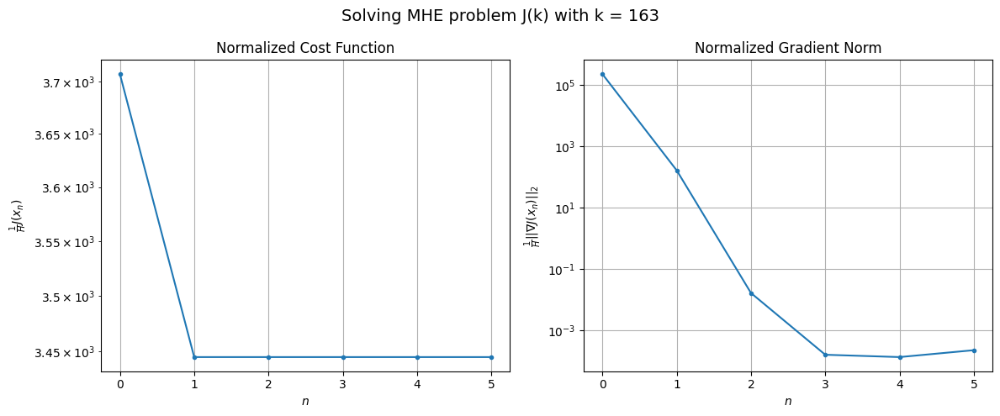

Windows:  37%|███▋      | 135/366 [13:46<27:46,  7.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 109252.40183643653
Gradient norm: 7160637.319573392
Global estimation error: 33.69923591985135
Initial conditions estimation errors: 13.890394157673214 m, 9.569479266921713 m, 16.29341691890447 m, 24.199731941675818 m
Position estimation errors: 21.176714735263296 m, 27.913426222812006 m, 23.80653514775817 m, 48.89448613945573 m

[Gauss-Newton] Iteration 1
Cost function: 101678.07113894862 (-6.93%)
Gradient norm: 30.504540698451457 (-100.00%)
Global estimation error: 44.256697638604415 (31.33%)
Initial conditions estimation errors: 17.18836990808856 m, 13.788655341158835 m, 20.617469729764537 m, 32.37264440919744 m
Position estimation errors: 17.088736521721703 m, 24.075910449954012 m, 19.9687715355134 m, 47.3263113372745 m

[Gauss-Newton] Iteration 2
Cost function: 101678.07112704532 (-0.00%)
Gradient norm: 0.0032138679458099686 (-99.99%)
Global estimation error: 44.26510847155057 (0.02%)
Initial conditions estimation errors:

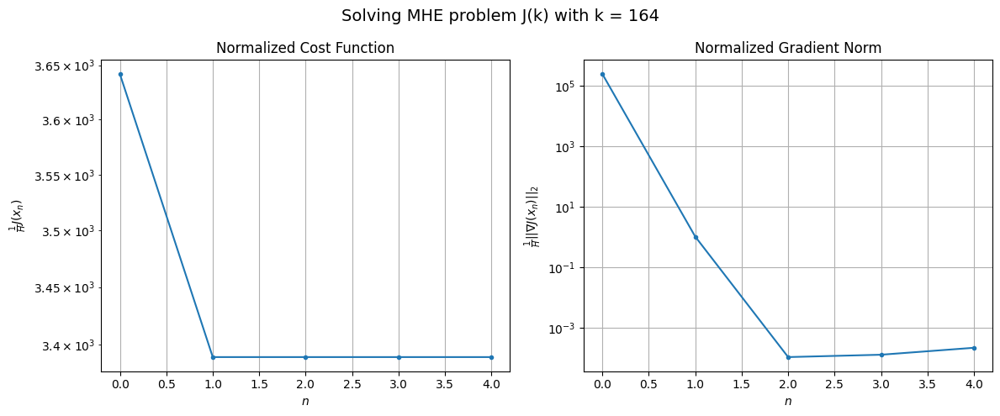

Windows:  37%|███▋      | 136/366 [13:50<23:55,  6.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 110117.83071389765
Gradient norm: 7639666.300971135
Global estimation error: 39.15791004949197
Initial conditions estimation errors: 12.93373154152437 m, 9.980471132202384 m, 16.950214304125904 m, 31.29098369208402 m
Position estimation errors: 21.55778198627632 m, 27.226393769107002 m, 23.246873592385985 m, 47.726833252980576 m

[Gauss-Newton] Iteration 1
Cost function: 102649.97675596687 (-6.78%)
Gradient norm: 279.9773443185288 (-100.00%)
Global estimation error: 49.81957849453214 (27.23%)
Initial conditions estimation errors: 16.08100821898338 m, 12.759569638268324 m, 20.626796751369746 m, 40.43640287515735 m
Position estimation errors: 17.37452521796416 m, 25.221824522954936 m, 20.15267658279889 m, 55.7468844129825 m

[Gauss-Newton] Iteration 2
Cost function: 102649.97640986068 (-0.00%)
Gradient norm: 0.006209699140988503 (-100.00%)
Global estimation error: 49.858560237213425 (0.08%)
Initial conditions estimation errors: 

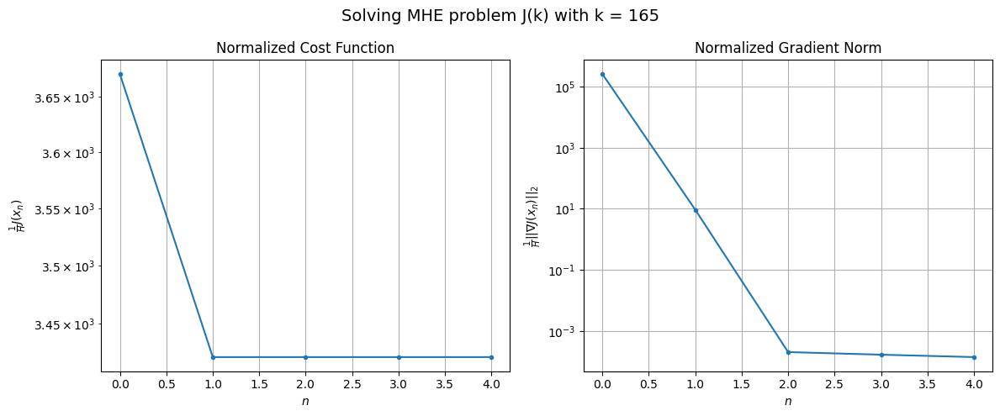

Windows:  37%|███▋      | 137/366 [13:54<21:08,  5.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 113757.6286527848
Gradient norm: 7987111.928594139
Global estimation error: 46.59740051101848
Initial conditions estimation errors: 12.049048260467263 m, 9.287444295247115 m, 17.285087205440853 m, 40.51042194275529 m
Position estimation errors: 21.817098350906516 m, 28.029626376798088 m, 22.78140860914279 m, 55.216526607194076 m

[Gauss-Newton] Iteration 1
Cost function: 106673.4255987503 (-6.23%)
Gradient norm: 5968.755571743088 (-99.93%)
Global estimation error: 30.6962196485672 (-34.12%)
Initial conditions estimation errors: 14.972495478591215 m, 12.5792193072387 m, 13.350416771558676 m, 19.534405139127752 m
Position estimation errors: 17.61083960544873 m, 17.373599610514603 m, 17.930408231148466 m, 20.511101762750652 m

[Gauss-Newton] Iteration 2
Cost function: 106673.2851229913 (-0.00%)
Gradient norm: 0.020214090086034416 (-100.00%)
Global estimation error: 30.71662048353983 (0.07%)
Initial conditions estimation errors: 1

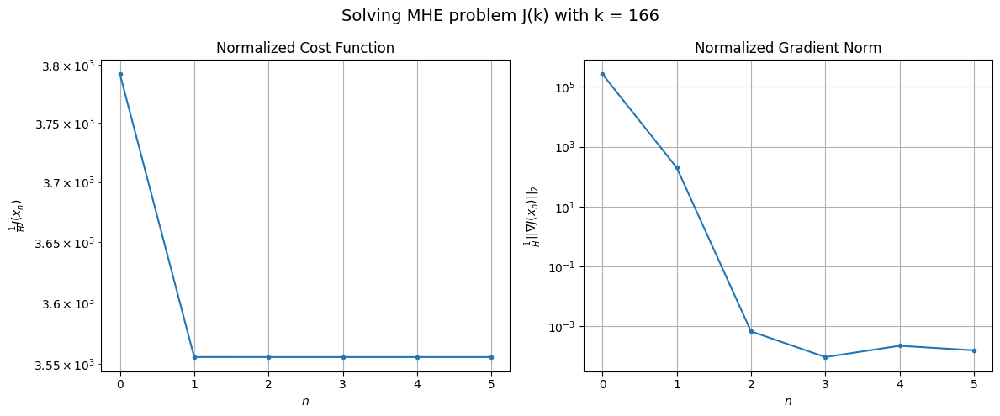

Windows:  38%|███▊      | 138/366 [13:59<19:59,  5.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 119549.64865156563
Gradient norm: 8247249.840946358
Global estimation error: 23.184585232010892
Initial conditions estimation errors: 11.22791710301474 m, 8.867468864416304 m, 9.71232367085082 m, 15.442907303601695 m
Position estimation errors: 21.90412360290177 m, 21.366206899011292 m, 21.8728284948909 m, 25.173365778397187 m

[Gauss-Newton] Iteration 1
Cost function: 112590.68536206499 (-5.82%)
Gradient norm: 545.3155059069907 (-99.99%)
Global estimation error: 22.393666100521457 (-3.41%)
Initial conditions estimation errors: 14.00898033589617 m, 11.617825830610677 m, 9.825837915214525 m, 8.583998748548357 m
Position estimation errors: 17.627780806089806 m, 15.81864037471775 m, 18.127827353900553 m, 28.01803610533571 m

[Gauss-Newton] Iteration 2
Cost function: 112590.6838953266 (-0.00%)
Gradient norm: 0.008819366024748422 (-100.00%)
Global estimation error: 22.39824303181068 (0.02%)
Initial conditions estimation errors: 14.

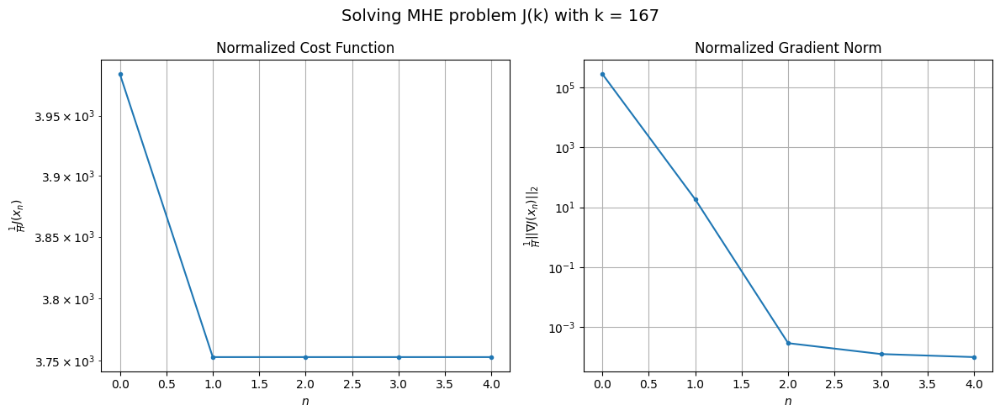

Windows:  38%|███▊      | 139/366 [14:03<18:25,  4.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 125934.8138457429
Gradient norm: 8127985.098069433
Global estimation error: 16.174616278156428
Initial conditions estimation errors: 10.599400596412762 m, 8.11400103237664 m, 6.887772078296083 m, 5.998192970150631 m
Position estimation errors: 21.59743538435367 m, 19.708656040968876 m, 21.70778693696033 m, 30.38226129506179 m

[Gauss-Newton] Iteration 1
Cost function: 119471.34721945178 (-5.13%)
Gradient norm: 394.4397033031831 (-100.00%)
Global estimation error: 21.837786510835986 (35.01%)
Initial conditions estimation errors: 13.224388373740268 m, 12.194746852812253 m, 9.266964366962627 m, 8.209936157048283 m
Position estimation errors: 17.42290485592584 m, 15.077417396608325 m, 17.002756619825785 m, 15.529998494824552 m

[Gauss-Newton] Iteration 2
Cost function: 119471.34667233012 (-0.00%)
Gradient norm: 0.007927642734423953 (-100.00%)
Global estimation error: 21.831418226500748 (-0.03%)
Initial conditions estimation errors

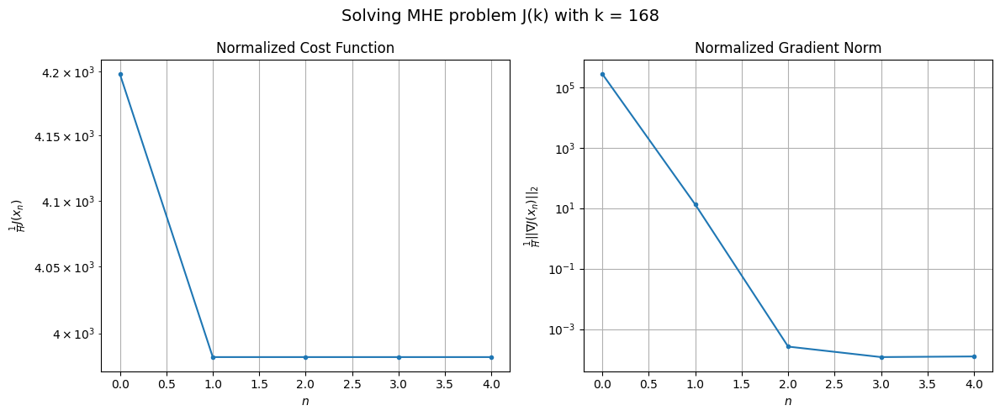

Windows:  38%|███▊      | 140/366 [14:07<17:19,  4.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 132742.9129594925
Gradient norm: 7941497.64587707
Global estimation error: 17.148441332408932
Initial conditions estimation errors: 10.17103037176419 m, 9.067056698348132 m, 6.686428711890598 m, 7.980604498155876 m
Position estimation errors: 20.940151520000363 m, 18.341997587291388 m, 19.577639795562753 m, 18.414789388704726 m

[Gauss-Newton] Iteration 1
Cost function: 126725.49436399333 (-4.53%)
Gradient norm: 36.030267422637166 (-100.00%)
Global estimation error: 20.14783031764507 (17.49%)
Initial conditions estimation errors: 12.691282499076936 m, 9.912169537216842 m, 9.570465406624736 m, 7.416946685918753 m
Position estimation errors: 16.89661388163509 m, 14.891770758321927 m, 15.977079131338407 m, 14.72310218256591 m

[Gauss-Newton] Iteration 2
Cost function: 126725.49433334464 (-0.00%)
Gradient norm: 0.06440823901504271 (-99.82%)
Global estimation error: 20.150511395988875 (0.01%)
Initial conditions estimation errors: 1

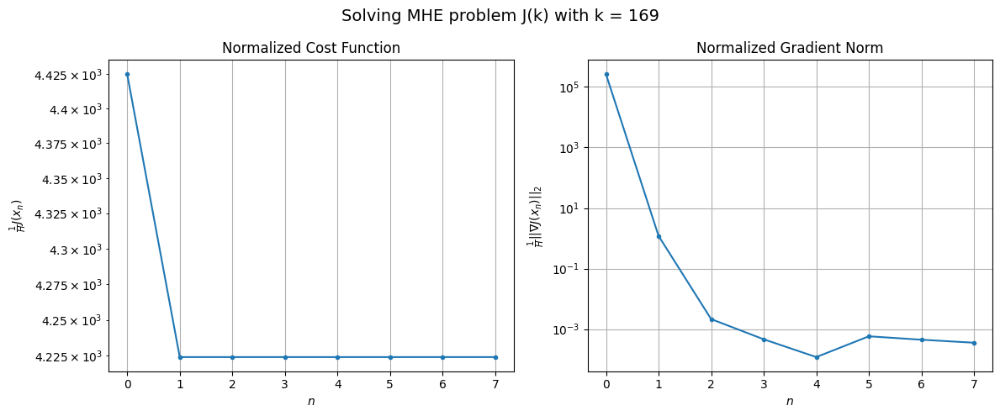

Windows:  39%|███▊      | 141/366 [14:13<19:12,  5.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 138723.2499875083
Gradient norm: 7479723.573335252
Global estimation error: 16.319873094124283
Initial conditions estimation errors: 9.957989019749336 m, 7.388639288248897 m, 7.216647354904126 m, 7.777988650417752 m
Position estimation errors: 19.89279765837081 m, 17.617521347328548 m, 18.491039412026048 m, 16.89221969775863 m

[Gauss-Newton] Iteration 1
Cost function: 133203.645925849 (-3.98%)
Gradient norm: 1705.3446375869075 (-99.98%)
Global estimation error: 27.319137789649904 (67.40%)
Initial conditions estimation errors: 12.435446803480724 m, 10.287860495891543 m, 9.506276474302505 m, 19.886469192996937 m
Position estimation errors: 16.06796734580619 m, 16.89779352362306 m, 17.00040517297557 m, 36.804069540010424 m

[Gauss-Newton] Iteration 2
Cost function: 133203.63424192002 (-0.00%)
Gradient norm: 0.02196149059898174 (-100.00%)
Global estimation error: 27.299745998356034 (-0.07%)
Initial conditions estimation errors: 1

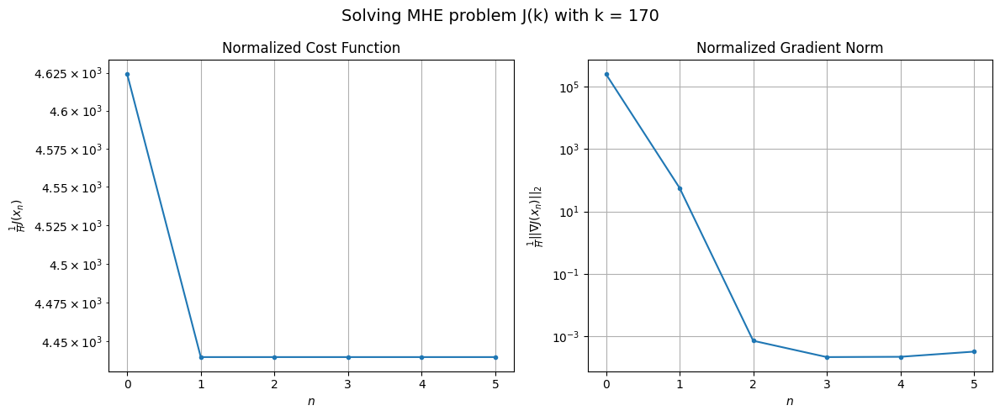

Windows:  39%|███▉      | 142/366 [14:18<18:48,  5.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 143011.0534340612
Gradient norm: 6764539.932273061
Global estimation error: 28.0087810353753
Initial conditions estimation errors: 9.936249432896016 m, 7.71398944345043 m, 8.02352168594993 m, 23.703773510084787 m
Position estimation errors: 18.536069547684637 m, 19.16282460447385 m, 19.174262021157315 m, 35.75747551964883 m

[Gauss-Newton] Iteration 1
Cost function: 138154.6744768918 (-3.40%)
Gradient norm: 506.21390089537766 (-99.99%)
Global estimation error: 28.93164178765634 (3.29%)
Initial conditions estimation errors: 12.401334154975133 m, 10.405605022802149 m, 10.28093509195822 m, 21.662328374630178 m
Position estimation errors: 15.065311472025009 m, 19.521802781169455 m, 17.311304763969535 m, 53.83922089588918 m

[Gauss-Newton] Iteration 2
Cost function: 138154.67364323678 (-0.00%)
Gradient norm: 0.0078206360534733 (-100.00%)
Global estimation error: 28.950072887085362 (0.06%)
Initial conditions estimation errors: 12.40

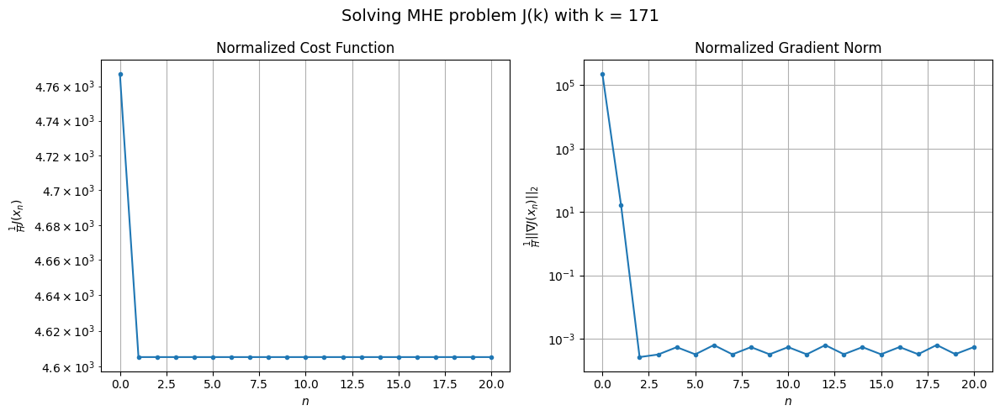

Windows:  39%|███▉      | 143/366 [14:33<30:01,  8.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 145090.57889194964
Gradient norm: 5882958.683104814
Global estimation error: 30.804096624093685
Initial conditions estimation errors: 10.026071340195651 m, 7.900615541909526 m, 8.938768303513873 m, 26.571316531337402 m
Position estimation errors: 17.052145016934325 m, 21.335103054368147 m, 19.101640750147535 m, 52.14910642703499 m

[Gauss-Newton] Iteration 1
Cost function: 140832.30349398387 (-2.93%)
Gradient norm: 270.11527412126526 (-100.00%)
Global estimation error: 23.570072715962 (-23.48%)
Initial conditions estimation errors: 12.534133238022376 m, 12.036035557709166 m, 12.182974591661344 m, 10.253756978766392 m
Position estimation errors: 13.989187740220162 m, 19.69853456708355 m, 15.494108104008276 m, 49.90590837364989 m

[Gauss-Newton] Iteration 2
Cost function: 140832.3022881474 (-0.00%)
Gradient norm: 0.007306038728375183 (-100.00%)
Global estimation error: 23.569376553725334 (-0.00%)
Initial conditions estimation er

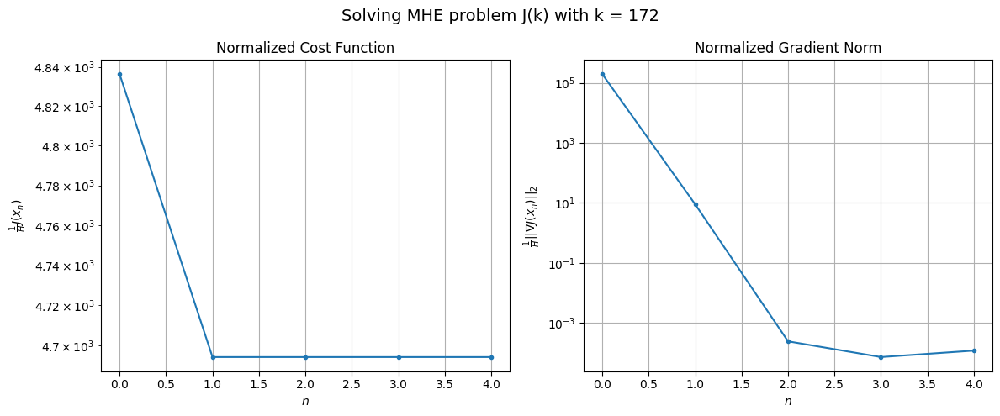

Windows:  39%|███▉      | 144/366 [14:38<26:00,  7.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 145108.84811598682
Gradient norm: 4983061.85673028
Global estimation error: 21.388178907798203
Initial conditions estimation errors: 10.170338129172166 m, 9.355488972505412 m, 10.390489578145983 m, 12.590419477809368 m
Position estimation errors: 15.571644125571295 m, 21.412404663288527 m, 16.703105783645125 m, 49.564585804865025 m

[Gauss-Newton] Iteration 1
Cost function: 141300.21714182443 (-2.62%)
Gradient norm: 166.76261564889904 (-100.00%)
Global estimation error: 27.398016928788316 (28.10%)
Initial conditions estimation errors: 12.763683390251654 m, 11.822129272246826 m, 13.650650144295463 m, 16.174713125639403 m
Position estimation errors: 12.917894831473683 m, 20.95060526670922 m, 15.942639002915959 m, 57.64199244108995 m

[Gauss-Newton] Iteration 2
Cost function: 141300.21704591153 (-0.00%)
Gradient norm: 0.01887977050831653 (-99.99%)
Global estimation error: 27.39619101934575 (-0.01%)
Initial conditions estimation e

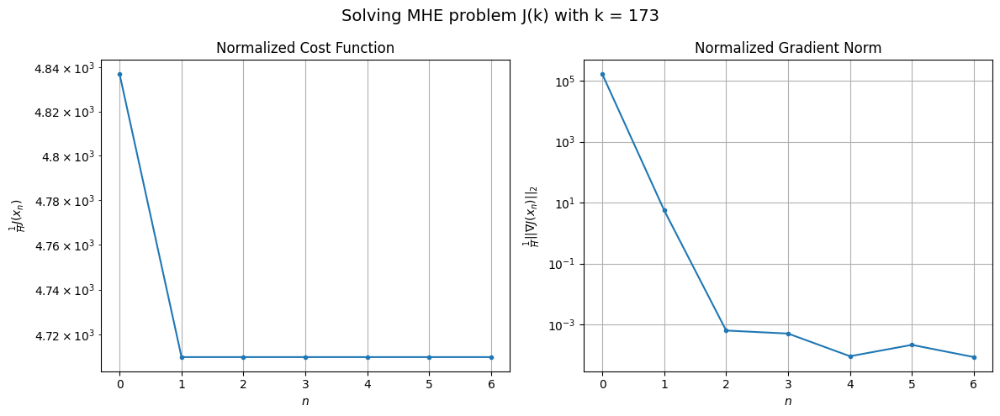

Windows:  40%|███▉      | 145/366 [14:43<24:17,  6.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 142948.17447792206
Gradient norm: 4045828.793412016
Global estimation error: 26.805979873051573
Initial conditions estimation errors: 10.328155592916714 m, 9.327678783767475 m, 11.770133259625155 m, 19.655370025238273 m
Position estimation errors: 14.190391344636822 m, 22.30807342859716 m, 16.696991634118262 m, 56.60458358805344 m

[Gauss-Newton] Iteration 1
Cost function: 139501.03902452806 (-2.41%)
Gradient norm: 3639.3706795488047 (-99.91%)
Global estimation error: 28.461753534396554 (6.18%)
Initial conditions estimation errors: 13.005704880699394 m, 12.494039261888275 m, 12.16196514640223 m, 18.354801230526064 m
Position estimation errors: 11.959333399205685 m, 11.843115434775212 m, 10.917908369016372 m, 16.421950782992763 m

[Gauss-Newton] Iteration 2
Cost function: 139500.99535294942 (-0.00%)
Gradient norm: 0.07059096280969886 (-100.00%)
Global estimation error: 28.525011730775976 (0.22%)
Initial conditions estimation er

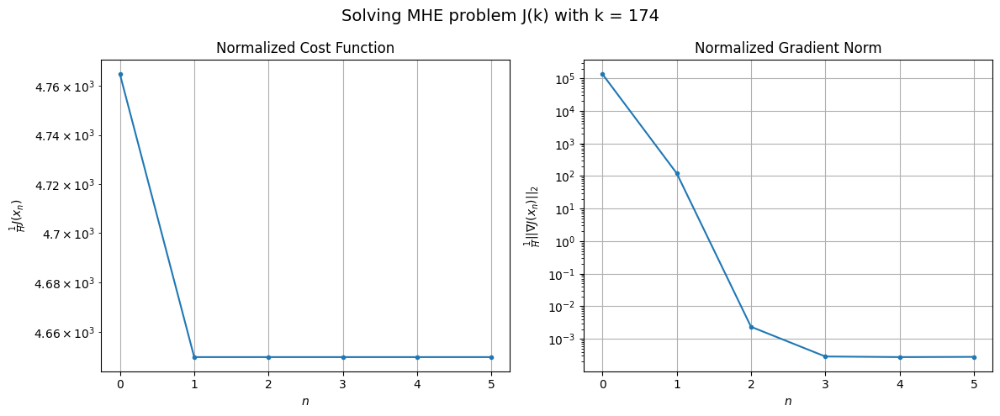

Windows:  40%|███▉      | 146/366 [14:49<22:49,  6.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 139263.15242857195
Gradient norm: 3013210.65724274
Global estimation error: 24.85178874670389
Initial conditions estimation errors: 10.476839294309348 m, 10.2732396750528 m, 9.786149311322845 m, 17.5079877411426 m
Position estimation errors: 13.02013124407888 m, 12.726225810450503 m, 11.86751852787129 m, 16.659240686776418 m

[Gauss-Newton] Iteration 1
Cost function: 136207.46264179383 (-2.19%)
Gradient norm: 727.0206571702623 (-99.98%)
Global estimation error: 27.666387034817436 (11.33%)
Initial conditions estimation errors: 13.162955996220722 m, 14.106585408401576 m, 12.376005258106344 m, 15.491750047820258 m
Position estimation errors: 11.208171218160311 m, 8.946049180732583 m, 12.758527067734107 m, 10.7250290790039 m

[Gauss-Newton] Iteration 2
Cost function: 136207.4607127443 (-0.00%)
Gradient norm: 0.23936675895501763 (-99.97%)
Global estimation error: 27.663657301834633 (-0.01%)
Initial conditions estimation errors: 13.

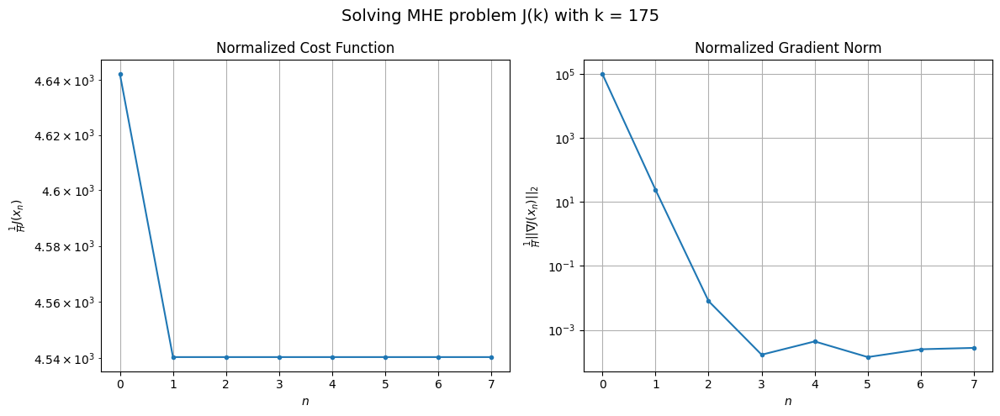

Windows:  40%|████      | 147/366 [14:55<22:42,  6.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 134472.7503318985
Gradient norm: 2101272.1514476878
Global estimation error: 22.82725319435444
Initial conditions estimation errors: 10.58323800098465 m, 11.872979081262125 m, 9.982729490224953 m, 12.978703468041354 m
Position estimation errors: 12.166696902364082 m, 8.888094614397463 m, 14.018790956490669 m, 10.362420790348141 m

[Gauss-Newton] Iteration 1
Cost function: 131644.38531998146 (-2.10%)
Gradient norm: 29.571363898954036 (-100.00%)
Global estimation error: 28.542295593303184 (25.04%)
Initial conditions estimation errors: 13.270459353298877 m, 14.650485303807976 m, 11.747534619545377 m, 16.90875724708156 m
Position estimation errors: 10.68139294117588 m, 6.878241903007609 m, 11.950472588830909 m, 7.004641548702979 m

[Gauss-Newton] Iteration 2
Cost function: 131644.38531155608 (-0.00%)
Gradient norm: 0.013788519975782109 (-99.95%)
Global estimation error: 28.542357905288576 (0.00%)
Initial conditions estimation erro

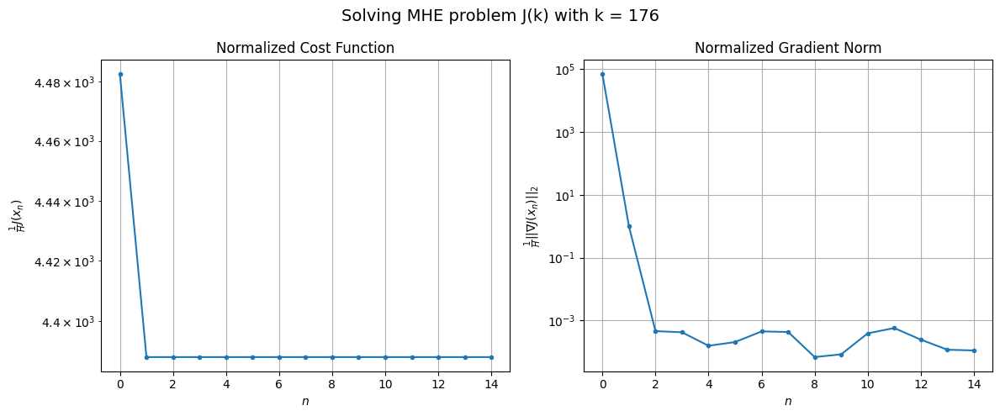

Windows:  40%|████      | 148/366 [15:07<28:46,  7.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 129173.78950099401
Gradient norm: 1276379.6799441588
Global estimation error: 24.278331913975826
Initial conditions estimation errors: 10.70337320491191 m, 12.54571478910909 m, 9.575085958823509 m, 15.026269476338598 m
Position estimation errors: 11.694601505457232 m, 6.893009001624975 m, 13.453512341287748 m, 6.905623982432393 m

[Gauss-Newton] Iteration 1
Cost function: 126557.82962560968 (-2.03%)
Gradient norm: 162.13679114317355 (-99.99%)
Global estimation error: 25.37386542973776 (4.51%)
Initial conditions estimation errors: 13.337014524095716 m, 12.786696162988942 m, 12.534034540758887 m, 12.055904037262028 m
Position estimation errors: 10.468791840394912 m, 8.719342176173637 m, 12.217137858648043 m, 13.443575282272178 m

[Gauss-Newton] Iteration 2
Cost function: 126557.82931572782 (-0.00%)
Gradient norm: 0.01177363136140597 (-99.99%)
Global estimation error: 25.372841727786415 (-0.00%)
Initial conditions estimation erro

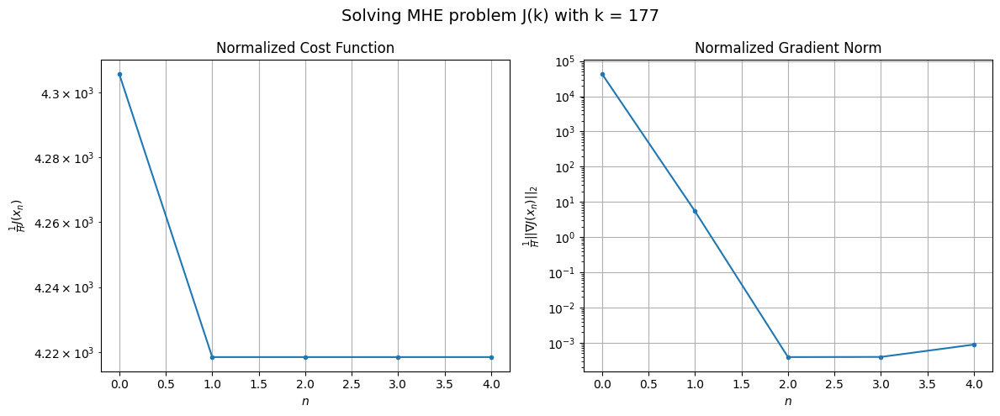

Windows:  41%|████      | 149/366 [15:11<25:07,  6.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 124515.94503944308
Gradient norm: 1163901.858349299
Global estimation error: 20.36234309858793
Initial conditions estimation errors: 10.824166696708874 m, 10.254144756978214 m, 9.93344012505316 m, 9.67637818314671 m
Position estimation errors: 11.71055621227161 m, 9.77831991723177 m, 13.727005060783853 m, 15.1977322072223 m

[Gauss-Newton] Iteration 1
Cost function: 122076.88548297758 (-1.96%)
Gradient norm: 989.905700908712 (-99.91%)
Global estimation error: 25.660706894818546 (26.02%)
Initial conditions estimation errors: 13.322043784294367 m, 12.038371227272764 m, 13.348089115206347 m, 12.565411918058015 m
Position estimation errors: 10.582525932948313 m, 15.248373809825091 m, 10.496650367948156 m, 32.798309872044555 m

[Gauss-Newton] Iteration 2
Cost function: 122076.88182758114 (-0.00%)
Gradient norm: 0.014306917288381104 (-100.00%)
Global estimation error: 25.634595020901344 (-0.10%)
Initial conditions estimation errors:

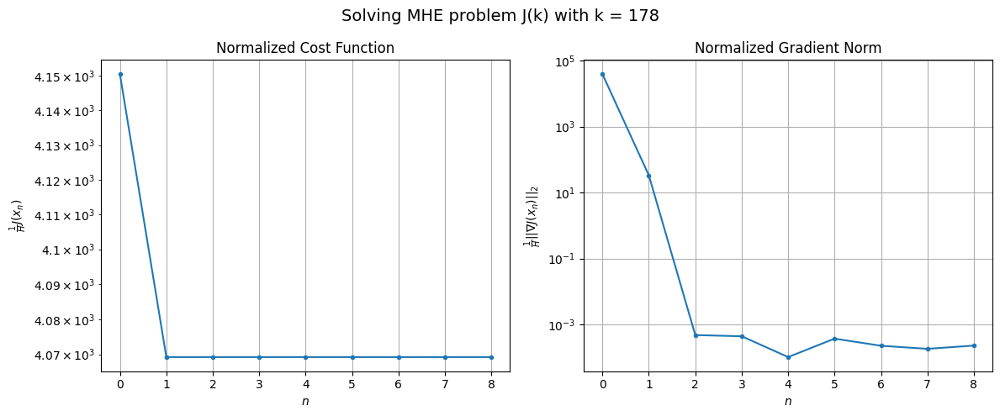

Windows:  41%|████      | 150/366 [15:19<25:10,  7.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120537.14810041974
Gradient norm: 1878710.457133479
Global estimation error: 21.48341989566587
Initial conditions estimation errors: 10.885372445479526 m, 9.672173691193205 m, 10.831066604789303 m, 11.496646813268292 m
Position estimation errors: 12.172660379039707 m, 16.70876664369511 m, 11.52104894091132 m, 33.71908043677322 m

[Gauss-Newton] Iteration 1
Cost function: 118053.88826399737 (-2.06%)
Gradient norm: 9.147087738884567 (-100.00%)
Global estimation error: 28.048509901553974 (30.56%)
Initial conditions estimation errors: 13.294401149042645 m, 11.957407151801542 m, 15.002926320068942 m, 15.553093721565308 m
Position estimation errors: 10.95788514113036 m, 15.855599997604976 m, 10.419282559972126 m, 30.75446710591053 m

[Gauss-Newton] Iteration 2
Cost function: 118053.8882503933 (-0.00%)
Gradient norm: 0.003220105581428977 (-99.96%)
Global estimation error: 28.045373226915665 (-0.01%)
Initial conditions estimation erro

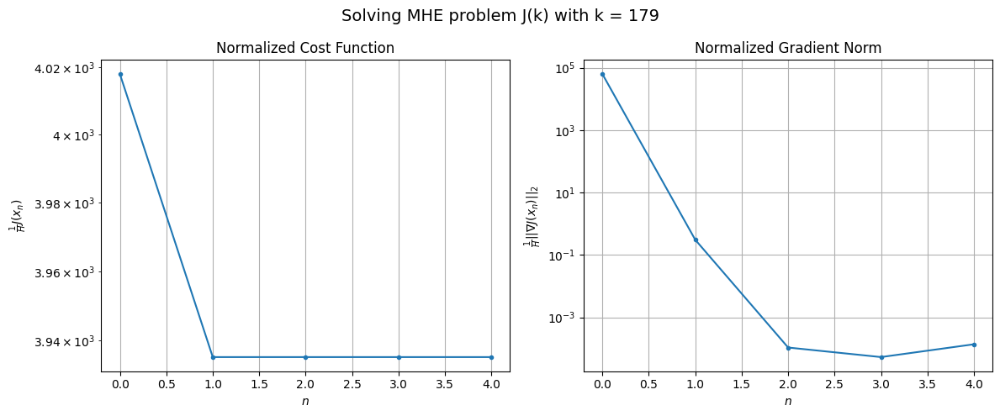

Windows:  41%|████▏     | 151/366 [15:23<21:48,  6.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 117831.94902568811
Gradient norm: 2740390.5614823885
Global estimation error: 24.067011414821156
Initial conditions estimation errors: 10.941267893702964 m, 9.5746892907124 m, 12.426432014692026 m, 14.608508560559267 m
Position estimation errors: 12.925519460030934 m, 17.520377088805247 m, 11.391225062932067 m, 31.691901241738798 m

[Gauss-Newton] Iteration 1
Cost function: 115370.76068210357 (-2.09%)
Gradient norm: 75.88605963734605 (-100.00%)
Global estimation error: 26.182454537980544 (8.79%)
Initial conditions estimation errors: 13.16185768462889 m, 10.174556713547132 m, 15.720873055141029 m, 12.712500787740856 m
Position estimation errors: 11.537183974217111 m, 19.670051740903883 m, 10.487055949275627 m, 37.18651671549465 m

[Gauss-Newton] Iteration 2
Cost function: 115370.7606359242 (-0.00%)
Gradient norm: 0.02989899152440655 (-99.96%)
Global estimation error: 26.170719827953718 (-0.04%)
Initial conditions estimation err

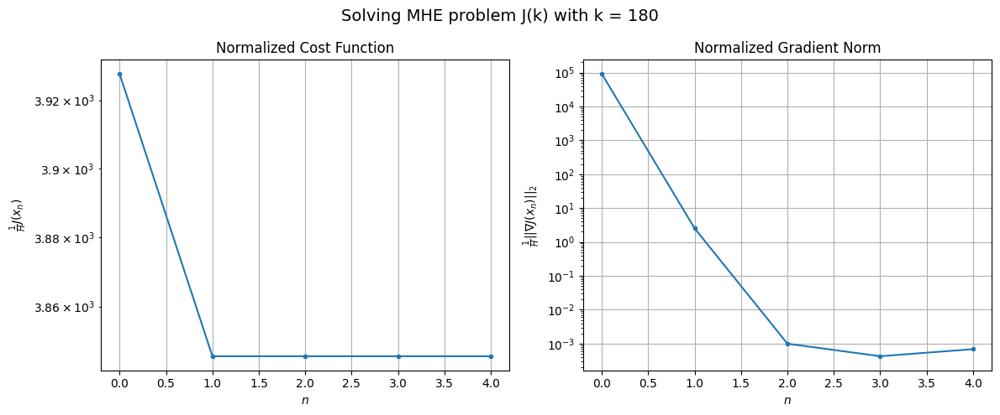

Windows:  42%|████▏     | 152/366 [15:27<20:11,  5.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116095.38163729056
Gradient norm: 3528394.845775327
Global estimation error: 22.342978940539528
Initial conditions estimation errors: 10.889598328176126 m, 7.97942068844478 m, 13.080383943659713 m, 12.076741823629389 m
Position estimation errors: 13.833683280420962 m, 21.641284375851527 m, 11.162938474784243 m, 38.57614664226962 m

[Gauss-Newton] Iteration 1
Cost function: 113484.97335956123 (-2.25%)
Gradient norm: 44.47324386301209 (-100.00%)
Global estimation error: 24.457424789910018 (9.46%)
Initial conditions estimation errors: 12.995974138731677 m, 9.11777865729316 m, 15.093425101295011 m, 10.877250636514326 m
Position estimation errors: 12.212635378685436 m, 19.61979094197519 m, 10.098263451918907 m, 34.03379300857632 m

[Gauss-Newton] Iteration 2
Cost function: 113484.97334741885 (-0.00%)
Gradient norm: 0.030045398279923134 (-99.93%)
Global estimation error: 24.461925728733622 (0.02%)
Initial conditions estimation error

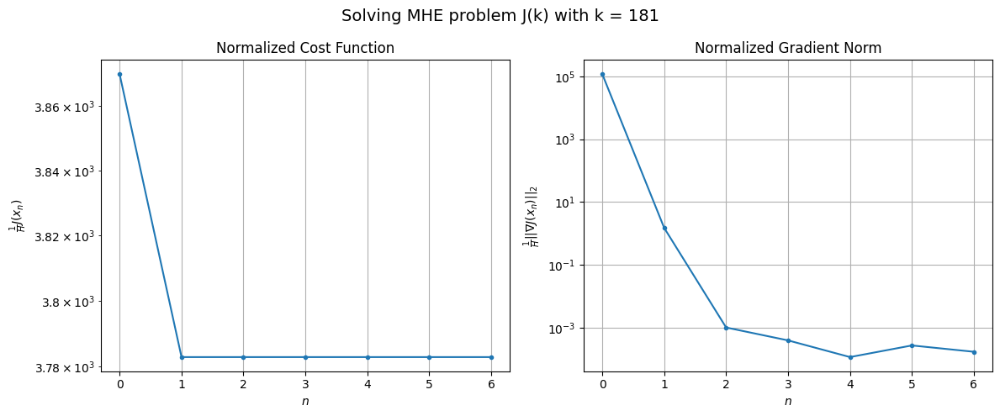

Windows:  42%|████▏     | 153/366 [15:33<19:53,  5.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 115704.58608141106
Gradient norm: 4220989.640805395
Global estimation error: 20.740214858918275
Initial conditions estimation errors: 10.784834801716892 m, 7.250900393873541 m, 12.538031184549228 m, 10.200819029533315 m
Position estimation errors: 14.76382722070019 m, 21.925805606538333 m, 11.259023501574607 m, 35.89802700213875 m

[Gauss-Newton] Iteration 1
Cost function: 112919.1990971592 (-2.41%)
Gradient norm: 1255.7336772775516 (-99.97%)
Global estimation error: 21.624341510707303 (4.26%)
Initial conditions estimation errors: 12.744882624751515 m, 8.296950964289891 m, 12.45603098623423 m, 9.009884351488282 m
Position estimation errors: 12.856713859784657 m, 13.057958396443949 m, 14.21346627786615 m, 15.807487367684582 m

[Gauss-Newton] Iteration 2
Cost function: 112919.19336305105 (-0.00%)
Gradient norm: 0.01595718198561591 (-100.00%)
Global estimation error: 21.623623943157735 (-0.00%)
Initial conditions estimation error

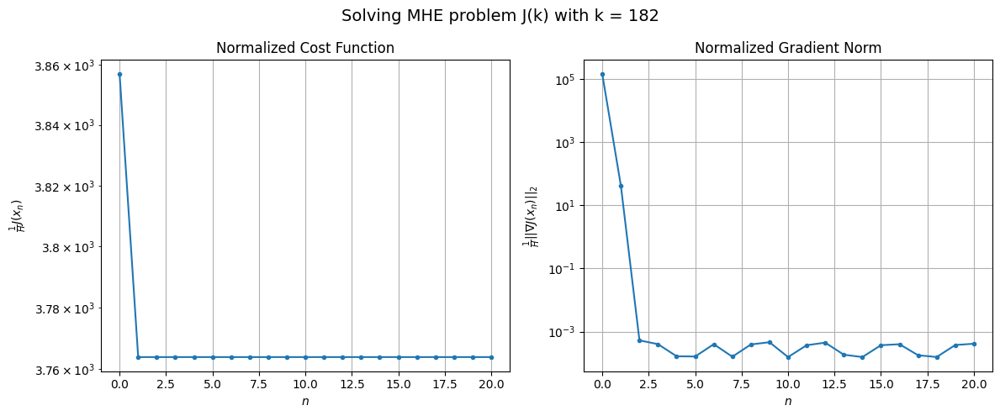

Windows:  42%|████▏     | 154/366 [15:48<30:05,  8.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116688.31481718151
Gradient norm: 4753344.5166686755
Global estimation error: 17.807664346819305
Initial conditions estimation errors: 10.593108969500042 m, 6.6072268272863095 m, 10.13920677411287 m, 7.64399981500476 m
Position estimation errors: 15.576092542150175 m, 15.830133803787897 m, 16.383742653865355 m, 18.826061489280274 m

[Gauss-Newton] Iteration 1
Cost function: 113797.96195148524 (-2.48%)
Gradient norm: 92.9983357998108 (-100.00%)
Global estimation error: 28.273366657423935 (58.77%)
Initial conditions estimation errors: 12.386388012132741 m, 9.933109068608326 m, 12.470401712317683 m, 19.79324115470632 m
Position estimation errors: 13.422222470420028 m, 12.42356258566981 m, 13.195918358622148 m, 10.936419117571868 m

[Gauss-Newton] Iteration 2
Cost function: 113797.96163202867 (-0.00%)
Gradient norm: 0.014135901037511917 (-99.98%)
Global estimation error: 28.3139019122854 (0.14%)
Initial conditions estimation error

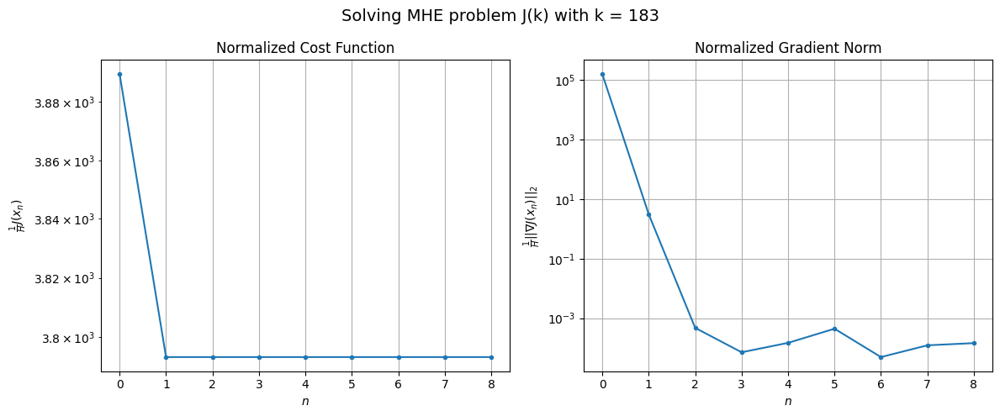

Windows:  42%|████▏     | 155/366 [15:55<28:03,  7.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 119462.47448851157
Gradient norm: 5187266.972766609
Global estimation error: 24.249335452683145
Initial conditions estimation errors: 10.309600370829399 m, 8.004072936496527 m, 10.307826532151179 m, 17.646979742958337 m
Position estimation errors: 16.217512423655613 m, 15.166902648871298 m, 15.606632458687185 m, 13.200646511860983 m

[Gauss-Newton] Iteration 1
Cost function: 116454.83482320918 (-2.52%)
Gradient norm: 270.3436609616666 (-99.99%)
Global estimation error: 32.37757133399242 (33.52%)
Initial conditions estimation errors: 11.931041891186133 m, 12.16594119807667 m, 8.351636970771818 m, 26.23330825082472 m
Position estimation errors: 13.821093017790473 m, 11.756938893131139 m, 16.980390977868733 m, 15.81524348550372 m

[Gauss-Newton] Iteration 2
Cost function: 116454.83434587563 (-0.00%)
Gradient norm: 0.0179915772548526 (-99.99%)
Global estimation error: 32.40966961404957 (0.10%)
Initial conditions estimation errors:

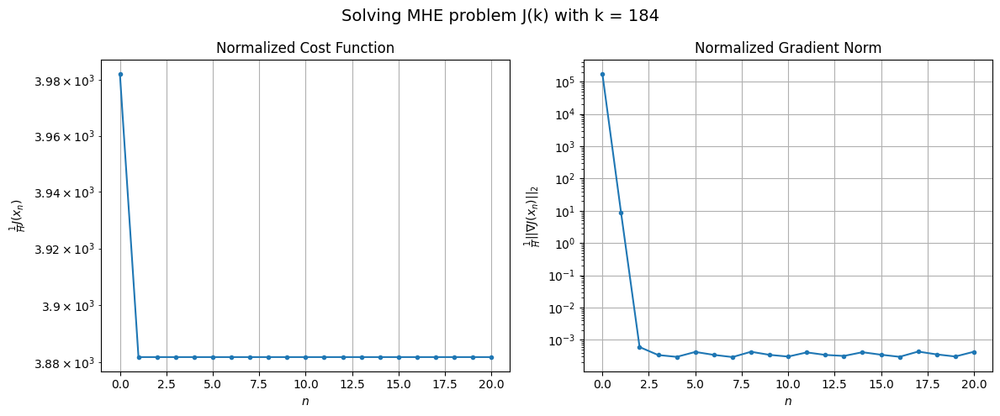

Windows:  43%|████▎     | 156/366 [16:12<38:02, 10.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 123198.05757879424
Gradient norm: 5313793.413296709
Global estimation error: 28.54281414611483
Initial conditions estimation errors: 9.970957284338311 m, 10.424374952789456 m, 7.552691847321656 m, 23.442503568783106 m
Position estimation errors: 16.58720699838894 m, 14.529337385999376 m, 20.08077443796042 m, 16.195892064836947 m

[Gauss-Newton] Iteration 1
Cost function: 120161.38579854432 (-2.46%)
Gradient norm: 73.0882670759855 (-100.00%)
Global estimation error: 37.9763668478308 (33.05%)
Initial conditions estimation errors: 11.486730297235614 m, 13.643764201315475 m, 8.251532113377644 m, 32.496267125707476 m
Position estimation errors: 14.066027213554078 m, 11.658875925086718 m, 18.571481795419835 m, 22.28783871379455 m

[Gauss-Newton] Iteration 2
Cost function: 120161.3857606081 (-0.00%)
Gradient norm: 0.020128210552274824 (-99.97%)
Global estimation error: 38.03021396025089 (0.14%)
Initial conditions estimation errors: 1

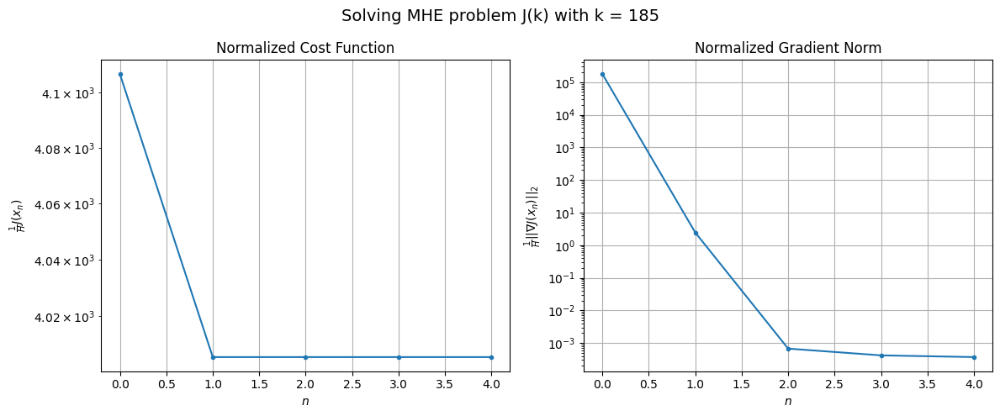

Windows:  43%|████▎     | 157/366 [16:17<31:24,  9.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 127673.10505912689
Gradient norm: 5422945.390418851
Global estimation error: 33.795524201161435
Initial conditions estimation errors: 9.694921309675127 m, 11.74531729373823 m, 7.7175732335587375 m, 29.165407555942373 m
Position estimation errors: 16.738677956394486 m, 14.061391054037983 m, 21.720879211543835 m, 21.863007788349083 m

[Gauss-Newton] Iteration 1
Cost function: 124580.55696880203 (-2.42%)
Gradient norm: 353.71597379429465 (-99.99%)
Global estimation error: 54.606514516988334 (61.58%)
Initial conditions estimation errors: 11.139185846361771 m, 18.189587049307143 m, 9.737077478388114 m, 49.316396649336085 m
Position estimation errors: 14.085368348869347 m, 12.406964835713898 m, 16.110509608098102 m, 21.787511824724426 m

[Gauss-Newton] Iteration 2
Cost function: 124580.5553810147 (-0.00%)
Gradient norm: 0.03106513880384901 (-99.99%)
Global estimation error: 54.70716673048007 (0.18%)
Initial conditions estimation err

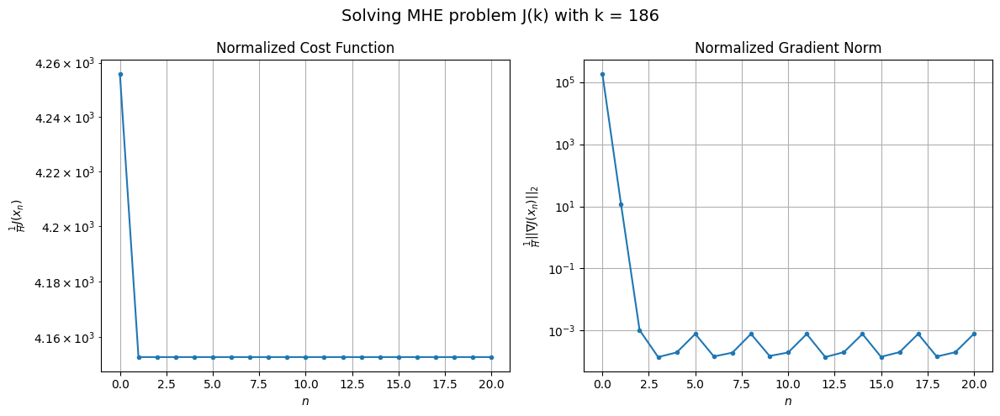

Windows:  43%|████▎     | 158/366 [16:32<37:43, 10.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 132334.16706835615
Gradient norm: 5264185.482353457
Global estimation error: 51.16573943529952
Initial conditions estimation errors: 9.582976293478152 m, 16.487571918853295 m, 9.620555753148723 m, 46.49401626869544 m
Position estimation errors: 16.663139237887588 m, 14.67451775668877 m, 19.33501497951444 m, 22.31716380147909 m

[Gauss-Newton] Iteration 1
Cost function: 129271.01367817048 (-2.31%)
Gradient norm: 13.156945103392248 (-100.00%)
Global estimation error: 54.562636243230024 (6.64%)
Initial conditions estimation errors: 11.02332308138181 m, 19.724435208805527 m, 10.5504869499188 m, 48.53030559165524 m
Position estimation errors: 13.972230439021244 m, 12.509464723592789 m, 16.196457661521787 m, 22.960294466359635 m

[Gauss-Newton] Iteration 2
Cost function: 129271.01366214939 (-0.00%)
Gradient norm: 0.004961558790466901 (-99.96%)
Global estimation error: 54.54886435814658 (-0.03%)
Initial conditions estimation errors: 

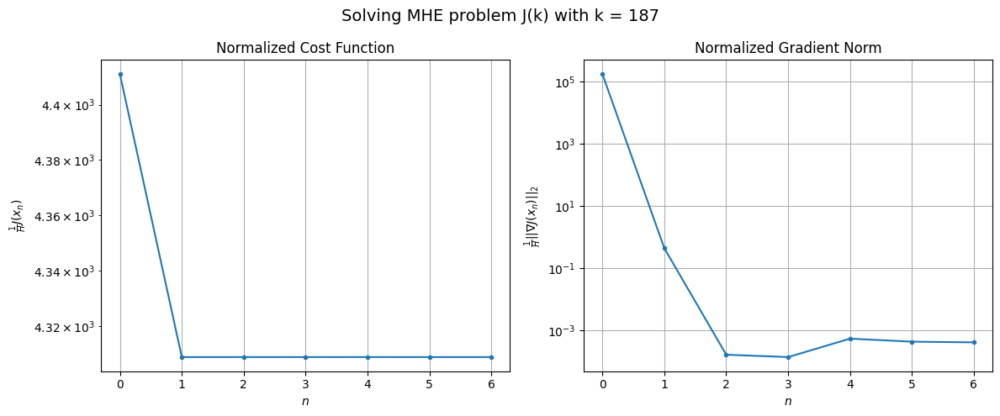

Windows:  43%|████▎     | 159/366 [16:38<31:40,  9.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 136872.221348877
Gradient norm: 5029848.439505807
Global estimation error: 51.052570884565995
Initial conditions estimation errors: 9.714166104062286 m, 18.044587141078164 m, 10.787554087596794 m, 45.49737360194387 m
Position estimation errors: 16.52606365220879 m, 14.586828834002374 m, 19.49728387843037 m, 22.91004977045663 m

[Gauss-Newton] Iteration 1
Cost function: 133845.0468177191 (-2.21%)
Gradient norm: 73.64026967954293 (-100.00%)
Global estimation error: 40.27418825279117 (-21.11%)
Initial conditions estimation errors: 11.238026990811063 m, 16.019813381638212 m, 10.364708187640344 m, 33.63994151887041 m
Position estimation errors: 13.846006545204705 m, 13.038306875799098 m, 18.14369676961729 m, 17.277068417500168 m

[Gauss-Newton] Iteration 2
Cost function: 133845.0466457597 (-0.00%)
Gradient norm: 0.02754667622706528 (-99.96%)
Global estimation error: 40.11592390384293 (-0.39%)
Initial conditions estimation errors: 1

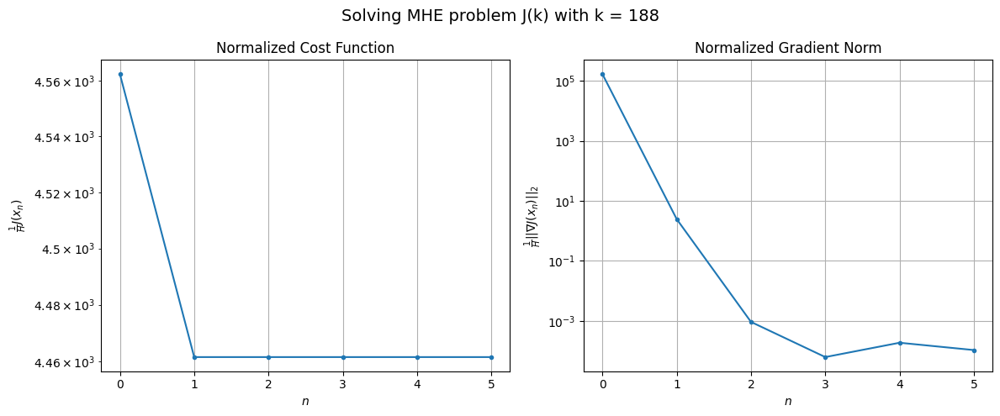

Windows:  44%|████▎     | 160/366 [16:42<27:02,  7.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 141151.1503568567
Gradient norm: 4820199.719361423
Global estimation error: 36.9967376173662
Initial conditions estimation errors: 10.109372471860421 m, 14.550438264204546 m, 10.457983531301496 m, 30.748416981758602 m
Position estimation errors: 16.459667079786684 m, 15.36580976091525 m, 21.541261927080157 m, 16.41251216448232 m

[Gauss-Newton] Iteration 1
Cost function: 137922.41415309563 (-2.29%)
Gradient norm: 746.9858063019276 (-99.98%)
Global estimation error: 52.31921878621014 (41.42%)
Initial conditions estimation errors: 11.851819990800875 m, 18.609502961753265 m, 12.4914793369045 m, 45.76544897984819 m
Position estimation errors: 13.74116914962897 m, 15.959071932212401 m, 14.172858741904257 m, 10.600076369331711 m

[Gauss-Newton] Iteration 2
Cost function: 137922.4111521287 (-0.00%)
Gradient norm: 0.015600643386423179 (-100.00%)
Global estimation error: 52.29353109271158 (-0.05%)
Initial conditions estimation errors: 

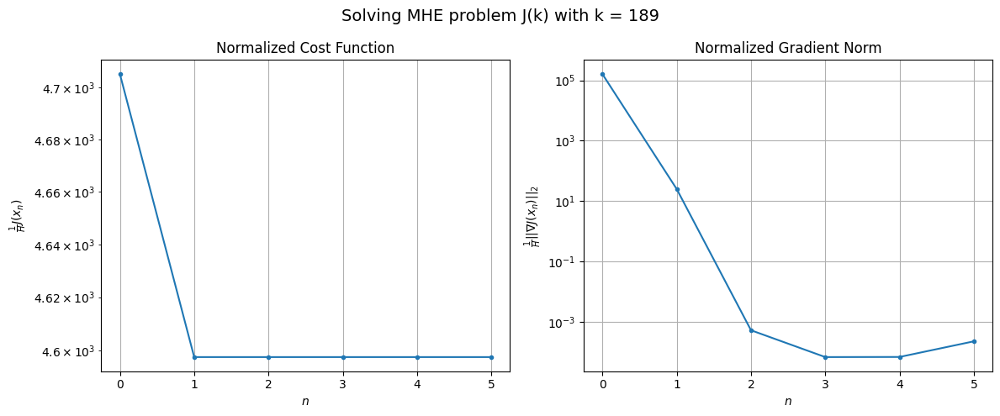

Windows:  44%|████▍     | 161/366 [16:47<23:47,  6.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 144340.346216782
Gradient norm: 4548620.589503981
Global estimation error: 49.94961207453292
Initial conditions estimation errors: 10.730647838560385 m, 17.30059434811645 m, 12.513342624639309 m, 43.86245199159139 m
Position estimation errors: 16.442468134014096 m, 18.512313182395047 m, 17.448611648507566 m, 11.285941342608021 m

[Gauss-Newton] Iteration 1
Cost function: 140852.2578046264 (-2.42%)
Gradient norm: 48.20398866890754 (-100.00%)
Global estimation error: 63.97178390781601 (28.07%)
Initial conditions estimation errors: 12.795963038575438 m, 21.229841702252028 m, 15.22397078492929 m, 56.975160484444984 m
Position estimation errors: 13.735548564904553 m, 15.774113732744272 m, 17.294436356326116 m, 13.972863070505195 m

[Gauss-Newton] Iteration 2
Cost function: 140852.25769936986 (-0.00%)
Gradient norm: 0.011210383075796313 (-99.98%)
Global estimation error: 64.04206156479609 (0.11%)
Initial conditions estimation errors

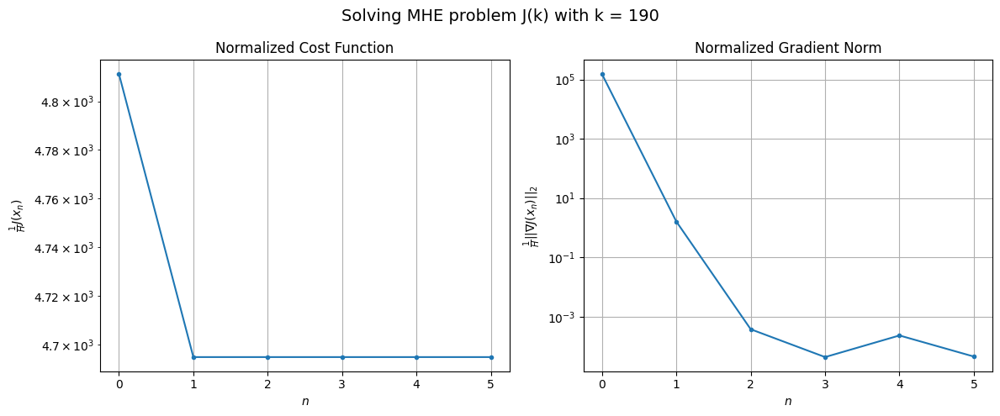

Windows:  44%|████▍     | 162/366 [16:52<21:34,  6.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 146710.34919285506
Gradient norm: 4256298.369178863
Global estimation error: 61.294344323128556
Initial conditions estimation errors: 11.468509585725416 m, 19.60444784114807 m, 15.120877657174688 m, 54.88611864417237 m
Position estimation errors: 16.51364082351945 m, 18.249397766222682 m, 21.006297216995513 m, 14.598496274597633 m

[Gauss-Newton] Iteration 1
Cost function: 142848.66742707242 (-2.63%)
Gradient norm: 519.6559304606026 (-99.99%)
Global estimation error: 44.60684343540348 (-27.23%)
Initial conditions estimation errors: 13.88956480449482 m, 13.70024215014372 m, 11.968274133283272 m, 38.28713978040851 m
Position estimation errors: 13.80932162418158 m, 14.343216587518226 m, 17.347310614508377 m, 14.386600647553418 m

[Gauss-Newton] Iteration 2
Cost function: 142848.66157923976 (-0.00%)
Gradient norm: 0.02344398848914868 (-100.00%)
Global estimation error: 44.42113856396537 (-0.42%)
Initial conditions estimation error

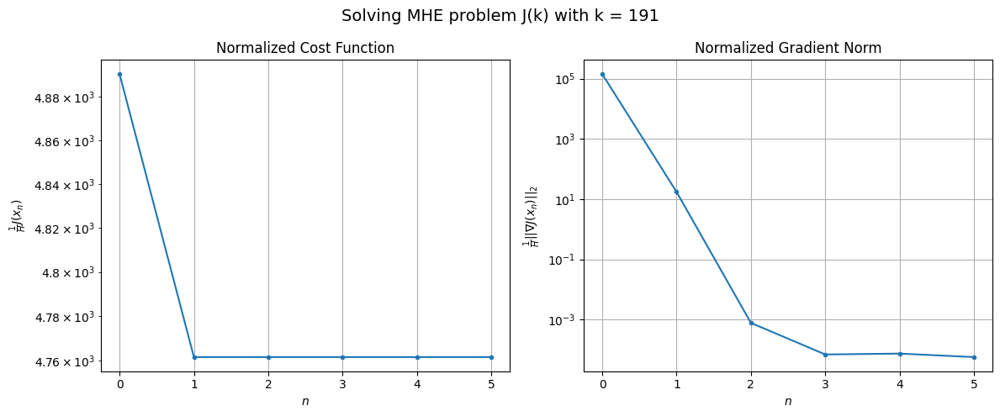

Windows:  45%|████▍     | 163/366 [16:57<20:11,  5.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 146992.09952849091
Gradient norm: 3973325.991800234
Global estimation error: 40.38357294808331
Initial conditions estimation errors: 12.183760363895052 m, 11.682553775885177 m, 10.171354691887183 m, 35.2482674679519 m
Position estimation errors: 16.64702458297299 m, 17.21869001449434 m, 20.443994507296086 m, 13.565656973583806 m

[Gauss-Newton] Iteration 1
Cost function: 142780.2833788657 (-2.87%)
Gradient norm: 1126.6820420158324 (-99.97%)
Global estimation error: 87.26694830952164 (116.10%)
Initial conditions estimation errors: 14.94820667334411 m, 25.188980300131522 m, 13.047424288382132 m, 81.16243696971699 m
Position estimation errors: 13.990126005091843 m, 11.985595288236492 m, 13.70381238647801 m, 23.499852436463613 m

[Gauss-Newton] Iteration 2
Cost function: 142780.2494616821 (-0.00%)
Gradient norm: 0.04147794707928415 (-100.00%)
Global estimation error: 87.45073061214799 (0.21%)
Initial conditions estimation errors: 

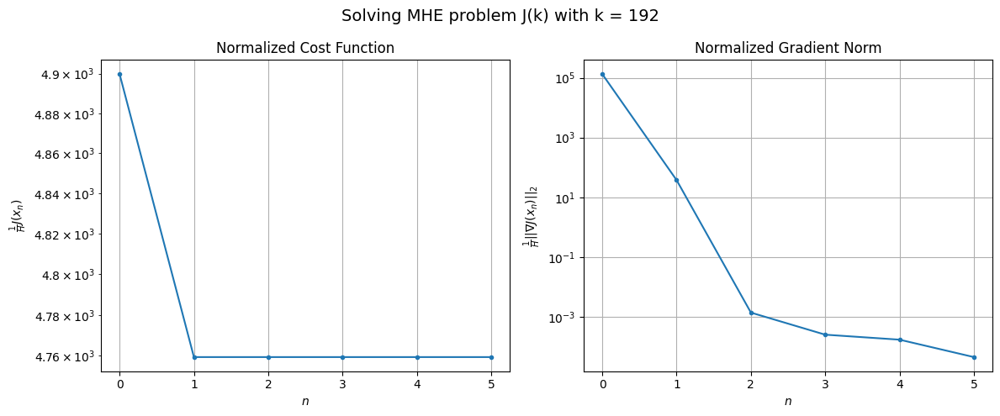

Windows:  45%|████▍     | 164/366 [17:02<18:58,  5.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 145928.2387189267
Gradient norm: 3787426.232206579
Global estimation error: 83.87318773485595
Initial conditions estimation errors: 12.790901837431594 m, 23.2367439345941 m, 11.392542678959439 m, 78.7486917952749 m
Position estimation errors: 16.892710326702854 m, 13.983625953514915 m, 17.118786488110985 m, 25.124402294620104 m

[Gauss-Newton] Iteration 1
Cost function: 141191.8879859156 (-3.25%)
Gradient norm: 1351.0091775165627 (-99.96%)
Global estimation error: 46.95723841174501 (-44.01%)
Initial conditions estimation errors: 15.892656889938168 m, 17.956844208180964 m, 14.132767827009648 m, 37.81807893206207 m
Position estimation errors: 14.221348620531588 m, 9.910693452630875 m, 15.935390675651446 m, 21.228572384644263 m

[Gauss-Newton] Iteration 2
Cost function: 141191.84417519253 (-0.00%)
Gradient norm: 0.5353966484704267 (-99.96%)
Global estimation error: 47.77994307163477 (1.75%)
Initial conditions estimation errors: 1

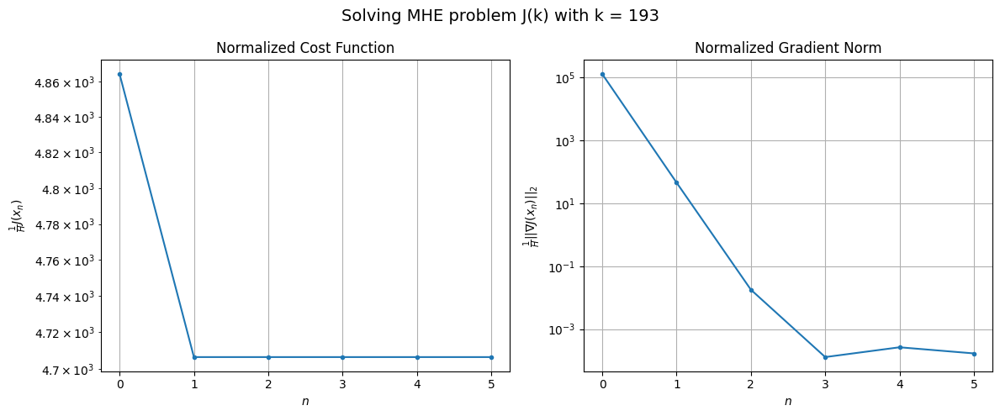

Windows:  45%|████▌     | 165/366 [17:07<18:32,  5.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 143525.50875731552
Gradient norm: 3571933.1030836115
Global estimation error: 41.752078272375705
Initial conditions estimation errors: 13.280866726877637 m, 15.14096885009516 m, 11.239418645857114 m, 34.80322266122019 m
Position estimation errors: 17.202706286905027 m, 12.225133896237043 m, 18.953545031908664 m, 20.215018164674667 m

[Gauss-Newton] Iteration 1
Cost function: 138339.70215108574 (-3.61%)
Gradient norm: 202.28045707426443 (-99.99%)
Global estimation error: 42.57982307857003 (1.98%)
Initial conditions estimation errors: 16.64000849147955 m, 15.098525309393324 m, 19.536710289597284 m, 30.438186399269053 m
Position estimation errors: 14.51488261174069 m, 8.2399969547602 m, 11.92052214208646 m, 26.715943463881285 m

[Gauss-Newton] Iteration 2
Cost function: 138339.7014160459 (-0.00%)
Gradient norm: 0.18431639424678586 (-99.91%)
Global estimation error: 42.874321899811065 (0.69%)
Initial conditions estimation errors: 

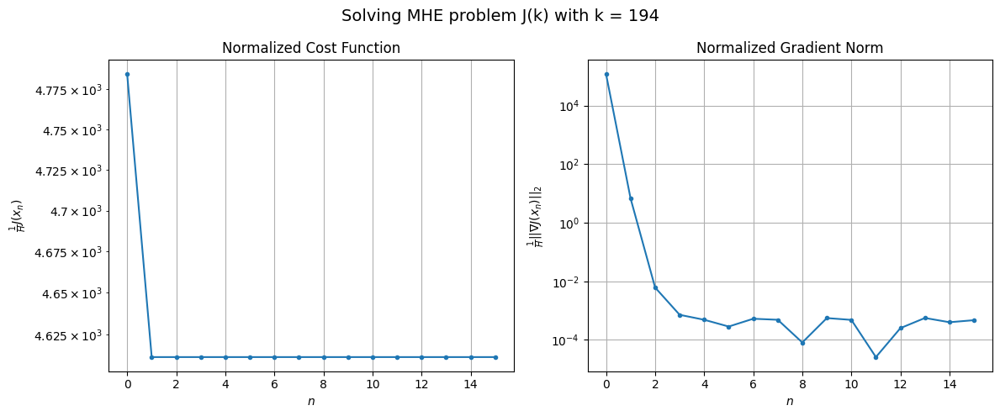

Windows:  45%|████▌     | 166/366 [17:19<24:55,  7.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 140202.61151454685
Gradient norm: 3458329.165772326
Global estimation error: 35.94840661609518
Initial conditions estimation errors: 13.615380342890528 m, 11.888613609133808 m, 16.930416442693897 m, 26.055906262325532 m
Position estimation errors: 17.58602423635736 m, 10.5900658466401 m, 14.466562389901526 m, 24.395050943310125 m

[Gauss-Newton] Iteration 1
Cost function: 134576.74500789208 (-4.01%)
Gradient norm: 922.4760678686094 (-99.97%)
Global estimation error: 39.200979885100985 (9.05%)
Initial conditions estimation errors: 17.176655096485415 m, 13.487512080132676 m, 27.044580749772646 m, 18.119936708434164 m
Position estimation errors: 14.859812610483338 m, 7.352724604716531 m, 20.01220853033334 m, 23.239284528617127 m

[Gauss-Newton] Iteration 2
Cost function: 134576.7352267441 (-0.00%)
Gradient norm: 3.6515832474340155 (-99.60%)
Global estimation error: 38.69356977470466 (-1.29%)
Initial conditions estimation errors: 

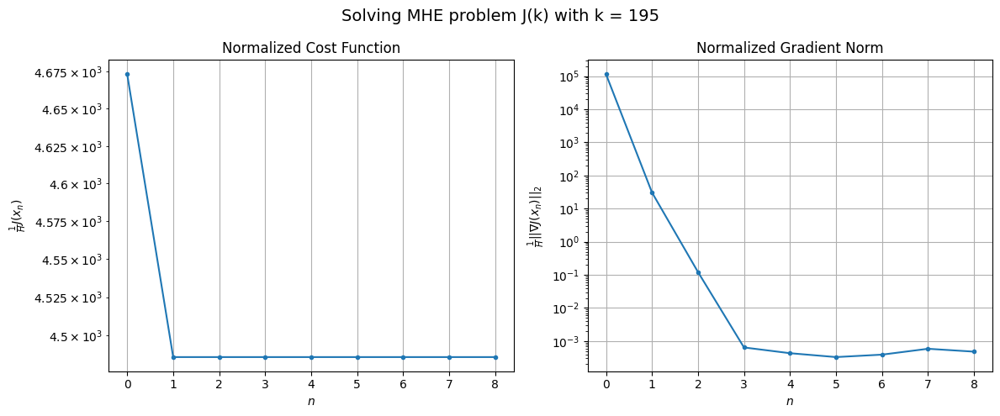

Windows:  46%|████▌     | 167/366 [17:27<24:50,  7.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 136038.08903979464
Gradient norm: 3309523.788297951
Global estimation error: 33.75998883945613
Initial conditions estimation errors: 13.807982781951283 m, 10.764315727913202 m, 24.90081068699945 m, 14.59899585951758 m
Position estimation errors: 18.022457387337116 m, 7.94169266604117 m, 21.743274843283093 m, 19.69297560683576 m

[Gauss-Newton] Iteration 1
Cost function: 130047.34367941818 (-4.40%)
Gradient norm: 692.373938405205 (-99.98%)
Global estimation error: 65.32322828687083 (93.49%)
Initial conditions estimation errors: 17.50223172041483 m, 19.081854846641235 m, 43.42179667217116 m, 41.366646702826024 m
Position estimation errors: 15.252583756750571 m, 6.065894104829333 m, 16.90273783311476 m, 9.466693479782773 m

[Gauss-Newton] Iteration 2
Cost function: 130047.32304306029 (-0.00%)
Gradient norm: 0.4091317187642487 (-99.94%)
Global estimation error: 64.68554442723467 (-0.98%)
Initial conditions estimation errors: 17.50

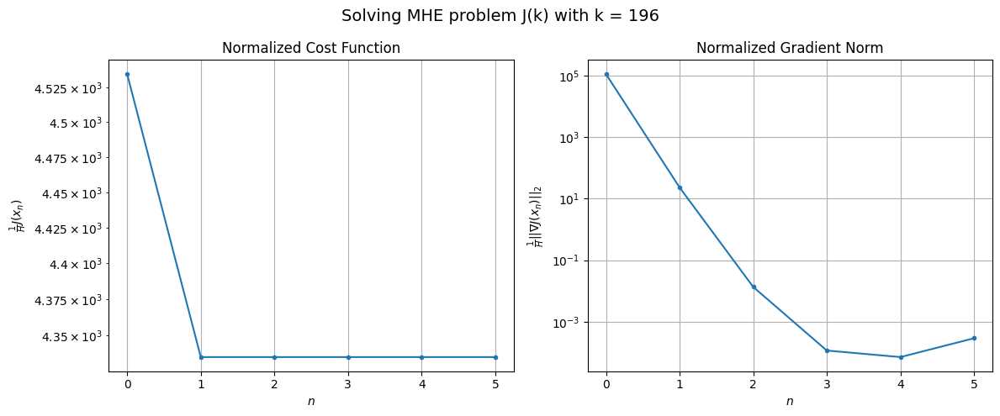

Windows:  46%|████▌     | 168/366 [17:32<22:19,  6.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 132376.77298574898
Gradient norm: 3268604.196492124
Global estimation error: 64.72512543170129
Initial conditions estimation errors: 13.892660583788759 m, 19.76247812841584 m, 42.16648675520011 m, 42.75210582572857 m
Position estimation errors: 18.49644683570548 m, 9.864959925048765 m, 17.6286909724495 m, 7.7535189917323475 m

[Gauss-Newton] Iteration 1
Cost function: 126138.30865809218 (-4.71%)
Gradient norm: 1378.3873018620475 (-99.96%)
Global estimation error: 52.71136292066669 (-18.56%)
Initial conditions estimation errors: 17.59900226679479 m, 14.49619150148088 m, 38.828973001981616 m, 27.402710603210313 m
Position estimation errors: 15.61979411908422 m, 10.766568405611766 m, 4.925061674941466 m, 10.656246123725257 m

[Gauss-Newton] Iteration 2
Cost function: 126138.2981216778 (-0.00%)
Gradient norm: 1.2504241293573373 (-99.91%)
Global estimation error: 51.75393578156842 (-1.82%)
Initial conditions estimation errors: 17.5

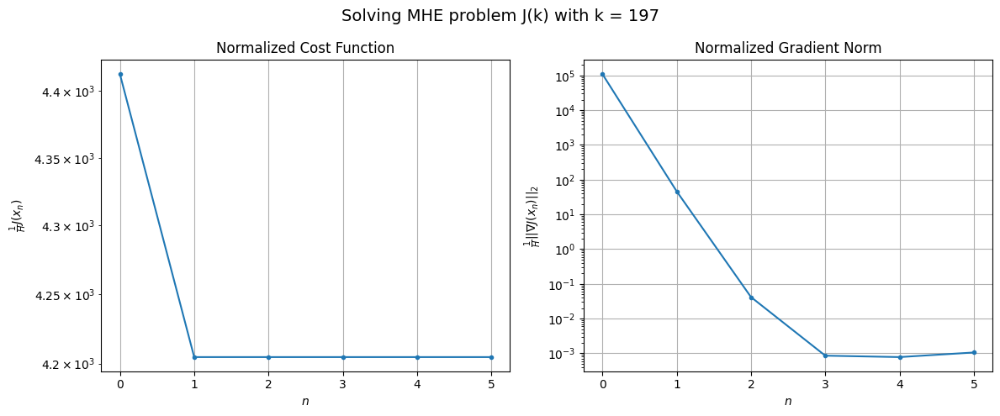

Windows:  46%|████▌     | 169/366 [17:37<20:44,  6.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 128466.22392506993
Gradient norm: 3105656.515487742
Global estimation error: 48.86236113817369
Initial conditions estimation errors: 13.89812223320268 m, 13.494733774578247 m, 35.8216448738751 m, 27.000955391734344 m
Position estimation errors: 18.916495396038528 m, 15.32563557170117 m, 6.224935891517554 m, 15.840920485466663 m

[Gauss-Newton] Iteration 1
Cost function: 122246.11622503033 (-4.84%)
Gradient norm: 530.5438556826133 (-99.98%)
Global estimation error: 57.927757070186644 (18.55%)
Initial conditions estimation errors: 17.544850209175646 m, 17.761273681355057 m, 35.36750590122859 m, 38.48964912465933 m
Position estimation errors: 16.01943519919783 m, 11.702696245742402 m, 17.64308544867734 m, 14.444911059566227 m

[Gauss-Newton] Iteration 2
Cost function: 122246.1149530003 (-0.00%)
Gradient norm: 0.707342948495326 (-99.87%)
Global estimation error: 58.785326133857716 (1.48%)
Initial conditions estimation errors: 17.5

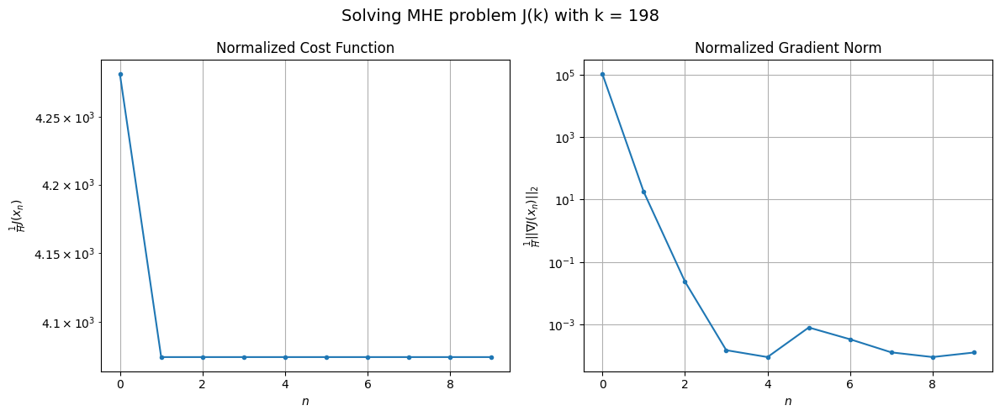

Windows:  46%|████▋     | 170/366 [17:45<22:07,  6.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 125547.10242508192
Gradient norm: 3104697.232650752
Global estimation error: 57.36100714673677
Initial conditions estimation errors: 13.874469575990076 m, 17.38489532694232 m, 33.76926690046656 m, 40.68370172411701 m
Position estimation errors: 19.34751350287826 m, 16.601188586017674 m, 19.440416832487518 m, 21.181843872012333 m

[Gauss-Newton] Iteration 1
Cost function: 119159.18573131903 (-5.09%)
Gradient norm: 270.6665035698374 (-99.99%)
Global estimation error: 42.040738279394354 (-26.71%)
Initial conditions estimation errors: 17.483593421982768 m, 13.478702828881959 m, 28.331376237844314 m, 21.849028548332065 m
Position estimation errors: 16.34676255077325 m, 10.393879392089675 m, 17.9801767754079 m, 14.73242248087843 m

[Gauss-Newton] Iteration 2
Cost function: 119159.18334642523 (-0.00%)
Gradient norm: 0.06019282492868312 (-99.98%)
Global estimation error: 42.04289685522704 (0.01%)
Initial conditions estimation errors: 

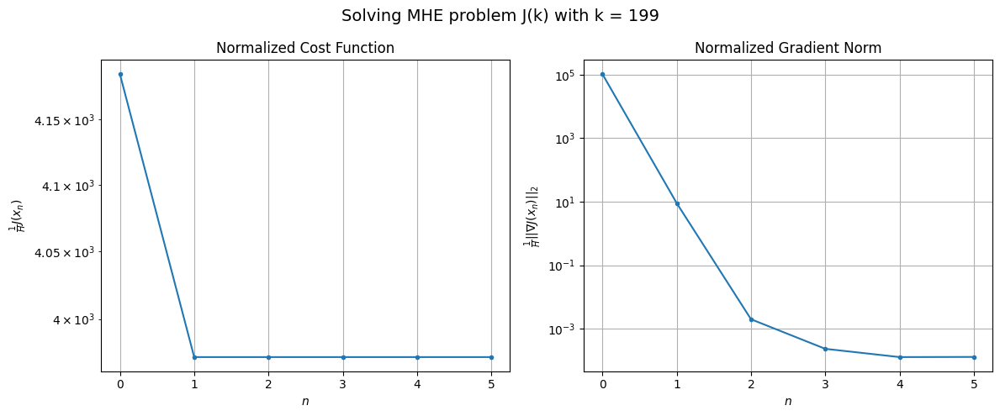

Windows:  47%|████▋     | 171/366 [17:50<20:05,  6.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 123177.50449786171
Gradient norm: 3065866.5021989206
Global estimation error: 38.36017943237643
Initial conditions estimation errors: 13.923637588862702 m, 10.725927302384848 m, 25.88658257730003 m, 22.191306419511378 m
Position estimation errors: 19.71078433664678 m, 14.687975353711547 m, 20.36336161813641 m, 19.994062176787047 m

[Gauss-Newton] Iteration 1
Cost function: 116802.92139864188 (-5.18%)
Gradient norm: 679.4353937363506 (-99.98%)
Global estimation error: 55.46617035480594 (44.59%)
Initial conditions estimation errors: 17.44001904247073 m, 15.459267136630784 m, 33.88025073994497 m, 37.22172457914729 m
Position estimation errors: 16.644454204155743 m, 9.16049780473159 m, 25.62488028408157 m, 15.770136974839126 m

[Gauss-Newton] Iteration 2
Cost function: 116802.91748772148 (-0.00%)
Gradient norm: 0.03561026054875279 (-99.99%)
Global estimation error: 55.48178272158236 (0.03%)
Initial conditions estimation errors: 17

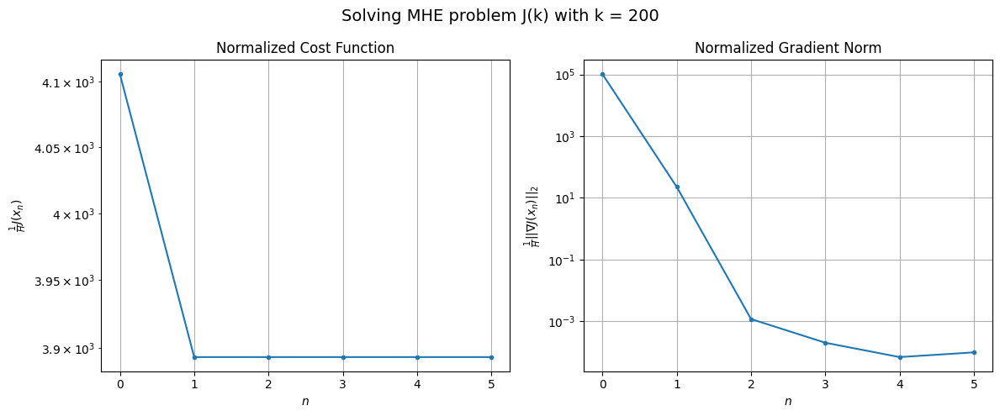

Windows:  47%|████▋     | 172/366 [17:55<18:32,  5.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 121910.0643700835
Gradient norm: 3143368.806985537
Global estimation error: 54.64505849207743
Initial conditions estimation errors: 14.02702485353295 m, 14.581584891823265 m, 32.522664945390154 m, 38.973818448974015 m
Position estimation errors: 20.09606733690833 m, 14.123287489236944 m, 27.33718104207245 m, 22.3900795828947 m

[Gauss-Newton] Iteration 1
Cost function: 115454.16401664962 (-5.30%)
Gradient norm: 522.7346459086484 (-99.98%)
Global estimation error: 49.79507477170782 (-8.88%)
Initial conditions estimation errors: 17.476614607280034 m, 12.962160285474946 m, 29.703234973617093 m, 33.523085980778944 m
Position estimation errors: 16.940681600001092 m, 14.909057034324286 m, 21.04433094525502 m, 30.35930368887317 m

[Gauss-Newton] Iteration 2
Cost function: 115454.16284565051 (-0.00%)
Gradient norm: 0.028909592135152616 (-99.99%)
Global estimation error: 49.7988410173302 (0.01%)
Initial conditions estimation errors: 17

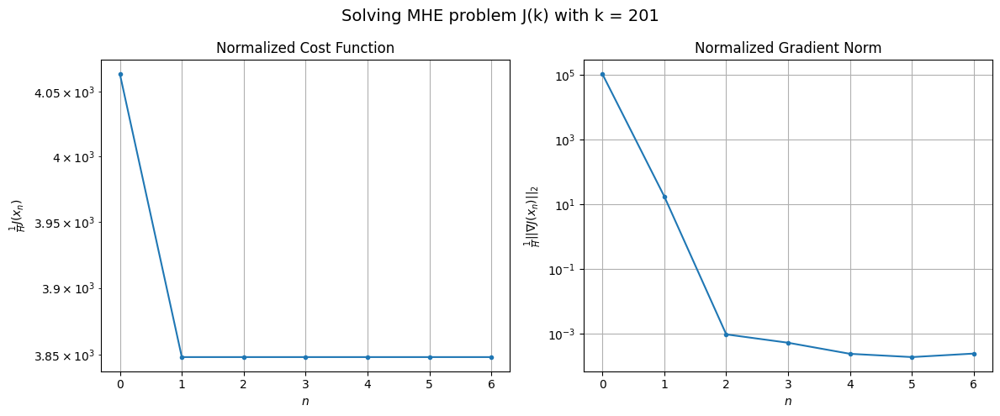

Windows:  47%|████▋     | 173/366 [18:00<18:38,  5.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120961.7876743958
Gradient norm: 3250386.7765828553
Global estimation error: 48.0558269061098
Initial conditions estimation errors: 14.200643565342013 m, 11.176070673946192 m, 27.862127393761163 m, 34.73449224622714 m
Position estimation errors: 20.546593708192795 m, 19.74369583503613 m, 23.316565767476636 m, 36.90596551722402 m

[Gauss-Newton] Iteration 1
Cost function: 114362.24309960911 (-5.46%)
Gradient norm: 2307.9619184565536 (-99.93%)
Global estimation error: 79.22212103894256 (64.85%)
Initial conditions estimation errors: 17.608946510960056 m, 19.69182699089388 m, 48.53903457237046 m, 56.764788294221134 m
Position estimation errors: 17.290706041078092 m, 8.494320727951575 m, 28.1914957345091 m, 22.796888661434565 m

[Gauss-Newton] Iteration 2
Cost function: 114362.19648740186 (-0.00%)
Gradient norm: 0.07662414235493052 (-100.00%)
Global estimation error: 79.23271443533298 (0.01%)
Initial conditions estimation errors: 1

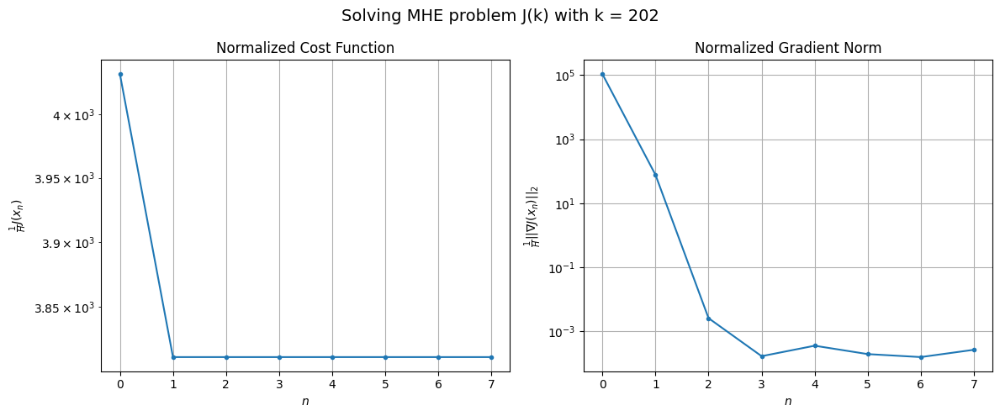

Windows:  48%|████▊     | 174/366 [18:07<19:08,  5.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120919.19778719264
Gradient norm: 3529244.398040114
Global estimation error: 80.39765751247586
Initial conditions estimation errors: 14.42042770108551 m, 20.817532850646213 m, 47.651001337460976 m, 59.597217517718896 m
Position estimation errors: 21.09575689643184 m, 14.31374425421943 m, 29.00420874122325 m, 31.13859111526561 m

[Gauss-Newton] Iteration 1
Cost function: 114097.09355213826 (-5.64%)
Gradient norm: 385.6946778033621 (-99.99%)
Global estimation error: 74.09052327535501 (-7.84%)
Initial conditions estimation errors: 17.800680699614237 m, 17.923828769824965 m, 45.282743389307754 m, 52.9219147676123 m
Position estimation errors: 17.710876796383783 m, 10.78851053113002 m, 38.6829412290565 m, 22.700637246274212 m

[Gauss-Newton] Iteration 2
Cost function: 114097.0929860229 (-0.00%)
Gradient norm: 1.302715081138819 (-99.66%)
Global estimation error: 73.51974765621273 (-0.77%)
Initial conditions estimation errors: 17.800

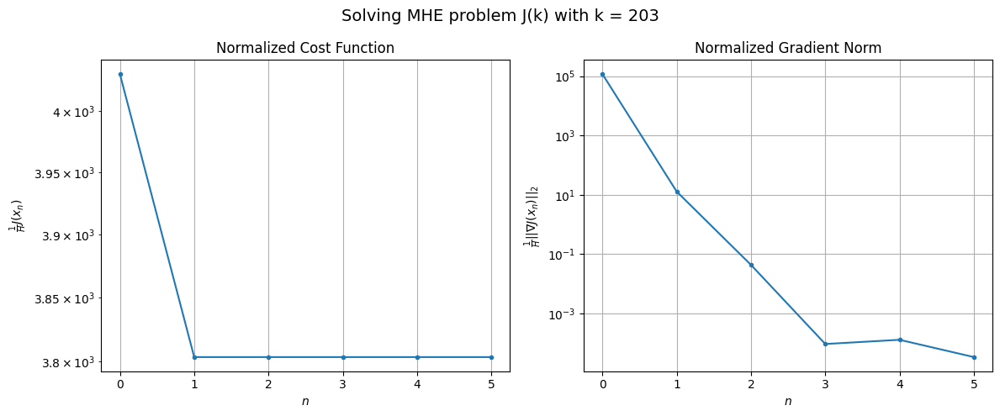

Windows:  48%|████▊     | 175/366 [18:12<18:09,  5.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 121915.63444158157
Gradient norm: 3728368.779517178
Global estimation error: 74.95166831886692
Initial conditions estimation errors: 14.639716877990411 m, 18.338747486653034 m, 44.64808979816934 m, 55.44052124844492 m
Position estimation errors: 21.72064882885936 m, 16.887904538336766 m, 39.45762775591852 m, 31.407041987867466 m

[Gauss-Newton] Iteration 1
Cost function: 114977.12151500562 (-5.69%)
Gradient norm: 1498.1529911608113 (-99.96%)
Global estimation error: 64.8054957870835 (-13.54%)
Initial conditions estimation errors: 17.973562129309567 m, 11.737578670484782 m, 47.83866292982862 m, 38.08382000635048 m
Position estimation errors: 18.240462950448823 m, 18.516286725325855 m, 20.0467084124223 m, 34.957890327255726 m

[Gauss-Newton] Iteration 2
Cost function: 114977.11188903524 (-0.00%)
Gradient norm: 0.9881818577022857 (-99.93%)
Global estimation error: 65.21251401917455 (0.63%)
Initial conditions estimation errors: 17

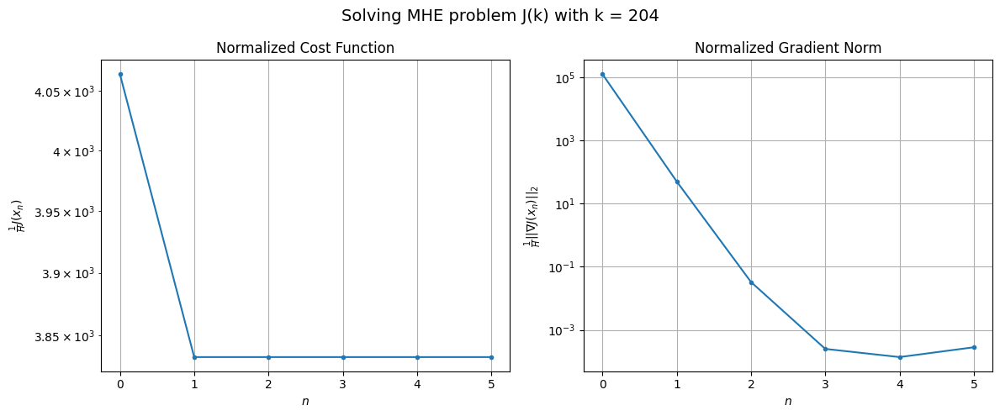

Windows:  48%|████▊     | 176/366 [18:17<17:25,  5.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 124020.13403158408
Gradient norm: 4001572.029002169
Global estimation error: 64.31235863967424
Initial conditions estimation errors: 14.803382104251195 m, 11.76787802460884 m, 46.14626081634205 m, 40.6074393193859 m
Position estimation errors: 22.44918249950608 m, 23.940167300824072 m, 21.595146641086007 m, 42.32916992109038 m

[Gauss-Newton] Iteration 1
Cost function: 116666.54431833522 (-5.93%)
Gradient norm: 185.64527793186514 (-100.00%)
Global estimation error: 49.49295095136239 (-23.04%)
Initial conditions estimation errors: 18.173456233442675 m, 8.35273245478152 m, 38.357314590397756 m, 24.04599678788991 m
Position estimation errors: 18.813106538391654 m, 18.888621451759256 m, 21.97127936146681 m, 36.46235452446254 m

[Gauss-Newton] Iteration 2
Cost function: 116666.54308359293 (-0.00%)
Gradient norm: 0.03794936056681577 (-99.98%)
Global estimation error: 49.5866268017034 (0.19%)
Initial conditions estimation errors: 18.

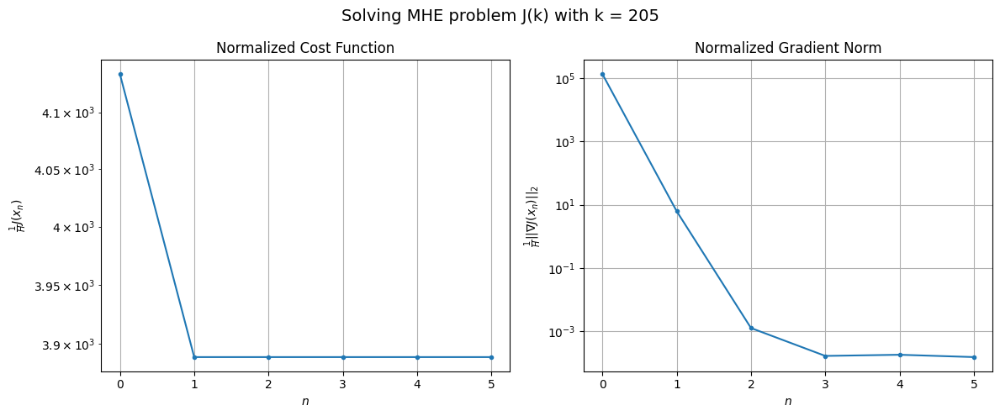

Windows:  48%|████▊     | 177/366 [18:22<16:40,  5.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 127623.40595907319
Gradient norm: 4310573.059181502
Global estimation error: 47.48248673641303
Initial conditions estimation errors: 14.974405378513104 m, 5.916141259739814 m, 36.214398686037825 m, 26.150658794203913 m
Position estimation errors: 23.23466473207605 m, 24.154138433056154 m, 24.379176799821476 m, 43.28513513287371 m

[Gauss-Newton] Iteration 1
Cost function: 120035.1725976474 (-5.95%)
Gradient norm: 4117.953311690904 (-99.90%)
Global estimation error: 33.26187184612345 (-29.95%)
Initial conditions estimation errors: 18.33411138224938 m, 22.56275866715226 m, 8.83424310155897 m, 13.530594029181692 m
Position estimation errors: 19.488582354386647 m, 27.606320933698996 m, 16.500347074839528 m, 54.399513012516486 m

[Gauss-Newton] Iteration 2
Cost function: 120034.9769767381 (-0.00%)
Gradient norm: 10.34379302492968 (-99.75%)
Global estimation error: 32.88336542518182 (-1.14%)
Initial conditions estimation errors: 18.

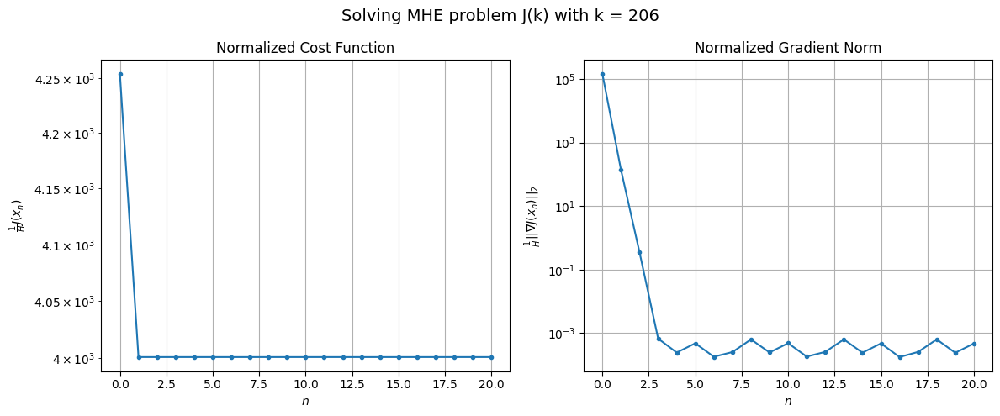

Windows:  49%|████▊     | 178/366 [18:39<27:21,  8.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 132818.64606330494
Gradient norm: 4625738.970438137
Global estimation error: 28.183735543526847
Initial conditions estimation errors: 15.09908370434244 m, 19.697634194259297 m, 5.624248876392281 m, 12.111989132641519 m
Position estimation errors: 24.17564166043783 m, 30.78846718559615 m, 22.59967433804422 m, 56.99726644404589 m

[Gauss-Newton] Iteration 1
Cost function: 124795.49369118504 (-6.04%)
Gradient norm: 117.32303879562761 (-100.00%)
Global estimation error: 34.75215843734869 (23.31%)
Initial conditions estimation errors: 18.510318530775105 m, 22.359719206419342 m, 9.889966668779536 m, 16.34929135369899 m
Position estimation errors: 20.286433885811647 m, 25.876945745105402 m, 21.414242608048244 m, 46.434598190981404 m

[Gauss-Newton] Iteration 2
Cost function: 124795.4936513188 (-0.00%)
Gradient norm: 0.04765243572811202 (-99.96%)
Global estimation error: 34.787594975495075 (0.10%)
Initial conditions estimation errors:

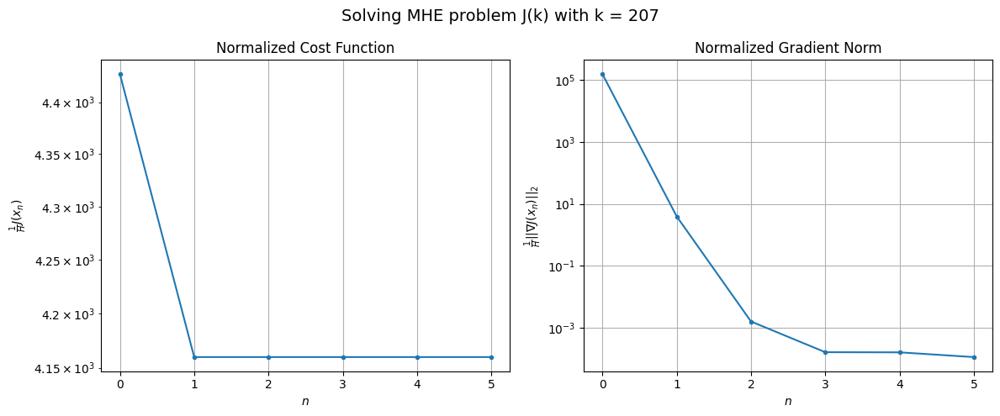

Windows:  49%|████▉     | 179/366 [18:44<24:34,  7.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 139628.8120388425
Gradient norm: 4960652.1549418485
Global estimation error: 29.722225627636814
Initial conditions estimation errors: 15.210976943201548 m, 19.712876156549317 m, 6.204354151183636 m, 14.997811454468604 m
Position estimation errors: 25.319048326467446 m, 30.148957656594305 m, 26.946945474386098 m, 50.68075559858671 m

[Gauss-Newton] Iteration 1
Cost function: 131118.36208624364 (-6.10%)
Gradient norm: 3206.5597401335904 (-99.94%)
Global estimation error: 38.99739552430327 (31.21%)
Initial conditions estimation errors: 18.6899189354549 m, 27.444498726041456 m, 4.761688823310724 m, 19.88957517715924 m
Position estimation errors: 21.28233786891457 m, 38.05397938711789 m, 7.757335246603205 m, 74.17655114071587 m

[Gauss-Newton] Iteration 2
Cost function: 131118.32561804965 (-0.00%)
Gradient norm: 0.3850505308310831 (-99.99%)
Global estimation error: 38.84658170824876 (-0.39%)
Initial conditions estimation errors: 18

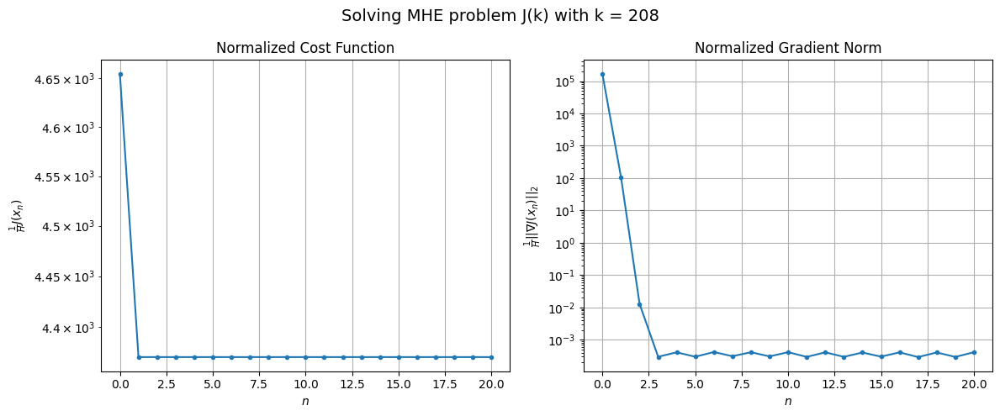

Windows:  49%|████▉     | 180/366 [19:04<35:31, 11.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 148957.01591597914
Gradient norm: 5430402.422074569
Global estimation error: 36.29139140114337
Initial conditions estimation errors: 15.297261693423941 m, 25.504526539932208 m, 6.197035781248732 m, 19.853511067153885 m
Position estimation errors: 26.72082023418614 m, 41.75479711985692 m, 14.0580499734381 m, 77.36400807722569 m

[Gauss-Newton] Iteration 1
Cost function: 139836.51965122146 (-6.12%)
Gradient norm: 5774.17460244914 (-99.89%)
Global estimation error: 44.82442394827772 (23.51%)
Initial conditions estimation errors: 18.85732501479305 m, 32.87678070591759 m, 11.429348784141494 m, 21.026047587875723 m
Position estimation errors: 22.50131381494852 m, 55.58481748182398 m, 23.423166659960312 m, 116.8447236857504 m

[Gauss-Newton] Iteration 2
Cost function: 139836.42463900067 (-0.00%)
Gradient norm: 1.6793752044066415 (-99.97%)
Global estimation error: 45.19036079685544 (0.82%)
Initial conditions estimation errors: 18.8573

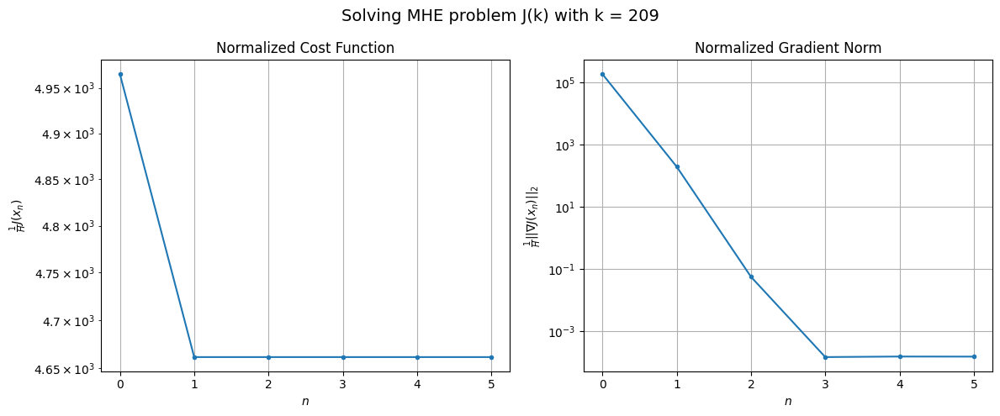

Windows:  49%|████▉     | 181/366 [19:10<30:19,  9.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 162517.16513285096
Gradient norm: 6199879.41588671
Global estimation error: 44.45658440459994
Initial conditions estimation errors: 15.371812308294201 m, 32.522079386691836 m, 11.778156026082696 m, 23.31658897360721 m
Position estimation errors: 28.34838049628873 m, 59.05732747053425 m, 20.202672204583667 m, 120.02012173532451 m

[Gauss-Newton] Iteration 1
Cost function: 152483.4054658018 (-6.17%)
Gradient norm: 422.69020074392074 (-99.99%)
Global estimation error: 60.77481779827107 (36.71%)
Initial conditions estimation errors: 19.032346070757566 m, 41.2216827542867 m, 13.548232722557831 m, 38.05969995948716 m
Position estimation errors: 23.855547952757423 m, 57.374060990032916 m, 29.581918859841213 m, 118.11927261776526 m

[Gauss-Newton] Iteration 2
Cost function: 152483.40408013036 (-0.00%)
Gradient norm: 0.13504082559187763 (-99.97%)
Global estimation error: 60.837122479386416 (0.10%)
Initial conditions estimation errors: 

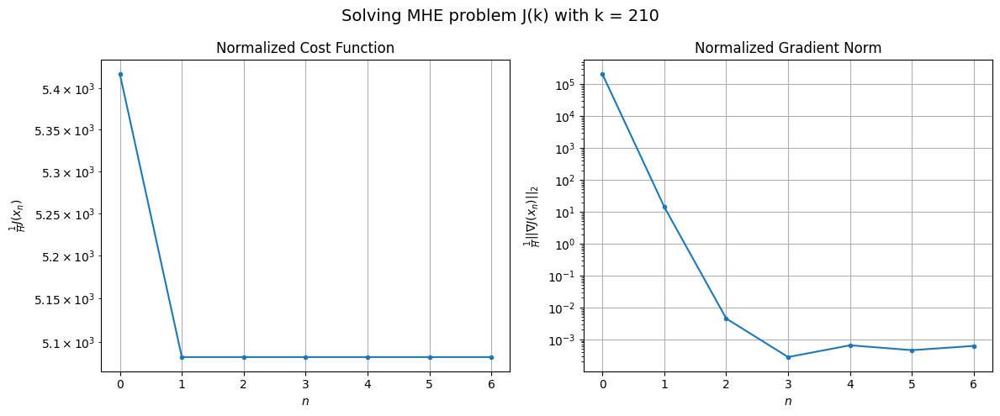

Windows:  50%|████▉     | 182/366 [19:18<28:09,  9.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 179715.72751119026
Gradient norm: 6730601.332352992
Global estimation error: 62.21101178876607
Initial conditions estimation errors: 15.485571683821814 m, 40.72291740801829 m, 16.672499450674042 m, 41.15890205096018 m
Position estimation errors: 30.03884983600932 m, 60.28626916741256 m, 25.860217803729046 m, 119.27738065503154 m

[Gauss-Newton] Iteration 1
Cost function: 168870.62560979556 (-6.03%)
Gradient norm: 206.2573733284303 (-100.00%)
Global estimation error: 61.085073339312565 (-1.81%)
Initial conditions estimation errors: 19.24942713404671 m, 42.00652010958851 m, 12.231333066640513 m, 38.03509961883884 m
Position estimation errors: 25.316010647057258 m, 54.25003898217101 m, 29.386041950863873 m, 108.80886707974551 m

[Gauss-Newton] Iteration 2
Cost function: 168870.62515515307 (-0.00%)
Gradient norm: 0.5848032500970995 (-99.72%)
Global estimation error: 61.238178011170355 (0.25%)
Initial conditions estimation errors: 

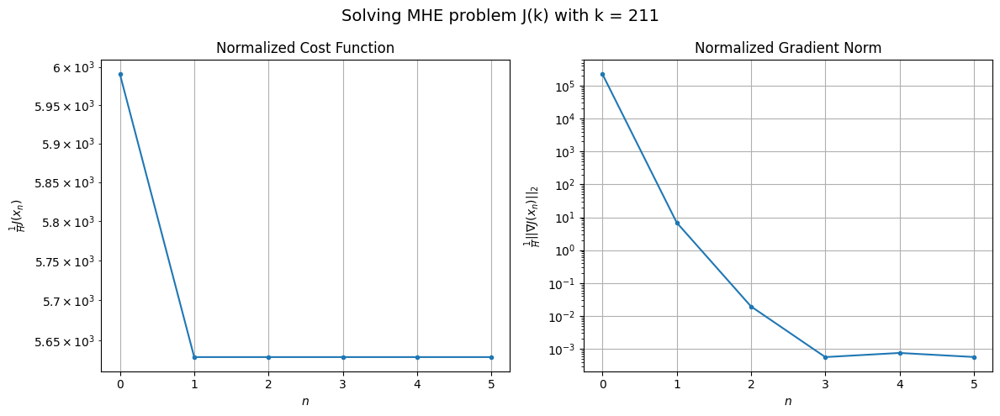

Windows:  50%|█████     | 183/366 [19:24<25:36,  8.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 200607.70174066443
Gradient norm: 7461011.974329424
Global estimation error: 61.53521992430797
Initial conditions estimation errors: 15.689128960839604 m, 41.162541351561636 m, 13.74124281448926 m, 40.709166992808456 m
Position estimation errors: 31.738121273566268 m, 57.933015272293574 m, 26.909108631837018 m, 110.82960839374614 m

[Gauss-Newton] Iteration 1
Cost function: 188751.6770144617 (-5.91%)
Gradient norm: 36887.81601369758 (-99.51%)
Global estimation error: 52.64727364132539 (-14.44%)
Initial conditions estimation errors: 19.56399119964112 m, 22.84902852368949 m, 30.247599039148987 m, 30.85403530936431 m
Position estimation errors: 26.73027261893261 m, 18.235559980810656 m, 30.03197967675078 m, 14.855652914406802 m

[Gauss-Newton] Iteration 2
Cost function: 188746.60724605437 (-0.00%)
Gradient norm: 31.53111694999319 (-99.91%)
Global estimation error: 52.73599215980229 (0.17%)
Initial conditions estimation errors: 19

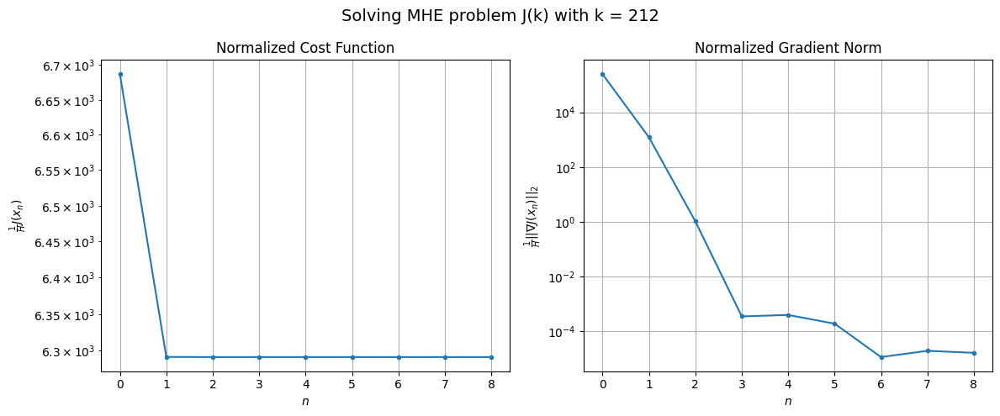

Windows:  50%|█████     | 184/366 [19:33<25:49,  8.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 224943.51985474996
Gradient norm: 8157263.883771649
Global estimation error: 45.18468594513476
Initial conditions estimation errors: 16.01866067390973 m, 19.471859525516063 m, 25.93363587317477 m, 27.08016439438814 m
Position estimation errors: 33.268006191272086 m, 25.347691066908858 m, 34.4222891049195 m, 22.163202125109486 m

[Gauss-Newton] Iteration 1
Cost function: 212087.82638106425 (-5.72%)
Gradient norm: 1344.6708494790903 (-99.98%)
Global estimation error: 65.35700132018435 (44.64%)
Initial conditions estimation errors: 19.995271457899236 m, 31.55145724690587 m, 17.389023261287498 m, 50.73300759532357 m
Position estimation errors: 27.982916276664728 m, 24.14702216589426 m, 25.04780453620458 m, 21.75301808523244 m

[Gauss-Newton] Iteration 2
Cost function: 212087.80948122393 (-0.00%)
Gradient norm: 1.0571171204746883 (-99.92%)
Global estimation error: 65.17924342755727 (-0.27%)
Initial conditions estimation errors: 19.

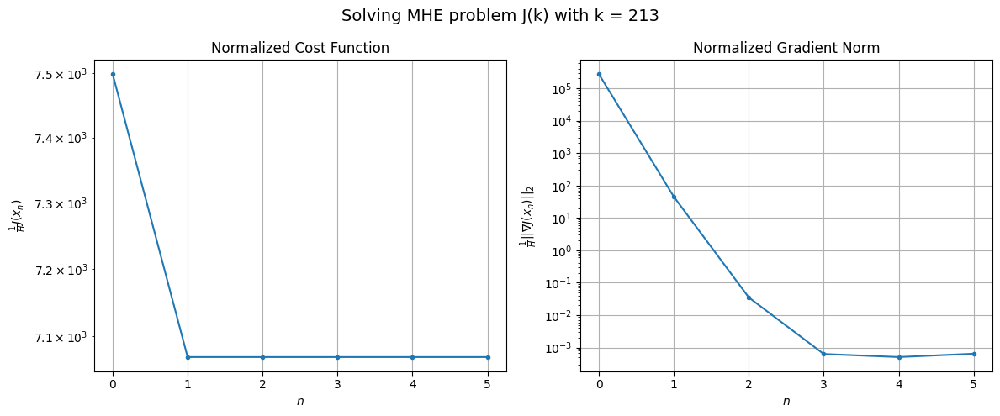

Windows:  51%|█████     | 185/366 [19:40<24:06,  7.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 251063.2376391674
Gradient norm: 8763996.312911706
Global estimation error: 58.74198606183501
Initial conditions estimation errors: 16.45876294637492 m, 27.98110431726581 m, 13.44102784560093 m, 47.07560286137552 m
Position estimation errors: 34.5067826195895 m, 30.328860284796647 m, 31.90013062779995 m, 27.06465028879835 m

[Gauss-Newton] Iteration 1
Cost function: 237212.70035838534 (-5.52%)
Gradient norm: 254.66387272413291 (-100.00%)
Global estimation error: 82.44189608293728 (40.35%)
Initial conditions estimation errors: 20.56674974885785 m, 38.51719341262009 m, 19.475697288893148 m, 67.16233570278051 m
Position estimation errors: 28.96870065473488 m, 21.04060555046291 m, 27.908089790112477 m, 14.957123378146807 m

[Gauss-Newton] Iteration 2
Cost function: 237212.69987067275 (-0.00%)
Gradient norm: 0.15973430042195552 (-99.94%)
Global estimation error: 82.44908319897691 (0.01%)
Initial conditions estimation errors: 20.566

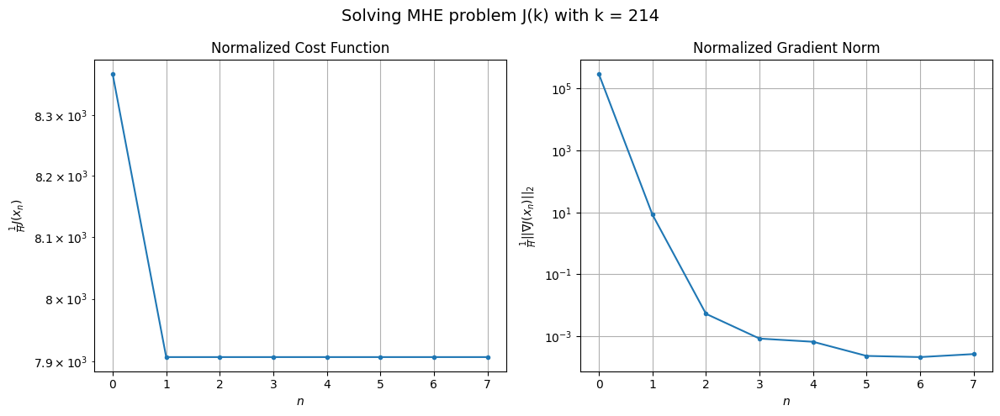

Windows:  51%|█████     | 186/366 [19:48<23:42,  7.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 278530.3334923901
Gradient norm: 9166580.162003774
Global estimation error: 75.23735301882067
Initial conditions estimation errors: 17.00901995102333 m, 34.601192070374026 m, 15.69835329259905 m, 62.67100200994322 m
Position estimation errors: 35.34238235986895 m, 27.07343420377176 m, 34.7905461542243 m, 19.692346710579642 m

[Gauss-Newton] Iteration 1
Cost function: 263718.9810945423 (-5.32%)
Gradient norm: 367.340145336828 (-100.00%)
Global estimation error: 72.25723179151011 (-3.96%)
Initial conditions estimation errors: 21.252895232481862 m, 31.74007598073489 m, 19.93761468682256 m, 58.00396645908167 m
Position estimation errors: 29.56960882497767 m, 21.43344589023314 m, 32.566556612762916 m, 20.101038555714677 m

[Gauss-Newton] Iteration 2
Cost function: 263718.98024280765 (-0.00%)
Gradient norm: 0.02080742879705343 (-99.99%)
Global estimation error: 72.16200006304135 (-0.13%)
Initial conditions estimation errors: 21.2528

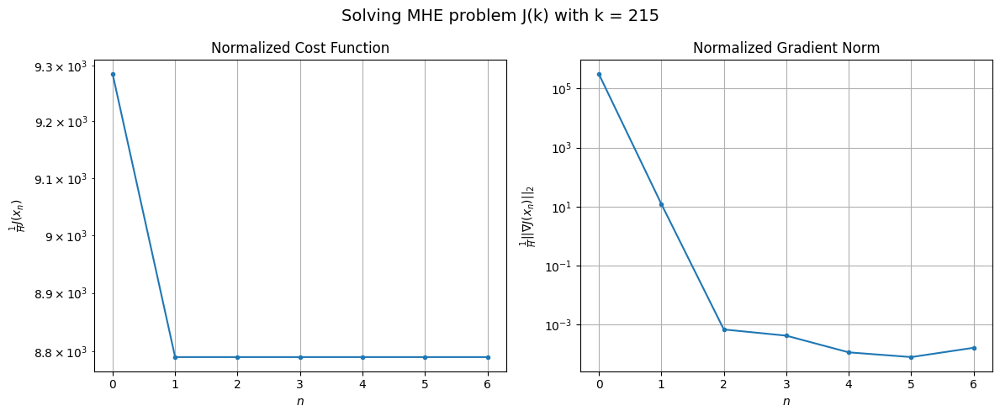

Windows:  51%|█████     | 187/366 [19:55<22:41,  7.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 304502.94555274106
Gradient norm: 9419787.231928676
Global estimation error: 64.00509709859182
Initial conditions estimation errors: 17.647335479225266 m, 27.375008496196976 m, 16.421207949153374 m, 52.59427096868335 m
Position estimation errors: 35.64238087396135 m, 27.53428478172149 m, 38.80707842095985 m, 24.000107845922972 m

[Gauss-Newton] Iteration 1
Cost function: 289105.29691961576 (-5.06%)
Gradient norm: 6408.650005849429 (-99.93%)
Global estimation error: 100.77643484940812 (57.45%)
Initial conditions estimation errors: 22.012401652726574 m, 34.35840477286196 m, 33.47950203051284 m, 85.84828309917313 m
Position estimation errors: 29.732571150478638 m, 22.452339922421043 m, 44.11982018032903 m, 78.02787140742126 m

[Gauss-Newton] Iteration 2
Cost function: 289105.1829539462 (-0.00%)
Gradient norm: 43.89466882583488 (-99.32%)
Global estimation error: 98.547212321567 (-2.21%)
Initial conditions estimation errors: 22.012

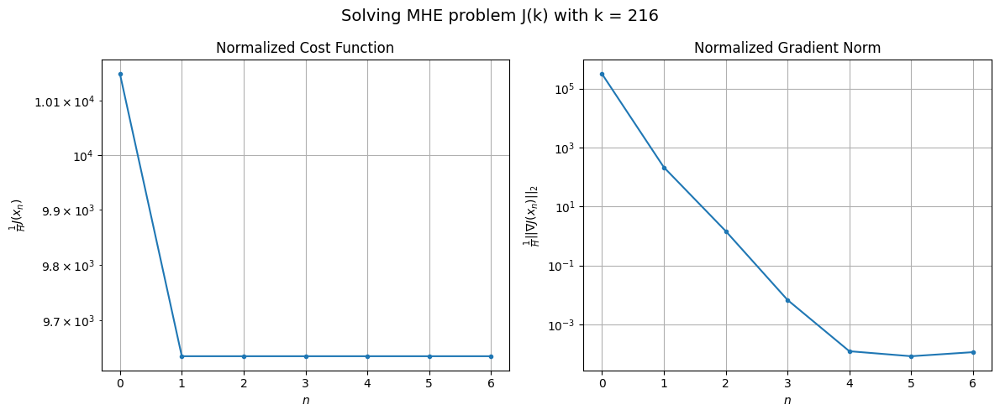

Windows:  51%|█████▏    | 188/366 [20:02<22:04,  7.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 326997.25567756366
Gradient norm: 9533975.21326537
Global estimation error: 87.52842091841113
Initial conditions estimation errors: 18.354290449288143 m, 28.760757030965255 m, 30.647334878804237 m, 74.55110881045546 m
Position estimation errors: 35.3780434838433 m, 25.636932475020156 m, 46.84942448744157 m, 74.1505389581348 m

[Gauss-Newton] Iteration 1
Cost function: 311266.23158000986 (-4.81%)
Gradient norm: 2609.3492150712987 (-99.97%)
Global estimation error: 74.8448814851916 (-14.49%)
Initial conditions estimation errors: 22.81528107698531 m, 29.919340905115046 m, 28.17187951740852 m, 58.24405976136247 m
Position estimation errors: 29.385968874360156 m, 20.654679093713387 m, 33.825898195728406 m, 37.93432937607934 m

[Gauss-Newton] Iteration 2
Cost function: 311266.21170356806 (-0.00%)
Gradient norm: 10.191263953233737 (-99.61%)
Global estimation error: 75.87891322228039 (1.38%)
Initial conditions estimation errors: 22.81

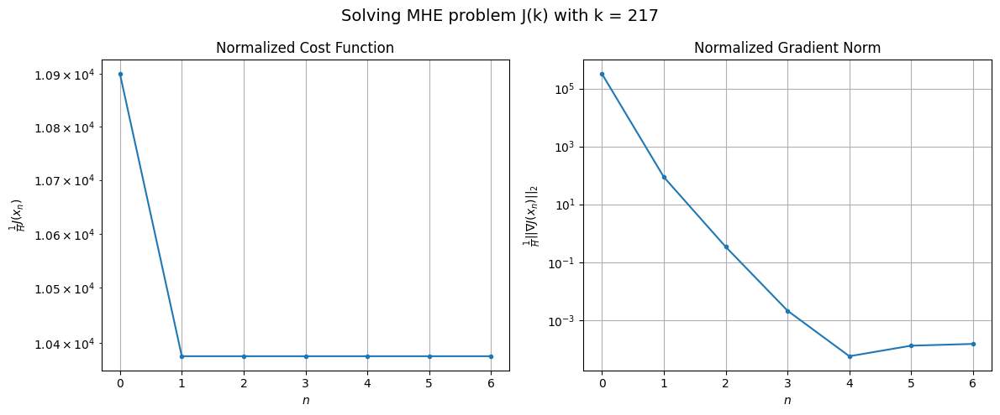

Windows:  52%|█████▏    | 189/366 [20:09<21:41,  7.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 344701.12691461144
Gradient norm: 9504090.21495048
Global estimation error: 66.20971231206804
Initial conditions estimation errors: 19.097782724672705 m, 25.212379274780076 m, 25.139929652080742 m, 52.45278142297328 m
Position estimation errors: 34.5427269582398 m, 25.771575316769717 m, 38.86530613638948 m, 41.75084916077778 m

[Gauss-Newton] Iteration 1
Cost function: 328917.01769810717 (-4.58%)
Gradient norm: 104.12969743124584 (-100.00%)
Global estimation error: 69.72400650248262 (5.31%)
Initial conditions estimation errors: 23.64305516886023 m, 28.282020276771867 m, 24.78999814252812 m, 53.74007704187159 m
Position estimation errors: 28.539397854043226 m, 21.049395764534363 m, 36.14099368304598 m, 47.451396655662144 m

[Gauss-Newton] Iteration 2
Cost function: 328917.01762401697 (-0.00%)
Gradient norm: 0.09697429881253841 (-99.91%)
Global estimation error: 69.76374309735114 (0.06%)
Initial conditions estimation errors: 23.

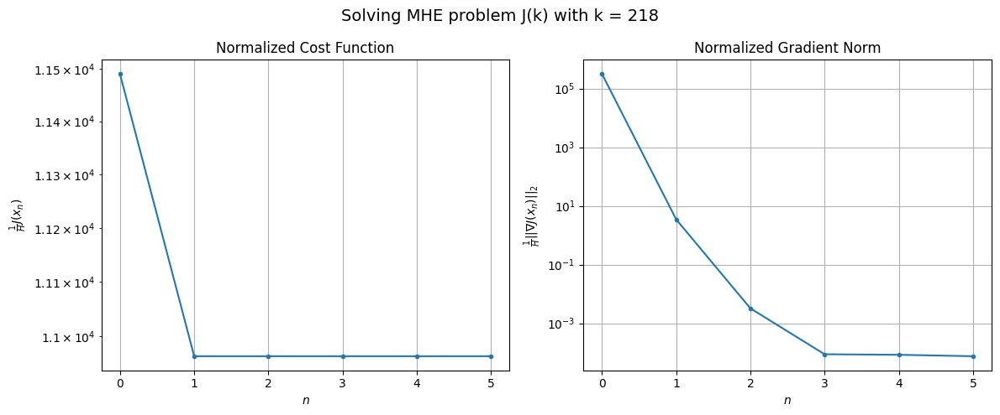

Windows:  52%|█████▏    | 190/366 [20:15<20:17,  6.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 356467.4688923564
Gradient norm: 9423085.06141147
Global estimation error: 59.60668225202561
Initial conditions estimation errors: 19.82449046581974 m, 23.31697511665356 m, 21.744314177291486 m, 46.29708314641701 m
Position estimation errors: 33.26412560807268 m, 25.96594509801698 m, 40.15215711261798 m, 49.04811231991642 m

[Gauss-Newton] Iteration 1
Cost function: 340712.12330439535 (-4.42%)
Gradient norm: 687.8460272334077 (-99.99%)
Global estimation error: 70.513105220697 (18.30%)
Initial conditions estimation errors: 24.466292961306646 m, 30.56214262248654 m, 19.198308399736646 m, 55.415260745122424 m
Position estimation errors: 27.283964351697943 m, 21.342032890254675 m, 32.47818342295868 m, 36.17365162726376 m

[Gauss-Newton] Iteration 2
Cost function: 340712.12111696904 (-0.00%)
Gradient norm: 0.005718868520801258 (-100.00%)
Global estimation error: 70.51438298745043 (0.00%)
Initial conditions estimation errors: 24.466

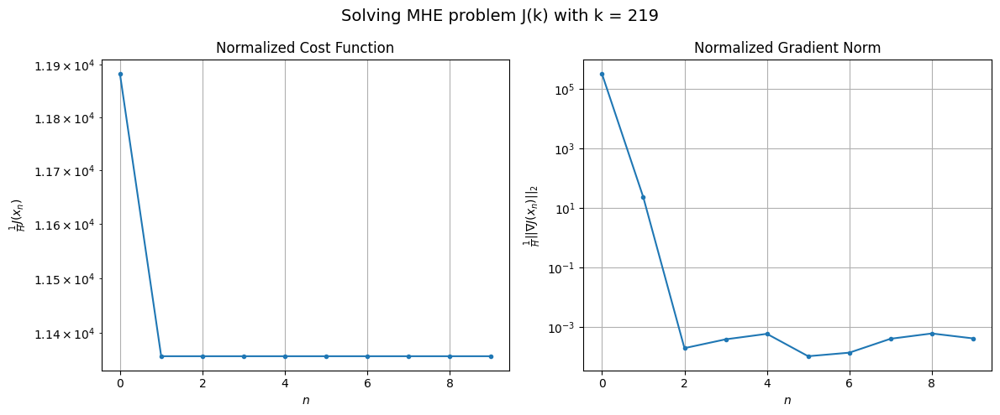

Windows:  52%|█████▏    | 191/366 [20:26<24:03,  8.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 361492.32472671237
Gradient norm: 9322772.112769032
Global estimation error: 60.98715418241132
Initial conditions estimation errors: 20.477455775211556 m, 25.877445554425904 m, 15.679807309371856 m, 48.83216851959097 m
Position estimation errors: 31.731228944323465 m, 26.253822266633684 m, 36.8401527249143 m, 38.760167536546525 m

[Gauss-Newton] Iteration 1
Cost function: 346007.838984277 (-4.28%)
Gradient norm: 2316.205836267889 (-99.98%)
Global estimation error: 75.48650884641799 (23.77%)
Initial conditions estimation errors: 25.17533284453779 m, 30.31662670437004 m, 26.787547348598874 m, 58.54659365923647 m
Position estimation errors: 25.818765051064656 m, 22.229319230193102 m, 36.326521972798716 m, 71.40296268355632 m

[Gauss-Newton] Iteration 2
Cost function: 346007.82306663675 (-0.00%)
Gradient norm: 0.023349535918217663 (-100.00%)
Global estimation error: 75.64228795122436 (0.21%)
Initial conditions estimation errors: 2

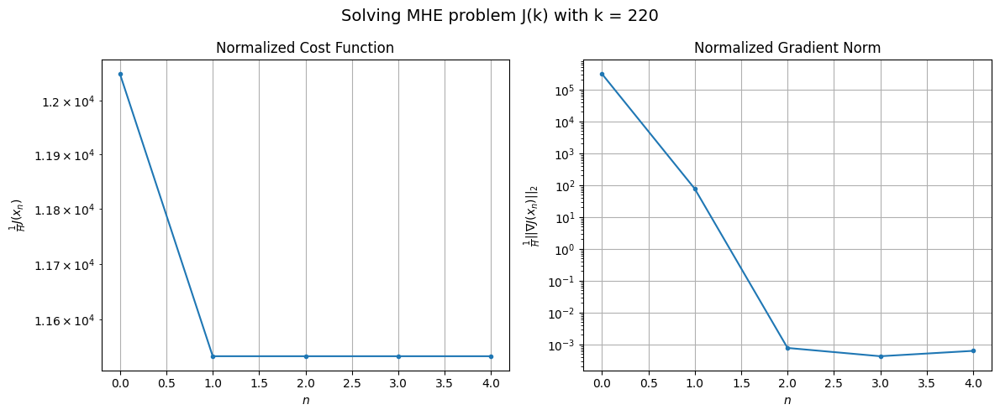

Windows:  52%|█████▏    | 192/366 [20:32<21:35,  7.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 359379.244177367
Gradient norm: 9167295.35731761
Global estimation error: 63.83242043449433
Initial conditions estimation errors: 20.968766860438347 m, 24.734769578544636 m, 23.79231661793627 m, 49.56777282739201 m
Position estimation errors: 30.148195301812574 m, 26.327430582199472 m, 39.092058687232104 m, 72.95825968338302 m

[Gauss-Newton] Iteration 1
Cost function: 344326.84276471386 (-4.19%)
Gradient norm: 458.54884762089233 (-99.99%)
Global estimation error: 77.10832823297505 (20.80%)
Initial conditions estimation errors: 25.694722155013398 m, 33.54630269159688 m, 23.96326491346668 m, 59.8819040717281 m
Position estimation errors: 24.337215120028954 m, 22.147631692514366 m, 32.162801337247565 m, 63.41632369535775 m

[Gauss-Newton] Iteration 2
Cost function: 344326.84172489826 (-0.00%)
Gradient norm: 0.006348731355828569 (-100.00%)
Global estimation error: 77.15478844735682 (0.06%)
Initial conditions estimation errors: 25

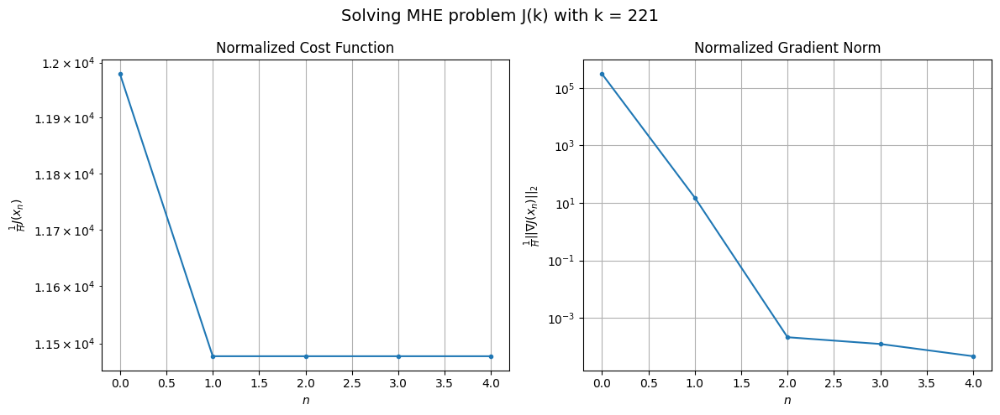

Windows:  53%|█████▎    | 193/366 [20:37<19:36,  6.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 352783.95750282414
Gradient norm: 9041413.83015306
Global estimation error: 65.4874141527563
Initial conditions estimation errors: 21.26997871174382 m, 27.904019163882197 m, 20.387004719162793 m, 51.39927014073398 m
Position estimation errors: 28.626719932774325 m, 26.5156123193254 m, 35.43344387697795 m, 65.81481818833942 m

[Gauss-Newton] Iteration 1
Cost function: 338368.56640059064 (-4.09%)
Gradient norm: 537.8540108551371 (-99.99%)
Global estimation error: 62.21706667006391 (-4.99%)
Initial conditions estimation errors: 25.954086749170916 m, 27.845326977781827 m, 24.166205413354188 m, 42.87124017750326 m
Position estimation errors: 22.939830313219904 m, 21.78557482996028 m, 27.540006602897243 m, 46.70158427807336 m

[Gauss-Newton] Iteration 2
Cost function: 338368.56563857483 (-0.00%)
Gradient norm: 0.04134751800419259 (-99.99%)
Global estimation error: 62.222047294492235 (0.01%)
Initial conditions estimation errors: 25.9

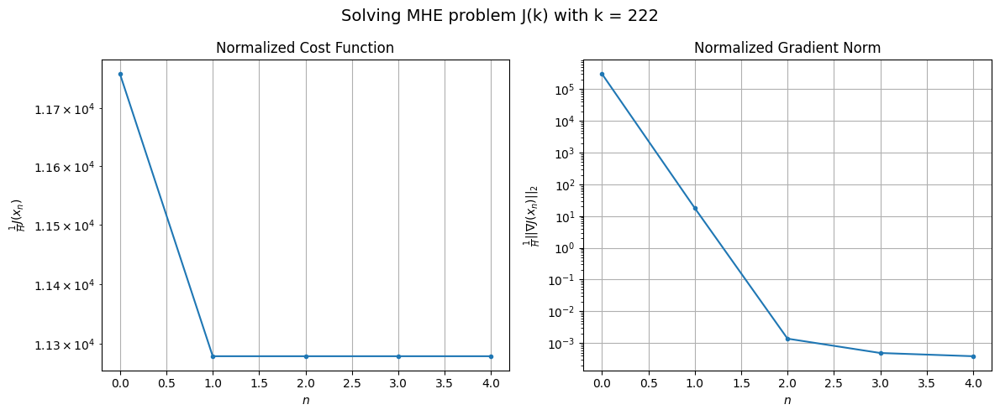

Windows:  53%|█████▎    | 194/366 [20:42<18:05,  6.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 342132.1551374541
Gradient norm: 9002790.588448558
Global estimation error: 51.07072773686731
Initial conditions estimation errors: 21.339091836973967 m, 22.39268239350607 m, 20.144625972526736 m, 35.29288388700853 m
Position estimation errors: 27.166006321397624 m, 26.663882885378765 m, 30.89842552257955 m, 49.69754147235072 m

[Gauss-Newton] Iteration 1
Cost function: 328045.76517190214 (-4.12%)
Gradient norm: 411.2436944930966 (-100.00%)
Global estimation error: 57.503128743242755 (12.60%)
Initial conditions estimation errors: 26.029748271279733 m, 25.841804431815586 m, 25.592637841718698 m, 36.14189059335979 m
Position estimation errors: 21.564907718441166 m, 22.934907637083203 m, 27.405019654968587 m, 59.23077651533217 m

[Gauss-Newton] Iteration 2
Cost function: 328045.7644193575 (-0.00%)
Gradient norm: 0.007991485026525363 (-100.00%)
Global estimation error: 57.46229740440891 (-0.07%)
Initial conditions estimation error

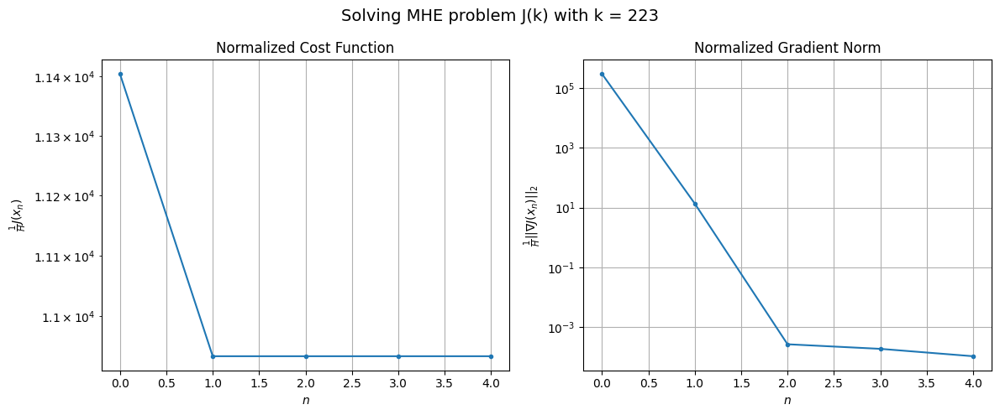

Windows:  53%|█████▎    | 195/366 [20:46<16:07,  5.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 327033.8411714421
Gradient norm: 8706834.067646453
Global estimation error: 45.8077091359019
Initial conditions estimation errors: 21.251576435565415 m, 20.062835509015237 m, 21.783669431966764 m, 27.742193732176165 m
Position estimation errors: 25.657741782997896 m, 27.24088062370019 m, 29.138699841697044 m, 61.46594529483702 m

[Gauss-Newton] Iteration 1
Cost function: 313703.29388251243 (-4.08%)
Gradient norm: 35.32636000060383 (-100.00%)
Global estimation error: 53.83222167051347 (17.52%)
Initial conditions estimation errors: 25.89405963672851 m, 26.433283933806656 m, 25.68402880512676 m, 29.478347648994326 m
Position estimation errors: 20.278119871996946 m, 24.141132342099716 m, 23.950812582440626 m, 58.172268177660456 m

[Gauss-Newton] Iteration 2
Cost function: 313703.2938721189 (-0.00%)
Gradient norm: 0.010010279691658137 (-99.97%)
Global estimation error: 53.84915999710801 (0.03%)
Initial conditions estimation errors:

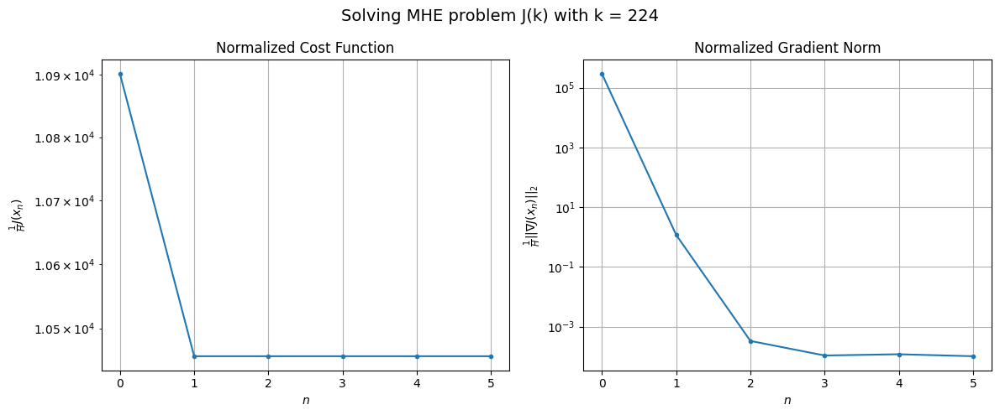

Windows:  54%|█████▎    | 196/366 [20:51<15:31,  5.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 308871.8580876441
Gradient norm: 8300474.532768334
Global estimation error: 42.34572809367677
Initial conditions estimation errors: 20.994833469418495 m, 20.58474049353741 m, 21.49128180419702 m, 21.60390364106469 m
Position estimation errors: 24.18270174853654 m, 28.334752583909655 m, 25.86200849366334 m, 60.443457259641775 m

[Gauss-Newton] Iteration 1
Cost function: 296438.00578203483 (-4.03%)
Gradient norm: 1572.0098235830897 (-99.98%)
Global estimation error: 48.76988287215362 (15.17%)
Initial conditions estimation errors: 25.565243174654647 m, 22.75198832125241 m, 27.346474512416044 m, 21.43360354673059 m
Position estimation errors: 19.10888372963988 m, 20.232303401035605 m, 18.6312534538254 m, 29.780668810194367 m

[Gauss-Newton] Iteration 2
Cost function: 296437.99983420124 (-0.00%)
Gradient norm: 0.08284549311986862 (-99.99%)
Global estimation error: 48.788296555332145 (0.04%)
Initial conditions estimation errors: 25.

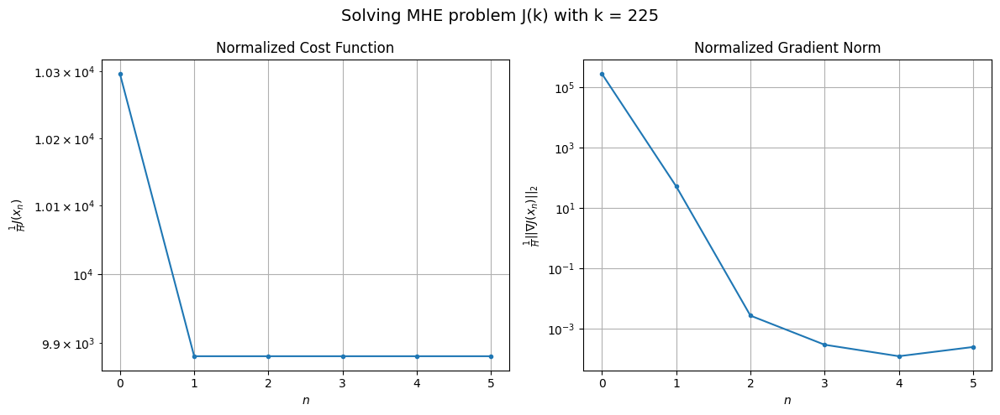

Windows:  54%|█████▍    | 197/366 [20:56<14:46,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 290091.00114653655
Gradient norm: 7944364.508017392
Global estimation error: 38.85063300088384
Initial conditions estimation errors: 20.59913389335757 m, 17.573457776991766 m, 22.557868921109755 m, 16.35018738223993 m
Position estimation errors: 22.787989850045136 m, 24.314274983788255 m, 21.312253397563875 m, 33.14763144058195 m

[Gauss-Newton] Iteration 1
Cost function: 278494.992992445 (-4.00%)
Gradient norm: 10.745518702777224 (-100.00%)
Global estimation error: 48.11622676540272 (23.85%)
Initial conditions estimation errors: 25.06974913036519 m, 22.765122307260274 m, 27.491300057179036 m, 20.312991157760173 m
Position estimation errors: 18.0166727727567 m, 20.350275978684287 m, 16.44852678651482 m, 30.189917075296638 m

[Gauss-Newton] Iteration 2
Cost function: 278494.99297267065 (-0.00%)
Gradient norm: 0.026355176236562555 (-99.75%)
Global estimation error: 48.11790727858142 (0.00%)
Initial conditions estimation errors: 

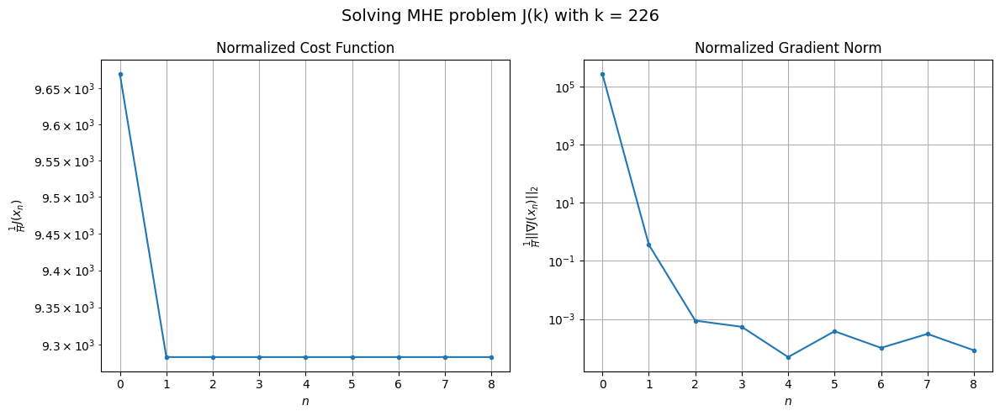

Windows:  54%|█████▍    | 198/366 [21:03<16:09,  5.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 269476.4877766661
Gradient norm: 7234004.645631928
Global estimation error: 38.975647932383175
Initial conditions estimation errors: 20.071170948452913 m, 17.724021754672616 m, 22.531426644514255 m, 17.158286274833568 m
Position estimation errors: 21.44100012054111 m, 24.03136291307004 m, 19.057549352366454 m, 33.0037730346404 m

[Gauss-Newton] Iteration 1
Cost function: 258954.09032814676 (-3.90%)
Gradient norm: 120.25136763835222 (-100.00%)
Global estimation error: 48.30294644160057 (23.93%)
Initial conditions estimation errors: 24.457573865820326 m, 23.38533983151214 m, 23.89879550312678 m, 24.838160467638918 m
Position estimation errors: 17.16658903904286 m, 21.6794998775391 m, 13.374637761342502 m, 40.94601928880719 m

[Gauss-Newton] Iteration 2
Cost function: 258954.08999035475 (-0.00%)
Gradient norm: 0.005052010824406739 (-100.00%)
Global estimation error: 48.29045798685402 (-0.03%)
Initial conditions estimation errors:

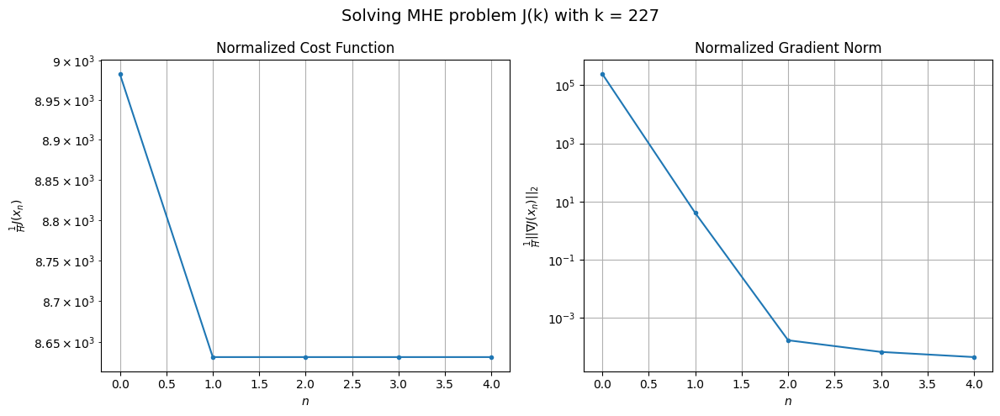

Windows:  54%|█████▍    | 199/366 [21:07<14:38,  5.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 249590.46318249562
Gradient norm: 6521131.662667218
Global estimation error: 37.749680770060586
Initial conditions estimation errors: 19.402510797849317 m, 18.093852968356426 m, 19.22748782801701 m, 18.747212377799336 m
Position estimation errors: 20.357384623488986 m, 24.998585414029165 m, 15.020003174909323 m, 43.85050649174481 m

[Gauss-Newton] Iteration 1
Cost function: 240177.15200623262 (-3.77%)
Gradient norm: 291.1949255556221 (-100.00%)
Global estimation error: 46.16621542376877 (22.30%)
Initial conditions estimation errors: 23.647766402433795 m, 23.528494487725272 m, 22.83722380588666 m, 22.29200113925187 m
Position estimation errors: 16.57928696555562 m, 21.464845074031487 m, 12.434998584725982 m, 29.801416622696294 m

[Gauss-Newton] Iteration 2
Cost function: 240177.1517669412 (-0.00%)
Gradient norm: 0.013730783486943584 (-100.00%)
Global estimation error: 46.1742983237519 (0.02%)
Initial conditions estimation error

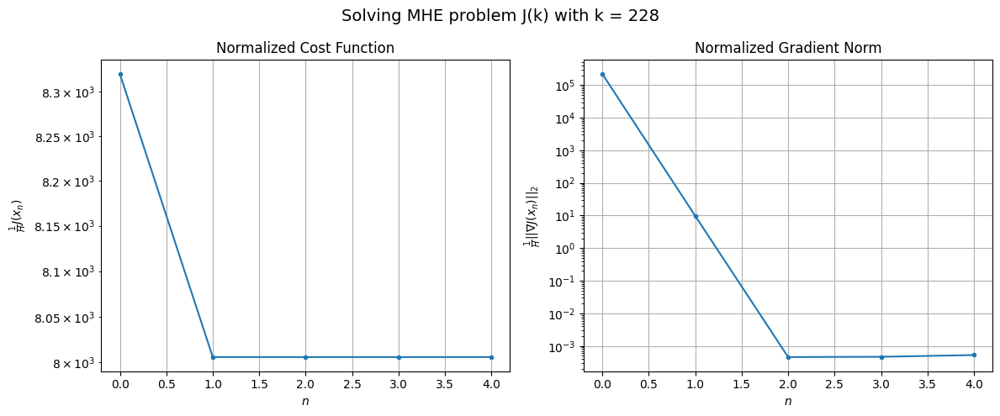

Windows:  55%|█████▍    | 200/366 [21:12<14:04,  5.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 231510.69312141952
Gradient norm: 5820782.04984291
Global estimation error: 36.05472911801917
Initial conditions estimation errors: 18.519505493929667 m, 18.201007778441962 m, 17.95577978076251 m, 17.413966949522603 m
Position estimation errors: 19.60618542657397 m, 24.667992787671388 m, 14.752936485999328 m, 32.75383720751409 m

[Gauss-Newton] Iteration 1
Cost function: 222932.1778650807 (-3.71%)
Gradient norm: 182.82878945150836 (-100.00%)
Global estimation error: 47.97268147583607 (33.06%)
Initial conditions estimation errors: 22.659575038356543 m, 20.882168531867688 m, 24.828310805450116 m, 27.11770542375244 m
Position estimation errors: 16.264326194955505 m, 19.443316478399574 m, 11.064441112304719 m, 26.119402311340565 m

[Gauss-Newton] Iteration 2
Cost function: 222932.17648446196 (-0.00%)
Gradient norm: 0.011029996127391896 (-99.99%)
Global estimation error: 47.962262126246365 (-0.02%)
Initial conditions estimation err

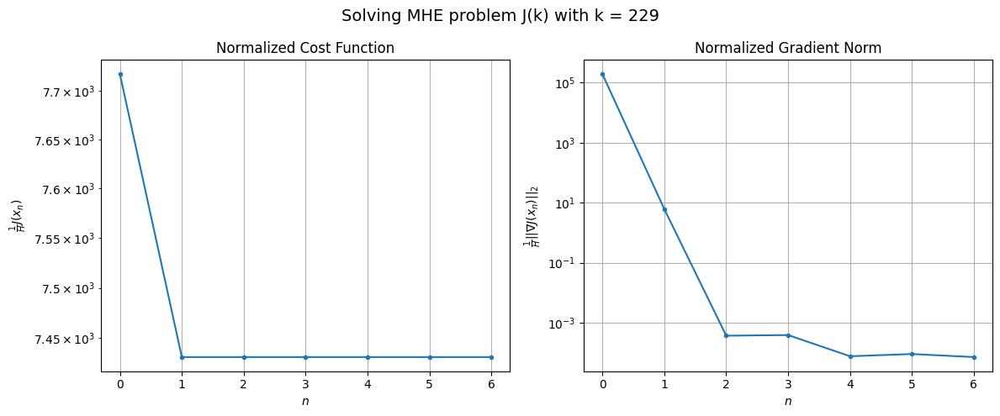

Windows:  55%|█████▍    | 201/366 [21:17<14:12,  5.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 215993.53025121606
Gradient norm: 5097833.97928722
Global estimation error: 41.8006278477471
Initial conditions estimation errors: 17.523848811903427 m, 17.120997942283513 m, 19.519853957088753 m, 27.676991965505156 m
Position estimation errors: 19.24242401119651 m, 22.043546859677804 m, 13.935281459241327 m, 27.658819210345733 m

[Gauss-Newton] Iteration 1
Cost function: 208290.77206535632 (-3.57%)
Gradient norm: 421.21967992598184 (-99.99%)
Global estimation error: 46.868640328442744 (12.12%)
Initial conditions estimation errors: 21.521122685309603 m, 20.958522931873564 m, 22.306850374868542 m, 28.224386107473165 m
Position estimation errors: 16.289799120227226 m, 18.050487899470863 m, 15.73906267077541 m, 14.209432517714987 m

[Gauss-Newton] Iteration 2
Cost function: 208290.7713536367 (-0.00%)
Gradient norm: 0.008766930297785837 (-100.00%)
Global estimation error: 46.87445253914234 (0.01%)
Initial conditions estimation err

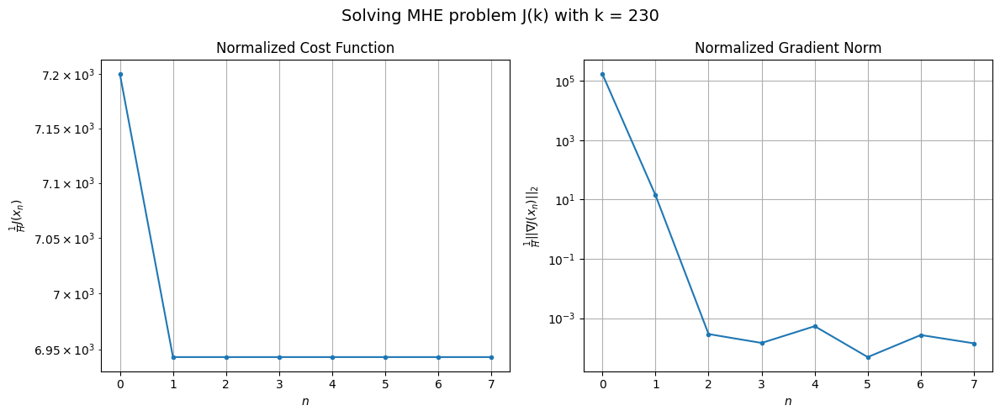

Windows:  55%|█████▌    | 202/366 [21:24<15:06,  5.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 203457.569354578
Gradient norm: 4460126.113348582
Global estimation error: 40.384686154366406
Initial conditions estimation errors: 16.55780951850949 m, 17.09091788506955 m, 16.98261579196276 m, 27.860714161907946 m
Position estimation errors: 19.349248432566725 m, 20.766756681553304 m, 18.94818938710668 m, 15.957462838833312 m

[Gauss-Newton] Iteration 1
Cost function: 196246.61032298708 (-3.54%)
Gradient norm: 146.0063785414733 (-100.00%)
Global estimation error: 52.773026670905374 (30.68%)
Initial conditions estimation errors: 20.491137172985894 m, 22.41277410657691 m, 22.15503172015026 m, 37.039025847763924 m
Position estimation errors: 16.632241244260516 m, 17.308614940563874 m, 17.769307912791437 m, 17.711081736412847 m

[Gauss-Newton] Iteration 2
Cost function: 196246.61017957111 (-0.00%)
Gradient norm: 0.01072502321769391 (-99.99%)
Global estimation error: 52.78821821245446 (0.03%)
Initial conditions estimation errors:

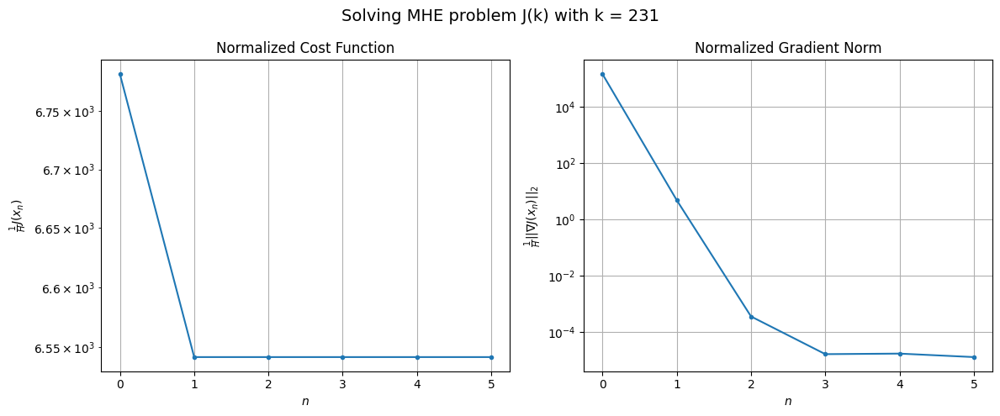

Windows:  55%|█████▌    | 203/366 [21:28<14:22,  5.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 194418.64303374774
Gradient norm: 3845366.944834885
Global estimation error: 48.557388868815934
Initial conditions estimation errors: 15.893711734422348 m, 19.707093178493363 m, 16.796514934702966 m, 37.8772517413301 m
Position estimation errors: 19.86074253518671 m, 19.89962045027424 m, 21.30929580619105 m, 18.952889069003067 m

[Gauss-Newton] Iteration 1
Cost function: 187651.60471828157 (-3.48%)
Gradient norm: 205.90360928952668 (-99.99%)
Global estimation error: 48.62771204843666 (0.14%)
Initial conditions estimation errors: 19.72973918363384 m, 22.414699062420112 m, 20.22358555587265 m, 32.61819031574525 m
Position estimation errors: 17.24148624290835 m, 15.102247674908257 m, 19.087880211151813 m, 10.412406877179485 m

[Gauss-Newton] Iteration 2
Cost function: 187651.60438824323 (-0.00%)
Gradient norm: 0.016142912091658232 (-99.99%)
Global estimation error: 48.63399072584823 (0.01%)
Initial conditions estimation errors: 1

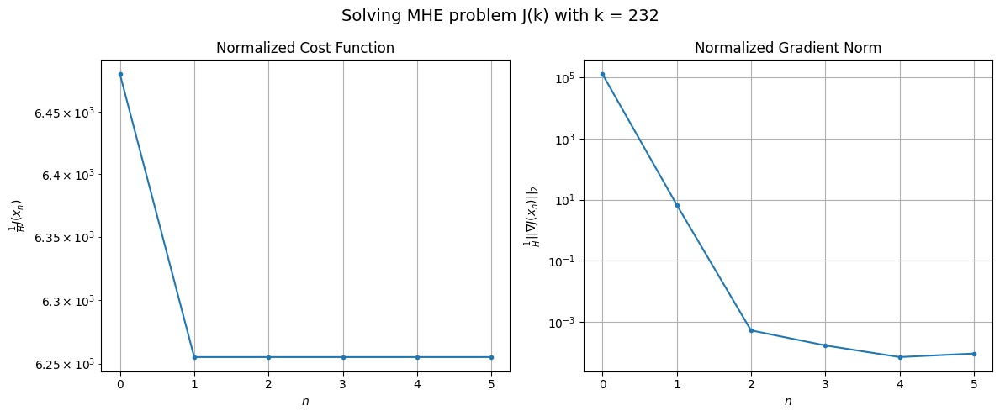

Windows:  56%|█████▌    | 204/366 [21:33<14:13,  5.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 189774.08852102602
Gradient norm: 3617801.79704416
Global estimation error: 43.54750781733719
Initial conditions estimation errors: 15.605307969166098 m, 19.78428311414277 m, 15.509877732182 m, 31.950876558504465 m
Position estimation errors: 20.651975843139006 m, 17.911774004372564 m, 22.63692623062319 m, 12.259897074628482 m

[Gauss-Newton] Iteration 1
Cost function: 182923.33040223896 (-3.61%)
Gradient norm: 269.4155233531643 (-99.99%)
Global estimation error: 66.71409610876893 (53.20%)
Initial conditions estimation errors: 19.425847946449345 m, 28.04734019189957 m, 19.35874311617941 m, 53.96260304239003 m
Position estimation errors: 17.92712846205543 m, 14.057264446950366 m, 18.492467292679514 m, 7.650674735665952 m

[Gauss-Newton] Iteration 2
Cost function: 182923.32857182104 (-0.00%)
Gradient norm: 0.008760533158207642 (-100.00%)
Global estimation error: 66.7261645120812 (0.02%)
Initial conditions estimation errors: 19.4

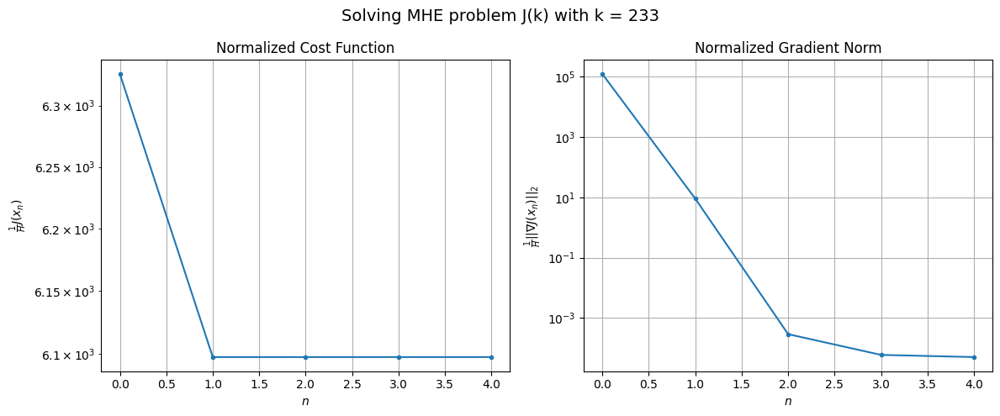

Windows:  56%|█████▌    | 205/366 [21:38<13:20,  4.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 187123.82752041196
Gradient norm: 3409416.9208659315
Global estimation error: 64.12346412142622
Initial conditions estimation errors: 15.727331919851311 m, 26.46168843569581 m, 14.589830971492399 m, 54.32642055348596 m
Position estimation errors: 21.473930210903045 m, 16.59512634550427 m, 22.347130629146854 m, 8.470230134069508 m

[Gauss-Newton] Iteration 1
Cost function: 179907.7459658339 (-3.86%)
Gradient norm: 60.14225801528915 (-100.00%)
Global estimation error: 62.17775650093468 (-3.03%)
Initial conditions estimation errors: 19.611747135476932 m, 28.523012629579892 m, 18.64231006353062 m, 48.169760181872824 m
Position estimation errors: 18.590978978894327 m, 15.75361402237524 m, 19.056977311638253 m, 14.59785626127406 m

[Gauss-Newton] Iteration 2
Cost function: 179907.74592851562 (-0.00%)
Gradient norm: 0.005696781925867282 (-99.99%)
Global estimation error: 62.120093211828774 (-0.09%)
Initial conditions estimation error

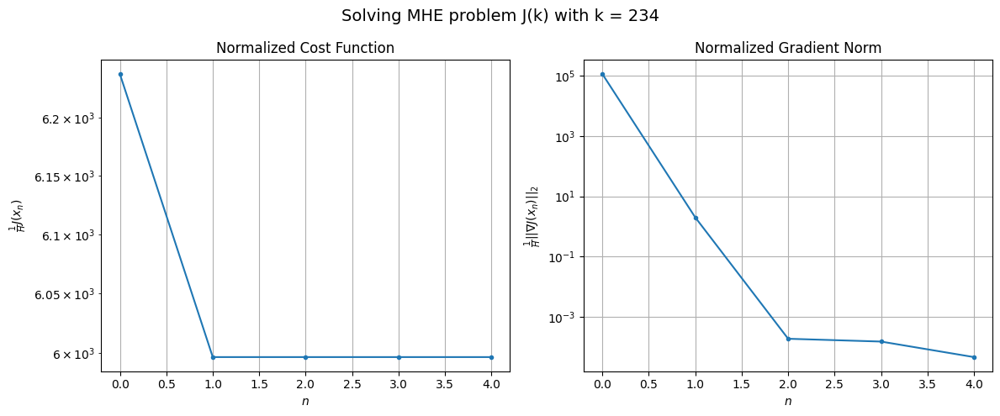

Windows:  56%|█████▋    | 206/366 [21:42<12:40,  4.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 184992.2173372495
Gradient norm: 3208330.997988007
Global estimation error: 58.98870787398952
Initial conditions estimation errors: 16.172634023458524 m, 26.602118384203795 m, 14.204194064483634 m, 48.04847499402821 m
Position estimation errors: 22.214406246733233 m, 18.491605422068382 m, 22.923178103125167 m, 15.830558513994227 m

[Gauss-Newton] Iteration 1
Cost function: 177477.6509371024 (-4.06%)
Gradient norm: 41.89129432939205 (-100.00%)
Global estimation error: 75.08197894474694 (27.28%)
Initial conditions estimation errors: 20.08103443238203 m, 32.65265435122021 m, 18.076393276080605 m, 61.97640465740727 m
Position estimation errors: 19.183253006246616 m, 14.446028936112084 m, 20.049666584802345 m, 9.8995360919097 m

[Gauss-Newton] Iteration 2
Cost function: 177477.65086181404 (-0.00%)
Gradient norm: 0.008050756684061348 (-99.98%)
Global estimation error: 75.1247973397763 (0.06%)
Initial conditions estimation errors: 20

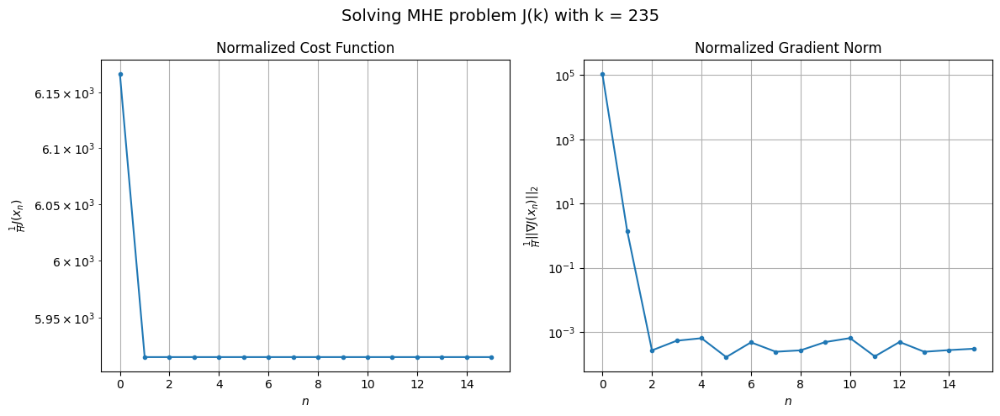

Windows:  57%|█████▋    | 207/366 [21:54<18:05,  6.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 183062.83055027016
Gradient norm: 3061685.1395030865
Global estimation error: 72.03548898842534
Initial conditions estimation errors: 16.714834901433292 m, 30.69923770477376 m, 13.502697577698408 m, 61.52181081996125 m
Position estimation errors: 22.835686125056693 m, 17.031828893619473 m, 23.972806542572012 m, 10.500080986021672 m

[Gauss-Newton] Iteration 1
Cost function: 175057.14305695234 (-4.37%)
Gradient norm: 382.1513479610648 (-99.99%)
Global estimation error: 66.57547148866128 (-7.58%)
Initial conditions estimation errors: 20.663816280809478 m, 32.91664405698734 m, 16.11748387364153 m, 51.59450329752221 m
Position estimation errors: 19.600361363649053 m, 16.118019743328592 m, 20.996874001844823 m, 28.351845214463346 m

[Gauss-Newton] Iteration 2
Cost function: 175057.14267302345 (-0.00%)
Gradient norm: 0.007901821913444603 (-100.00%)
Global estimation error: 66.47789443919405 (-0.15%)
Initial conditions estimation err

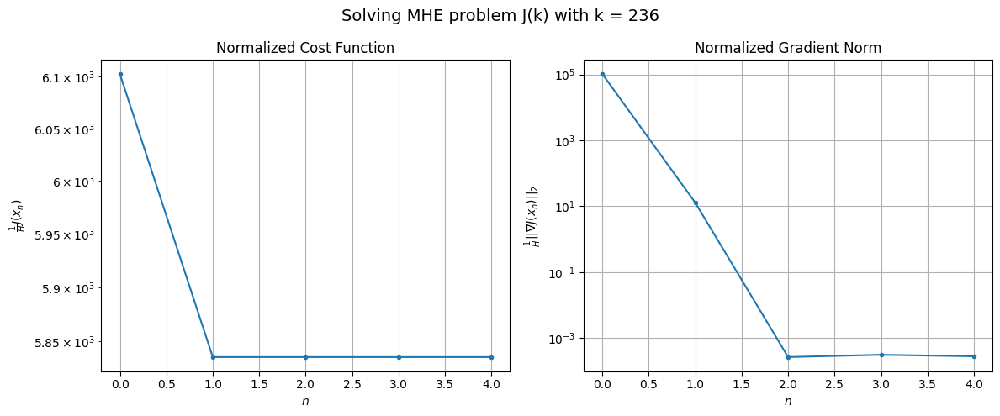

Windows:  57%|█████▋    | 208/366 [21:58<15:44,  5.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 181106.55494691082
Gradient norm: 3120250.7939814925
Global estimation error: 63.596708416324425
Initial conditions estimation errors: 17.22939510995608 m, 30.95469889751423 m, 11.585627393058926 m, 51.52905168547431 m
Position estimation errors: 23.233423849723245 m, 18.659728970383348 m, 24.958023530781965 m, 29.228594924091773 m

[Gauss-Newton] Iteration 1
Cost function: 172577.94864743282 (-4.71%)
Gradient norm: 48.41288945507041 (-100.00%)
Global estimation error: 67.49515829153218 (6.13%)
Initial conditions estimation errors: 21.206810361891154 m, 34.41580629983697 m, 16.761397589468796 m, 51.38527543177124 m
Position estimation errors: 19.778136238609044 m, 14.076793128337293 m, 21.15902961805072 m, 21.852870917076114 m

[Gauss-Newton] Iteration 2
Cost function: 172577.94863159404 (-0.00%)
Gradient norm: 0.001997672584790391 (-100.00%)
Global estimation error: 67.48065003227885 (-0.02%)
Initial conditions estimation err

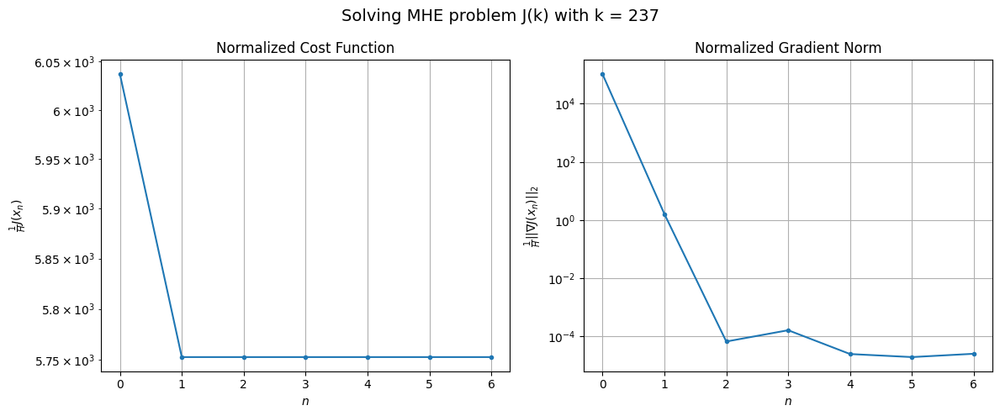

Windows:  57%|█████▋    | 209/366 [22:03<15:27,  5.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 177167.19199391518
Gradient norm: 3067465.734392068
Global estimation error: 63.327198256941294
Initial conditions estimation errors: 17.641469310209054 m, 31.860543342529258 m, 12.550771120954614 m, 50.264011670349674 m
Position estimation errors: 23.340688597794006 m, 16.682504880941078 m, 24.94768063343186 m, 22.943686830699967 m

[Gauss-Newton] Iteration 1
Cost function: 168391.7180204376 (-4.95%)
Gradient norm: 825.1300910050766 (-99.97%)
Global estimation error: 46.6866529372812 (-26.28%)
Initial conditions estimation errors: 21.602750769709136 m, 29.52579476260808 m, 19.8150913921565 m, 21.17841300688941 m
Position estimation errors: 19.746728709579696 m, 11.508833638741569 m, 20.139292028700176 m, 15.570976106721412 m

[Gauss-Newton] Iteration 2
Cost function: 168391.70439643782 (-0.00%)
Gradient norm: 0.015388020606071272 (-100.00%)
Global estimation error: 46.66020706977946 (-0.06%)
Initial conditions estimation erro

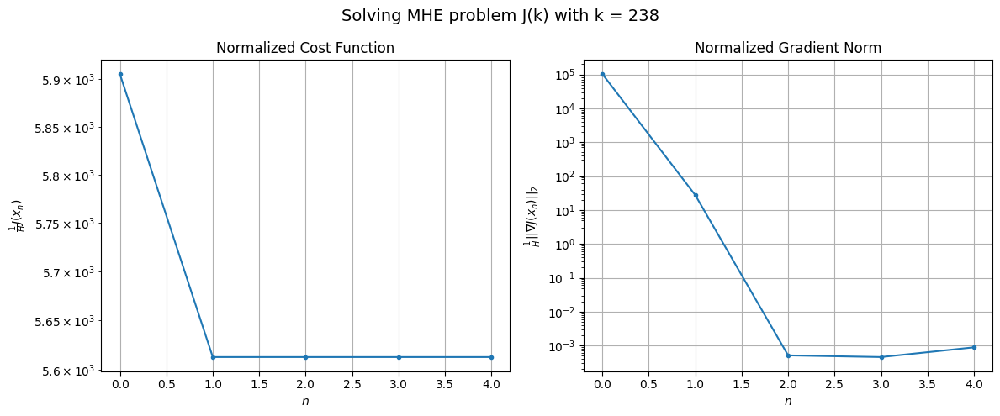

Windows:  57%|█████▋    | 210/366 [22:08<14:18,  5.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 171593.44494527506
Gradient norm: 3037661.1992615266
Global estimation error: 39.5590367511885
Initial conditions estimation errors: 17.89713382594047 m, 26.059627409446307 m, 16.366629655627438 m, 17.251482585421282 m
Position estimation errors: 23.210778416639066 m, 14.535170744819947 m, 23.613495337507267 m, 19.171602692352344 m

[Gauss-Newton] Iteration 1
Cost function: 162713.74405247453 (-5.17%)
Gradient norm: 9.988397649371398 (-100.00%)
Global estimation error: 49.282024189000396 (24.58%)
Initial conditions estimation errors: 21.82069559119821 m, 29.84917020480511 m, 20.33577932655854 m, 25.45643375308094 m
Position estimation errors: 19.51539777182324 m, 12.21953610792017 m, 19.90539524849393 m, 14.168000414680671 m

[Gauss-Newton] Iteration 2
Cost function: 162713.74405257613 (0.00%)
Gradient norm: 0.016112943838065334 (-99.84%)
Global estimation error: 49.311443674107245 (0.06%)
Initial conditions estimation errors:

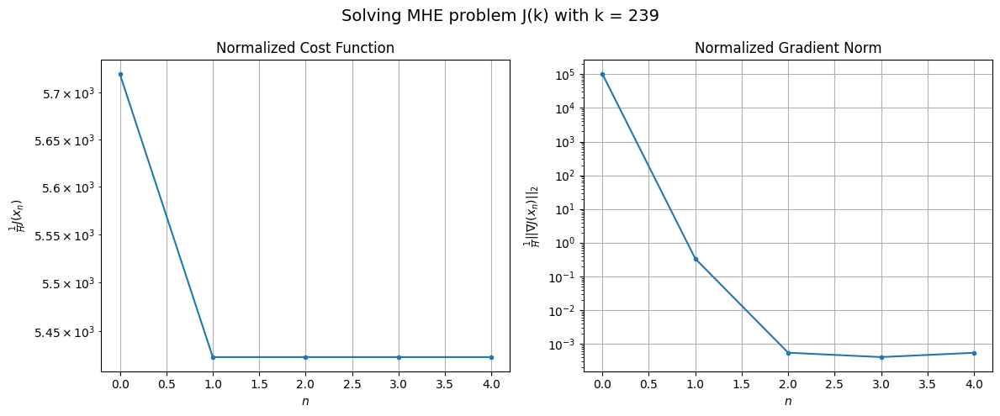

Windows:  58%|█████▊    | 211/366 [22:12<13:18,  5.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 165127.86805575926
Gradient norm: 3013925.402774062
Global estimation error: 41.86625104059321
Initial conditions estimation errors: 17.988100535700635 m, 26.159813803490795 m, 16.707077938795425 m, 21.58064684812305 m
Position estimation errors: 22.889366336226548 m, 15.15213784586043 m, 23.28747743464925 m, 17.439375279053582 m

[Gauss-Newton] Iteration 1
Cost function: 156325.03439356337 (-5.33%)
Gradient norm: 223.79215908075318 (-99.99%)
Global estimation error: 46.382850435278854 (10.79%)
Initial conditions estimation errors: 21.839697324267437 m, 28.72408371295795 m, 20.964256096182606 m, 20.243387111105815 m
Position estimation errors: 19.138297148307256 m, 9.759741441947863 m, 19.369294384756895 m, 4.581863801983895 m

[Gauss-Newton] Iteration 2
Cost function: 156325.03419315617 (-0.00%)
Gradient norm: 0.004347533669461002 (-100.00%)
Global estimation error: 46.389789735595116 (0.01%)
Initial conditions estimation err

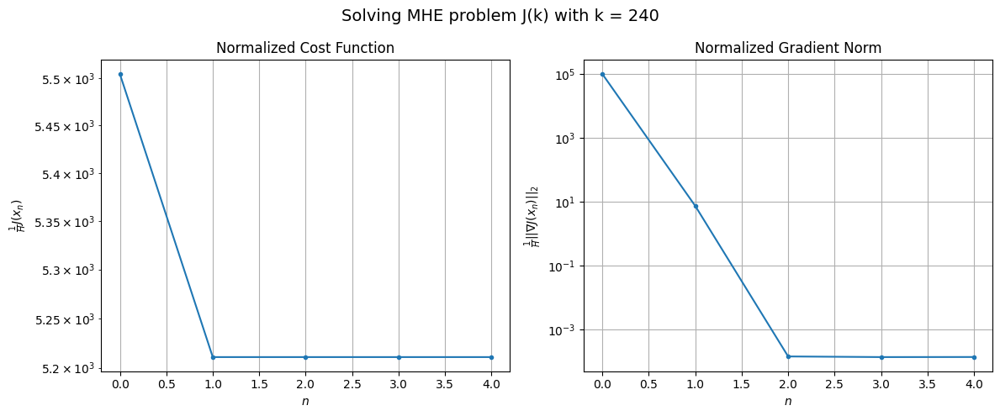

Windows:  58%|█████▊    | 212/366 [22:17<12:29,  4.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 158202.58119279635
Gradient norm: 3118604.5808872227
Global estimation error: 38.162792871466884
Initial conditions estimation errors: 17.89628258355194 m, 24.634157976970585 m, 17.297934423049263 m, 15.16693853320467 m
Position estimation errors: 22.461248381179775 m, 12.766983768969295 m, 22.676506906194632 m, 7.749243934581386 m

[Gauss-Newton] Iteration 1
Cost function: 149529.68831454313 (-5.48%)
Gradient norm: 226.00336794175777 (-99.99%)
Global estimation error: 44.23907276031004 (15.92%)
Initial conditions estimation errors: 21.68237576912555 m, 26.02636108466019 m, 22.493581582222383 m, 17.424314021010943 m
Position estimation errors: 18.689535963512718 m, 9.352690528408342 m, 18.249527181946515 m, 10.763572954031549 m

[Gauss-Newton] Iteration 2
Cost function: 149529.68814415048 (-0.00%)
Gradient norm: 0.01119221222338033 (-100.00%)
Global estimation error: 44.30715734154169 (0.15%)
Initial conditions estimation erro

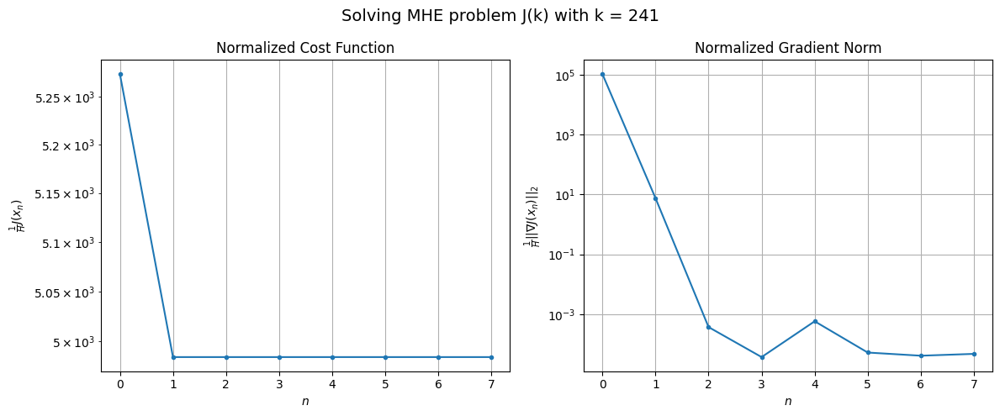

Windows:  58%|█████▊    | 213/366 [22:23<13:29,  5.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 150160.11809800877
Gradient norm: 3095282.5843849843
Global estimation error: 35.37811187465585
Initial conditions estimation errors: 17.649509322424162 m, 21.55131052308675 m, 18.616904823256924 m, 11.359128601062741 m
Position estimation errors: 22.00448756636129 m, 12.538303306119204 m, 21.490688700928473 m, 7.749427913506422 m

[Gauss-Newton] Iteration 1
Cost function: 141777.06098790094 (-5.58%)
Gradient norm: 2789.874127309055 (-99.91%)
Global estimation error: 49.13841235880284 (38.89%)
Initial conditions estimation errors: 21.35331920559859 m, 29.824702275560615 m, 19.19025051851052 m, 26.472988783878915 m
Position estimation errors: 18.26672932022199 m, 13.039730057599252 m, 19.29824599507946 m, 32.532790208267016 m

[Gauss-Newton] Iteration 2
Cost function: 141777.03508469978 (-0.00%)
Gradient norm: 0.11977077867309055 (-100.00%)
Global estimation error: 48.90858903882802 (-0.47%)
Initial conditions estimation errors

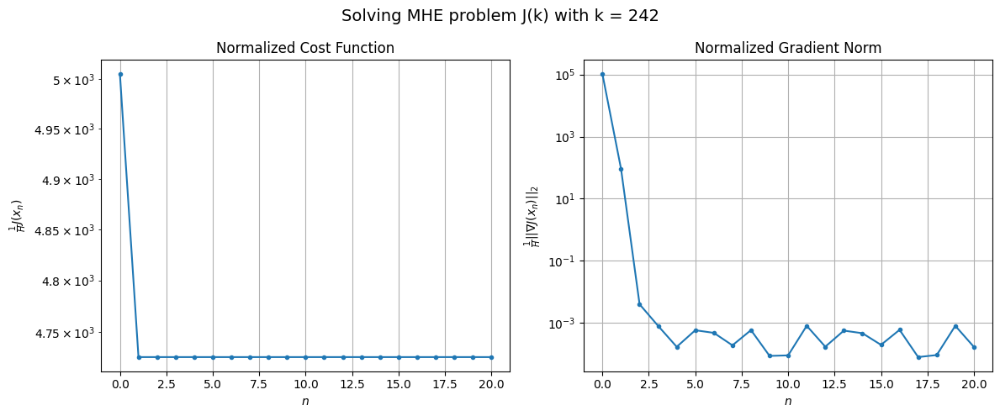

Windows:  58%|█████▊    | 214/366 [22:38<21:09,  8.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 142570.99834816586
Gradient norm: 3078216.5942125716
Global estimation error: 41.63138251751982
Initial conditions estimation errors: 17.269722053959185 m, 25.60570987448897 m, 15.27430748016268 m, 23.365642912559178 m
Position estimation errors: 21.620395768295555 m, 15.893517548331015 m, 22.697427214933462 m, 35.00530008945113 m

[Gauss-Newton] Iteration 1
Cost function: 134372.22402687458 (-5.75%)
Gradient norm: 757.1083433058691 (-99.98%)
Global estimation error: 40.12536373548325 (-3.62%)
Initial conditions estimation errors: 20.917521264929224 m, 25.42157695240791 m, 21.19538418141419 m, 8.773672448647568 m
Position estimation errors: 17.897850794523634 m, 10.402786336753989 m, 17.68952516529999 m, 16.12989878449966 m

[Gauss-Newton] Iteration 2
Cost function: 134372.2201845706 (-0.00%)
Gradient norm: 0.03421763744025367 (-100.00%)
Global estimation error: 40.097908621162404 (-0.07%)
Initial conditions estimation errors:

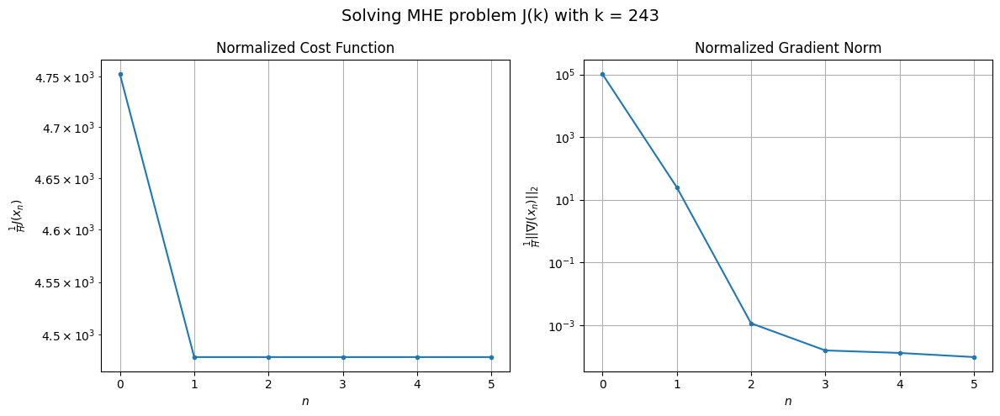

Windows:  59%|█████▊    | 215/366 [22:43<18:30,  7.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 134665.36187577422
Gradient norm: 3092378.087243004
Global estimation error: 32.14736162536188
Initial conditions estimation errors: 16.83244816440072 m, 20.893290766302606 m, 17.187674635266372 m, 4.260870679015147 m
Position estimation errors: 21.330933053273792 m, 13.647269634095972 m, 21.07468467780136 m, 20.367265957675468 m

[Gauss-Newton] Iteration 1
Cost function: 126772.87940909632 (-5.86%)
Gradient norm: 261.0892501227992 (-99.99%)
Global estimation error: 37.678139494545704 (17.20%)
Initial conditions estimation errors: 20.404674261728207 m, 17.95794144314453 m, 22.5219620595945 m, 13.173489436697407 m
Position estimation errors: 17.662248718414265 m, 12.132374924504688 m, 16.49634082118614 m, 14.605225942538175 m

[Gauss-Newton] Iteration 2
Cost function: 126772.87819232784 (-0.00%)
Gradient norm: 0.13169174402047693 (-99.95%)
Global estimation error: 37.781363094091425 (0.27%)
Initial conditions estimation errors:

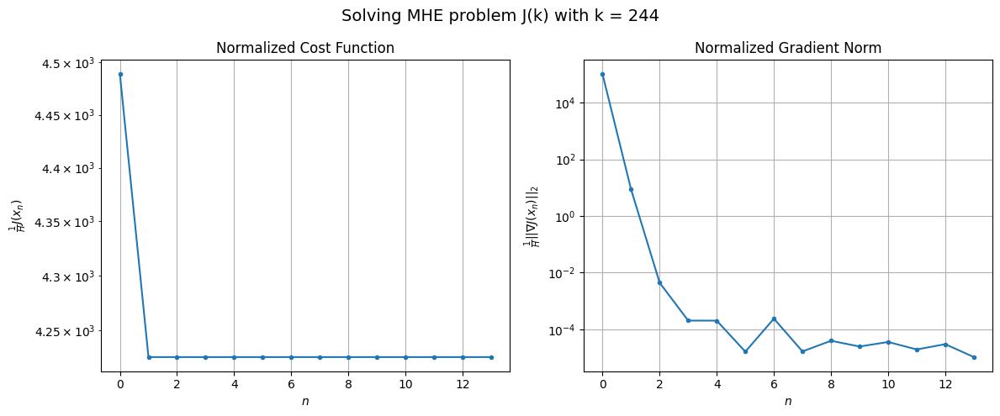

Windows:  59%|█████▉    | 216/366 [22:54<20:33,  8.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 128535.28251215894
Gradient norm: 3029141.2432051515
Global estimation error: 33.488274501467195
Initial conditions estimation errors: 16.369732699385885 m, 13.394081534507961 m, 18.49990814529909 m, 18.216134386648427 m
Position estimation errors: 21.20286211045515 m, 15.876184357435012 m, 19.870611009593066 m, 20.297874885945134 m

[Gauss-Newton] Iteration 1
Cost function: 120968.3223772221 (-5.89%)
Gradient norm: 258.44436287677235 (-99.99%)
Global estimation error: 40.03447228242664 (19.55%)
Initial conditions estimation errors: 19.85626488177889 m, 23.30544113709275 m, 19.197917720392066 m, 17.226777613119445 m
Position estimation errors: 17.5956396853558 m, 10.60104226597836 m, 18.149780890583145 m, 8.248116884125462 m

[Gauss-Newton] Iteration 2
Cost function: 120968.31909143348 (-0.00%)
Gradient norm: 0.3451203518354972 (-99.87%)
Global estimation error: 40.28092534125494 (0.62%)
Initial conditions estimation errors: 1

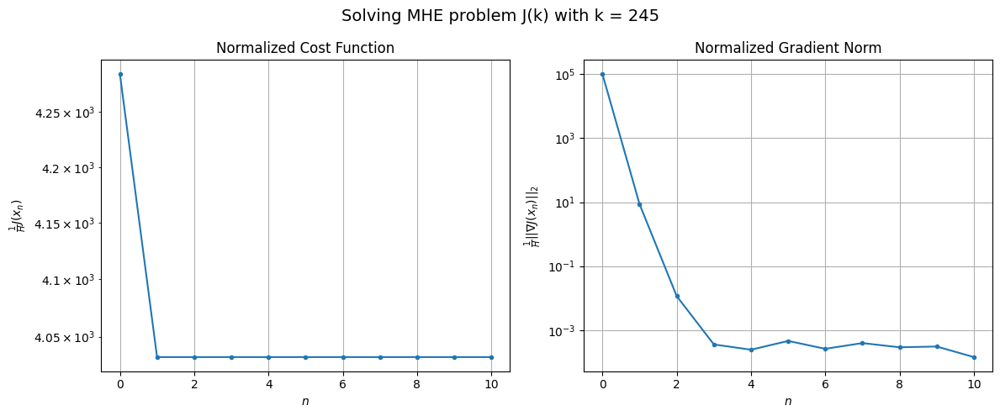

Windows:  59%|█████▉    | 217/366 [23:02<20:27,  8.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 124026.50619767289
Gradient norm: 2999560.667716677
Global estimation error: 31.910143959521427
Initial conditions estimation errors: 15.901282257747695 m, 19.046055990606682 m, 15.281201752903051 m, 13.004610540880321 m
Position estimation errors: 21.252106494861945 m, 14.104359714243257 m, 21.87630233409949 m, 12.23704192477568 m

[Gauss-Newton] Iteration 1
Cost function: 116637.20214610612 (-5.96%)
Gradient norm: 20.130957020528758 (-100.00%)
Global estimation error: 38.35788471400771 (20.21%)
Initial conditions estimation errors: 19.336232219945767 m, 20.80242851769408 m, 19.489033266010853 m, 16.87757878599659 m
Position estimation errors: 17.67267966667972 m, 12.856186855292489 m, 17.572165550022312 m, 7.4686448613067595 m

[Gauss-Newton] Iteration 2
Cost function: 116637.20213347237 (-0.00%)
Gradient norm: 0.0198220120685153 (-99.90%)
Global estimation error: 38.282091610344054 (-0.20%)
Initial conditions estimation err

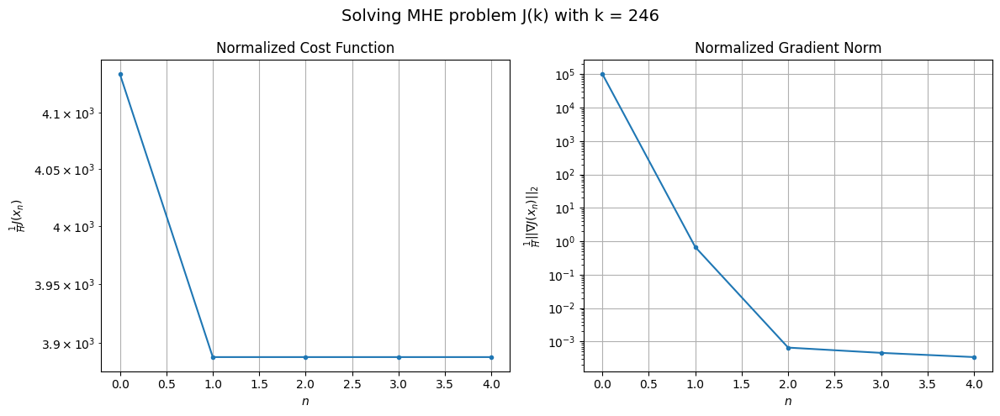

Windows:  60%|█████▉    | 218/366 [23:06<17:35,  7.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120437.10781312501
Gradient norm: 2879077.8958825218
Global estimation error: 30.043500282605187
Initial conditions estimation errors: 15.468325317388532 m, 16.580238425141484 m, 15.657753583656392 m, 11.96889691486218 m
Position estimation errors: 21.42805219694189 m, 16.601856248956445 m, 21.29898498171948 m, 11.249620888869668 m

[Gauss-Newton] Iteration 1
Cost function: 113175.11521084445 (-6.03%)
Gradient norm: 1918.2697586487957 (-99.93%)
Global estimation error: 62.72409586771235 (108.78%)
Initial conditions estimation errors: 18.871602322520488 m, 28.24451800157873 m, 18.231406870636977 m, 49.477497999624475 m
Position estimation errors: 17.87565736275079 m, 13.851793032524403 m, 18.768641093066872 m, 27.61191637421672 m

[Gauss-Newton] Iteration 2
Cost function: 113175.08652009036 (-0.00%)
Gradient norm: 0.35753330140115436 (-99.98%)
Global estimation error: 63.24524193646255 (0.83%)
Initial conditions estimation erro

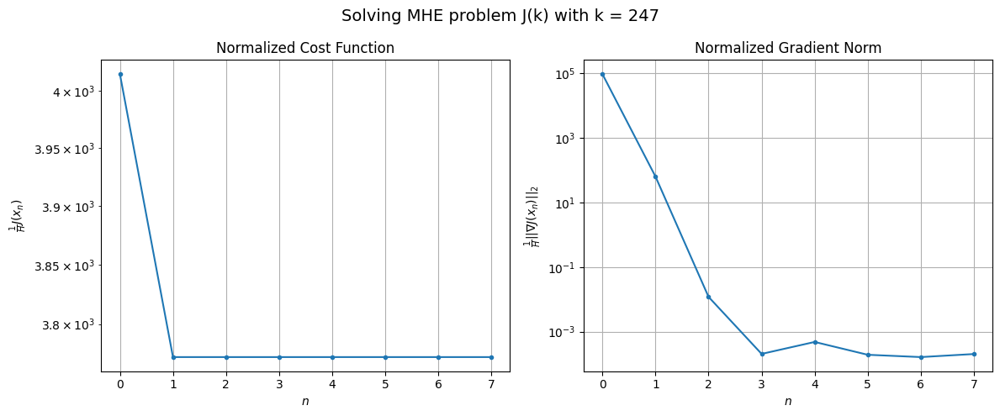

Windows:  60%|█████▉    | 219/366 [23:12<16:40,  6.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 118600.02839300231
Gradient norm: 2849157.804043281
Global estimation error: 57.57809556436728
Initial conditions estimation errors: 15.08348994112259 m, 24.509149400599146 m, 14.503778297060416 m, 47.71429648194222 m
Position estimation errors: 21.70048210967916 m, 17.13202178134966 m, 22.78509252033857 m, 29.246265064827202 m

[Gauss-Newton] Iteration 1
Cost function: 111394.98888285599 (-6.08%)
Gradient norm: 591.8442667367857 (-99.98%)
Global estimation error: 54.21979021783062 (-5.83%)
Initial conditions estimation errors: 18.456989589486657 m, 26.088507655164282 m, 17.55269205455474 m, 40.129791532118226 m
Position estimation errors: 18.149490368411044 m, 11.777972843223624 m, 19.30307952447285 m, 9.224082101082313 m

[Gauss-Newton] Iteration 2
Cost function: 111394.98731975869 (-0.00%)
Gradient norm: 0.010511205851825488 (-100.00%)
Global estimation error: 54.27207792553414 (0.10%)
Initial conditions estimation errors: 

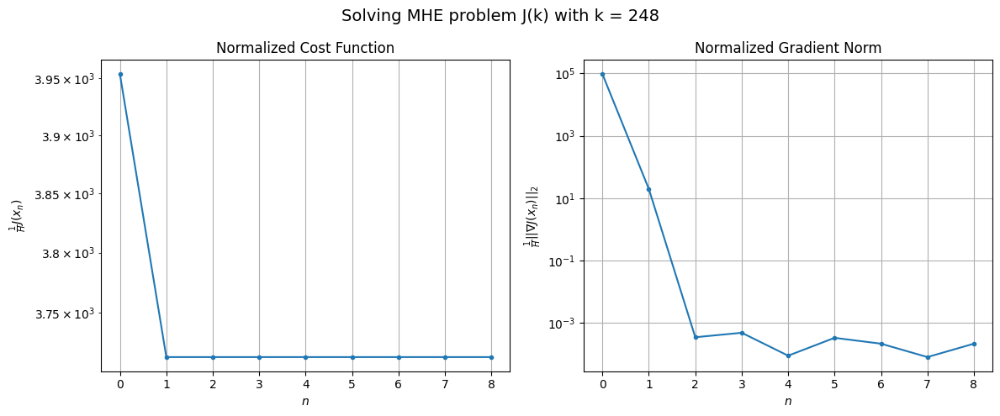

Windows:  60%|██████    | 220/366 [23:20<16:45,  6.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 118568.8257735373
Gradient norm: 2688955.262685252
Global estimation error: 47.049797591357255
Initial conditions estimation errors: 14.745289886351124 m, 22.09535216236047 m, 13.947567527104981 m, 36.24230586664728 m
Position estimation errors: 22.011263418400347 m, 15.216407581995204 m, 23.277422395349703 m, 11.740725994462048 m

[Gauss-Newton] Iteration 1
Cost function: 111470.2597527432 (-5.99%)
Gradient norm: 1130.0287196768109 (-99.96%)
Global estimation error: 71.98071026839781 (52.99%)
Initial conditions estimation errors: 18.07876303434075 m, 30.243356244282644 m, 16.77272097445322 m, 60.4845687226635 m
Position estimation errors: 18.479068327340414 m, 15.38526145306852 m, 21.091243499219345 m, 29.058278997573037 m

[Gauss-Newton] Iteration 2
Cost function: 111470.25237867823 (-0.00%)
Gradient norm: 0.0114324171126884 (-100.00%)
Global estimation error: 72.11075796852224 (0.18%)
Initial conditions estimation errors: 1

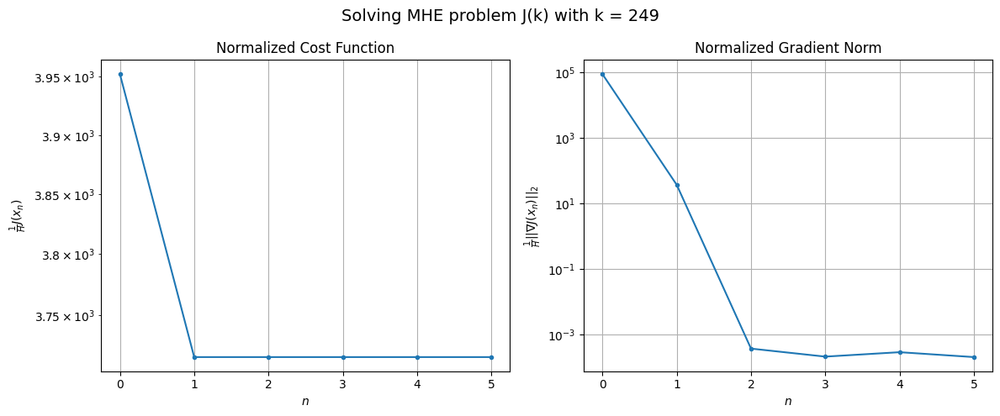

Windows:  60%|██████    | 221/366 [23:24<15:04,  6.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120069.79779992007
Gradient norm: 2498441.480153731
Global estimation error: 67.40157848569869
Initial conditions estimation errors: 14.455466911963544 m, 26.672977066231983 m, 13.445078475510403 m, 58.66671039915351 m
Position estimation errors: 22.352984634712914 m, 18.485618473425795 m, 25.205656683424866 m, 29.62106179219107 m

[Gauss-Newton] Iteration 1
Cost function: 113016.03654385851 (-5.87%)
Gradient norm: 252.88995101590498 (-99.99%)
Global estimation error: 80.15546661234391 (18.92%)
Initial conditions estimation errors: 17.76260075736088 m, 28.98550738098522 m, 17.24747827900543 m, 70.51058223954962 m
Position estimation errors: 18.828811125029393 m, 18.756247317869207 m, 21.292387944107592 m, 36.75296510166945 m

[Gauss-Newton] Iteration 2
Cost function: 113016.03619929946 (-0.00%)
Gradient norm: 0.023211119430707333 (-99.99%)
Global estimation error: 80.09641688312568 (-0.07%)
Initial conditions estimation errors

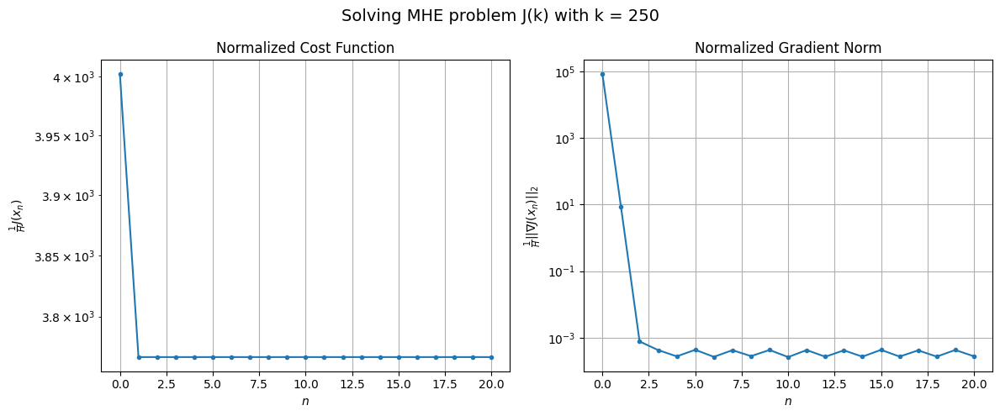

Windows:  61%|██████    | 222/366 [23:40<21:34,  8.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 123457.53606265415
Gradient norm: 2396413.0603285953
Global estimation error: 76.54311225735294
Initial conditions estimation errors: 14.248455937136397 m, 25.69847422518608 m, 14.065534269849806 m, 69.26448513430924 m
Position estimation errors: 22.694968693240803 m, 21.846866043835067 m, 25.377183808275817 m, 36.576992162104226 m

[Gauss-Newton] Iteration 1
Cost function: 116291.33900010333 (-5.80%)
Gradient norm: 249.70576835901824 (-99.99%)
Global estimation error: 54.907290072901205 (-28.27%)
Initial conditions estimation errors: 17.555949299569836 m, 19.761777465547233 m, 20.133557254955036 m, 43.71155610019093 m
Position estimation errors: 19.1402897444625 m, 24.593321291238166 m, 16.663672624459746 m, 42.450189635218806 m

[Gauss-Newton] Iteration 2
Cost function: 116291.33675977783 (-0.00%)
Gradient norm: 0.03342679417308105 (-99.99%)
Global estimation error: 54.63794016745806 (-0.49%)
Initial conditions estimation er

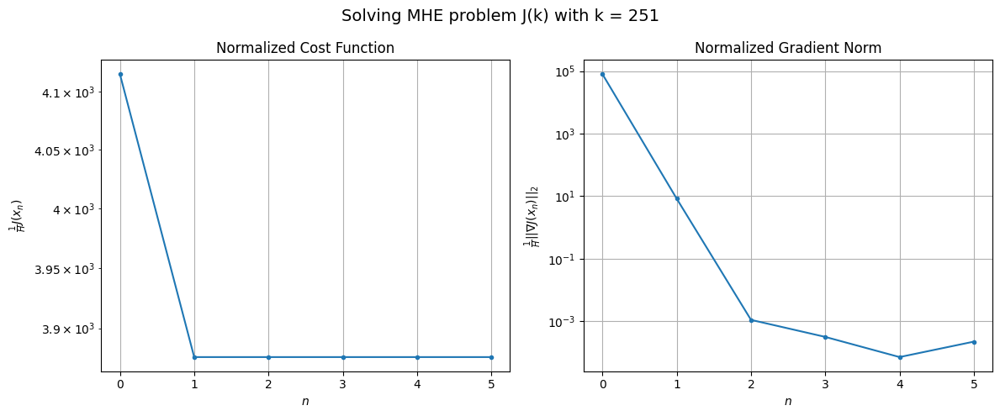

Windows:  61%|██████    | 223/366 [23:44<18:24,  7.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 127109.14209365658
Gradient norm: 2173229.7032888276
Global estimation error: 50.32264507015645
Initial conditions estimation errors: 14.16356845378491 m, 16.749398018162307 m, 16.64907851234793 m, 42.119098953189564 m
Position estimation errors: 22.986385529417475 m, 28.17269694522585 m, 20.561778849917662 m, 44.02172526693807 m

[Gauss-Newton] Iteration 1
Cost function: 120093.27206098227 (-5.52%)
Gradient norm: 697.0146514510125 (-99.97%)
Global estimation error: 45.39423251652881 (-9.79%)
Initial conditions estimation errors: 17.423390117081233 m, 17.23651788696544 m, 22.978883107140096 m, 30.527453362664527 m
Position estimation errors: 19.482332045457234 m, 31.93142580463294 m, 12.984004675475397 m, 68.51379779390065 m

[Gauss-Newton] Iteration 2
Cost function: 120093.27083900364 (-0.00%)
Gradient norm: 0.022504449910866864 (-100.00%)
Global estimation error: 45.3477576875689 (-0.10%)
Initial conditions estimation errors

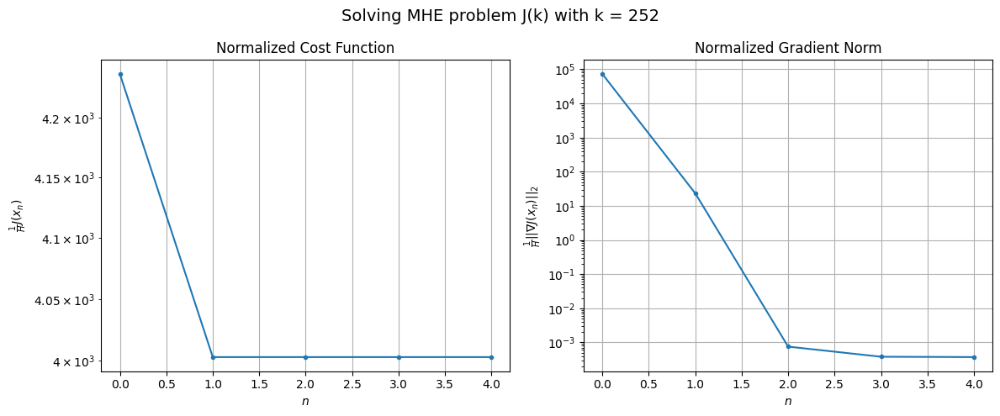

Windows:  61%|██████    | 224/366 [23:49<15:52,  6.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 132230.32043906834
Gradient norm: 2110075.370362078
Global estimation error: 41.67748932503547
Initial conditions estimation errors: 14.154134825907823 m, 14.786568900694826 m, 19.327667572598 m, 30.732130566376224 m
Position estimation errors: 23.302110078818956 m, 35.439926963300344 m, 16.912549805099765 m, 70.0564313930464 m

[Gauss-Newton] Iteration 1
Cost function: 125131.1212693208 (-5.37%)
Gradient norm: 8103.617582732203 (-99.62%)
Global estimation error: 32.40707578281775 (-22.24%)
Initial conditions estimation errors: 17.417722060711593 m, 9.965225330014515 m, 18.892790680555382 m, 17.046438109139395 m
Position estimation errors: 19.794238285169417 m, 20.470326280443892 m, 17.00355209137805 m, 10.15524274964399 m

[Gauss-Newton] Iteration 2
Cost function: 125130.80101882492 (-0.00%)
Gradient norm: 0.03774975578081298 (-100.00%)
Global estimation error: 32.25448821001217 (-0.47%)
Initial conditions estimation errors: 

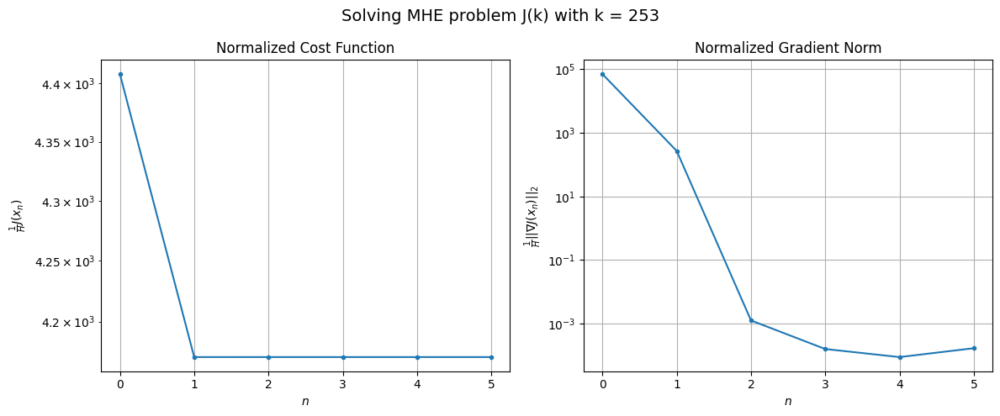

Windows:  61%|██████▏   | 225/366 [23:53<14:21,  6.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 137599.09314567363
Gradient norm: 2235683.7010343354
Global estimation error: 30.599345410772397
Initial conditions estimation errors: 14.251616544146083 m, 6.755875603521427 m, 15.553230648264446 m, 21.11046820574877 m
Position estimation errors: 23.594458843761874 m, 24.851213446678877 m, 20.93075162758013 m, 15.500124328171918 m

[Gauss-Newton] Iteration 1
Cost function: 130514.33731868397 (-5.15%)
Gradient norm: 88.35299638550293 (-100.00%)
Global estimation error: 29.18679887817723 (-4.62%)
Initial conditions estimation errors: 17.49490744024068 m, 9.516728116168467 m, 18.88116767509729 m, 9.9354395902358 m
Position estimation errors: 20.10441943419146 m, 20.241359665311023 m, 17.233346998567193 m, 7.785443943208194 m

[Gauss-Newton] Iteration 2
Cost function: 130514.3372828619 (-0.00%)
Gradient norm: 0.0063255784606887555 (-99.99%)
Global estimation error: 29.187281303539564 (0.00%)
Initial conditions estimation errors: 

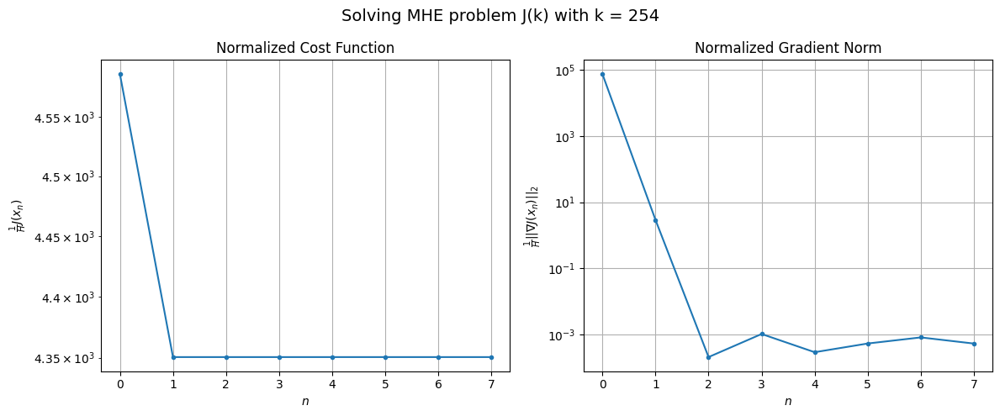

Windows:  62%|██████▏   | 226/366 [24:00<14:28,  6.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 143625.227165005
Gradient norm: 2638495.4197082473
Global estimation error: 26.143027875532148
Initial conditions estimation errors: 14.398053738570036 m, 6.194334237939909 m, 15.64522214992113 m, 13.892281666906499 m
Position estimation errors: 23.925134208064122 m, 24.743552617266214 m, 21.30318119440743 m, 9.607727875520897 m

[Gauss-Newton] Iteration 1
Cost function: 136488.83685789094 (-4.97%)
Gradient norm: 3168.9873401400346 (-99.88%)
Global estimation error: 30.13736297193494 (15.28%)
Initial conditions estimation errors: 17.623396655292773 m, 10.048669362171783 m, 21.900666394896806 m, 4.12935968274191 m
Position estimation errors: 20.42303487351265 m, 31.843026932516384 m, 13.839867059006647 m, 47.849156472382546 m

[Gauss-Newton] Iteration 2
Cost function: 136488.80584196546 (-0.00%)
Gradient norm: 6.5047540954855805 (-99.79%)
Global estimation error: 30.231360804773946 (0.31%)
Initial conditions estimation errors: 

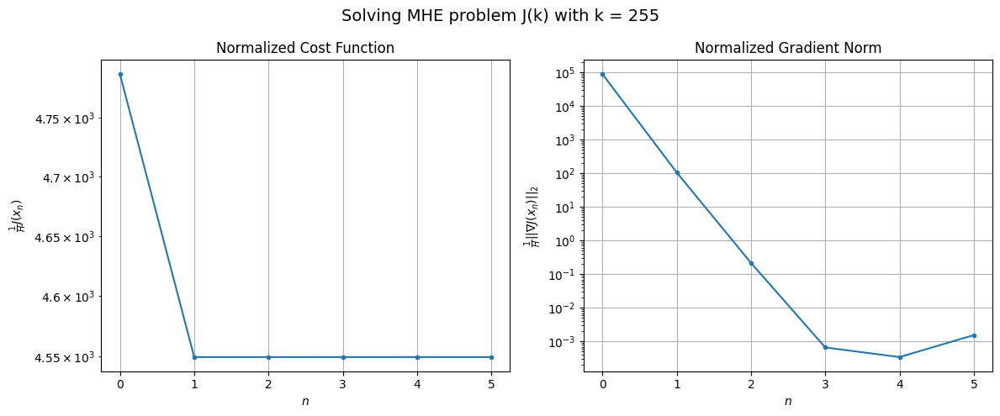

Windows:  62%|██████▏   | 227/366 [24:05<13:37,  5.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 150718.18017517502
Gradient norm: 3237881.0042378735
Global estimation error: 24.981077984230126
Initial conditions estimation errors: 14.55987689651259 m, 7.654345196365214 m, 18.471195626210914 m, 3.504471231229798 m
Position estimation errors: 24.32673638949889 m, 36.4043708087407 m, 18.06242901894402 m, 53.83124361304141 m

[Gauss-Newton] Iteration 1
Cost function: 143393.18295653653 (-4.86%)
Gradient norm: 14114.835816141613 (-99.56%)
Global estimation error: 57.75343361717043 (131.19%)
Initial conditions estimation errors: 17.796827689600264 m, 16.62620169681122 m, 27.01163003973916 m, 44.86260585894628 m
Position estimation errors: 20.771994140044985 m, 53.18593939497701 m, 16.49851644962854 m, 139.37037343747858 m

[Gauss-Newton] Iteration 2
Cost function: 143392.42341416757 (-0.00%)
Gradient norm: 23.4097155101673 (-99.83%)
Global estimation error: 59.22267595525613 (2.54%)
Initial conditions estimation errors: 17.796

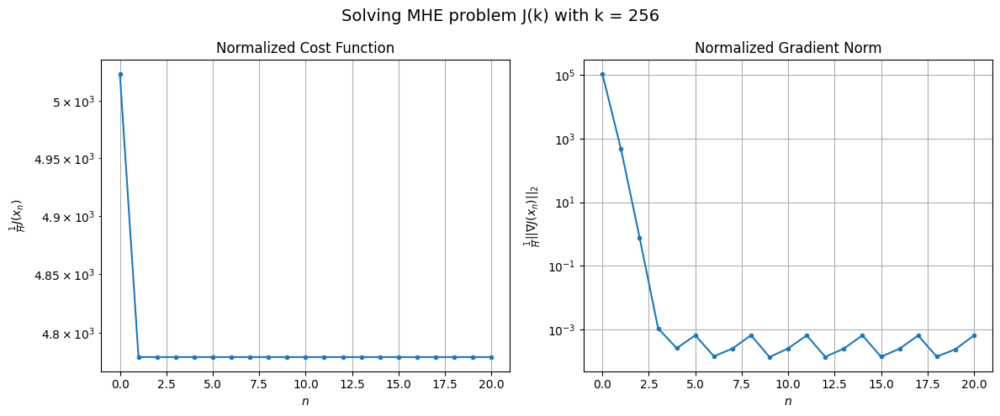

Windows:  62%|██████▏   | 228/366 [24:20<20:03,  8.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 158063.07062657567
Gradient norm: 3989951.570160133
Global estimation error: 61.18238490512632
Initial conditions estimation errors: 14.741196223297408 m, 16.12866049381853 m, 22.781687055484213 m, 52.410131503642795 m
Position estimation errors: 24.805121439156284 m, 56.945224206490714 m, 19.270589521312115 m, 141.37879508421665 m

[Gauss-Newton] Iteration 1
Cost function: 150603.89565857773 (-4.72%)
Gradient norm: 5725.804658602174 (-99.86%)
Global estimation error: 35.925813067050235 (-41.28%)
Initial conditions estimation errors: 17.95492883706798 m, 13.541077634066989 m, 22.56003324992546 m, 16.611995880725722 m
Position estimation errors: 21.17999907733728 m, 40.58864072850384 m, 15.560289897597368 m, 87.29497580619598 m

[Gauss-Newton] Iteration 2
Cost function: 150603.74346814616 (-0.00%)
Gradient norm: 0.1393175465432884 (-100.00%)
Global estimation error: 35.93692543870618 (0.03%)
Initial conditions estimation errors

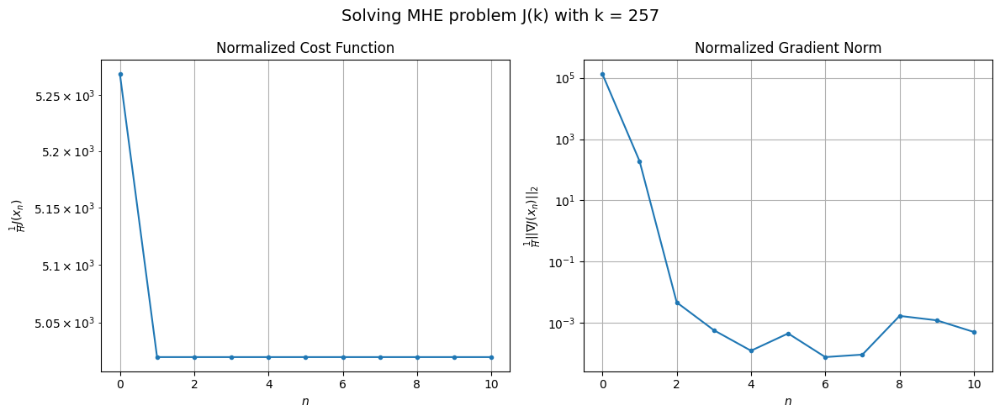

Windows:  63%|██████▎   | 229/366 [24:29<19:40,  8.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 166661.34380942813
Gradient norm: 4722786.216887747
Global estimation error: 32.154466096972506
Initial conditions estimation errors: 14.90296858839526 m, 11.869273391035101 m, 18.57143637049083 m, 18.056123113173662 m
Position estimation errors: 25.330401905814984 m, 44.12946946706029 m, 19.480510131627604 m, 88.71628461596157 m

[Gauss-Newton] Iteration 1
Cost function: 158987.82823436422 (-4.60%)
Gradient norm: 1306.0479578051416 (-99.97%)
Global estimation error: 47.030036158970056 (46.26%)
Initial conditions estimation errors: 18.09495426812355 m, 16.399534937909348 m, 22.73655227588895 m, 33.14343742425491 m
Position estimation errors: 21.59412719828225 m, 46.79657030738021 m, 17.3543805457077 m, 112.59078065587853 m

[Gauss-Newton] Iteration 2
Cost function: 158987.8217951036 (-0.00%)
Gradient norm: 0.49226024154007375 (-99.96%)
Global estimation error: 47.24364532498024 (0.45%)
Initial conditions estimation errors: 18.

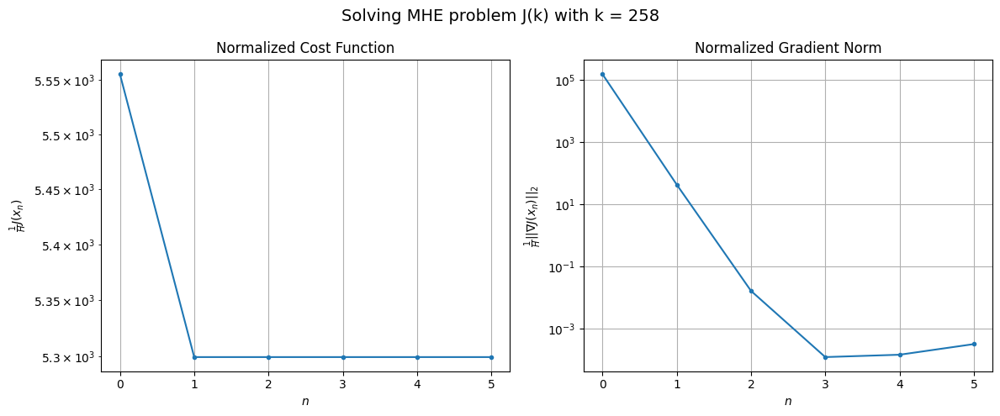

Windows:  63%|██████▎   | 230/366 [24:33<16:47,  7.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 175666.1568329934
Gradient norm: 5537184.093451402
Global estimation error: 46.735558292005074
Initial conditions estimation errors: 15.060842202329566 m, 15.328851233815865 m, 18.450962781291743 m, 37.17470074076309 m
Position estimation errors: 25.79251896739877 m, 50.0807176773233 m, 20.44307300426215 m, 112.8831301795725 m

[Gauss-Newton] Iteration 1
Cost function: 167600.02793878035 (-4.59%)
Gradient norm: 1711.3957296305027 (-99.97%)
Global estimation error: 69.27074011969638 (48.22%)
Initial conditions estimation errors: 18.263270908238294 m, 20.854365088369118 m, 22.689763197612475 m, 59.28859358741231 m
Position estimation errors: 21.88816985388846 m, 54.21260384219724 m, 20.477541561472346 m, 137.77623913176495 m

[Gauss-Newton] Iteration 2
Cost function: 167600.0153751165 (-0.00%)
Gradient norm: 0.7161533604505699 (-99.96%)
Global estimation error: 69.59233146043441 (0.46%)
Initial conditions estimation errors: 18.2

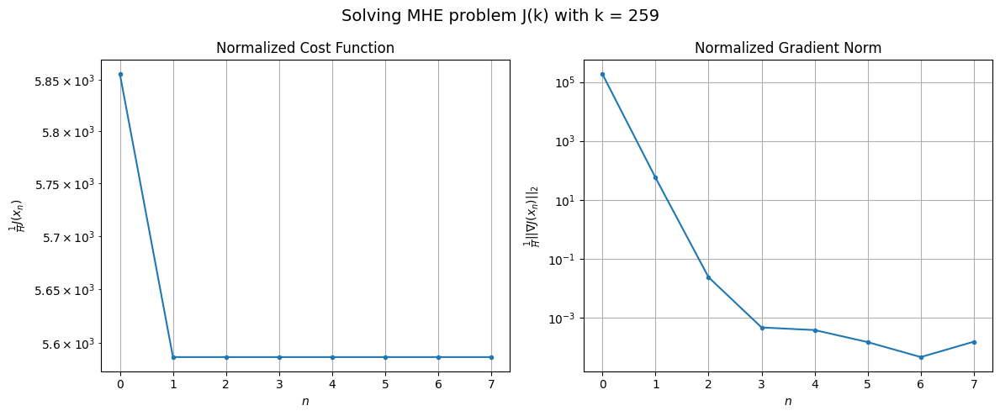

Windows:  63%|██████▎   | 231/366 [24:40<16:05,  7.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 184878.12099406472
Gradient norm: 6167796.986846319
Global estimation error: 72.80557284162772
Initial conditions estimation errors: 15.270669563785878 m, 20.458394431604606 m, 17.977746161696583 m, 65.76999808802947 m
Position estimation errors: 26.0230749471829 m, 56.780659377918646 m, 22.100554294524063 m, 135.5978002071496 m

[Gauss-Newton] Iteration 1
Cost function: 176623.3427968472 (-4.46%)
Gradient norm: 219.04294623242055 (-100.00%)
Global estimation error: 72.64642127977199 (-0.22%)
Initial conditions estimation errors: 18.433625491471126 m, 23.68490892633561 m, 20.8113018029312 m, 62.798098034734004 m
Position estimation errors: 21.984346772434172 m, 47.293098771228955 m, 19.51666710875199 m, 123.14009640056288 m

[Gauss-Newton] Iteration 2
Cost function: 176623.34260128305 (-0.00%)
Gradient norm: 0.054223123591174274 (-99.98%)
Global estimation error: 72.51509558546364 (-0.18%)
Initial conditions estimation errors:

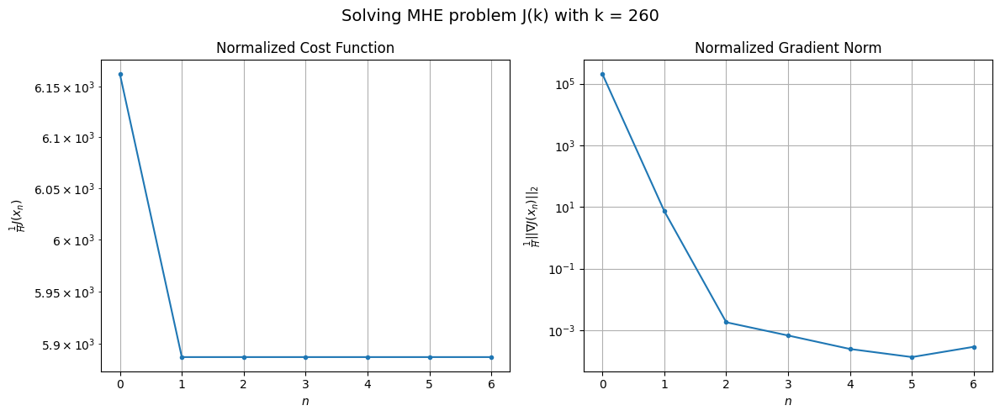

Windows:  63%|██████▎   | 232/366 [24:46<15:04,  6.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 193186.57508964665
Gradient norm: 6658706.42289004
Global estimation error: 75.01226333444609
Initial conditions estimation errors: 15.498524245526552 m, 22.813567878619672 m, 16.34685382396942 m, 67.81548843788359 m
Position estimation errors: 25.936875781295818 m, 49.535191547573554 m, 20.97803622862664 m, 120.36144915875366 m

[Gauss-Newton] Iteration 1
Cost function: 184812.20184561 (-4.33%)
Gradient norm: 1329.7254487555647 (-99.98%)
Global estimation error: 80.29146798786975 (7.04%)
Initial conditions estimation errors: 18.622893249562253 m, 26.155864169545193 m, 19.273609346947318 m, 71.02320144698326 m
Position estimation errors: 21.781962616805988 m, 38.162363573631374 m, 17.699137186559664 m, 84.19541886932504 m

[Gauss-Newton] Iteration 2
Cost function: 184812.19652231375 (-0.00%)
Gradient norm: 0.020643829632051927 (-100.00%)
Global estimation error: 80.24484488039157 (-0.06%)
Initial conditions estimation errors: 

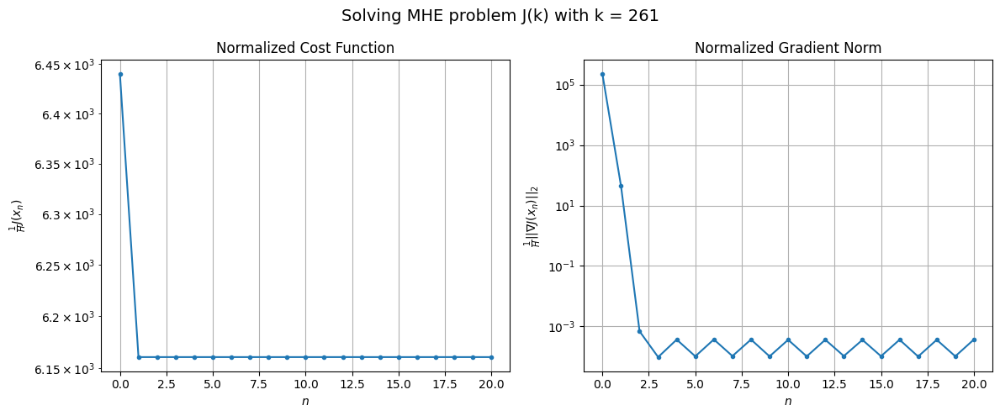

Windows:  64%|██████▎   | 233/366 [25:01<20:39,  9.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 199938.3646996809
Gradient norm: 6905555.244909773
Global estimation error: 80.73975223856652
Initial conditions estimation errors: 15.73940752559329 m, 24.708460017152373 m, 15.26783474006629 m, 73.67193272258366 m
Position estimation errors: 25.444655685826046 m, 40.39848831755872 m, 19.457887092130008 m, 82.10273620452139 m

[Gauss-Newton] Iteration 1
Cost function: 191489.15428611566 (-4.23%)
Gradient norm: 1694.0904376945196 (-99.98%)
Global estimation error: 70.27462201942197 (-12.96%)
Initial conditions estimation errors: 18.85335370958215 m, 25.77937991570614 m, 18.539337548877384 m, 59.7894757263589 m
Position estimation errors: 21.20399998129493 m, 29.42426405868657 m, 16.54480494830045 m, 49.90187114729976 m

[Gauss-Newton] Iteration 2
Cost function: 191489.1422163758 (-0.00%)
Gradient norm: 0.04567442973036007 (-100.00%)
Global estimation error: 70.24092245615796 (-0.05%)
Initial conditions estimation errors: 18.85

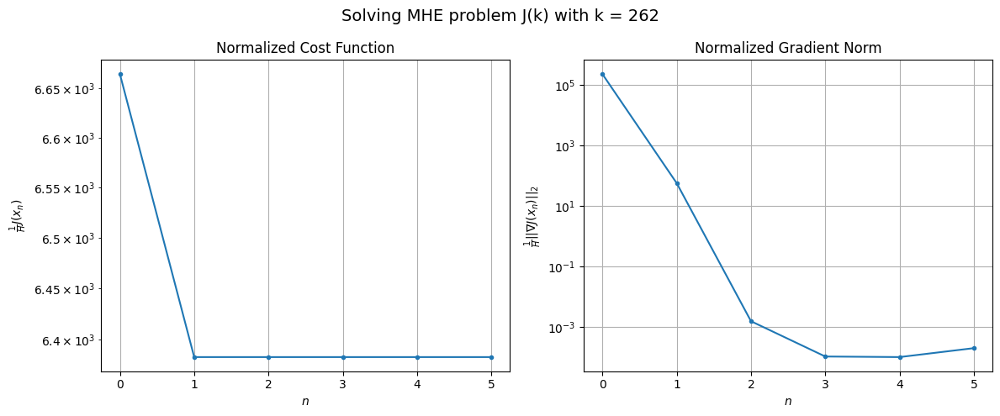

Windows:  64%|██████▍   | 234/366 [25:06<17:23,  7.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 203776.09916772752
Gradient norm: 6869571.433471249
Global estimation error: 67.94585083903387
Initial conditions estimation errors: 15.995997038262463 m, 23.709152042913814 m, 15.013794334400089 m, 59.77642404522605 m
Position estimation errors: 24.50870600120585 m, 31.875357803411916 m, 18.758910756310364 m, 49.77557917231622 m

[Gauss-Newton] Iteration 1
Cost function: 195576.46604188872 (-4.02%)
Gradient norm: 53.41836249845608 (-100.00%)
Global estimation error: 62.8015176477969 (-7.57%)
Initial conditions estimation errors: 19.07630195011822 m, 27.221351845428607 m, 18.35068531366278 m, 50.023665022261426 m
Position estimation errors: 20.299553469095812 m, 27.579945909751093 m, 15.412248721812597 m, 47.87923376347053 m

[Gauss-Newton] Iteration 2
Cost function: 195576.4658995971 (-0.00%)
Gradient norm: 0.020198433853676586 (-99.96%)
Global estimation error: 62.76598089358376 (-0.06%)
Initial conditions estimation errors:

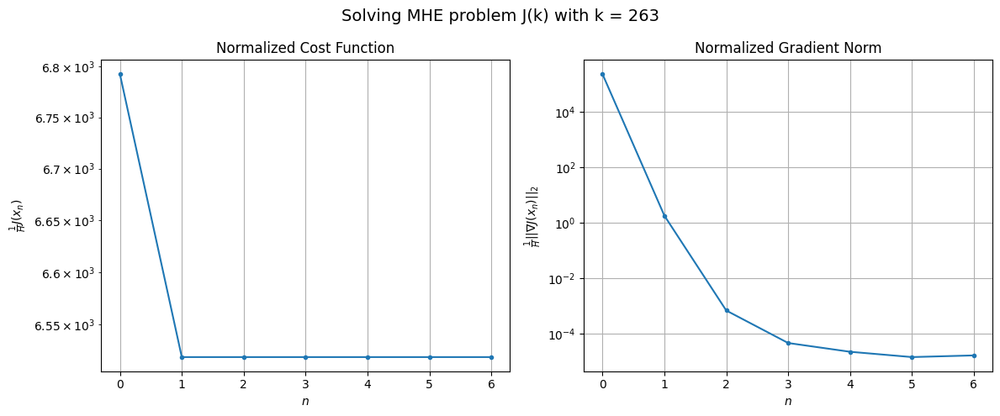

Windows:  64%|██████▍   | 235/366 [25:11<15:41,  7.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 204339.98973125144
Gradient norm: 6570836.857525925
Global estimation error: 59.780477064078816
Initial conditions estimation errors: 16.198002527667658 m, 24.998236782412953 m, 14.865510480211988 m, 49.65306365876635 m
Position estimation errors: 23.221221586264647 m, 29.847254879748863 m, 17.218372167046216 m, 48.3706826685044 m

[Gauss-Newton] Iteration 1
Cost function: 196468.312306763 (-3.85%)
Gradient norm: 4645.808005900539 (-99.93%)
Global estimation error: 37.213513149286655 (-37.75%)
Initial conditions estimation errors: 19.274435546521314 m, 22.28810735413782 m, 19.08602845436354 m, 12.34063702068734 m
Position estimation errors: 19.106150975039814 m, 16.544433090974245 m, 19.093706653228907 m, 14.196312029214168 m

[Gauss-Newton] Iteration 2
Cost function: 196468.19761456604 (-0.00%)
Gradient norm: 0.03463908719939517 (-100.00%)
Global estimation error: 37.21592569443178 (0.01%)
Initial conditions estimation errors

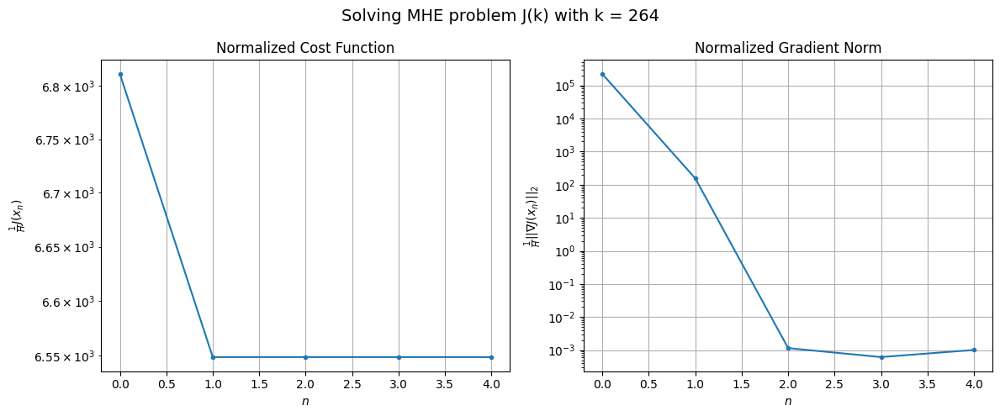

Windows:  64%|██████▍   | 236/366 [25:15<13:44,  6.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 201756.6996005094
Gradient norm: 6069583.638727303
Global estimation error: 31.125388316198862
Initial conditions estimation errors: 16.311113978003917 m, 18.99987326370429 m, 16.16103219354304 m, 8.97493144842118 m
Position estimation errors: 21.644514685862738 m, 19.008608587016784 m, 21.66645517478115 m, 15.818863912083268 m

[Gauss-Newton] Iteration 1
Cost function: 194519.79001841263 (-3.59%)
Gradient norm: 112.76014562575159 (-100.00%)
Global estimation error: 39.6988382543537 (27.54%)
Initial conditions estimation errors: 19.34348933865861 m, 21.797134119135745 m, 18.718863188751147 m, 19.3984435903511 m
Position estimation errors: 17.733136741656512 m, 14.086597245160325 m, 18.89924229196155 m, 18.401998411256905 m

[Gauss-Newton] Iteration 2
Cost function: 194519.78995434032 (-0.00%)
Gradient norm: 0.011202134612619197 (-99.99%)
Global estimation error: 39.71530504203635 (0.04%)
Initial conditions estimation errors: 1

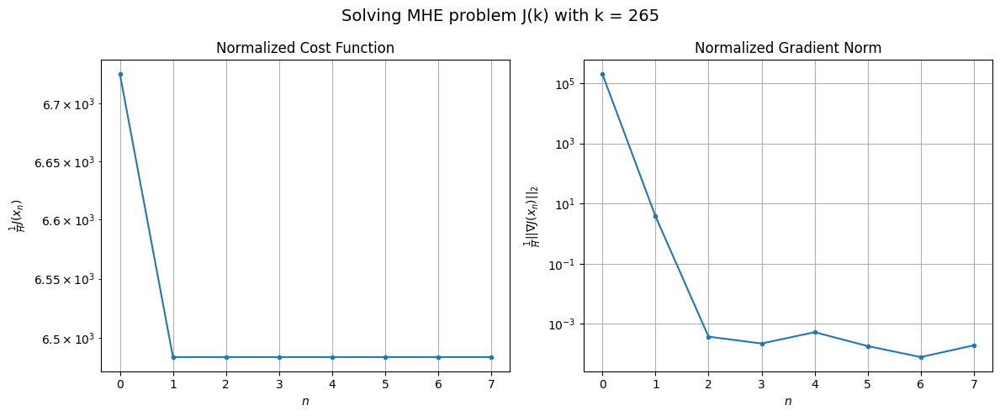

Windows:  65%|██████▍   | 237/366 [25:22<13:36,  6.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 195775.92631322177
Gradient norm: 5501420.718220778
Global estimation error: 32.542281461857684
Initial conditions estimation errors: 16.223456938698043 m, 18.21745098825986 m, 15.739710311241133 m, 14.70267689848385 m
Position estimation errors: 19.911880352753453 m, 15.98837226855271 m, 21.159549096656782 m, 17.52148114769021 m

[Gauss-Newton] Iteration 1
Cost function: 189008.81930522784 (-3.46%)
Gradient norm: 8.225448269559232 (-100.00%)
Global estimation error: 40.965520240010726 (25.88%)
Initial conditions estimation errors: 19.292353437086913 m, 21.26319212790491 m, 20.588206849178146 m, 20.73555156574115 m
Position estimation errors: 16.22315844463926 m, 13.566673288303946 m, 16.499112324418803 m, 19.651613161595453 m

[Gauss-Newton] Iteration 2
Cost function: 189008.81929076833 (-0.00%)
Gradient norm: 0.019012588813362322 (-99.77%)
Global estimation error: 40.97800233542161 (0.03%)
Initial conditions estimation error

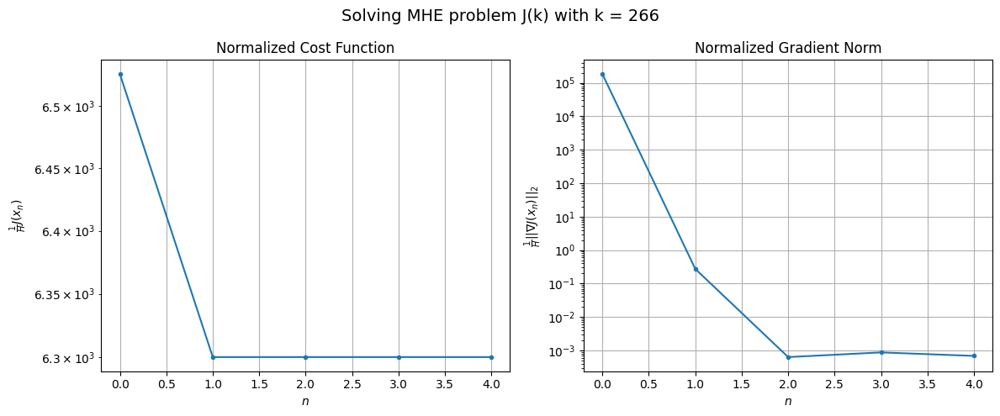

Windows:  65%|██████▌   | 238/366 [25:26<12:20,  5.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 186713.11428854114
Gradient norm: 4808084.158802643
Global estimation error: 33.299316826766045
Initial conditions estimation errors: 15.969010485080764 m, 17.5390931736133 m, 17.260693250297315 m, 15.756434625104855 m
Position estimation errors: 18.106913386996084 m, 15.207655159834594 m, 18.411519060230024 m, 18.280586521826784 m

[Gauss-Newton] Iteration 1
Cost function: 180506.54727373764 (-3.32%)
Gradient norm: 2934.6194973458582 (-99.94%)
Global estimation error: 33.9854335953237 (2.06%)
Initial conditions estimation errors: 19.03729115876419 m, 19.77944349463735 m, 16.601021001682017 m, 11.213322854742902 m
Position estimation errors: 14.679077388252061 m, 15.054391474287497 m, 28.57984766823527 m, 57.770381502256264 m

[Gauss-Newton] Iteration 2
Cost function: 180506.5207771827 (-0.00%)
Gradient norm: 0.9952050968092573 (-99.97%)
Global estimation error: 33.9615851964098 (-0.07%)
Initial conditions estimation errors: 1

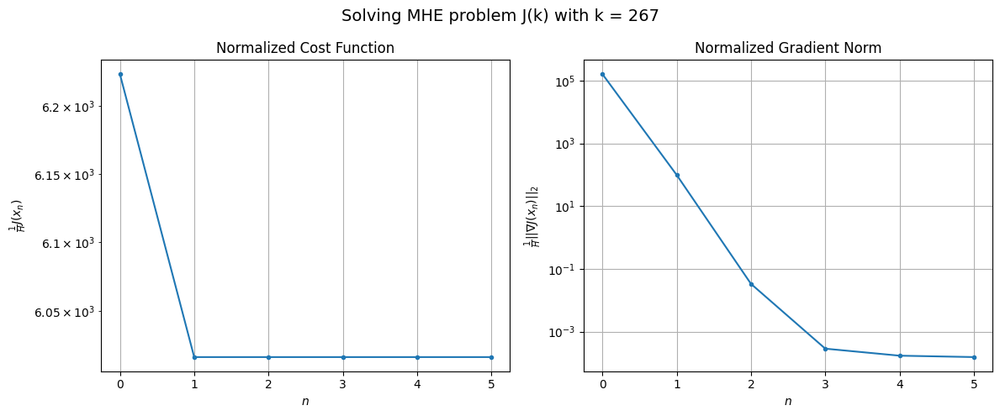

Windows:  65%|██████▌   | 239/366 [25:31<11:38,  5.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 175878.12557648795
Gradient norm: 4100279.2405584794
Global estimation error: 26.290888615086374
Initial conditions estimation errors: 15.520791404411893 m, 15.014896303665397 m, 13.907213768573575 m, 5.605920917808308 m
Position estimation errors: 16.357316519634796 m, 13.987222280769043 m, 30.30180583681045 m, 52.92222900865134 m

[Gauss-Newton] Iteration 1
Cost function: 170250.94122970797 (-3.20%)
Gradient norm: 5724.963353987209 (-99.86%)
Global estimation error: 34.10778359162995 (29.73%)
Initial conditions estimation errors: 18.58222157286164 m, 24.579257019598153 m, 12.96906212067284 m, 6.7560572680953666 m
Position estimation errors: 13.231793547057407 m, 35.636260302892424 m, 50.39315981872954 m, 115.79419676981294 m

[Gauss-Newton] Iteration 2
Cost function: 170250.84940890718 (-0.00%)
Gradient norm: 7.646762008027804 (-99.87%)
Global estimation error: 33.82849362736493 (-0.82%)
Initial conditions estimation errors:

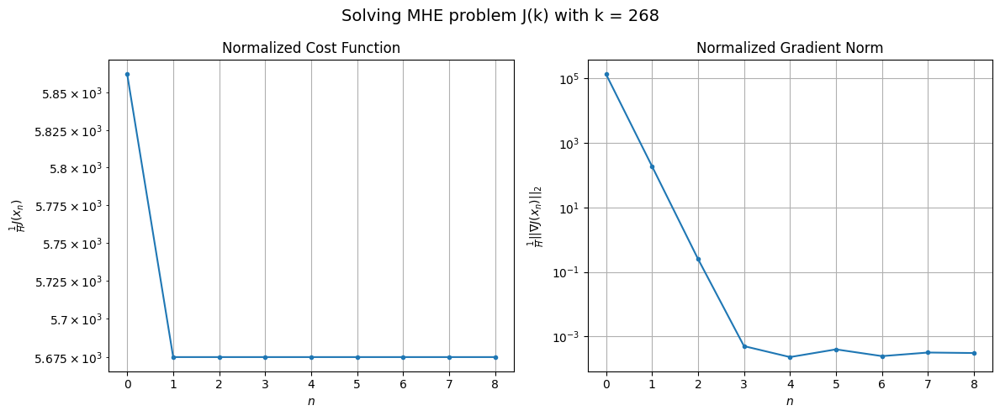

Windows:  66%|██████▌   | 240/366 [25:38<12:33,  5.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 163974.6620771848
Gradient norm: 3384791.5327531556
Global estimation error: 26.660243528566994
Initial conditions estimation errors: 14.935042063163403 m, 17.914909415906333 m, 10.858756865783237 m, 6.9855522693125245 m
Position estimation errors: 14.797067734304466 m, 32.417573809124605 m, 51.45547799848874 m, 107.82235229755086 m

[Gauss-Newton] Iteration 1
Cost function: 158963.09218541151 (-3.06%)
Gradient norm: 1269.885961512229 (-99.96%)
Global estimation error: 50.12887924662925 (88.03%)
Initial conditions estimation errors: 17.947986881641953 m, 29.873129291782558 m, 12.388194777171247 m, 33.835697228641635 m
Position estimation errors: 11.99755649752261 m, 32.54981778570946 m, 42.96894148611818 m, 99.11071625978505 m

[Gauss-Newton] Iteration 2
Cost function: 158963.07520383614 (-0.00%)
Gradient norm: 0.038468072759385775 (-100.00%)
Global estimation error: 50.123383448138405 (-0.01%)
Initial conditions estimation er

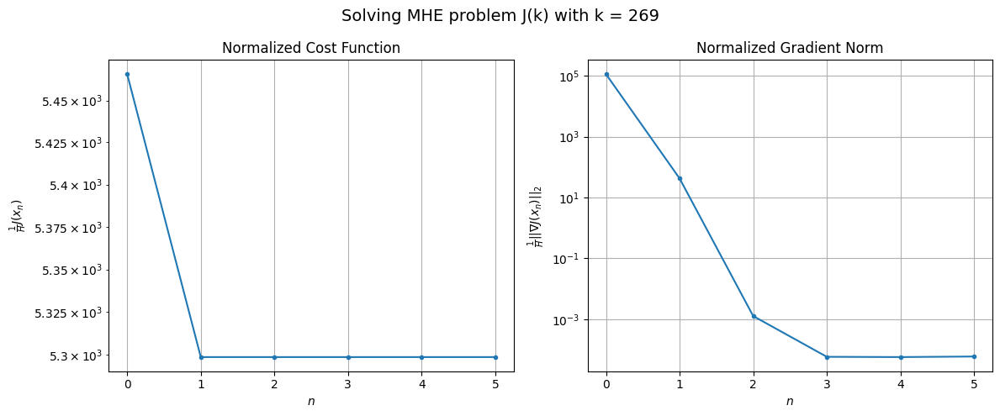

Windows:  66%|██████▌   | 241/366 [25:43<11:42,  5.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 151864.1988665565
Gradient norm: 2643627.450888546
Global estimation error: 37.481717234217555
Initial conditions estimation errors: 14.25077946589462 m, 23.670896966216855 m, 9.983128571017922 m, 23.276013362595698 m
Position estimation errors: 13.512527903554398 m, 30.590031696438334 m, 44.789381983499375 m, 95.5780289155051 m

[Gauss-Newton] Iteration 1
Cost function: 147361.7193498789 (-2.96%)
Gradient norm: 1102.5661388435935 (-99.96%)
Global estimation error: 47.1670243945102 (25.84%)
Initial conditions estimation errors: 17.221948716197215 m, 31.310742535052576 m, 12.534347274487782 m, 28.117556812471566 m
Position estimation errors: 11.029537074659627 m, 44.19159229314828 m, 53.9618441517097 m, 124.69764101454666 m

[Gauss-Newton] Iteration 2
Cost function: 147361.7155960783 (-0.00%)
Gradient norm: 1.6152405128109038 (-99.85%)
Global estimation error: 46.773184131248065 (-0.83%)
Initial conditions estimation errors: 17

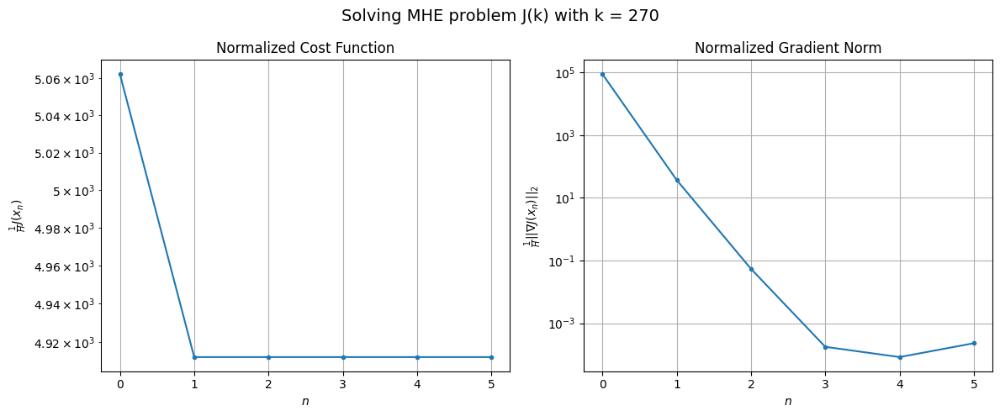

Windows:  66%|██████▌   | 242/366 [25:48<11:02,  5.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 140208.66091284633
Gradient norm: 1943592.11980521
Global estimation error: 33.40867540728994
Initial conditions estimation errors: 13.549091257213037 m, 24.223359186370352 m, 10.136532393935438 m, 15.587845463023465 m
Position estimation errors: 12.542409933875588 m, 41.63673726448752 m, 55.355832896081075 m, 119.28049808723785 m

[Gauss-Newton] Iteration 1
Cost function: 136164.6188879448 (-2.88%)
Gradient norm: 408.9398492372227 (-99.98%)
Global estimation error: 48.808360598969166 (46.09%)
Initial conditions estimation errors: 16.454734594941062 m, 30.987359638751798 m, 12.064015766473087 m, 31.71254664190555 m
Position estimation errors: 10.35425668778709 m, 40.675573867875066 m, 46.70407134902449 m, 112.55377954314753 m

[Gauss-Newton] Iteration 2
Cost function: 136164.61796355134 (-0.00%)
Gradient norm: 0.027821683471568305 (-99.99%)
Global estimation error: 48.890853897615 (0.17%)
Initial conditions estimation errors: 

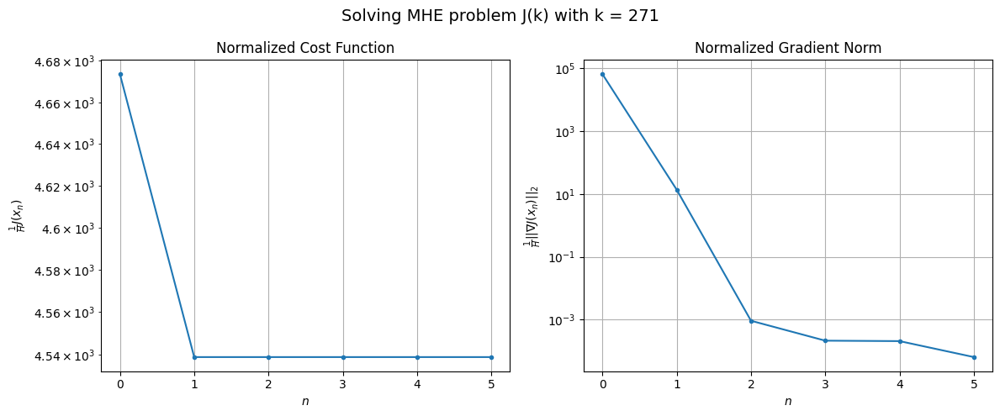

Windows:  66%|██████▋   | 243/366 [25:52<10:29,  5.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 129669.810260814
Gradient norm: 1478794.7197882063
Global estimation error: 35.854867208507194
Initial conditions estimation errors: 12.876190096877574 m, 24.52432456453978 m, 9.624268300244156 m, 20.63137680761774 m
Position estimation errors: 11.914462995935382 m, 38.74965812128497 m, 48.521866376353486 m, 108.98335939203679 m

[Gauss-Newton] Iteration 1
Cost function: 126029.53183218016 (-2.81%)
Gradient norm: 1836.697649714617 (-99.88%)
Global estimation error: 47.813793623503926 (33.35%)
Initial conditions estimation errors: 15.706691017822045 m, 28.369305497948766 m, 11.622754613959309 m, 33.158923700283545 m
Position estimation errors: 10.001257836556919 m, 29.245726126534777 m, 36.46027163876319 m, 80.05156530300329 m

[Gauss-Newton] Iteration 2
Cost function: 126029.51984846914 (-0.00%)
Gradient norm: 0.046701823759456355 (-100.00%)
Global estimation error: 47.81772650228296 (0.01%)
Initial conditions estimation error

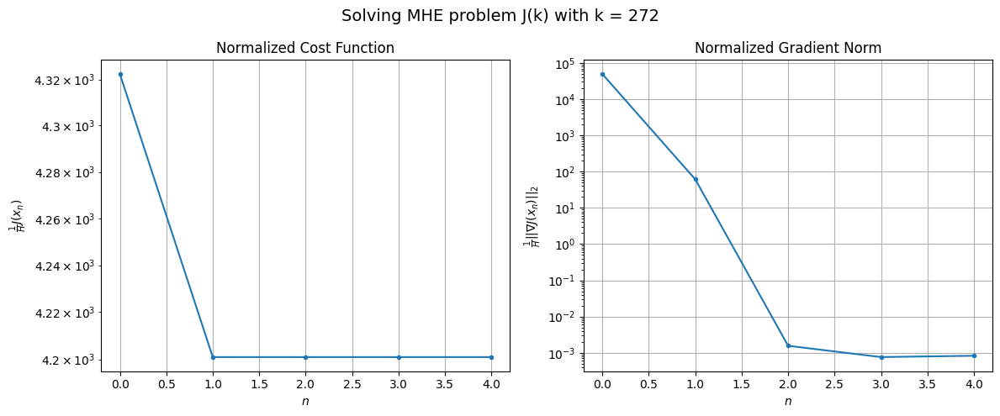

Windows:  67%|██████▋   | 244/366 [25:57<10:00,  4.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120212.22341991664
Gradient norm: 1148577.8581265316
Global estimation error: 36.728895318522554
Initial conditions estimation errors: 12.281138667841029 m, 22.786373862161017 m, 9.097663591910097 m, 24.416456025437864 m
Position estimation errors: 11.660018755692574 m, 27.502215615660443 m, 38.33813489555696 m, 77.46424824140855 m

[Gauss-Newton] Iteration 1
Cost function: 116876.44544778502 (-2.77%)
Gradient norm: 533.9928170185515 (-99.95%)
Global estimation error: 32.216622612857556 (-12.29%)
Initial conditions estimation errors: 15.02797716894022 m, 18.585113760083566 m, 15.464114709707692 m, 15.082930945860843 m
Position estimation errors: 9.947920005907541 m, 20.966569308358114 m, 26.81838592274422 m, 56.5588777089002 m

[Gauss-Newton] Iteration 2
Cost function: 116876.44364501198 (-0.00%)
Gradient norm: 1.7797627830269318 (-99.67%)
Global estimation error: 32.41839732342401 (0.63%)
Initial conditions estimation errors:

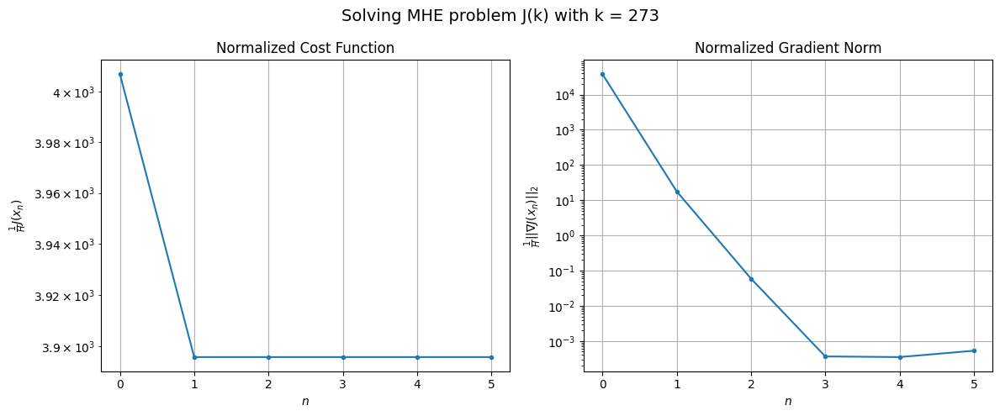

Windows:  67%|██████▋   | 245/366 [26:02<09:57,  4.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 112456.90257150431
Gradient norm: 1198920.8835110313
Global estimation error: 24.28573901749893
Initial conditions estimation errors: 11.786215819267644 m, 13.959567097180566 m, 13.068333498521577 m, 9.230577826044014 m
Position estimation errors: 11.726593257165378 m, 19.37599483206216 m, 28.58329326935409 m, 54.33304920603013 m

[Gauss-Newton] Iteration 1
Cost function: 109418.80362108645 (-2.70%)
Gradient norm: 665.083105860186 (-99.94%)
Global estimation error: 36.94118426944576 (52.11%)
Initial conditions estimation errors: 14.419319845118679 m, 19.844894908728815 m, 14.762160918387462 m, 23.344582860865028 m
Position estimation errors: 10.168952808869667 m, 16.113374497920937 m, 20.896542014511027 m, 41.51995281047135 m

[Gauss-Newton] Iteration 2
Cost function: 109418.80134868665 (-0.00%)
Gradient norm: 0.08576115927970053 (-99.99%)
Global estimation error: 37.03208106313641 (0.25%)
Initial conditions estimation errors:

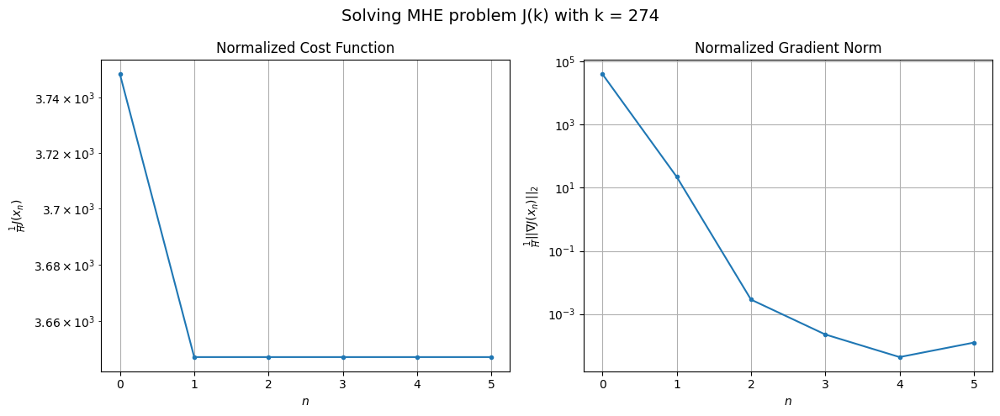

Windows:  67%|██████▋   | 246/366 [26:06<09:44,  4.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 106582.94913023894
Gradient norm: 1561386.8019244217
Global estimation error: 28.9945302025271
Initial conditions estimation errors: 11.363260113791132 m, 15.55933301637958 m, 12.598743785182174 m, 17.627155591639582 m
Position estimation errors: 12.072638228610828 m, 14.646523403481199 m, 22.34478872028938 m, 39.54585129308806 m

[Gauss-Newton] Iteration 1
Cost function: 103645.35050341969 (-2.76%)
Gradient norm: 1780.4730085426797 (-99.89%)
Global estimation error: 54.071150529777526 (86.49%)
Initial conditions estimation errors: 13.90999380442217 m, 23.196809756736158 m, 11.492652992260606 m, 45.387344275650086 m
Position estimation errors: 10.545397032142823 m, 7.964051206870924 m, 9.915192589874078 m, 22.875681345454822 m

[Gauss-Newton] Iteration 2
Cost function: 103645.33210139215 (-0.00%)
Gradient norm: 0.012553078964049516 (-100.00%)
Global estimation error: 54.21969336697322 (0.27%)
Initial conditions estimation erro

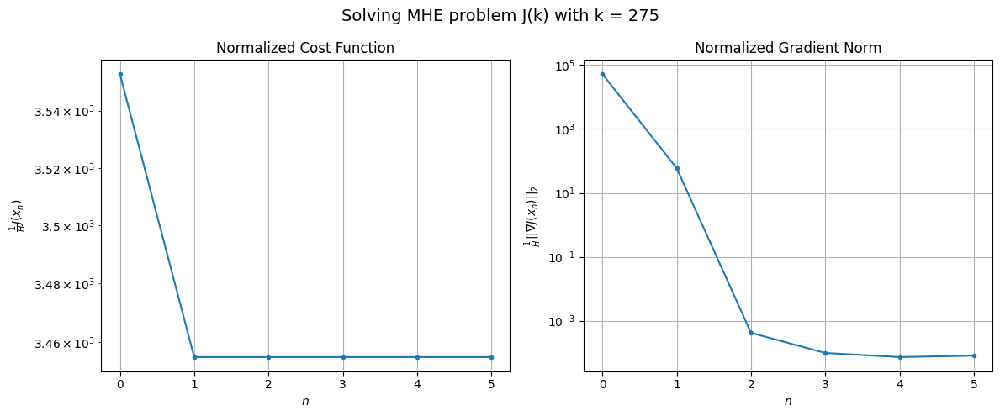

Windows:  67%|██████▋   | 247/366 [26:11<09:35,  4.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 101886.37197635508
Gradient norm: 1961730.0722871306
Global estimation error: 48.27430076057478
Initial conditions estimation errors: 11.020775227031065 m, 19.763566030153182 m, 8.470828221660772 m, 41.79211847980682 m
Position estimation errors: 12.585021086918093 m, 7.854396070386945 m, 11.94816783992631 m, 22.89259025592523 m

[Gauss-Newton] Iteration 1
Cost function: 99105.74531246567 (-2.73%)
Gradient norm: 121.79519753960929 (-99.99%)
Global estimation error: 37.361221479447075 (-22.61%)
Initial conditions estimation errors: 13.439087086190773 m, 19.050674820939243 m, 11.554402297386144 m, 26.810460701126225 m
Position estimation errors: 11.072983139396223 m, 7.451666531789216 m, 10.930313257573054 m, 22.591875369017977 m

[Gauss-Newton] Iteration 2
Cost function: 99105.7449597709 (-0.00%)
Gradient norm: 0.020739339415909577 (-99.98%)
Global estimation error: 37.26028871508733 (-0.27%)
Initial conditions estimation error

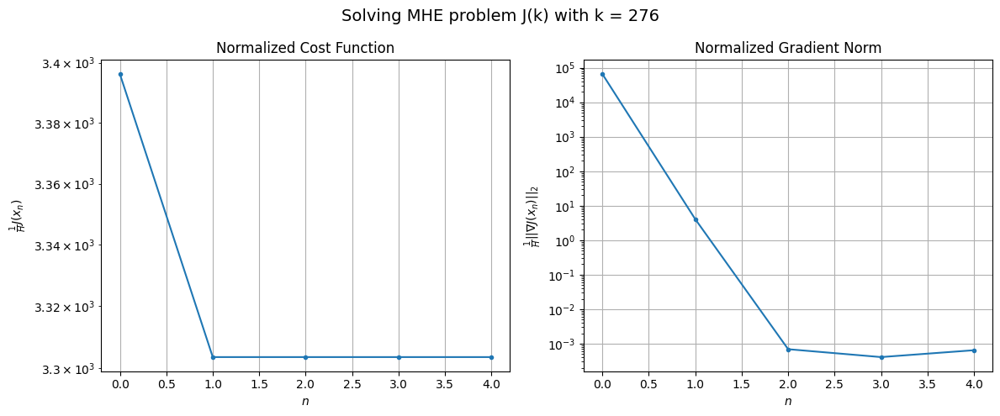

Windows:  68%|██████▊   | 248/366 [26:16<09:13,  4.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 99152.19586597713
Gradient norm: 2466956.9937517913
Global estimation error: 30.63895562705851
Initial conditions estimation errors: 10.718074505692194 m, 15.488247263148015 m, 8.729365158847342 m, 22.533610952294527 m
Position estimation errors: 13.269366552829164 m, 7.570362473169449 m, 12.996973558741509 m, 21.318839300883617 m

[Gauss-Newton] Iteration 1
Cost function: 96456.25883797067 (-2.72%)
Gradient norm: 433.5350856338684 (-99.98%)
Global estimation error: 28.54330845575866 (-6.84%)
Initial conditions estimation errors: 12.979054856233473 m, 18.522376396044756 m, 12.205015533229108 m, 12.41778120840879 m
Position estimation errors: 11.692860218573598 m, 10.403665450480162 m, 15.443753937115405 m, 29.751112765187276 m

[Gauss-Newton] Iteration 2
Cost function: 96456.25685735399 (-0.00%)
Gradient norm: 0.009025664240995244 (-100.00%)
Global estimation error: 28.533360031381818 (-0.03%)
Initial conditions estimation err

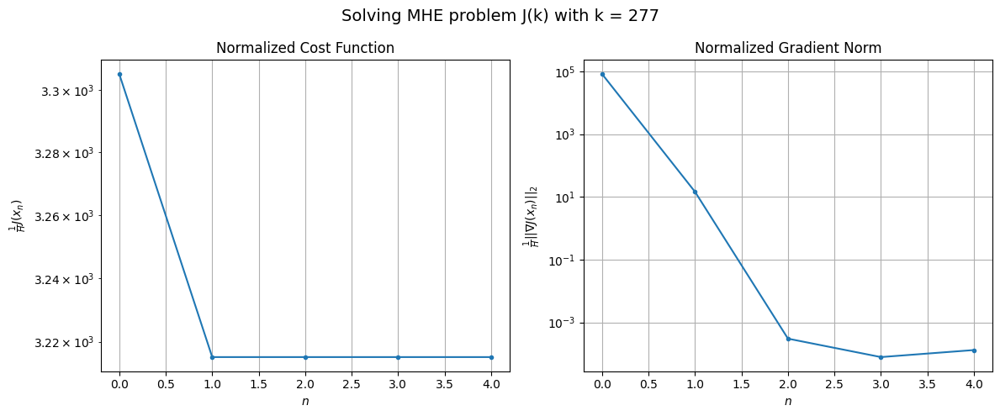

Windows:  68%|██████▊   | 249/366 [26:20<08:54,  4.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 97942.71893851271
Gradient norm: 2957909.3127867347
Global estimation error: 22.846550030906954
Initial conditions estimation errors: 10.445362364047535 m, 14.616602814318929 m, 9.46093402957294 m, 10.473020874279362 m
Position estimation errors: 14.045787572357554 m, 9.683869881026897 m, 17.546424019291614 m, 27.14625631668089 m

[Gauss-Newton] Iteration 1
Cost function: 95310.03124384973 (-2.69%)
Gradient norm: 351.00173064509215 (-99.99%)
Global estimation error: 34.43683205939882 (50.73%)
Initial conditions estimation errors: 12.535201633890752 m, 10.898733418390401 m, 20.61683567612452 m, 22.02065000405205 m
Position estimation errors: 12.366674812589807 m, 7.79015469197041 m, 8.196615823474188 m, 12.368952636168743 m

[Gauss-Newton] Iteration 2
Cost function: 95310.0278438528 (-0.00%)
Gradient norm: 0.8846906955901931 (-99.75%)
Global estimation error: 33.824711987561564 (-1.78%)
Initial conditions estimation errors: 12.

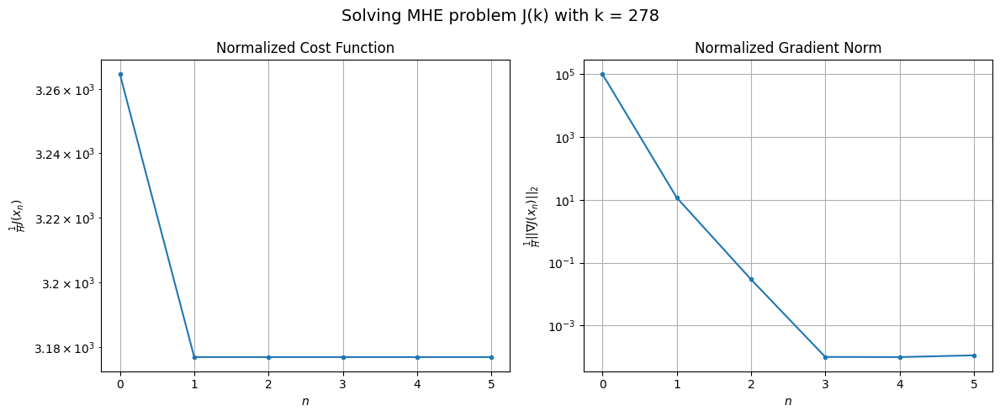

Windows:  68%|██████▊   | 250/366 [26:25<08:56,  4.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 98492.10151995759
Gradient norm: 3500396.0872981744
Global estimation error: 32.565113444891026
Initial conditions estimation errors: 10.2365978629467 m, 9.149923245275934 m, 18.334605922421318 m, 23.147410655665986 m
Position estimation errors: 14.858790582575907 m, 9.716516505467494 m, 10.509290456122537 m, 12.193051755404031 m

[Gauss-Newton] Iteration 1
Cost function: 95824.73697074431 (-2.71%)
Gradient norm: 970.9447236710139 (-99.97%)
Global estimation error: 38.53753886027718 (18.34%)
Initial conditions estimation errors: 12.153740129613206 m, 10.724251504764487 m, 27.022410995034345 m, 22.185421064500673 m
Position estimation errors: 13.017668370006744 m, 15.98458916255963 m, 12.987857580523205 m, 17.825563756741477 m

[Gauss-Newton] Iteration 2
Cost function: 95824.73400267282 (-0.00%)
Gradient norm: 0.2657216713552258 (-99.97%)
Global estimation error: 37.94523839509022 (-1.54%)
Initial conditions estimation errors: 

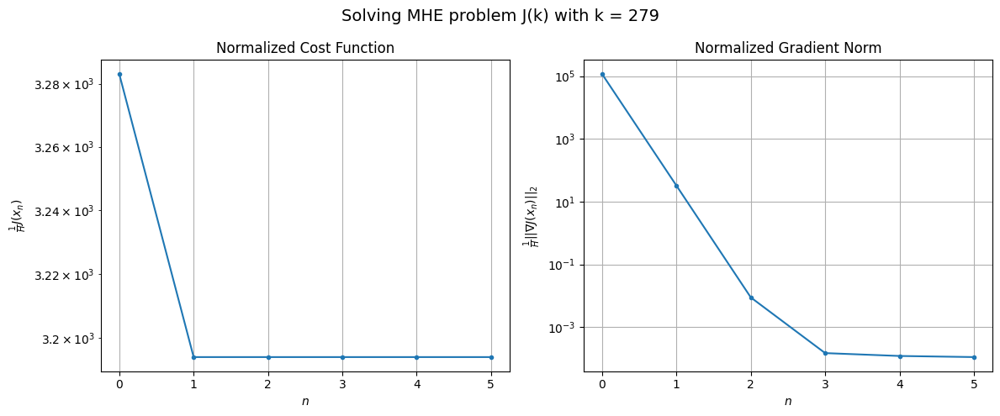

Windows:  69%|██████▊   | 251/366 [26:30<09:01,  4.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 100919.1295092299
Gradient norm: 4117668.170310895
Global estimation error: 36.018824289048716
Initial conditions estimation errors: 10.123803076887254 m, 10.33529322249746 m, 24.474012252468437 m, 22.114586371290912 m
Position estimation errors: 15.62015865285109 m, 18.86693735081574 m, 14.361345473111703 m, 21.340531828018786 m

[Gauss-Newton] Iteration 1
Cost function: 98206.6086780901 (-2.69%)
Gradient norm: 642.5218052639202 (-99.98%)
Global estimation error: 45.073219023483404 (25.14%)
Initial conditions estimation errors: 11.841823539712479 m, 11.970788928217418 m, 32.18959370317757 m, 26.681126612918884 m
Position estimation errors: 13.57077273591919 m, 23.93471274119954 m, 23.64825139130509 m, 38.68464720317124 m

[Gauss-Newton] Iteration 2
Cost function: 98206.60742762535 (-0.00%)
Gradient norm: 0.06512451205519279 (-99.99%)
Global estimation error: 44.62749395837548 (-0.99%)
Initial conditions estimation errors: 11.

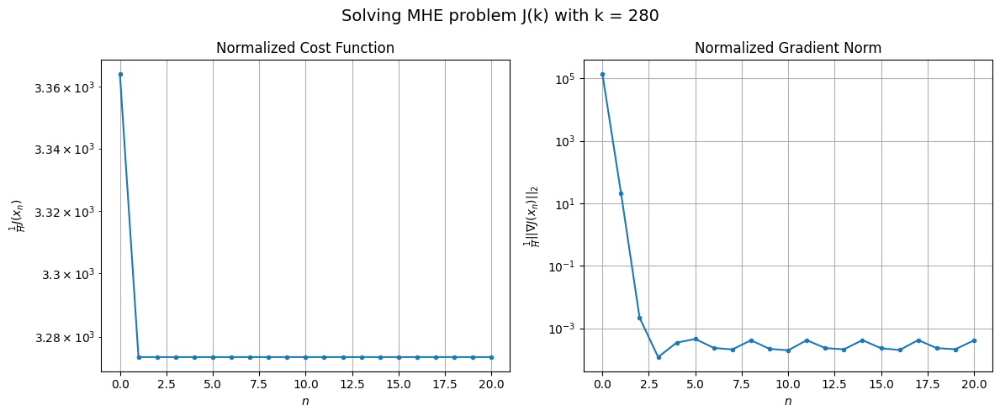

Windows:  69%|██████▉   | 252/366 [26:46<15:41,  8.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 104149.4439714212
Gradient norm: 4481550.20507258
Global estimation error: 42.03400695139246
Initial conditions estimation errors: 10.102298282452752 m, 12.011966213397463 m, 29.134337370241717 m, 25.917016271106966 m
Position estimation errors: 16.27542110424119 m, 27.10932366966607 m, 24.86782711511337 m, 42.036337139105214 m

[Gauss-Newton] Iteration 1
Cost function: 101299.88947778159 (-2.74%)
Gradient norm: 327.94712747653966 (-99.99%)
Global estimation error: 77.28433491043283 (83.86%)
Initial conditions estimation errors: 11.748311745598594 m, 22.370232545066198 m, 44.32766949410097 m, 58.04707062696244 m
Position estimation errors: 14.037330599011248 m, 31.877674862498 m, 33.65891667606838 m, 58.17015710389306 m

[Gauss-Newton] Iteration 2
Cost function: 101299.8846001893 (-0.00%)
Gradient norm: 0.21320079976013265 (-99.93%)
Global estimation error: 76.7481953451939 (-0.69%)
Initial conditions estimation errors: 11.748

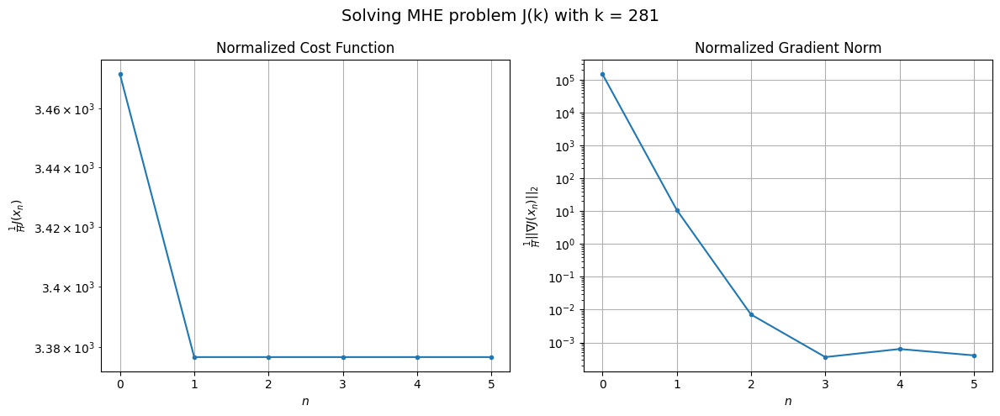

Windows:  69%|██████▉   | 253/366 [26:51<13:53,  7.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 108670.60044421043
Gradient norm: 4914900.78726025
Global estimation error: 74.19488838245854
Initial conditions estimation errors: 10.262086490805984 m, 22.418684131206774 m, 40.91341035182413 m, 56.7719485488006 m
Position estimation errors: 16.858946895488454 m, 35.381087543052544 m, 35.6471835466676 m, 62.7358126391033 m

[Gauss-Newton] Iteration 1
Cost function: 105689.99145319012 (-2.74%)
Gradient norm: 75.70002806402229 (-100.00%)
Global estimation error: 86.89961346734918 (17.12%)
Initial conditions estimation errors: 11.839279250498882 m, 25.254433284902003 m, 47.915327451799605 m, 66.91559967466206 m
Position estimation errors: 14.420466982282921 m, 33.00633485728265 m, 34.67954897530215 m, 65.0862102934288 m

[Gauss-Newton] Iteration 2
Cost function: 105689.99129417626 (-0.00%)
Gradient norm: 0.003664330595173776 (-100.00%)
Global estimation error: 86.8828313066186 (-0.02%)
Initial conditions estimation errors: 11.8

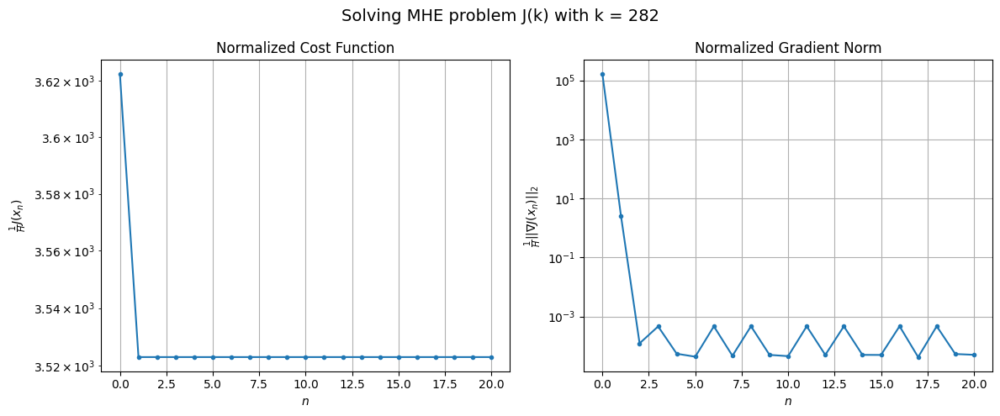

Windows:  69%|██████▉   | 254/366 [27:07<18:23,  9.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 113879.26509377875
Gradient norm: 5347155.638580857
Global estimation error: 84.34081323125987
Initial conditions estimation errors: 10.512969233217847 m, 25.685428679885298 m, 44.66656207932544 m, 65.93933777752093 m
Position estimation errors: 17.323427461366705 m, 36.890861402571666 m, 37.38032131445973 m, 70.33899870756649 m

[Gauss-Newton] Iteration 1
Cost function: 110581.17009399459 (-2.90%)
Gradient norm: 736.2311746352965 (-99.99%)
Global estimation error: 32.76815002619746 (-61.15%)
Initial conditions estimation errors: 12.159909094879014 m, 8.914120236682708 m, 18.33102266755069 m, 22.591820868410473 m
Position estimation errors: 14.65450608465314 m, 24.59837318129416 m, 21.002544486431265 m, 44.89917886535788 m

[Gauss-Newton] Iteration 2
Cost function: 110581.1432041296 (-0.00%)
Gradient norm: 0.7225526832317791 (-99.90%)
Global estimation error: 32.26946471399822 (-1.52%)
Initial conditions estimation errors: 12.

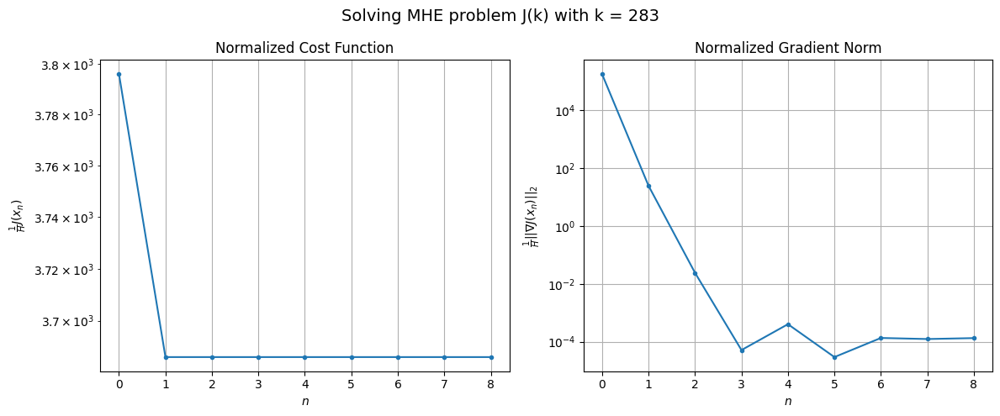

Windows:  70%|██████▉   | 255/366 [27:14<16:42,  9.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 118615.5742846617
Gradient norm: 5627303.294767899
Global estimation error: 30.031693531203445
Initial conditions estimation errors: 10.87641737453568 m, 8.75112281720936 m, 15.273425675253625 m, 21.76551041348616 m
Position estimation errors: 17.57660811000536 m, 27.072287506201345 m, 22.57317213281208 m, 46.83859926528867 m

[Gauss-Newton] Iteration 1
Cost function: 115093.64951392496 (-2.97%)
Gradient norm: 1305.681665193898 (-99.98%)
Global estimation error: 26.232366961447042 (-12.65%)
Initial conditions estimation errors: 12.646533722392334 m, 14.594823133626674 m, 7.261122780030443 m, 16.20064382208717 m
Position estimation errors: 14.754573918465343 m, 13.16031484649486 m, 12.276309588887123 m, 13.973414365345855 m

[Gauss-Newton] Iteration 2
Cost function: 115093.64218197601 (-0.00%)
Gradient norm: 0.49444958533787026 (-99.96%)
Global estimation error: 25.737746912919786 (-1.89%)
Initial conditions estimation errors: 

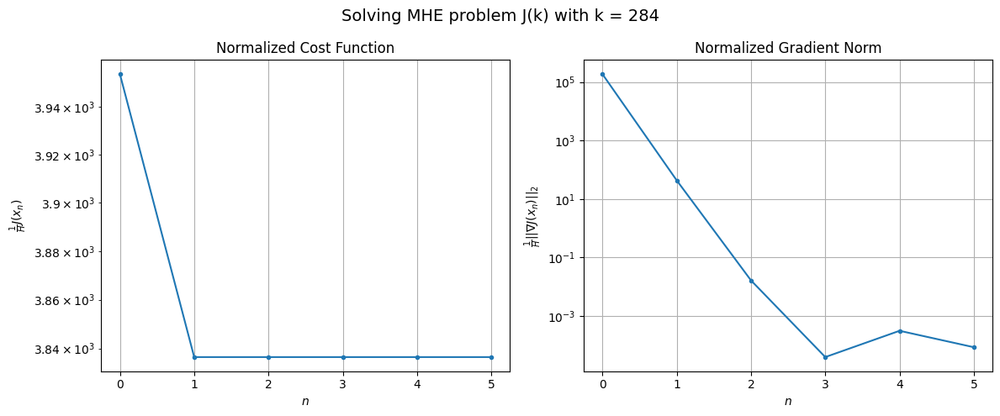

Windows:  70%|██████▉   | 256/366 [27:19<14:14,  7.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 122996.63454553798
Gradient norm: 5943760.832601571
Global estimation error: 23.338341804492167
Initial conditions estimation errors: 11.294281639914285 m, 12.838493168492509 m, 7.22102382107001 m, 14.147053090543245 m
Position estimation errors: 17.686395454945846 m, 16.07203212441661 m, 15.456405555245718 m, 16.533517989461487 m

[Gauss-Newton] Iteration 1
Cost function: 119104.79434106528 (-3.16%)
Gradient norm: 1575.458572206078 (-99.97%)
Global estimation error: 89.00443641700168 (281.37%)
Initial conditions estimation errors: 13.293231873954763 m, 37.097092041197996 m, 28.363486273196834 m, 74.59483597791456 m
Position estimation errors: 14.690539041223975 m, 12.756161347302163 m, 10.858371036885154 m, 16.89332544700184 m

[Gauss-Newton] Iteration 2
Cost function: 119104.70249120357 (-0.00%)
Gradient norm: 0.19762081870752268 (-99.99%)
Global estimation error: 88.15544398490384 (-0.95%)
Initial conditions estimation erro

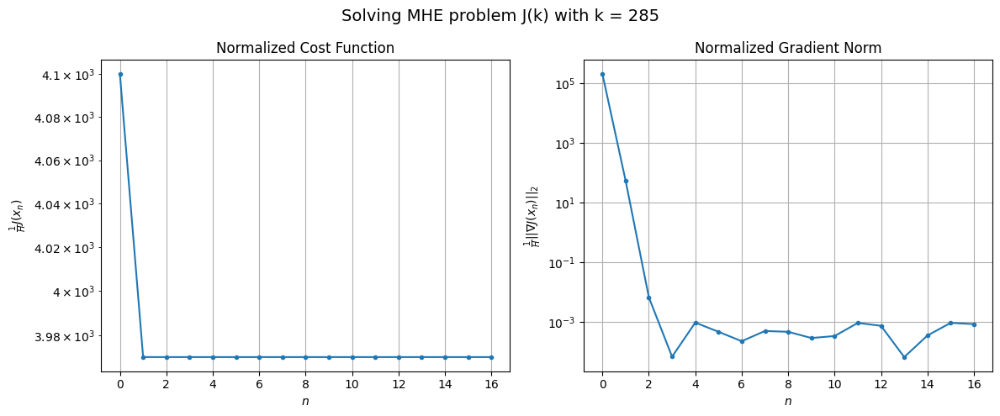

Windows:  70%|███████   | 257/366 [27:32<16:52,  9.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 125797.87451350258
Gradient norm: 6101692.304520054
Global estimation error: 86.98103579415877
Initial conditions estimation errors: 11.77079260281949 m, 35.27919795486111 m, 30.869715000081612 m, 72.31582916884435 m
Position estimation errors: 17.713249705767474 m, 15.946667361232969 m, 14.405787127158739 m, 21.539446972947328 m

[Gauss-Newton] Iteration 1
Cost function: 121494.35984225516 (-3.42%)
Gradient norm: 314.260560590805 (-99.99%)
Global estimation error: 59.506519004259786 (-31.59%)
Initial conditions estimation errors: 14.084198199368588 m, 26.220604727014425 m, 18.422010155860892 m, 48.122368308248426 m
Position estimation errors: 14.592070153947098 m, 13.498750891039391 m, 13.117499667335691 m, 13.096129997954606 m

[Gauss-Newton] Iteration 2
Cost function: 121494.35634610422 (-0.00%)
Gradient norm: 0.06832781898289228 (-99.98%)
Global estimation error: 59.846420433146456 (0.57%)
Initial conditions estimation err

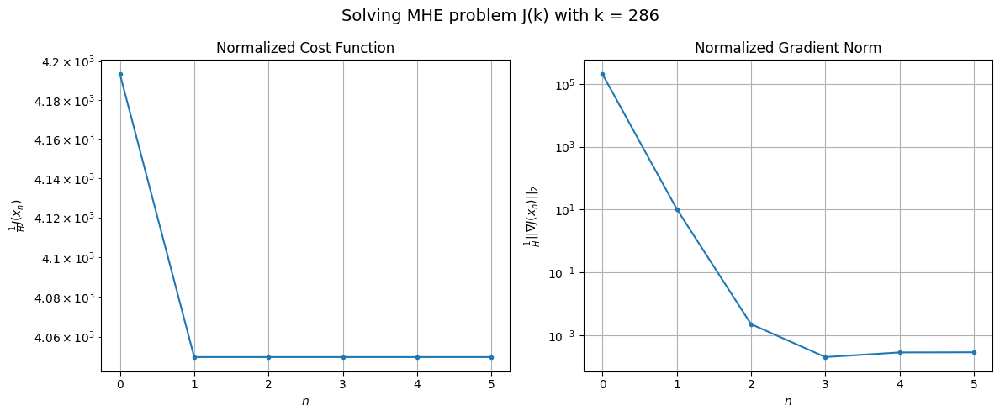

Windows:  70%|███████   | 258/366 [27:37<14:21,  7.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 127605.56843918047
Gradient norm: 6358201.305419363
Global estimation error: 57.80245501889902
Initial conditions estimation errors: 12.276417291789533 m, 24.497220747674675 m, 20.339444551363506 m, 46.65401611695148 m
Position estimation errors: 17.808567859618908 m, 16.919017957634086 m, 16.837472208189062 m, 17.130854957766445 m

[Gauss-Newton] Iteration 1
Cost function: 122778.58843954683 (-3.78%)
Gradient norm: 2245.4675678536246 (-99.96%)
Global estimation error: 28.839821345272313 (-50.11%)
Initial conditions estimation errors: 14.915402565645124 m, 15.400669707267697 m, 13.994101955175708 m, 13.2755110319897 m
Position estimation errors: 14.52819691965329 m, 15.18851166463847 m, 27.534524272761168 m, 20.0450175962568 m

[Gauss-Newton] Iteration 2
Cost function: 122778.5492021829 (-0.00%)
Gradient norm: 0.14608752001129383 (-99.99%)
Global estimation error: 28.472034162200522 (-1.28%)
Initial conditions estimation error

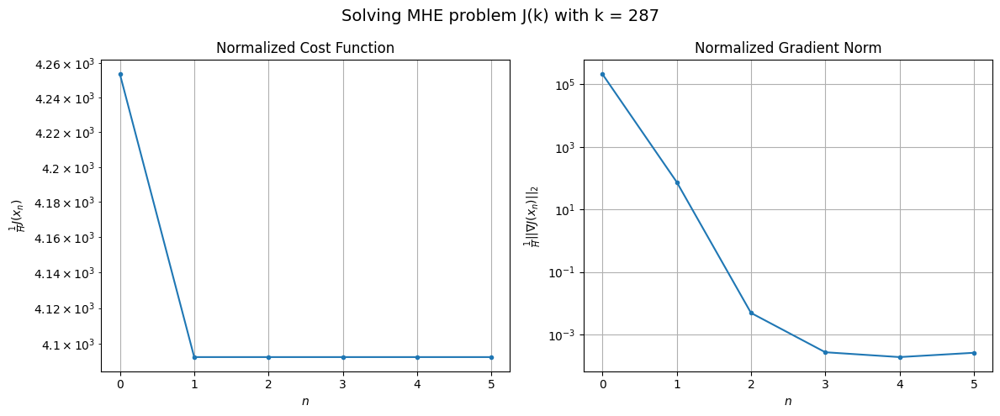

Windows:  71%|███████   | 259/366 [27:42<12:37,  7.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 127797.99665939191
Gradient norm: 6588982.445225048
Global estimation error: 24.17653561251734
Initial conditions estimation errors: 12.70974665477393 m, 12.458704264776717 m, 12.980299544536017 m, 9.962266167056484 m
Position estimation errors: 17.954132252199646 m, 17.926704835561203 m, 29.33796214205695 m, 21.747669728213577 m

[Gauss-Newton] Iteration 1
Cost function: 122413.29572873442 (-4.21%)
Gradient norm: 1624.2235029129206 (-99.98%)
Global estimation error: 86.4067218472751 (257.40%)
Initial conditions estimation errors: 15.664237622188805 m, 35.78180234165208 m, 39.42731149692109 m, 66.22604716293063 m
Position estimation errors: 14.525658728364007 m, 17.71282534679169 m, 27.59612381297017 m, 36.32057499648372 m

[Gauss-Newton] Iteration 2
Cost function: 122413.20123955952 (-0.00%)
Gradient norm: 0.14756465142915862 (-99.99%)
Global estimation error: 86.09574609818836 (-0.36%)
Initial conditions estimation errors: 1

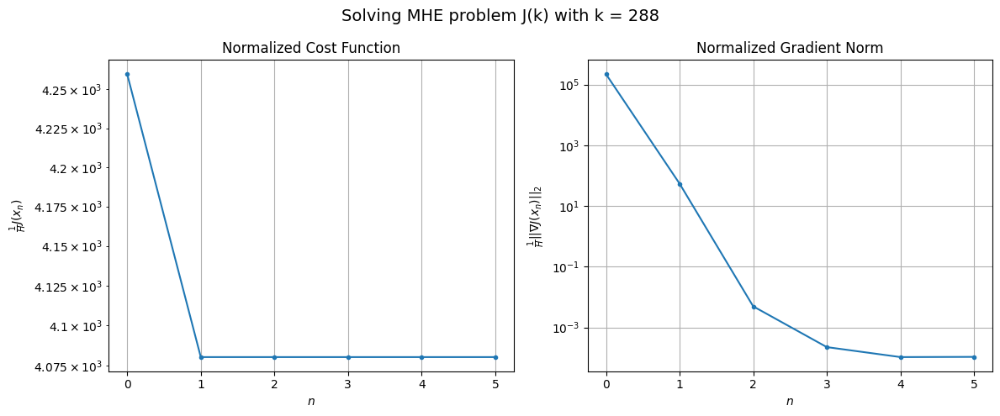

Windows:  71%|███████   | 260/366 [27:47<11:29,  6.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 126459.03451151113
Gradient norm: 6789054.194501384
Global estimation error: 82.23276311487878
Initial conditions estimation errors: 12.98052203511205 m, 32.987454560021135 m, 40.066438729124464 m, 62.4517869570226 m
Position estimation errors: 18.124142163994982 m, 21.437154323776685 m, 30.787575401599852 m, 41.297891775570925 m

[Gauss-Newton] Iteration 1
Cost function: 120545.44468547807 (-4.68%)
Gradient norm: 651.622086392113 (-99.99%)
Global estimation error: 43.468669283692925 (-47.14%)
Initial conditions estimation errors: 16.20427446959477 m, 19.855824077112114 m, 22.166091661204295 m, 27.22758767747937 m
Position estimation errors: 14.557817296916665 m, 13.331445526677191 m, 20.408685744068478 m, 17.035458505617534 m

[Gauss-Newton] Iteration 2
Cost function: 120545.43509228983 (-0.00%)
Gradient norm: 0.48157610335769113 (-99.93%)
Global estimation error: 42.582403216316045 (-2.04%)
Initial conditions estimation erro

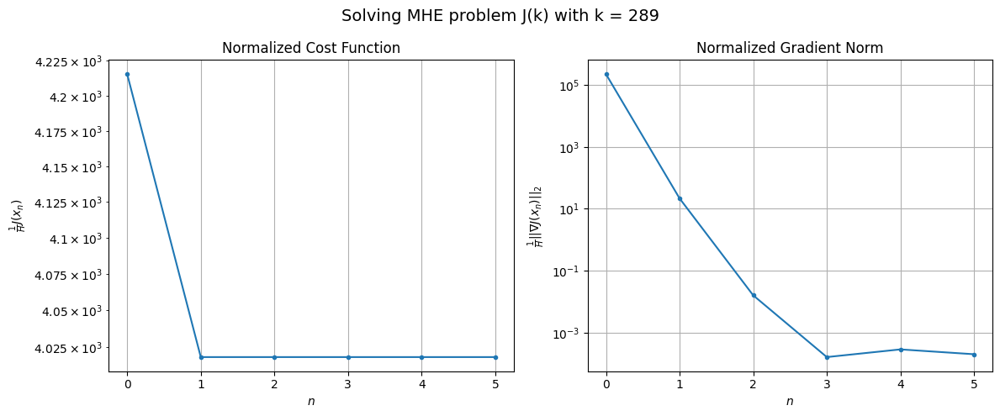

Windows:  71%|███████▏  | 261/366 [27:52<10:33,  6.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 123823.70525189779
Gradient norm: 6893518.935880787
Global estimation error: 38.02189351892987
Initial conditions estimation errors: 13.047044858781952 m, 16.422393587936615 m, 21.80306641629965 m, 23.029401595515584 m
Position estimation errors: 18.31103061846266 m, 17.064374559409558 m, 22.9751034247236 m, 20.840918710862315 m

[Gauss-Newton] Iteration 1
Cost function: 117577.27411916105 (-5.04%)
Gradient norm: 154.33092826781063 (-100.00%)
Global estimation error: 34.25027541404312 (-9.92%)
Initial conditions estimation errors: 16.44123656135585 m, 18.650587590462774 m, 14.094810194093329 m, 18.87425803125644 m
Position estimation errors: 14.66441870017559 m, 18.44009854229308 m, 14.903257024990971 m, 19.514038215062214 m

[Gauss-Newton] Iteration 2
Cost function: 117577.27317377093 (-0.00%)
Gradient norm: 0.5104968294446223 (-99.67%)
Global estimation error: 34.74565273350223 (1.45%)
Initial conditions estimation errors: 1

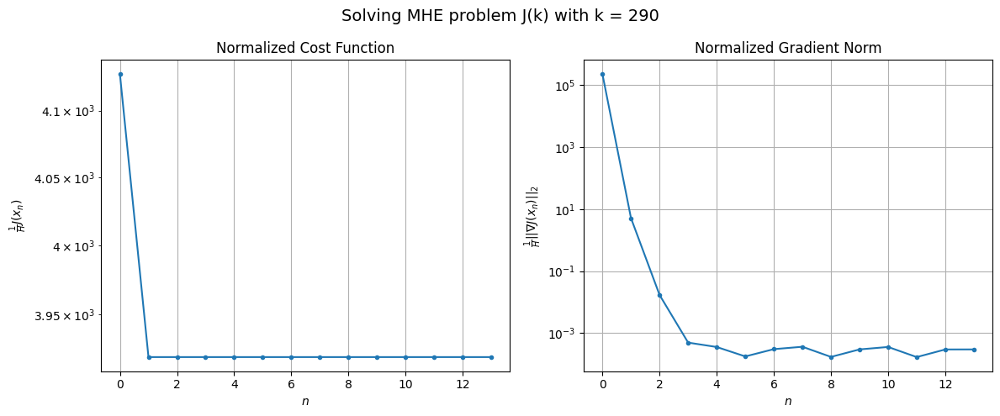

Windows:  72%|███████▏  | 262/366 [28:03<13:03,  7.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 121470.01794894652
Gradient norm: 7111995.241317789
Global estimation error: 27.567384247843762
Initial conditions estimation errors: 12.906120473531619 m, 14.853422005675029 m, 11.676865636503608 m, 15.375260662251609 m
Position estimation errors: 18.568724819261018 m, 22.236743160703412 m, 17.965926110972458 m, 23.543092628115872 m

[Gauss-Newton] Iteration 1
Cost function: 114892.27783228413 (-5.42%)
Gradient norm: 1438.0568453867147 (-99.98%)
Global estimation error: 74.7335574407178 (171.09%)
Initial conditions estimation errors: 16.40230159038672 m, 26.960385899162564 m, 35.873370201402174 m, 57.46551765783203 m
Position estimation errors: 14.803831627990656 m, 15.846885266805774 m, 17.84944235396303 m, 22.942644816636516 m

[Gauss-Newton] Iteration 2
Cost function: 114892.17185657786 (-0.00%)
Gradient norm: 3.3961982517550005 (-99.76%)
Global estimation error: 77.2257189103565 (3.33%)
Initial conditions estimation error

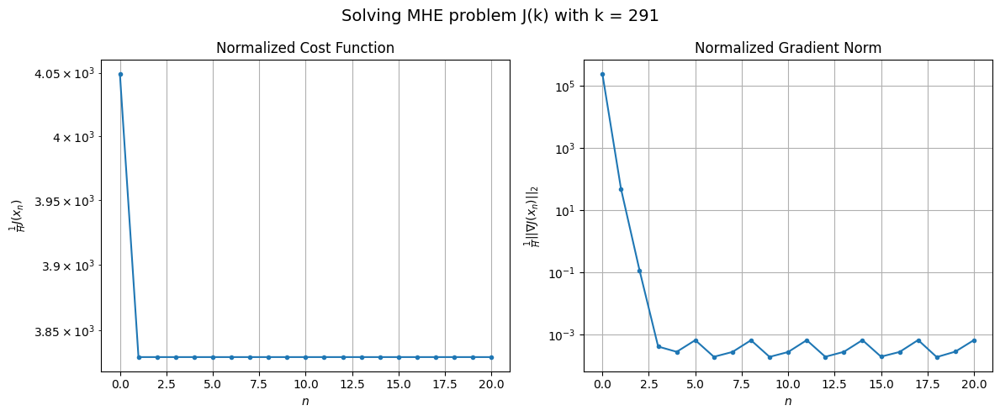

Windows:  72%|███████▏  | 263/366 [28:19<17:13, 10.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 119266.77975331439
Gradient norm: 7196754.216758918
Global estimation error: 76.0672526102841
Initial conditions estimation errors: 12.636153992921122 m, 27.638734042322927 m, 34.567429168995346 m, 60.561771622375836 m
Position estimation errors: 18.804634620801117 m, 20.107310573829135 m, 22.658431697992373 m, 27.86703889516034 m

[Gauss-Newton] Iteration 1
Cost function: 112584.81501617502 (-5.60%)
Gradient norm: 32.61516357118971 (-100.00%)
Global estimation error: 69.76228275054362 (-8.29%)
Initial conditions estimation errors: 16.159111707595216 m, 27.53664199454151 m, 34.517895393261455 m, 51.53527449686022 m
Position estimation errors: 14.985714595569087 m, 16.840831133450237 m, 18.76825490644345 m, 21.565138429079344 m

[Gauss-Newton] Iteration 2
Cost function: 112584.81492090678 (-0.00%)
Gradient norm: 0.2242492513711722 (-99.31%)
Global estimation error: 69.08733077628767 (-0.97%)
Initial conditions estimation errors

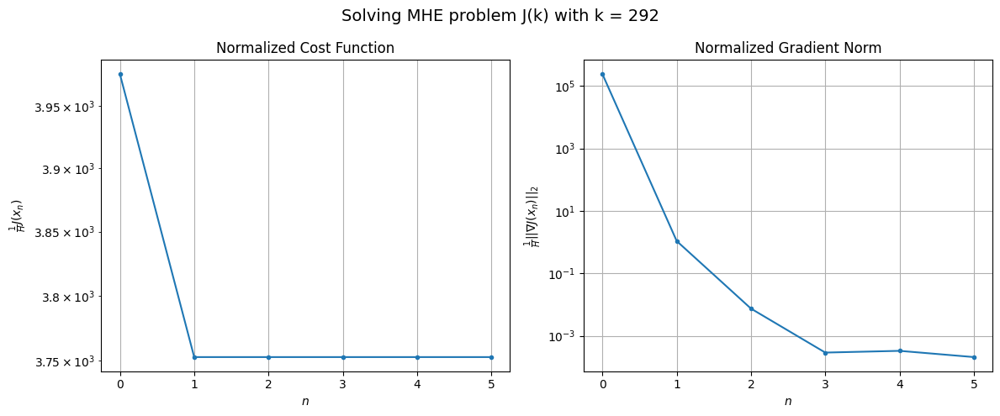

Windows:  72%|███████▏  | 264/366 [28:23<14:18,  8.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 117753.2517958989
Gradient norm: 7346018.062522878
Global estimation error: 66.90356795015147
Initial conditions estimation errors: 12.300904389180966 m, 26.607755245139312 m, 31.71755422566432 m, 51.095793507558874 m
Position estimation errors: 19.03135176021846 m, 21.0949799449556 m, 23.791456091210758 m, 25.33498589424849 m

[Gauss-Newton] Iteration 1
Cost function: 110857.7955094213 (-5.86%)
Gradient norm: 19742.797303080573 (-99.73%)
Global estimation error: 193.4504746702987 (189.15%)
Initial conditions estimation errors: 15.882378865417317 m, 71.95315911359812 m, 92.14919013707951 m, 153.30384740797007 m
Position estimation errors: 15.146156296349885 m, 22.55170215754739 m, 39.72488644112093 m, 13.682045233694842 m

[Gauss-Newton] Iteration 2
Cost function: 110853.97693681753 (-0.00%)
Gradient norm: 3.4209625238677854 (-99.98%)
Global estimation error: 193.49562331323304 (0.02%)
Initial conditions estimation errors: 15.

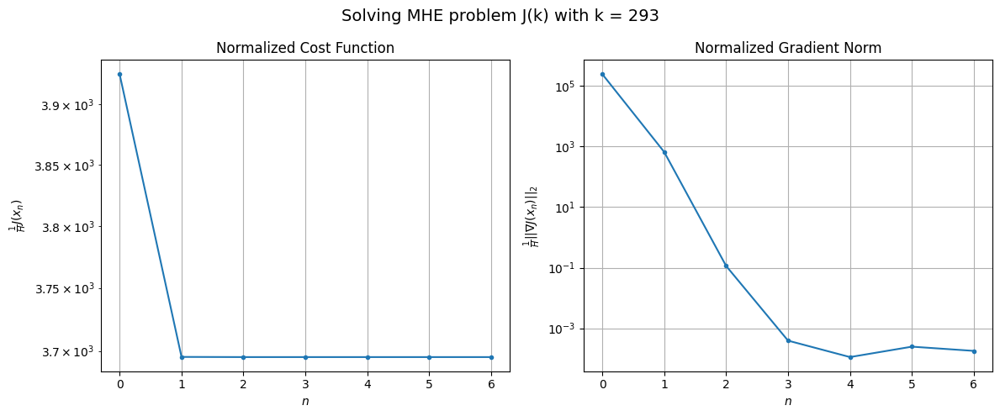

Windows:  72%|███████▏  | 265/366 [28:29<12:45,  7.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116554.00527296544
Gradient norm: 7339984.2460159995
Global estimation error: 199.05562357422897
Initial conditions estimation errors: 12.011256510613979 m, 75.15520547498953 m, 93.99234148673358 m, 158.10116178701668 m
Position estimation errors: 19.27923465982204 m, 22.56375853901705 m, 36.7481935006129 m, 15.75040684583888 m

[Gauss-Newton] Iteration 1
Cost function: 109685.74972395955 (-5.89%)
Gradient norm: 192.18950568341884 (-100.00%)
Global estimation error: 175.52518969901098 (-11.82%)
Initial conditions estimation errors: 15.597703062898622 m, 65.25074269977749 m, 80.01449844366057 m, 141.08788527621005 m
Position estimation errors: 15.411300111894976 m, 23.08101975825874 m, 41.15106225451754 m, 12.94190764080404 m

[Gauss-Newton] Iteration 2
Cost function: 109685.74849556644 (-0.00%)
Gradient norm: 0.21945878877436573 (-99.89%)
Global estimation error: 175.0157821055229 (-0.29%)
Initial conditions estimation errors:

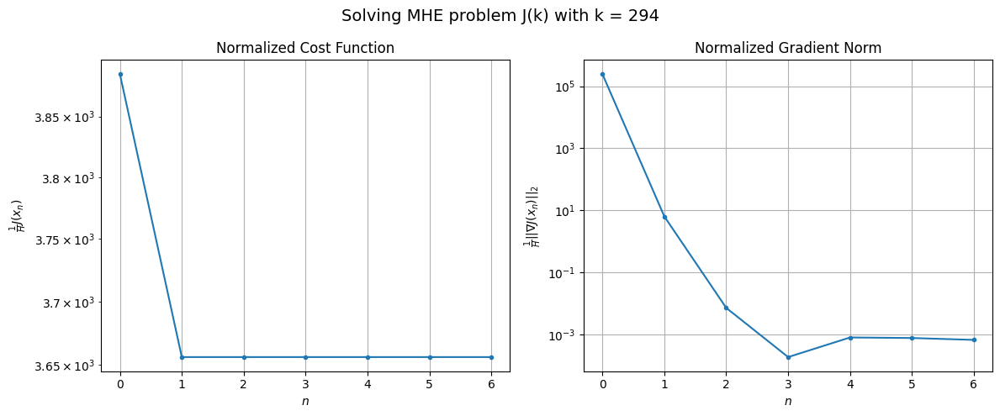

Windows:  73%|███████▎  | 266/366 [28:34<11:34,  6.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116870.23975828162
Gradient norm: 7448287.376027381
Global estimation error: 180.01139525477174
Initial conditions estimation errors: 11.770886986649387 m, 68.00752031423463 m, 81.84321909450436 m, 144.71415653648734 m
Position estimation errors: 19.741968425352102 m, 23.399173415977064 m, 38.26621045781449 m, 15.835900601453542 m

[Gauss-Newton] Iteration 1
Cost function: 110004.48043678388 (-5.87%)
Gradient norm: 21307.701945286124 (-99.71%)
Global estimation error: 32.98361999259523 (-81.68%)
Initial conditions estimation errors: 15.342807275986397 m, 15.924603389512619 m, 17.858735624408375 m, 16.73230812354633 m
Position estimation errors: 15.858714484854035 m, 15.835128768359349 m, 14.965860484916826 m, 15.464089453217358 m

[Gauss-Newton] Iteration 2
Cost function: 109996.28563594367 (-0.01%)
Gradient norm: 3.90766412172548 (-99.98%)
Global estimation error: 32.26955688047748 (-2.16%)
Initial conditions estimation error

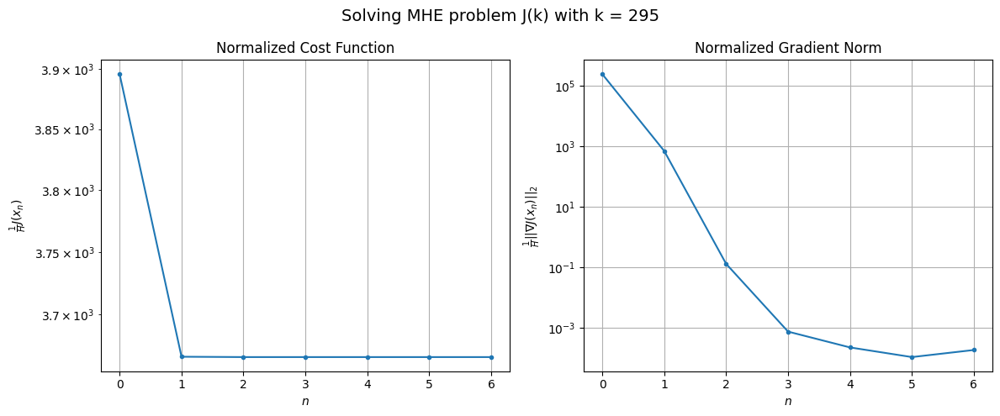

Windows:  73%|███████▎  | 267/366 [28:40<10:51,  6.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 118724.2866246226
Gradient norm: 7644560.943916322
Global estimation error: 25.073864250496932
Initial conditions estimation errors: 11.60675246570817 m, 11.945037742622137 m, 14.155435681273385 m, 12.284375161563165 m
Position estimation errors: 20.42937549259719 m, 20.404932503603515 m, 19.04632206747605 m, 19.713924343021855 m

[Gauss-Newton] Iteration 1
Cost function: 111598.23208890627 (-6.00%)
Gradient norm: 1226.638683190876 (-99.98%)
Global estimation error: 46.81097583788017 (86.69%)
Initial conditions estimation errors: 15.248980092781606 m, 17.14798921157082 m, 33.93629065548761 m, 22.649314210114916 m
Position estimation errors: 16.478296118294313 m, 17.798742378229583 m, 13.900113622149242 m, 21.570495252071186 m

[Gauss-Newton] Iteration 2
Cost function: 111598.21941231354 (-0.00%)
Gradient norm: 1.1814123482792653 (-99.90%)
Global estimation error: 47.39039472430081 (1.24%)
Initial conditions estimation errors: 

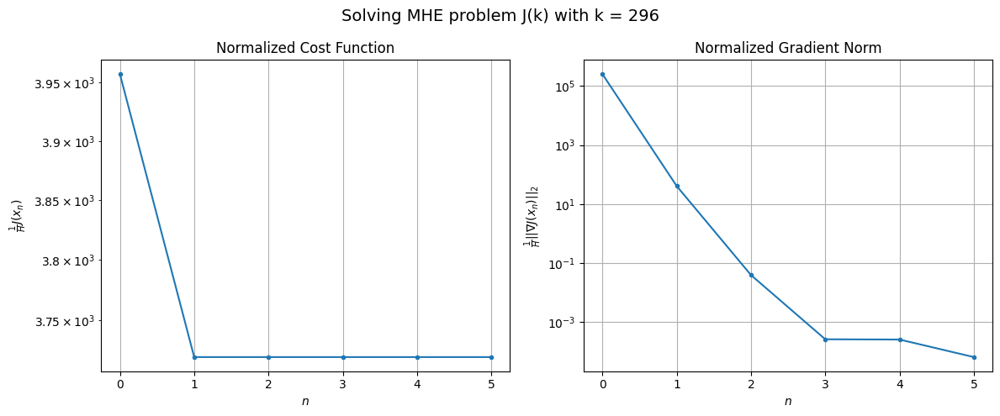

Windows:  73%|███████▎  | 268/366 [28:45<09:50,  6.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 122325.55838629219
Gradient norm: 7832434.395275972
Global estimation error: 43.69266021478728
Initial conditions estimation errors: 11.595360668242273 m, 14.200088183569058 m, 33.75628933831087 m, 20.819481071560176 m
Position estimation errors: 21.23824362393036 m, 21.552358708010665 m, 18.090550508501696 m, 23.879191722171047 m

[Gauss-Newton] Iteration 1
Cost function: 114983.42975247154 (-6.00%)
Gradient norm: 1134.6845795886916 (-99.99%)
Global estimation error: 100.14116988575496 (129.19%)
Initial conditions estimation errors: 15.272291128265268 m, 32.479072162482304 m, 65.15834190946956 m, 67.04097807252724 m
Position estimation errors: 17.20630030494091 m, 15.908805299597832 m, 23.58102983563656 m, 29.3031415125641 m

[Gauss-Newton] Iteration 2
Cost function: 114983.39621063609 (-0.00%)
Gradient norm: 0.09059962614413077 (-99.99%)
Global estimation error: 100.51208731096372 (0.37%)
Initial conditions estimation errors

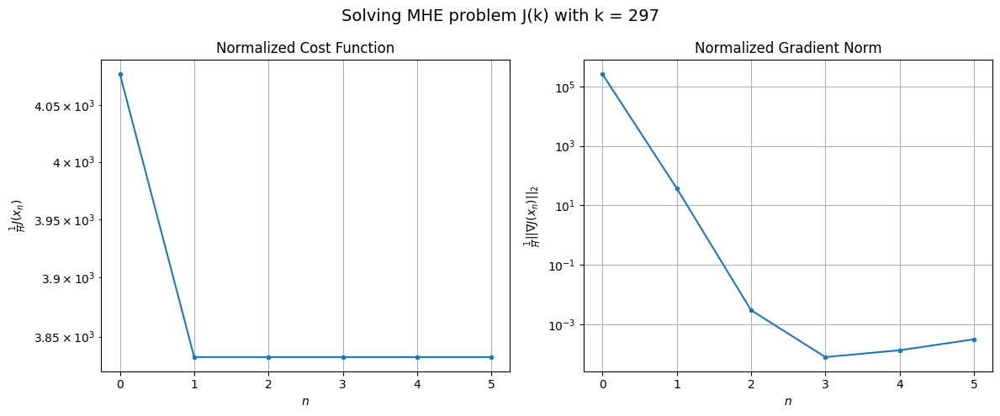

Windows:  73%|███████▎  | 269/366 [28:50<09:11,  5.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 127599.03808727048
Gradient norm: 8091297.36739485
Global estimation error: 98.31862085567097
Initial conditions estimation errors: 11.644591270497774 m, 31.219159361140473 m, 64.35562896535941 m, 66.44287830756473 m
Position estimation errors: 22.105549476044285 m, 21.00436748462387 m, 27.274605574088127 m, 37.3654702299834 m

[Gauss-Newton] Iteration 1
Cost function: 119800.5724426265 (-6.11%)
Gradient norm: 1107.40108162036 (-99.99%)
Global estimation error: 43.21302562242936 (-56.05%)
Initial conditions estimation errors: 15.424849881281402 m, 17.518454360355776 m, 28.326797620072007 m, 22.806064252194215 m
Position estimation errors: 17.936192167035745 m, 17.63803923616341 m, 15.671188218539186 m, 19.97369930551602 m

[Gauss-Newton] Iteration 2
Cost function: 119800.5075835144 (-0.00%)
Gradient norm: 0.06605885228546145 (-99.99%)
Global estimation error: 43.33789388647662 (0.29%)
Initial conditions estimation errors: 15.4

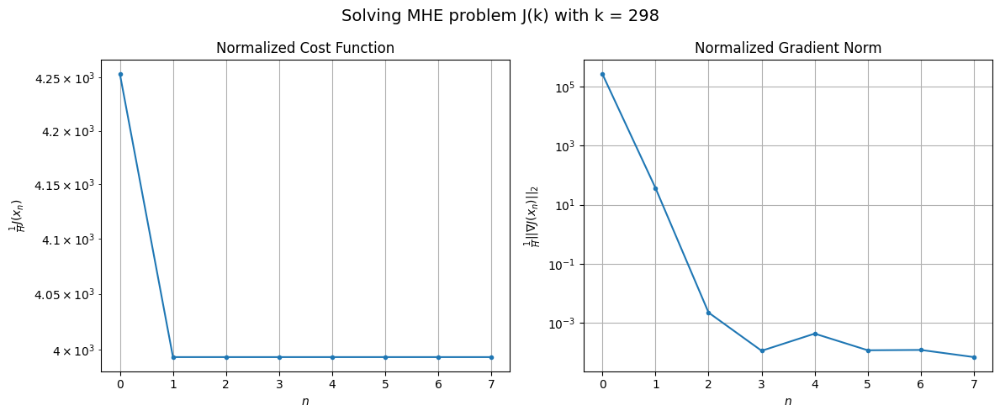

Windows:  74%|███████▍  | 270/366 [28:56<09:25,  5.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 134422.514888271
Gradient norm: 8381972.276747996
Global estimation error: 37.82060311400708
Initial conditions estimation errors: 11.768154247782162 m, 13.987228995354206 m, 26.256602859717294 m, 20.17028795416824 m
Position estimation errors: 22.987323606881073 m, 22.630609714846603 m, 20.16888619819573 m, 25.770109954694902 m

[Gauss-Newton] Iteration 1
Cost function: 126146.12523055299 (-6.16%)
Gradient norm: 3476.2327479815217 (-99.96%)
Global estimation error: 35.70518805403301 (-5.59%)
Initial conditions estimation errors: 15.641503184834223 m, 17.65709548027013 m, 22.391195760350186 m, 14.732386322435673 m
Position estimation errors: 18.673081376580054 m, 19.597551694995783 m, 32.48935538422616 m, 36.96898034419583 m

[Gauss-Newton] Iteration 2
Cost function: 126146.07153248251 (-0.00%)
Gradient norm: 0.2960618972695141 (-99.99%)
Global estimation error: 35.72218587773393 (0.05%)
Initial conditions estimation errors: 1

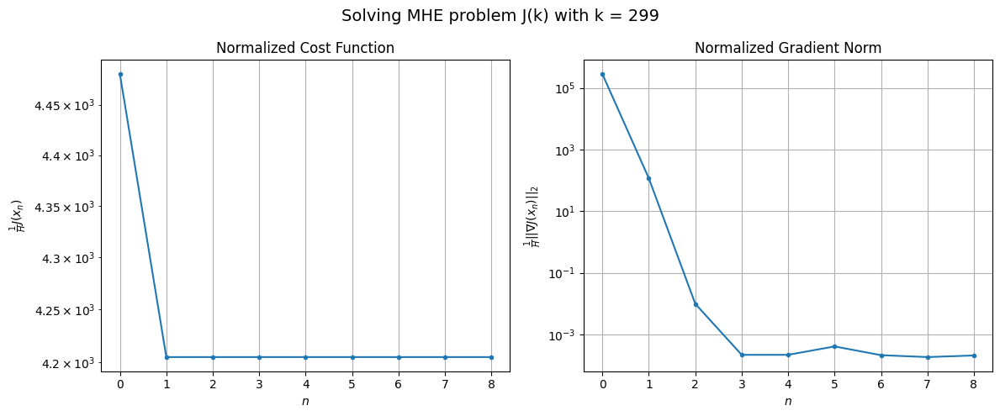

Windows:  74%|███████▍  | 271/366 [29:04<10:02,  6.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 142166.44644692965
Gradient norm: 8599649.174222473
Global estimation error: 28.299003389011336
Initial conditions estimation errors: 11.961307258596785 m, 14.628805269493721 m, 17.471018595586965 m, 11.768763290609327 m
Position estimation errors: 23.938066365847167 m, 24.574970061940128 m, 33.73741259624513 m, 41.09499858499611 m

[Gauss-Newton] Iteration 1
Cost function: 133501.26238725265 (-6.10%)
Gradient norm: 16766.72716421156 (-99.81%)
Global estimation error: 99.81550852140381 (252.72%)
Initial conditions estimation errors: 15.906477201811214 m, 45.70668746597626 m, 54.365999531836614 m, 68.30308879797543 m
Position estimation errors: 19.512303640235036 m, 45.72973565739531 m, 62.43739954385921 m, 81.37067061652762 m

[Gauss-Newton] Iteration 2
Cost function: 133499.24508545286 (-0.00%)
Gradient norm: 21.39310728769987 (-99.87%)
Global estimation error: 98.51495712568237 (-1.30%)
Initial conditions estimation errors: 

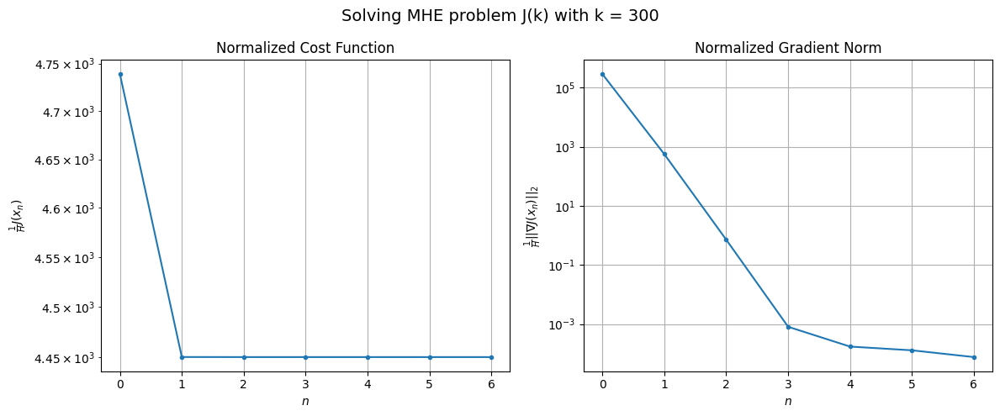

Windows:  74%|███████▍  | 272/366 [29:09<09:33,  6.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 151957.51572595708
Gradient norm: 8976311.374133227
Global estimation error: 104.6125918414664
Initial conditions estimation errors: 12.236469142137981 m, 47.062111396894366 m, 56.99134641093141 m, 73.01486260235882 m
Position estimation errors: 25.065336732000862 m, 45.450182258688876 m, 56.93985101268239 m, 76.39390214191904 m

[Gauss-Newton] Iteration 1
Cost function: 142616.46726316633 (-6.15%)
Gradient norm: 835.0904447677423 (-99.99%)
Global estimation error: 99.94575678238874 (-4.46%)
Initial conditions estimation errors: 16.293773886489195 m, 44.71349130125837 m, 54.821949746807626 m, 68.69418473746254 m
Position estimation errors: 20.445526775934884 m, 34.00780118947543 m, 50.096017878848215 m, 55.989290593122576 m

[Gauss-Newton] Iteration 2
Cost function: 142616.46460093107 (-0.00%)
Gradient norm: 4.9890597944129 (-99.40%)
Global estimation error: 98.86966810193809 (-1.08%)
Initial conditions estimation errors: 16.2

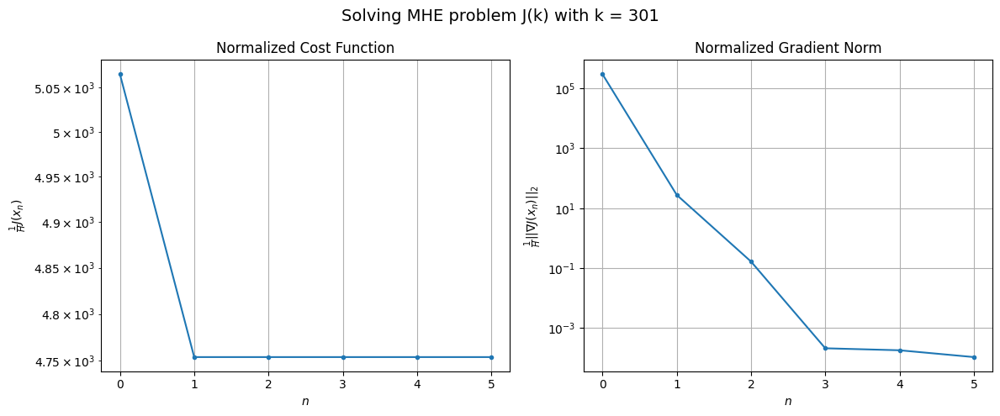

Windows:  75%|███████▍  | 273/366 [29:14<08:51,  5.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 163756.99350323755
Gradient norm: 9410457.13842678
Global estimation error: 102.67166015670075
Initial conditions estimation errors: 12.629302005593301 m, 44.873290476882374 m, 57.46750466339827 m, 71.17454759597086 m
Position estimation errors: 26.357172153448317 m, 36.238152111423396 m, 47.16138026257441 m, 53.866318732175486 m

[Gauss-Newton] Iteration 1
Cost function: 153591.4447004356 (-6.21%)
Gradient norm: 8795.304785672737 (-99.91%)
Global estimation error: 182.97322893643596 (78.21%)
Initial conditions estimation errors: 16.810143752577673 m, 78.65942598483744 m, 92.9491461963274 m, 135.53493353192653 m
Position estimation errors: 21.503512804877438 m, 43.99592014012837 m, 72.68653078064845 m, 71.3348262656746 m

[Gauss-Newton] Iteration 2
Cost function: 153590.7650751072 (-0.00%)
Gradient norm: 38.980808604296165 (-99.56%)
Global estimation error: 186.37745679754624 (1.86%)
Initial conditions estimation errors: 16.81

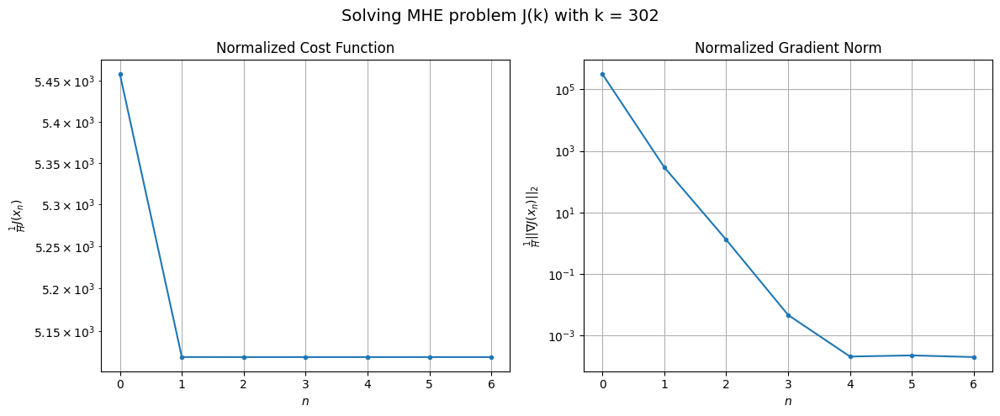

Windows:  75%|███████▍  | 274/366 [29:19<08:40,  5.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 178444.96392283926
Gradient norm: 9993103.898440368
Global estimation error: 195.54446508787095
Initial conditions estimation errors: 13.107439701290366 m, 82.95500650134214 m, 101.80400585819011 m, 144.29205086876576 m
Position estimation errors: 27.824007577606373 m, 44.897470149642196 m, 68.6929253957382 m, 67.09376870865263 m

[Gauss-Newton] Iteration 1
Cost function: 167290.10810186723 (-6.25%)
Gradient norm: 37484.061248180915 (-99.62%)
Global estimation error: 101.03895435354356 (-48.33%)
Initial conditions estimation errors: 17.397472025656466 m, 44.75312534442542 m, 45.2822817675445 m, 76.50391480957038 m
Position estimation errors: 22.676116515194238 m, 22.930314805161764 m, 29.146873547865 m, 27.768890435724444 m

[Gauss-Newton] Iteration 2
Cost function: 167282.75952166005 (-0.00%)
Gradient norm: 11.350667925920058 (-99.97%)
Global estimation error: 104.12731755600305 (3.06%)
Initial conditions estimation errors: 1

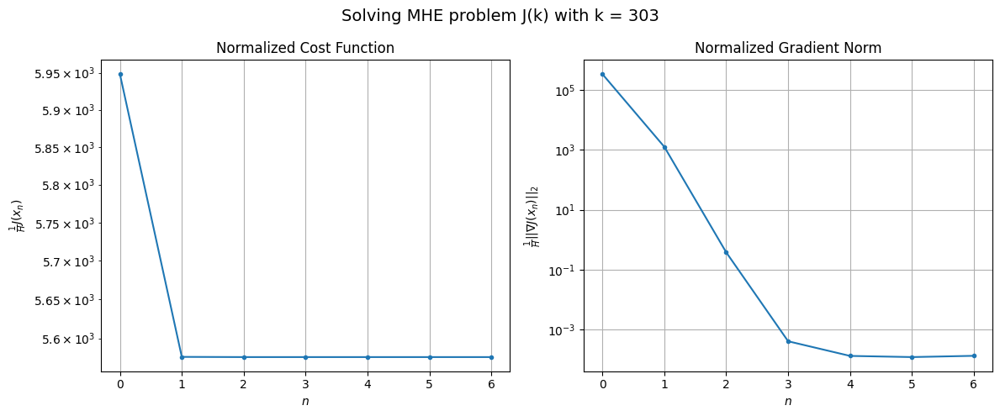

Windows:  75%|███████▌  | 275/366 [29:26<08:50,  5.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 195325.7895076002
Gradient norm: 10564492.431280963
Global estimation error: 101.1069896208196
Initial conditions estimation errors: 13.60369499231593 m, 43.709353104963824 m, 47.855772876625366 m, 76.39935298098423 m
Position estimation errors: 29.402552544276272 m, 29.6215789319378 m, 38.05884273568196 m, 32.63057050029518 m

[Gauss-Newton] Iteration 1
Cost function: 183060.21600341625 (-6.28%)
Gradient norm: 11880.520294688307 (-99.89%)
Global estimation error: 49.75625540350076 (-50.79%)
Initial conditions estimation errors: 18.026894093111924 m, 23.674291011170354 m, 15.40457531847027 m, 36.781911594286946 m
Position estimation errors: 23.954049290938865 m, 35.307276197128736 m, 49.61333465224982 m, 68.7164643250166 m

[Gauss-Newton] Iteration 2
Cost function: 183059.20541814898 (-0.00%)
Gradient norm: 37.36201940174673 (-99.69%)
Global estimation error: 50.7228397955986 (1.94%)
Initial conditions estimation errors: 18.02

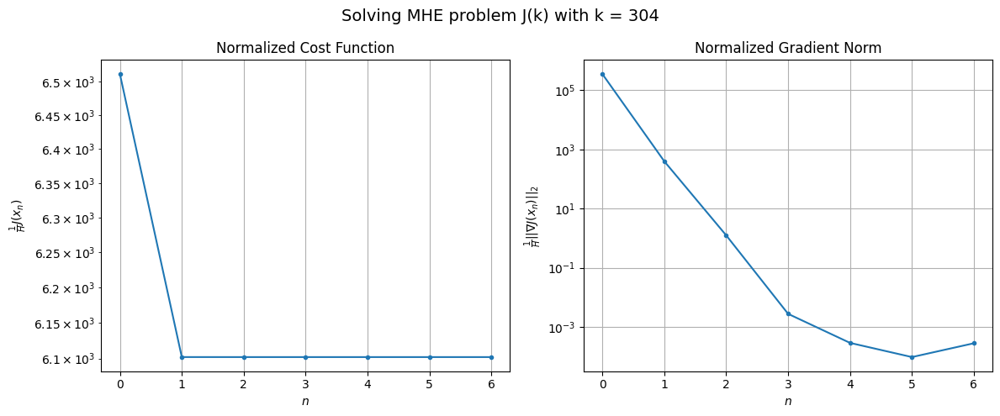

Windows:  75%|███████▌  | 276/366 [29:31<08:42,  5.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 215144.02094375456
Gradient norm: 11177695.177954523
Global estimation error: 40.33278227038536
Initial conditions estimation errors: 14.091378412242317 m, 19.02628853133077 m, 11.810822998058445 m, 30.440773536908733 m
Position estimation errors: 31.02469950549371 m, 38.49230228504349 m, 53.68174702396785 m, 66.59651033047895 m

[Gauss-Newton] Iteration 1
Cost function: 201659.01453630673 (-6.27%)
Gradient norm: 12962.528927857647 (-99.88%)
Global estimation error: 71.29474551430921 (76.77%)
Initial conditions estimation errors: 18.639203909443797 m, 37.25213391440449 m, 31.512238635403403 m, 48.52580779954591 m
Position estimation errors: 25.245487870843736 m, 24.667480017728778 m, 30.418442935106153 m, 21.832309307362447 m

[Gauss-Newton] Iteration 2
Cost function: 201658.3205905504 (-0.00%)
Gradient norm: 52.98562875286392 (-99.59%)
Global estimation error: 70.41862469972615 (-1.23%)
Initial conditions estimation errors: 1

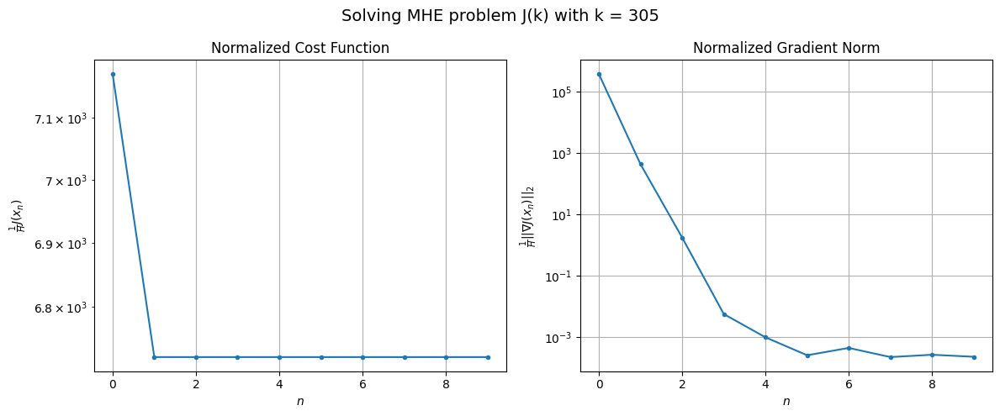

Windows:  76%|███████▌  | 277/366 [29:39<09:27,  6.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 237592.9448437503
Gradient norm: 11793584.223763136
Global estimation error: 65.93786594098795
Initial conditions estimation errors: 14.53963292356519 m, 33.78763359132169 m, 30.02978817345467 m, 45.74918430204095 m
Position estimation errors: 32.55987374973363 m, 31.877086009210473 m, 39.656571576750274 m, 28.436688697720026 m

[Gauss-Newton] Iteration 1
Cost function: 222825.402371572 (-6.22%)
Gradient norm: 548.0779728730497 (-100.00%)
Global estimation error: 50.73077592266863 (-23.06%)
Initial conditions estimation errors: 19.199749822125778 m, 27.293417652788115 m, 22.434624111344835 m, 30.93078486173627 m
Position estimation errors: 26.433196035554232 m, 26.528714575129907 m, 30.205960970569222 m, 28.44402123007065 m

[Gauss-Newton] Iteration 2
Cost function: 222825.40084674652 (-0.00%)
Gradient norm: 1.1589165287743144 (-99.79%)
Global estimation error: 50.65021758662364 (-0.16%)
Initial conditions estimation errors: 1

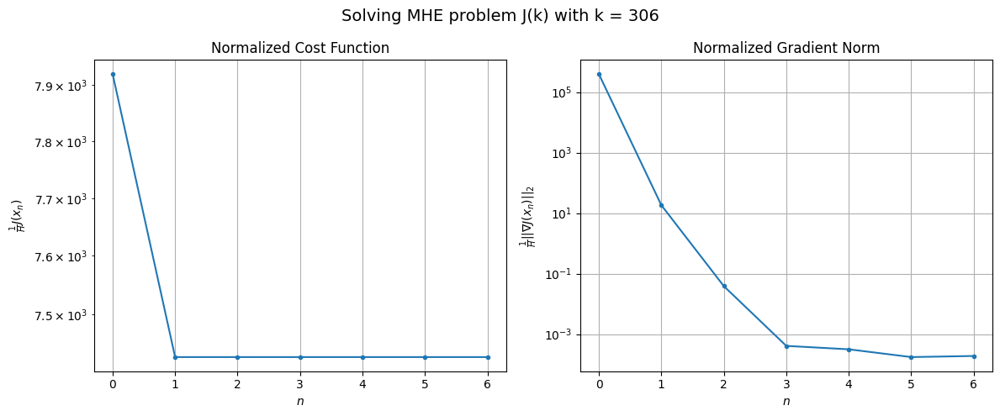

Windows:  76%|███████▌  | 278/366 [29:45<08:58,  6.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 262252.25802267034
Gradient norm: 12331836.986791687
Global estimation error: 45.120157799430736
Initial conditions estimation errors: 14.969202525936536 m, 24.168166849848735 m, 20.16223171491477 m, 28.655099219133184 m
Position estimation errors: 33.885992439849986 m, 33.74011733167027 m, 37.960144260881954 m, 34.5993725662695 m

[Gauss-Newton] Iteration 1
Cost function: 246319.5648770814 (-6.08%)
Gradient norm: 11351.927559575675 (-99.91%)
Global estimation error: 40.75116106077116 (-9.68%)
Initial conditions estimation errors: 19.718826807179273 m, 16.441053960421844 m, 14.416232291762435 m, 28.171916076719953 m
Position estimation errors: 27.449418951170625 m, 29.38862303243997 m, 49.086592623984444 m, 54.16498191996273 m

[Gauss-Newton] Iteration 2
Cost function: 246319.14929383673 (-0.00%)
Gradient norm: 23.210863351962843 (-99.80%)
Global estimation error: 41.15733318914988 (1.00%)
Initial conditions estimation errors:

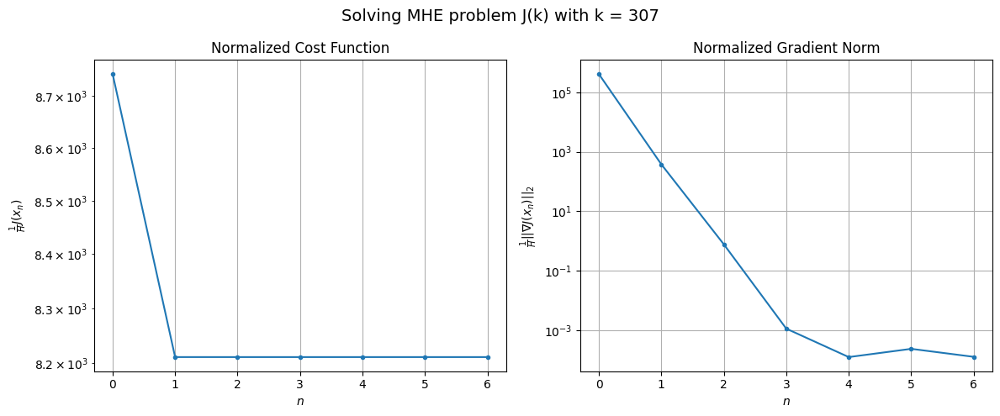

Windows:  76%|███████▌  | 279/366 [29:50<08:36,  5.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 287979.6775918274
Gradient norm: 12716091.904408384
Global estimation error: 31.296463936230342
Initial conditions estimation errors: 15.416941492928041 m, 11.913494090223105 m, 11.354790559903302 m, 21.70014954842642 m
Position estimation errors: 34.95144555118511 m, 34.357505318433034 m, 53.948278822890636 m, 53.878424934812344 m

[Gauss-Newton] Iteration 1
Cost function: 271131.43874976644 (-5.85%)
Gradient norm: 31093.571274333168 (-99.76%)
Global estimation error: 39.93708743586867 (27.61%)
Initial conditions estimation errors: 20.231774989394502 m, 16.50120461440098 m, 12.326992993664184 m, 27.591863025659624 m
Position estimation errors: 28.269541145707763 m, 68.68664069080192 m, 116.12222765126671 m, 156.2303697740735 m

[Gauss-Newton] Iteration 2
Cost function: 271128.3809567299 (-0.00%)
Gradient norm: 0.4728881588530227 (-100.00%)
Global estimation error: 40.03057623843778 (0.23%)
Initial conditions estimation errors

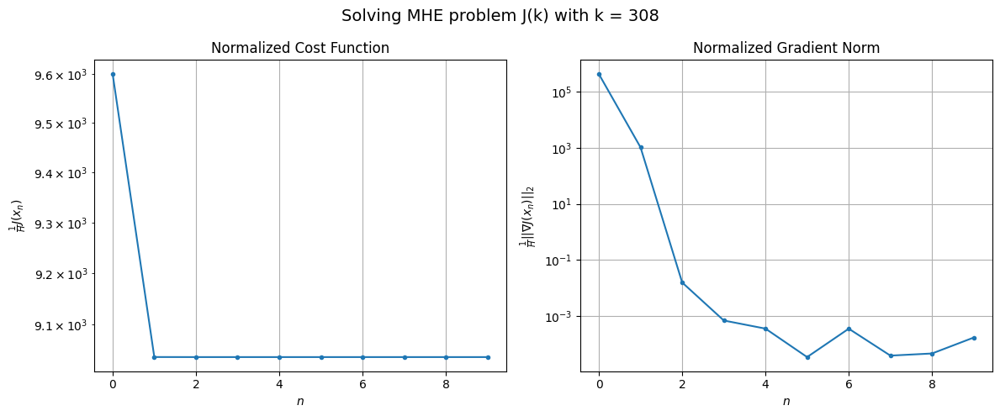

Windows:  77%|███████▋  | 280/366 [29:58<09:18,  6.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 314389.86429933563
Gradient norm: 13056887.404886222
Global estimation error: 35.335857175269936
Initial conditions estimation errors: 15.901154140998894 m, 17.10359277106305 m, 15.103912316491225 m, 21.795149156190273 m
Position estimation errors: 35.73938348512109 m, 68.56163254877042 m, 116.94581836128063 m, 153.8744914030087 m

[Gauss-Newton] Iteration 1
Cost function: 296597.8504442564 (-5.66%)
Gradient norm: 12412.36471011687 (-99.90%)
Global estimation error: 39.47784190791444 (11.72%)
Initial conditions estimation errors: 20.804566935674952 m, 15.076426822091454 m, 22.48939952743437 m, 19.812958024206424 m
Position estimation errors: 28.828033724300038 m, 43.72387527955366 m, 84.34852236132915 m, 83.56494846566484 m

[Gauss-Newton] Iteration 2
Cost function: 296597.2501413547 (-0.00%)
Gradient norm: 40.444281488654845 (-99.67%)
Global estimation error: 39.85820235159292 (0.96%)
Initial conditions estimation errors: 20.

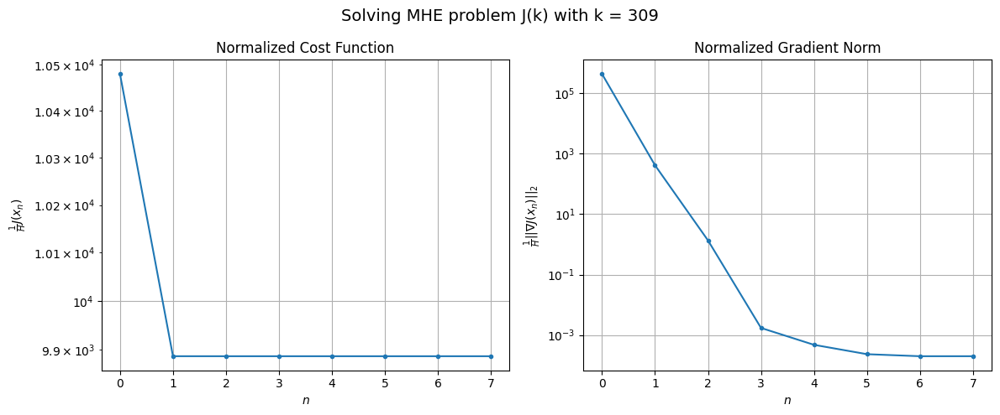

Windows:  77%|███████▋  | 281/366 [30:04<09:04,  6.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 340117.40857279085
Gradient norm: 13230830.053259514
Global estimation error: 32.02941425722918
Initial conditions estimation errors: 16.440942951769188 m, 11.053223776590729 m, 20.338580618969555 m, 14.822542427212372 m
Position estimation errors: 36.17700524119862 m, 45.108520181860264 m, 86.00890372319208 m, 79.64774637244224 m

[Gauss-Newton] Iteration 1
Cost function: 321718.32108854287 (-5.41%)
Gradient norm: 1723.1737357294207 (-99.99%)
Global estimation error: 39.77142335025624 (24.17%)
Initial conditions estimation errors: 21.422001945234157 m, 18.33376041164021 m, 19.714677843912195 m, 19.950773940408382 m
Position estimation errors: 29.12704332150189 m, 32.471623409201904 m, 61.295866394313165 m, 58.7459890412465 m

[Gauss-Newton] Iteration 2
Cost function: 321718.3119845593 (-0.00%)
Gradient norm: 1.291896370945965 (-99.93%)
Global estimation error: 39.787846613252405 (0.04%)
Initial conditions estimation errors: 2

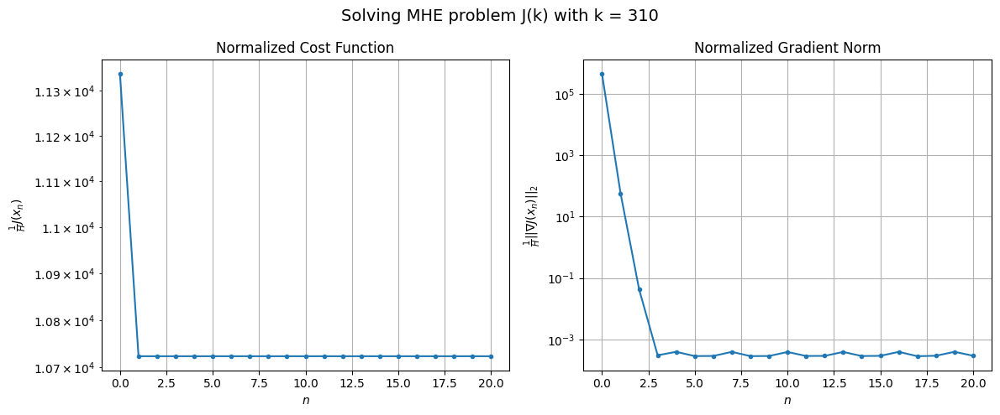

Windows:  77%|███████▋  | 282/366 [30:20<12:46,  9.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 365107.55883045984
Gradient norm: 13305121.164166164
Global estimation error: 34.070342786615306
Initial conditions estimation errors: 17.014106421717933 m, 15.787603447780729 m, 17.213363717768782 m, 18.047961703665244 m
Position estimation errors: 36.285547532188126 m, 37.80112210701656 m, 65.06512135215334 m, 60.200553101164296 m

[Gauss-Newton] Iteration 1
Cost function: 346267.8539582648 (-5.16%)
Gradient norm: 3062.551148928035 (-99.98%)
Global estimation error: 41.823320930319056 (22.76%)
Initial conditions estimation errors: 22.056436425035947 m, 20.90814828200069 m, 15.336405945785895 m, 24.29600463711814 m
Position estimation errors: 29.130456940843214 m, 42.88920857595728 m, 75.56689547045163 m, 93.02934680638936 m

[Gauss-Newton] Iteration 2
Cost function: 346267.8222285512 (-0.00%)
Gradient norm: 5.996630935697946 (-99.80%)
Global estimation error: 41.676847943011055 (-0.35%)
Initial conditions estimation errors: 

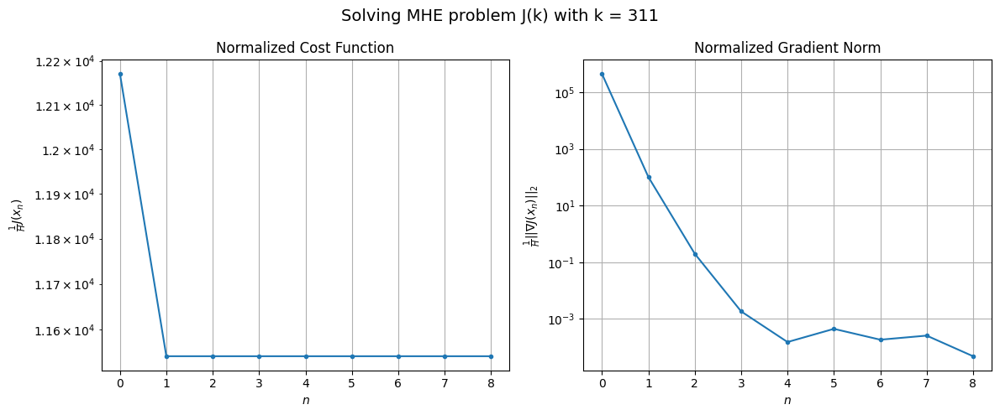

Windows:  77%|███████▋  | 283/366 [30:27<11:45,  8.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 386689.86683787056
Gradient norm: 13163465.040181918
Global estimation error: 37.65868136227371
Initial conditions estimation errors: 17.60091614858187 m, 19.80234902991709 m, 12.367452703204078 m, 23.732849940305385 m
Position estimation errors: 36.05844527369885 m, 46.77440631400308 m, 77.96600581949825 m, 95.41729168565966 m

[Gauss-Newton] Iteration 1
Cost function: 367785.3221154637 (-4.89%)
Gradient norm: 3757.2321384951874 (-99.97%)
Global estimation error: 78.75871320457718 (109.14%)
Initial conditions estimation errors: 22.726018179942695 m, 36.83775380858854 m, 29.818519454596366 m, 58.653738042721976 m
Position estimation errors: 28.9179925467106 m, 31.413484214984884 m, 45.09982243345441 m, 48.98251868874664 m

[Gauss-Newton] Iteration 2
Cost function: 367785.2741121274 (-0.00%)
Gradient norm: 34.86333926956531 (-99.07%)
Global estimation error: 81.20448330163434 (3.11%)
Initial conditions estimation errors: 22.726

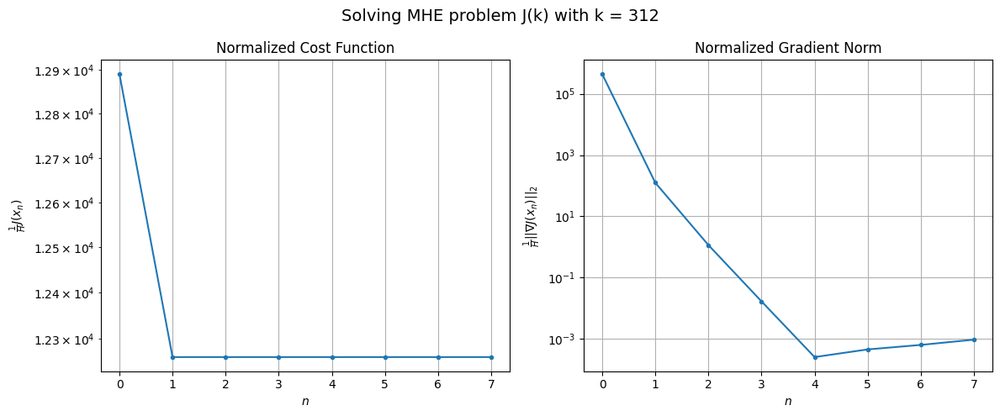

Windows:  78%|███████▊  | 284/366 [30:33<10:37,  7.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 406107.9109598809
Gradient norm: 13090731.843175886
Global estimation error: 83.09020910188647
Initial conditions estimation errors: 18.192021613051054 m, 38.17629977164486 m, 27.506495732903385 m, 66.02244971536209 m
Position estimation errors: 35.62260635998925 m, 37.47905911365661 m, 45.74138325911059 m, 48.7774589047093 m

[Gauss-Newton] Iteration 1
Cost function: 386998.6062481707 (-4.71%)
Gradient norm: 15112.963430924525 (-99.88%)
Global estimation error: 64.1180184331895 (-22.83%)
Initial conditions estimation errors: 23.42983657034686 m, 26.896476082696108 m, 24.865427949783896 m, 47.121381362507485 m
Position estimation errors: 28.483623386498255 m, 36.186863633634495 m, 30.724662763478584 m, 60.27716131354501 m

[Gauss-Newton] Iteration 2
Cost function: 386997.78123618197 (-0.00%)
Gradient norm: 4.945609253996517 (-99.97%)
Global estimation error: 63.61799451510708 (-0.78%)
Initial conditions estimation errors: 23.4

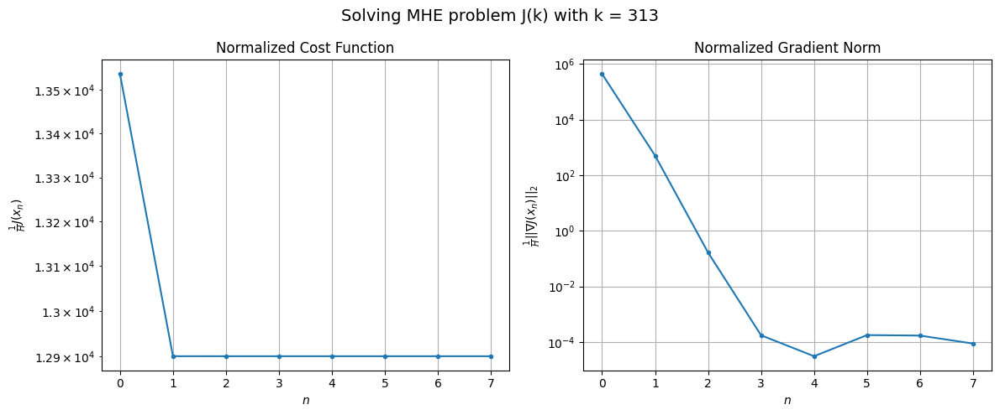

Windows:  78%|███████▊  | 285/366 [30:39<10:03,  7.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 420088.7143306151
Gradient norm: 12824950.761659475
Global estimation error: 57.33827340622667
Initial conditions estimation errors: 18.75462196819988 m, 23.41129981355563 m, 19.926321648814234 m, 44.61802487781028 m
Position estimation errors: 34.996562374376445 m, 42.18904912391686 m, 37.47081170084437 m, 65.93106104824494 m

[Gauss-Newton] Iteration 1
Cost function: 400872.2839575305 (-4.57%)
Gradient norm: 85.19970506190042 (-100.00%)
Global estimation error: 56.12578513296335 (-2.11%)
Initial conditions estimation errors: 24.174527109150752 m, 25.08567921733479 m, 24.605936153930557 m, 36.48178072724084 m
Position estimation errors: 27.94024046135529 m, 35.17035846689272 m, 31.7566140703639 m, 60.65332801759117 m

[Gauss-Newton] Iteration 2
Cost function: 400872.2836845856 (-0.00%)
Gradient norm: 0.8671963140790396 (-98.98%)
Global estimation error: 55.76116915918543 (-0.65%)
Initial conditions estimation errors: 24.17452

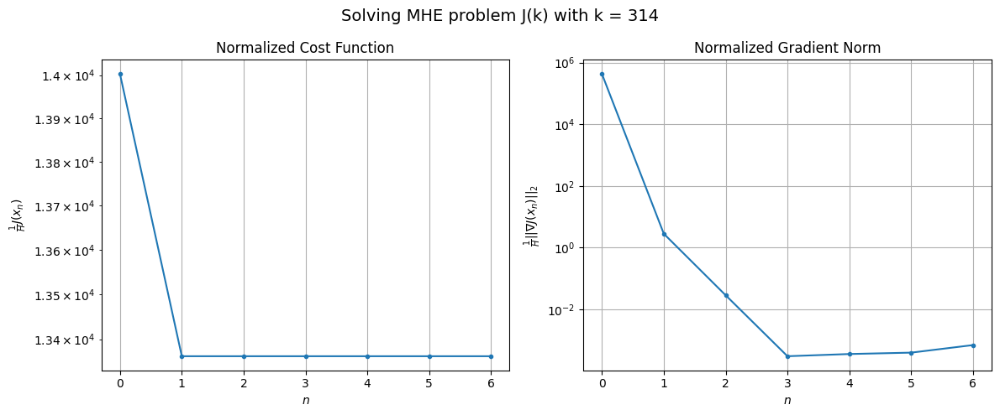

Windows:  78%|███████▊  | 286/366 [30:45<09:20,  7.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 430383.61716318736
Gradient norm: 12637734.829586783
Global estimation error: 47.64294053035298
Initial conditions estimation errors: 19.320666538335576 m, 20.624351635807873 m, 20.05249348642273 m, 32.69657492076668 m
Position estimation errors: 34.29528618379617 m, 40.32546506146391 m, 37.51850188140728 m, 63.088835664353894 m

[Gauss-Newton] Iteration 1
Cost function: 411038.56469338876 (-4.49%)
Gradient norm: 117.58209336493539 (-100.00%)
Global estimation error: 56.81542962920423 (19.25%)
Initial conditions estimation errors: 24.87928669520249 m, 26.82507336247426 m, 27.116712912433705 m, 33.971716275242194 m
Position estimation errors: 27.297478623267438 m, 33.03242126217702 m, 32.99984730730105 m, 50.81789506833354 m

[Gauss-Newton] Iteration 2
Cost function: 411038.5642362217 (-0.00%)
Gradient norm: 2.853534236094758 (-97.57%)
Global estimation error: 56.33827678055853 (-0.84%)
Initial conditions estimation errors: 24.

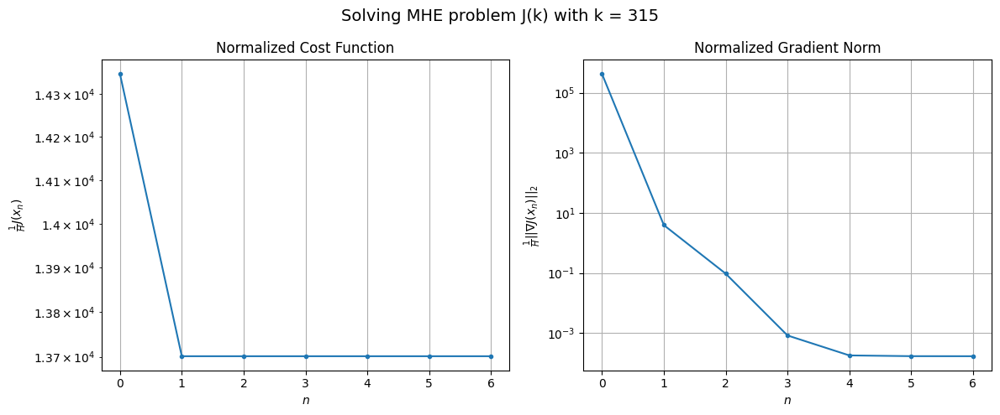

Windows:  78%|███████▊  | 287/366 [30:51<08:37,  6.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 436263.4265604587
Gradient norm: 12329721.947415655
Global estimation error: 46.93625431849082
Initial conditions estimation errors: 19.875446113871316 m, 21.91643042674233 m, 21.477942671855708 m, 29.43323235858172 m
Position estimation errors: 33.505627325251055 m, 38.37207001744845 m, 38.51061892858319 m, 53.138618961645705 m

[Gauss-Newton] Iteration 1
Cost function: 417020.0079802826 (-4.41%)
Gradient norm: 2320.491036713669 (-99.98%)
Global estimation error: 63.83812942282337 (36.01%)
Initial conditions estimation errors: 25.541320493456517 m, 29.311669924882846 m, 29.424288947191823 m, 41.20608751381539 m
Position estimation errors: 26.615906114624522 m, 41.4001594442856 m, 47.03375668918724 m, 82.10696058880812 m

[Gauss-Newton] Iteration 2
Cost function: 417019.9918368169 (-0.00%)
Gradient norm: 6.263263815547491 (-99.73%)
Global estimation error: 65.00750856487782 (1.83%)
Initial conditions estimation errors: 25.5413

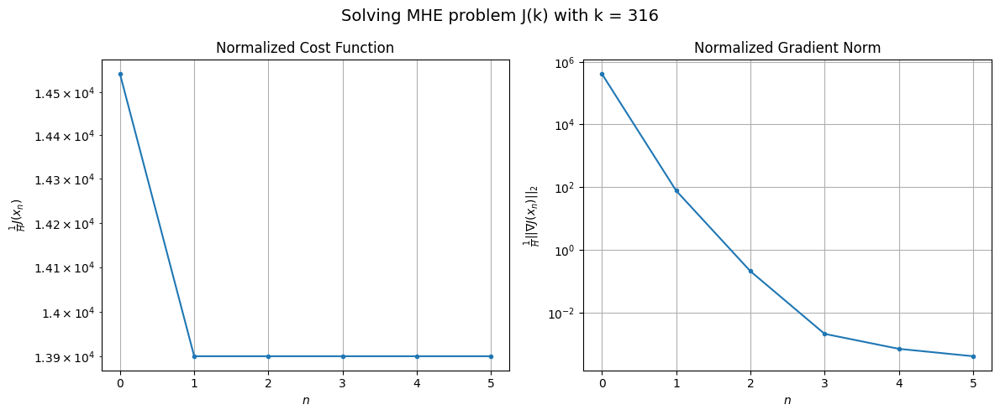

Windows:  79%|███████▊  | 288/366 [30:56<07:48,  6.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 437837.3214912985
Gradient norm: 11966268.383265147
Global estimation error: 54.63468244935526
Initial conditions estimation errors: 20.43394638699204 m, 24.195517399770324 m, 23.847547099347807 m, 37.59301117703125 m
Position estimation errors: 32.64952895113633 m, 46.388988437485125 m, 52.12046226355682 m, 86.48436881543584 m

[Gauss-Newton] Iteration 1
Cost function: 418874.12584267743 (-4.33%)
Gradient norm: 65.04577618757186 (-100.00%)
Global estimation error: 63.211262461211874 (15.70%)
Initial conditions estimation errors: 26.18397167903323 m, 28.31624119797097 m, 31.882261993876497 m, 38.622898360731334 m
Position estimation errors: 25.91321699556628 m, 40.049885913880196 m, 53.808622536305364 m, 87.24911594770057 m

[Gauss-Newton] Iteration 2
Cost function: 418874.12573590333 (-0.00%)
Gradient norm: 0.1139826810974758 (-99.82%)
Global estimation error: 62.98925060928459 (-0.35%)
Initial conditions estimation errors: 2

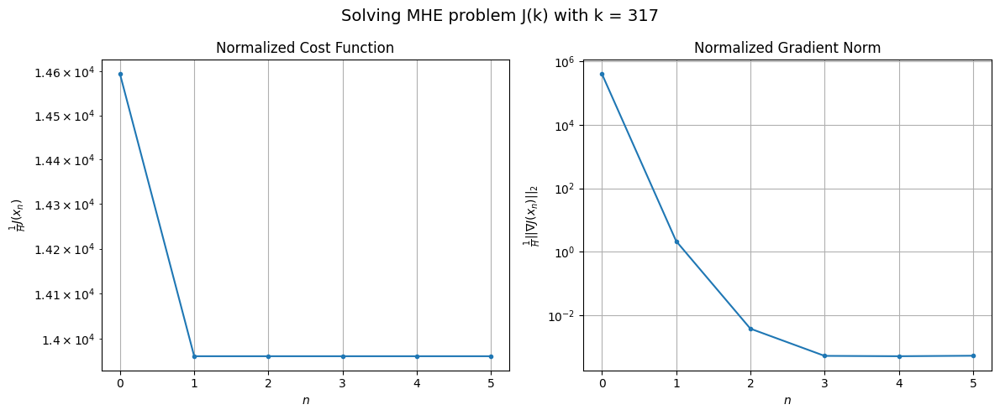

Windows:  79%|███████▉  | 289/366 [31:01<07:19,  5.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 434849.7325469579
Gradient norm: 11545709.375720387
Global estimation error: 51.326327463560936
Initial conditions estimation errors: 20.96851396481365 m, 22.878667308772407 m, 25.240608973991424 m, 32.1581825497888 m
Position estimation errors: 31.7022294121102 m, 43.73924968972301 m, 57.843956141213724 m, 87.57940545996226 m

[Gauss-Newton] Iteration 1
Cost function: 416125.9731187037 (-4.31%)
Gradient norm: 145.93256773185743 (-100.00%)
Global estimation error: 55.35254852187361 (7.84%)
Initial conditions estimation errors: 26.817809302802303 m, 26.826038487440698 m, 28.824637398991648 m, 28.180944972388325 m
Position estimation errors: 25.127881961929194 m, 34.23639648353869 m, 47.47160239440814 m, 75.78735881898827 m

[Gauss-Newton] Iteration 2
Cost function: 416125.9712812031 (-0.00%)
Gradient norm: 2.3049772109364834 (-98.42%)
Global estimation error: 55.35041395017333 (-0.00%)
Initial conditions estimation errors: 26.8

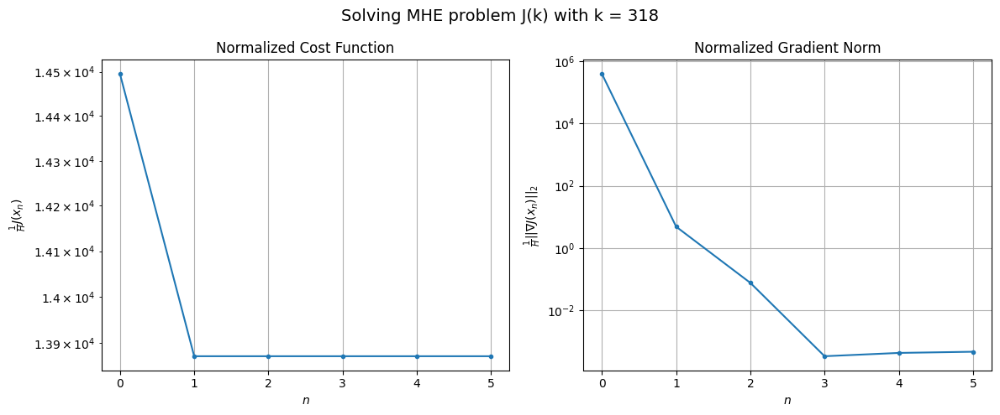

Windows:  79%|███████▉  | 290/366 [31:06<07:11,  5.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 426902.9073934146
Gradient norm: 11115943.846007459
Global estimation error: 44.9297035544728
Initial conditions estimation errors: 21.461480929663068 m, 21.7012658533463 m, 23.702557044021518 m, 22.91906328473757 m
Position estimation errors: 30.57828503545843 m, 37.207559341474855 m, 50.628217555386 m, 73.20018694932595 m

[Gauss-Newton] Iteration 1
Cost function: 408496.85360258195 (-4.31%)
Gradient norm: 835.6722075703652 (-99.99%)
Global estimation error: 58.73283833418205 (30.72%)
Initial conditions estimation errors: 27.403156454364765 m, 28.438240948960225 m, 29.72888081149084 m, 31.717915445044767 m
Position estimation errors: 24.198496649745632 m, 32.687467652033526 m, 41.82112548153389 m, 57.545477365700634 m

[Gauss-Newton] Iteration 2
Cost function: 408496.8495617574 (-0.00%)
Gradient norm: 0.032675039713154365 (-100.00%)
Global estimation error: 58.67017792107978 (-0.11%)
Initial conditions estimation errors: 27.

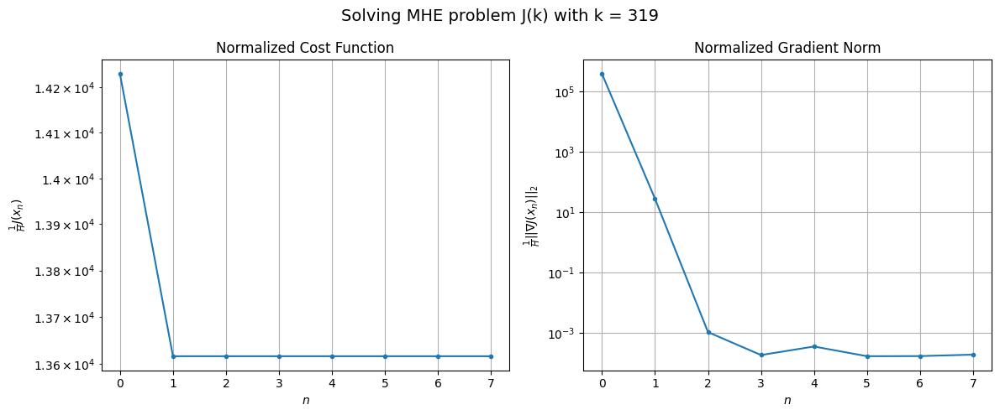

Windows:  80%|███████▉  | 291/366 [31:13<07:21,  5.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 413798.528548874
Gradient norm: 10573566.10197608
Global estimation error: 47.032233731797426
Initial conditions estimation errors: 21.900398753225566 m, 23.029219401120727 m, 23.643977016229197 m, 25.357017249818533 m
Position estimation errors: 29.219725358950125 m, 36.28083454196164 m, 45.83542100256235 m, 58.04290677326205 m

[Gauss-Newton] Iteration 1
Cost function: 395769.94355468045 (-4.36%)
Gradient norm: 847.527893027376 (-99.99%)
Global estimation error: 67.34043847296097 (43.18%)
Initial conditions estimation errors: 27.92120166706549 m, 29.703709045458975 m, 30.11367401814324 m, 44.33902026129896 m
Position estimation errors: 23.05188199801674 m, 24.943048515450027 m, 34.875573908000256 m, 28.964313477449664 m

[Gauss-Newton] Iteration 2
Cost function: 395769.9385387391 (-0.00%)
Gradient norm: 1.580927385578049 (-99.81%)
Global estimation error: 67.74617995113798 (0.60%)
Initial conditions estimation errors: 27.921

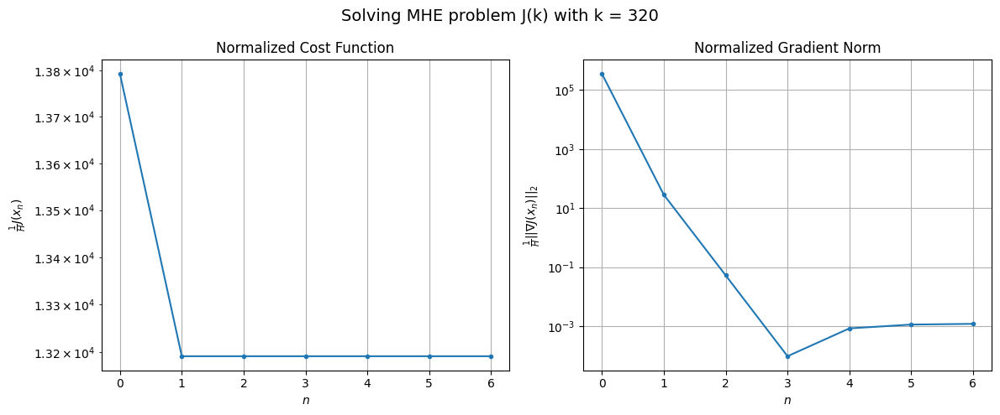

Windows:  80%|███████▉  | 292/366 [31:18<07:09,  5.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 395072.30689049646
Gradient norm: 9808962.558884213
Global estimation error: 58.50965511636345
Initial conditions estimation errors: 22.279969849585527 m, 24.260087448127667 m, 25.668070742220724 m, 40.98215607160419 m
Position estimation errors: 27.549998131484216 m, 29.092696666437163 m, 38.417178453386036 m, 30.853420109184036 m

[Gauss-Newton] Iteration 1
Cost function: 377954.07346276956 (-4.33%)
Gradient norm: 645.2305861913225 (-99.99%)
Global estimation error: 60.587158364957 (3.55%)
Initial conditions estimation errors: 28.296826737847947 m, 28.77028720883756 m, 30.578691283905506 m, 33.27547493098258 m
Position estimation errors: 21.717670623986116 m, 22.341129311146535 m, 31.214834734096346 m, 25.600706330637877 m

[Gauss-Newton] Iteration 2
Cost function: 377954.0652990681 (-0.00%)
Gradient norm: 0.07743027599109882 (-99.99%)
Global estimation error: 60.59100648356803 (0.01%)
Initial conditions estimation errors: 2

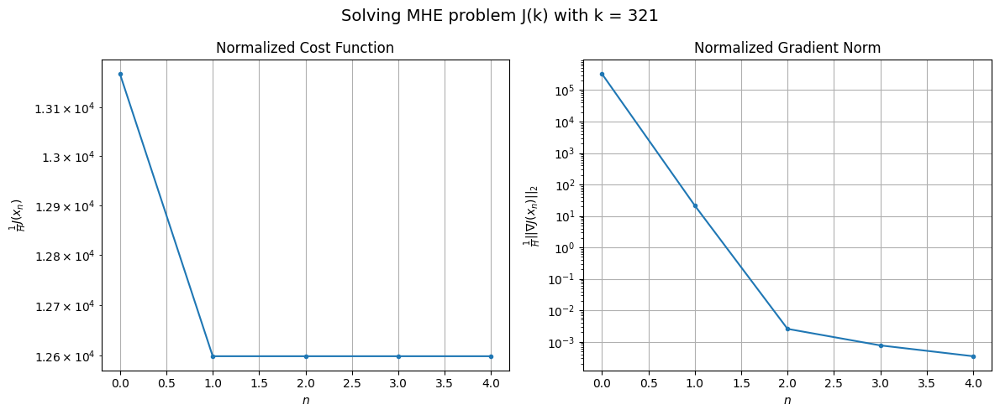

Windows:  80%|████████  | 293/366 [31:23<06:42,  5.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 370408.6065960718
Gradient norm: 9013139.60004103
Global estimation error: 48.54562024693153
Initial conditions estimation errors: 22.48749429917026 m, 23.196566766897458 m, 24.21691476809878 m, 26.951877340057862 m
Position estimation errors: 25.607883608282396 m, 25.998574134079313 m, 35.057378533104185 m, 29.015479949483172 m

[Gauss-Newton] Iteration 1
Cost function: 353973.3949345955 (-4.44%)
Gradient norm: 336.9768515022458 (-100.00%)
Global estimation error: 63.49434003626109 (30.79%)
Initial conditions estimation errors: 28.54858959477399 m, 28.68565856421014 m, 30.122742223068304 m, 38.55136002658028 m
Position estimation errors: 20.111122918425693 m, 20.75261062293903 m, 30.696061133269865 m, 27.104829627195066 m

[Gauss-Newton] Iteration 2
Cost function: 353973.39378300495 (-0.00%)
Gradient norm: 0.010456507602258714 (-100.00%)
Global estimation error: 63.46687043012829 (-0.04%)
Initial conditions estimation errors:

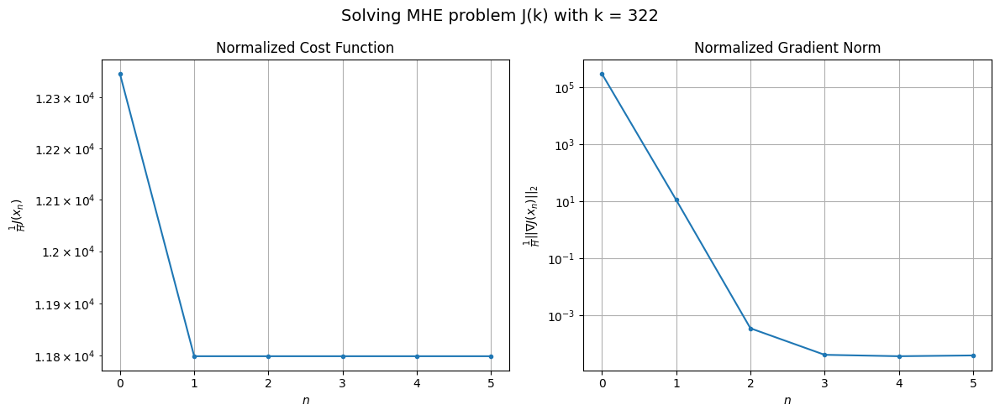

Windows:  80%|████████  | 294/366 [31:28<06:25,  5.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 340488.14241735113
Gradient norm: 8130099.467155735
Global estimation error: 52.26471854378175
Initial conditions estimation errors: 22.523574284019613 m, 22.631819421959875 m, 24.49864914774295 m, 33.34449387625558 m
Position estimation errors: 23.346606230061717 m, 23.490435200342283 m, 33.48439926221534 m, 28.354158294113635 m

[Gauss-Newton] Iteration 1
Cost function: 325235.48842236097 (-4.48%)
Gradient norm: 135.82380229383753 (-100.00%)
Global estimation error: 59.632334986415174 (14.10%)
Initial conditions estimation errors: 28.508638664316468 m, 28.372640668488888 m, 29.05112071288531 m, 33.07931092596044 m
Position estimation errors: 18.284248961214594 m, 17.043225112796463 m, 25.307686273636147 m, 24.802691920923778 m

[Gauss-Newton] Iteration 2
Cost function: 325235.48815838114 (-0.00%)
Gradient norm: 0.013354308390665226 (-99.99%)
Global estimation error: 59.63395776496431 (0.00%)
Initial conditions estimation err

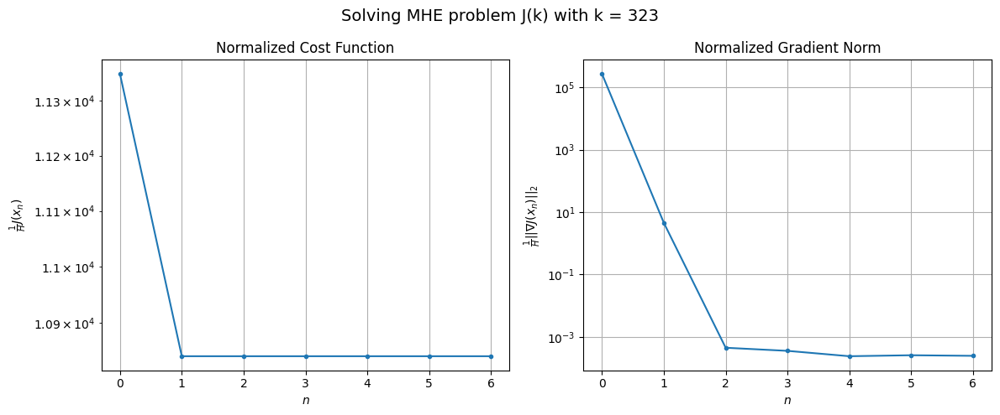

Windows:  81%|████████  | 295/366 [31:34<06:39,  5.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 306328.65154344554
Gradient norm: 7164962.426147307
Global estimation error: 47.26292123351741
Initial conditions estimation errors: 22.292438803944147 m, 22.353358518450566 m, 22.812495535869008 m, 26.771183221709556 m
Position estimation errors: 20.902593577610542 m, 19.01430258371964 m, 27.701658098311185 m, 25.598581617072917 m

[Gauss-Newton] Iteration 1
Cost function: 292405.1533981738 (-4.55%)
Gradient norm: 622.5944855819779 (-99.99%)
Global estimation error: 70.01092014434872 (48.13%)
Initial conditions estimation errors: 28.147355979584347 m, 35.24592751296184 m, 33.00724644363563 m, 42.15972942531049 m
Position estimation errors: 16.306518345571394 m, 18.12223125055352 m, 27.799377664794513 m, 27.221346549014363 m

[Gauss-Newton] Iteration 2
Cost function: 292405.13782855135 (-0.00%)
Gradient norm: 0.04115231313082849 (-99.99%)
Global estimation error: 70.2473723870471 (0.34%)
Initial conditions estimation errors: 2

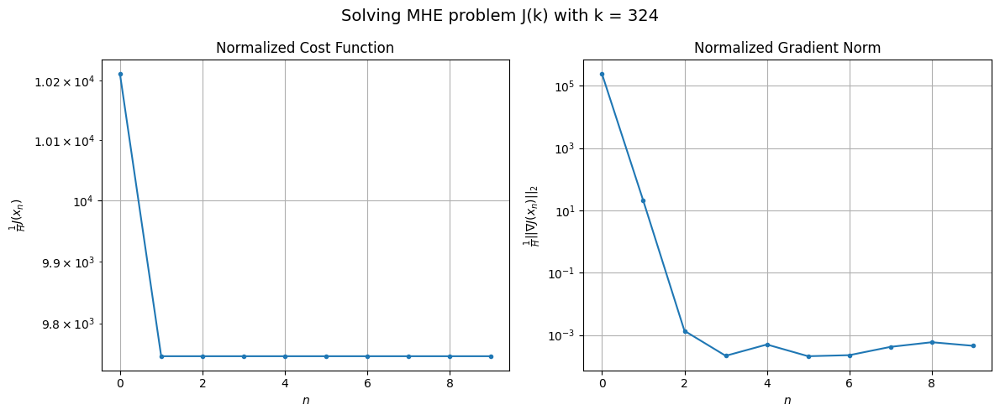

Windows:  81%|████████  | 296/366 [31:42<07:21,  6.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 269545.0782778337
Gradient norm: 6245006.002707415
Global estimation error: 59.30706431598639
Initial conditions estimation errors: 21.849192855550463 m, 30.471840371321953 m, 26.549874580711457 m, 37.502801156546404 m
Position estimation errors: 18.4009684928879 m, 19.598403800612083 m, 30.496160442160463 m, 28.688460158502398 m

[Gauss-Newton] Iteration 1
Cost function: 256811.32664220047 (-4.72%)
Gradient norm: 476.0675140124233 (-99.99%)
Global estimation error: 94.17464990522437 (58.79%)
Initial conditions estimation errors: 27.560253324406574 m, 43.47938883020798 m, 41.4844471148597 m, 67.06580402240941 m
Position estimation errors: 14.226355799128722 m, 17.810440051749072 m, 28.564980089527324 m, 31.154430340533445 m

[Gauss-Newton] Iteration 2
Cost function: 256811.31909467993 (-0.00%)
Gradient norm: 0.052766901682147295 (-99.99%)
Global estimation error: 94.49032654114077 (0.34%)
Initial conditions estimation errors: 

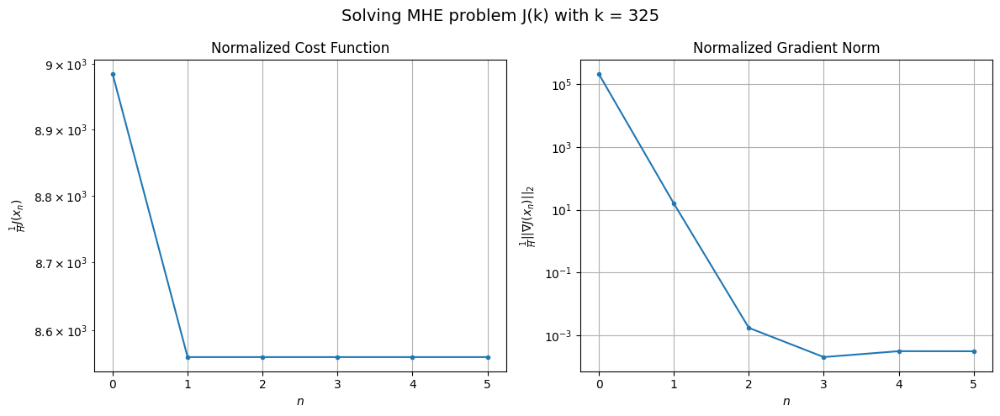

Windows:  81%|████████  | 297/366 [31:47<06:40,  5.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 231678.98643839033
Gradient norm: 5320021.642716309
Global estimation error: 86.39663158174643
Initial conditions estimation errors: 21.281736480248547 m, 39.687364571163464 m, 36.467470750723 m, 64.08159803419099 m
Position estimation errors: 15.893319844983022 m, 19.333245622255873 m, 31.69721580238273 m, 33.972988057670094 m

[Gauss-Newton] Iteration 1
Cost function: 220525.98946903044 (-4.81%)
Gradient norm: 654.168434255064 (-99.99%)
Global estimation error: 135.1019041698841 (56.37%)
Initial conditions estimation errors: 26.71996995419567 m, 56.287088748670165 m, 50.32928108288231 m, 108.79905330484524 m
Position estimation errors: 12.200547786233884 m, 29.71018938843703 m, 40.906833378261005 m, 62.46729406922489 m

[Gauss-Newton] Iteration 2
Cost function: 220525.97907508854 (-0.00%)
Gradient norm: 0.6915849963635357 (-99.89%)
Global estimation error: 136.6329913974625 (1.13%)
Initial conditions estimation errors: 26.71

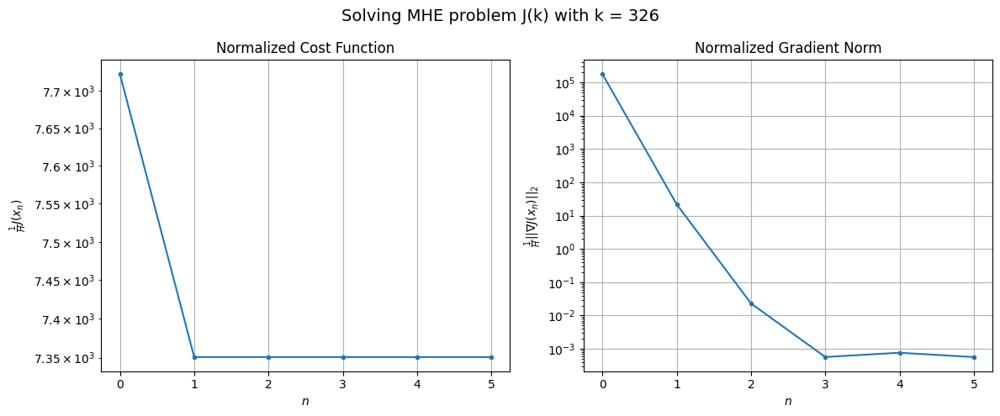

Windows:  81%|████████▏ | 298/366 [31:52<06:19,  5.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 194387.4262491349
Gradient norm: 4520421.49594701
Global estimation error: 128.98384609654175
Initial conditions estimation errors: 20.50393654457011 m, 52.81560982741949 m, 45.85769864639939 m, 106.41404698069906 m
Position estimation errors: 13.538937666556583 m, 31.835536898764165 m, 44.476707566860625 m, 67.5766502060298 m

[Gauss-Newton] Iteration 1
Cost function: 184568.93375458525 (-5.05%)
Gradient norm: 311.5666129955834 (-99.99%)
Global estimation error: 112.86160788363688 (-12.50%)
Initial conditions estimation errors: 25.669742557747128 m, 50.32791080841761 m, 44.33297461150945 m, 87.06567676497481 m
Position estimation errors: 10.252457596121344 m, 32.35915426687099 m, 45.903605388566454 m, 69.46476258376671 m

[Gauss-Newton] Iteration 2
Cost function: 184568.93191240152 (-0.00%)
Gradient norm: 0.029824552622905027 (-99.99%)
Global estimation error: 112.55024759673478 (-0.28%)
Initial conditions estimation errors: 

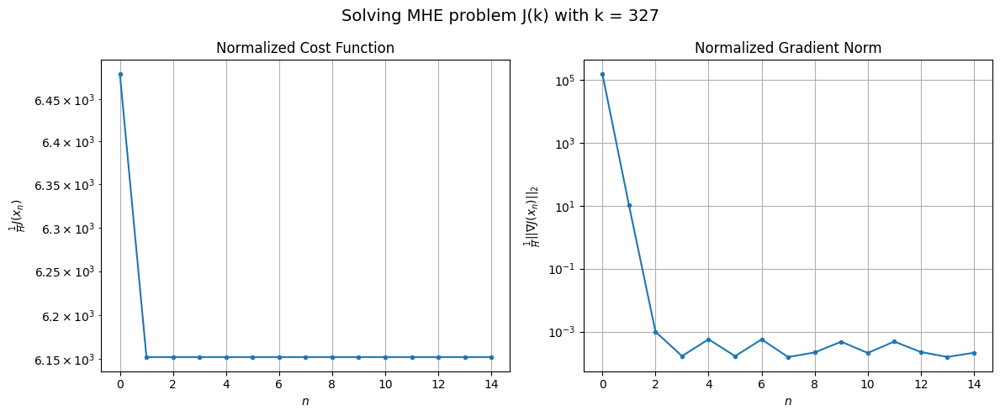

Windows:  82%|████████▏ | 299/366 [32:03<08:10,  7.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 158464.93349375873
Gradient norm: 3833702.3677037037
Global estimation error: 102.96773091700689
Initial conditions estimation errors: 19.516345471711105 m, 45.693896980915476 m, 38.949905827256615 m, 81.34113879312986 m
Position estimation errors: 11.38682711760142 m, 33.5926916984445 m, 48.59991103368854 m, 72.17590182460474 m

[Gauss-Newton] Iteration 1
Cost function: 149913.4653655439 (-5.40%)
Gradient norm: 2253.3974850426466 (-99.94%)
Global estimation error: 111.47979071867466 (8.27%)
Initial conditions estimation errors: 24.374479188669397 m, 48.73674296543385 m, 39.07744231883762 m, 89.05758670066595 m
Position estimation errors: 8.489393021840801 m, 22.101480128358176 m, 33.21196312869434 m, 36.40462176603267 m

[Gauss-Newton] Iteration 2
Cost function: 149913.4505903821 (-0.00%)
Gradient norm: 0.10770403132894193 (-100.00%)
Global estimation error: 111.9852379083735 (0.45%)
Initial conditions estimation errors: 24.3

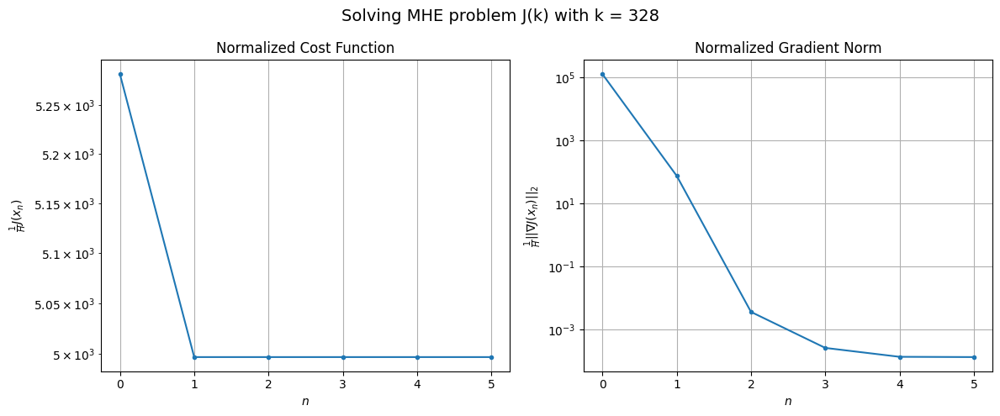

Windows:  82%|████████▏ | 300/366 [32:08<07:10,  6.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 125290.9720396359
Gradient norm: 3140272.866899141
Global estimation error: 105.02729353178096
Initial conditions estimation errors: 18.28782817650668 m, 44.87536694271965 m, 34.738618658459764 m, 86.46193559750341 m
Position estimation errors: 9.581608961232531 m, 23.70020808950011 m, 35.95221854268562 m, 40.48002461766335 m

[Gauss-Newton] Iteration 1
Cost function: 118058.31525484088 (-5.77%)
Gradient norm: 2418.342869204081 (-99.92%)
Global estimation error: 111.36032367399207 (6.03%)
Initial conditions estimation errors: 22.765925934875327 m, 47.13232238992889 m, 42.446448143584036 m, 88.65451108998619 m
Position estimation errors: 7.050563272165273 m, 10.185495610226488 m, 26.49058599781755 m, 5.873093558726209 m

[Gauss-Newton] Iteration 2
Cost function: 118058.29807783043 (-0.00%)
Gradient norm: 0.35885550627919155 (-99.99%)
Global estimation error: 112.34465092445133 (0.88%)
Initial conditions estimation errors: 22.76

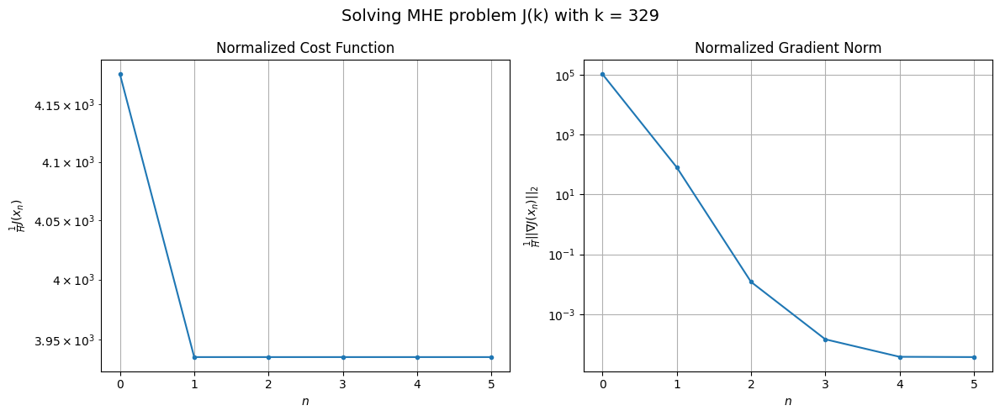

Windows:  82%|████████▏ | 301/366 [32:13<06:34,  6.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 95323.80118726591
Gradient norm: 2583966.740481787
Global estimation error: 108.4117774833729
Initial conditions estimation errors: 16.782671842445804 m, 44.31319154836886 m, 39.80982204592542 m, 89.0108297429513 m
Position estimation errors: 8.271401035025638 m, 12.226472274566193 m, 29.84812542506898 m, 7.334441354359609 m

[Gauss-Newton] Iteration 1
Cost function: 89202.20972741854 (-6.42%)
Gradient norm: 1225.9834178024848 (-99.95%)
Global estimation error: 162.3019568735012 (49.71%)
Initial conditions estimation errors: 20.88908081462356 m, 64.64877681360191 m, 57.39513321831714 m, 135.7639618061234 m
Position estimation errors: 6.05792105620604 m, 17.89004698019731 m, 32.53077257720112 m, 4.225909437975305 m

[Gauss-Newton] Iteration 2
Cost function: 89202.17631817274 (-0.00%)
Gradient norm: 0.1572003905168836 (-99.99%)
Global estimation error: 161.60486908966197 (-0.43%)
Initial conditions estimation errors: 20.88908088

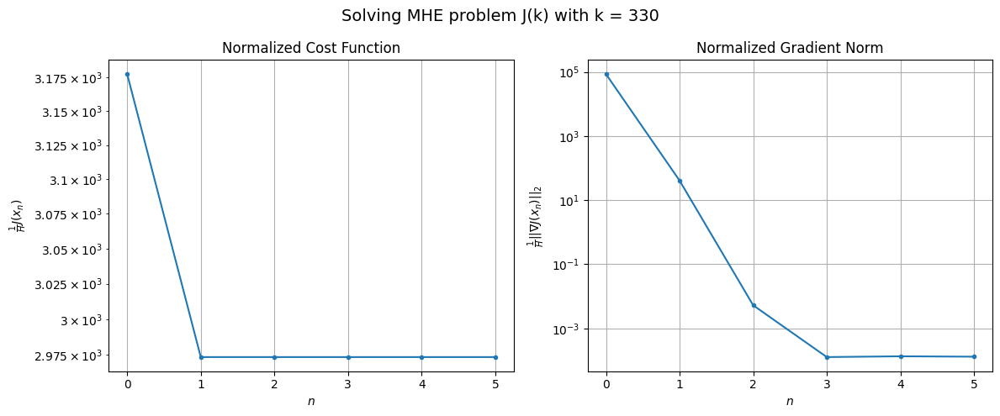

Windows:  83%|████████▎ | 302/366 [32:18<06:02,  5.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 70108.89387845738
Gradient norm: 2185817.8355279197
Global estimation error: 159.82872953525862
Initial conditions estimation errors: 15.06007817864163 m, 61.667142575159545 m, 55.47641291253394 m, 135.78624732244091 m
Position estimation errors: 7.534942705432038 m, 20.592365627503064 m, 36.66246628061024 m, 10.523323256914075 m

[Gauss-Newton] Iteration 1
Cost function: 65103.27390750828 (-7.14%)
Gradient norm: 1763.561506992064 (-99.92%)
Global estimation error: 107.82379517046013 (-32.54%)
Initial conditions estimation errors: 18.73224580262732 m, 44.10711718315018 m, 34.343365520857795 m, 90.27801880967408 m
Position estimation errors: 5.623448463705125 m, 17.585838395537888 m, 30.057947148860357 m, 20.115286108152514 m

[Gauss-Newton] Iteration 2
Cost function: 65103.21764605843 (-0.00%)
Gradient norm: 0.312768830975422 (-99.98%)
Global estimation error: 107.53126212661685 (-0.27%)
Initial conditions estimation errors: 1

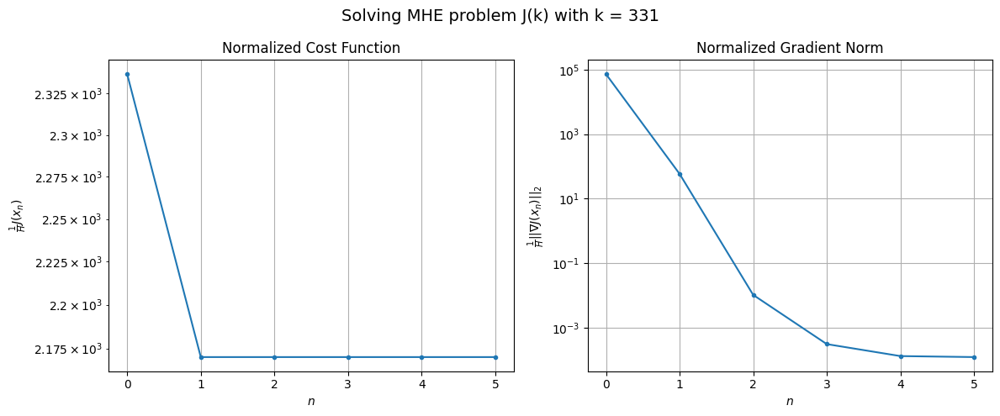

Windows:  83%|████████▎ | 303/366 [32:23<05:43,  5.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 50481.45794899816
Gradient norm: 1913423.2520722207
Global estimation error: 102.51570394635534
Initial conditions estimation errors: 13.138861684261673 m, 40.2247024183605 m, 32.09922406012507 m, 87.68360269744471 m
Position estimation errors: 7.395049662654121 m, 19.234786398646634 m, 33.080750795784546 m, 25.033429926126097 m

[Gauss-Newton] Iteration 1
Cost function: 46521.49900700777 (-7.84%)
Gradient norm: 3384.824762604301 (-99.82%)
Global estimation error: 106.28258835767737 (3.67%)
Initial conditions estimation errors: 16.345089225293737 m, 42.72288266651232 m, 32.95074204967614 m, 90.09872076406361 m
Position estimation errors: 5.743585634869376 m, 32.842546327525014 m, 41.99400654275544 m, 79.53612320037826 m

[Gauss-Newton] Iteration 2
Cost function: 46521.468936505924 (-0.00%)
Gradient norm: 0.21468540936861003 (-99.99%)
Global estimation error: 106.77187317527623 (0.46%)
Initial conditions estimation errors: 16.3

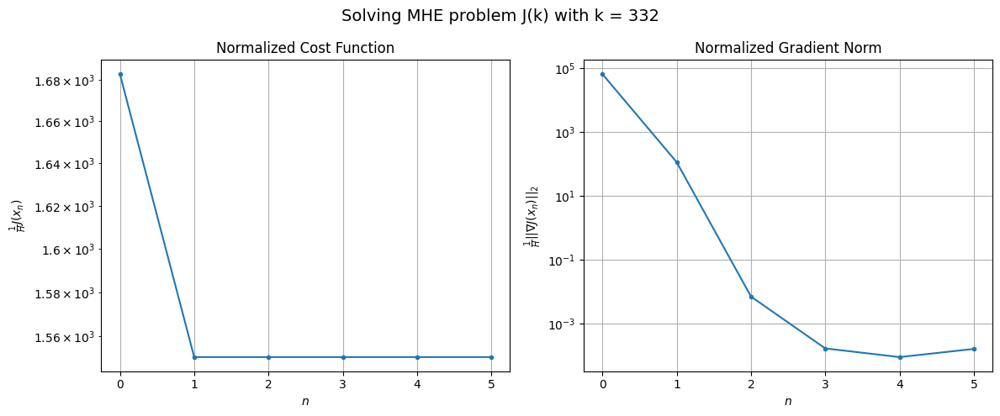

Windows:  83%|████████▎ | 304/366 [32:27<05:25,  5.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 36367.52414339528
Gradient norm: 1860339.400061755
Global estimation error: 98.20259611723743
Initial conditions estimation errors: 11.101021288846196 m, 38.29856489928731 m, 31.33231581249667 m, 84.09507122147534 m
Position estimation errors: 7.747967597360733 m, 33.638995720827 m, 44.78847142537605 m, 82.26017452687792 m

[Gauss-Newton] Iteration 1
Cost function: 33260.36142093753 (-8.54%)
Gradient norm: 2201.145679702788 (-99.88%)
Global estimation error: 33.72663800673143 (-65.66%)
Initial conditions estimation errors: 13.871471086588473 m, 19.198733346171913 m, 10.094226114195541 m, 21.78376081381818 m
Position estimation errors: 6.2686910059921965 m, 30.543521512366425 m, 34.187694795585706 m, 78.2876894151805 m

[Gauss-Newton] Iteration 2
Cost function: 33260.20946710092 (-0.00%)
Gradient norm: 0.504553324710213 (-99.98%)
Global estimation error: 33.25150829753481 (-1.41%)
Initial conditions estimation errors: 13.871471

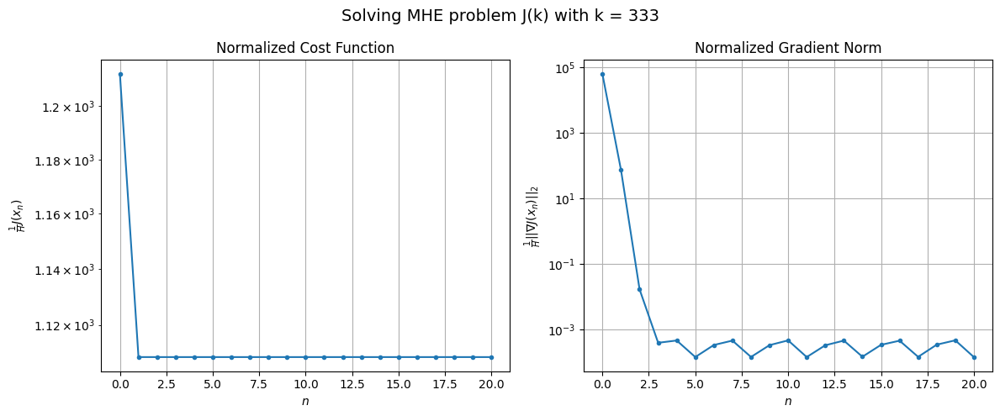

Windows:  83%|████████▎ | 305/366 [32:43<08:29,  8.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27212.30175092025
Gradient norm: 1840466.2207255226
Global estimation error: 21.493559344151848
Initial conditions estimation errors: 9.085747577314029 m, 13.047296731842605 m, 6.245883988889389 m, 13.043688799373427 m
Position estimation errors: 8.450050465054254 m, 29.59329540145346 m, 35.269058085653086 m, 75.74808646697224 m

[Gauss-Newton] Iteration 1
Cost function: 24714.112447479805 (-9.18%)
Gradient norm: 3271.095464744131 (-99.82%)
Global estimation error: 84.497790347096 (293.13%)
Initial conditions estimation errors: 11.497263030216551 m, 15.64860321995156 m, 31.11173592744585 m, 76.123680341633 m
Position estimation errors: 7.024483199498948 m, 30.47811140730041 m, 27.300388980266128 m, 80.4605517171619 m

[Gauss-Newton] Iteration 2
Cost function: 24713.861382284464 (-0.00%)
Gradient norm: 0.007640226081955634 (-100.00%)
Global estimation error: 84.48860520178613 (-0.01%)
Initial conditions estimation errors: 11.49

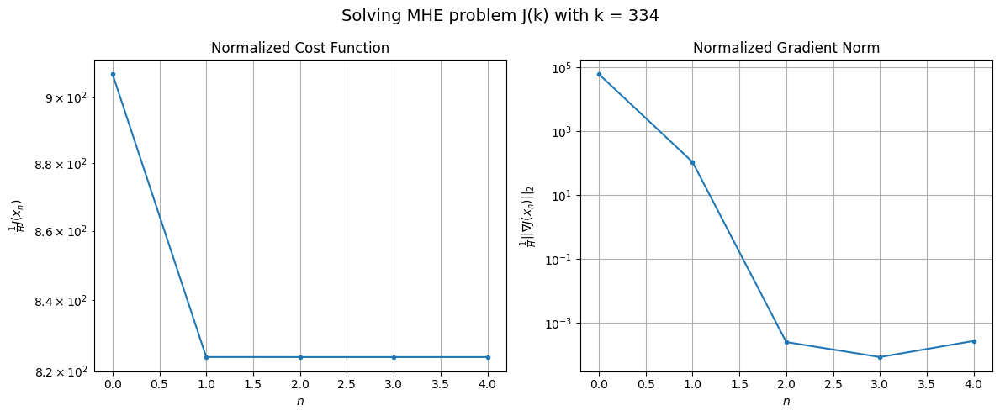

Windows:  84%|████████▎ | 306/366 [32:47<07:02,  7.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22670.015498389912
Gradient norm: 1903267.0477751899
Global estimation error: 91.57972011442497
Initial conditions estimation errors: 7.249911621007631 m, 17.210233066987104 m, 30.726438093138757 m, 84.22549084876997 m
Position estimation errors: 9.400069137566069 m, 27.721621968348735 m, 27.157963076331917 m, 71.66730110372325 m

[Gauss-Newton] Iteration 1
Cost function: 20649.22372733222 (-8.91%)
Gradient norm: 1337.1804643233102 (-99.93%)
Global estimation error: 156.2819891283957 (70.65%)
Initial conditions estimation errors: 9.344742302895515 m, 37.803735402363415 m, 55.30892443193368 m, 140.88464863604534 m
Position estimation errors: 7.9607788896294505 m, 20.463572285606954 m, 15.803440262130351 m, 68.67949866844224 m

[Gauss-Newton] Iteration 2
Cost function: 20649.16461520341 (-0.00%)
Gradient norm: 6.528880968462469 (-99.51%)
Global estimation error: 152.17684356411291 (-2.63%)
Initial conditions estimation errors: 9

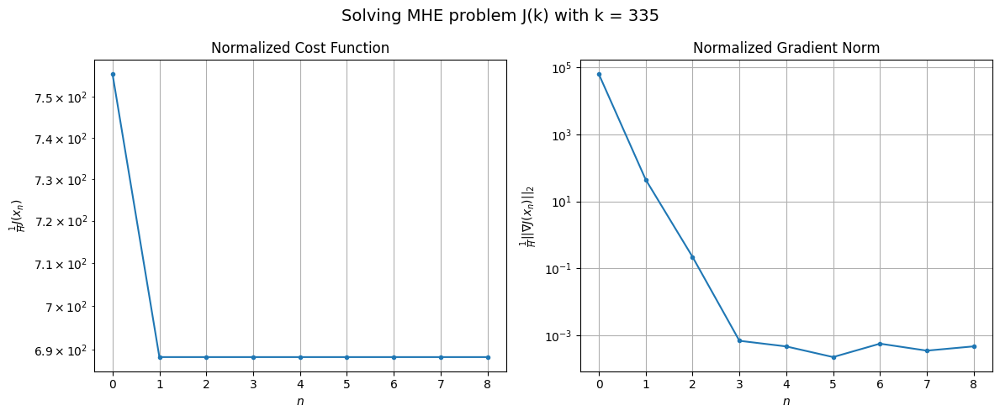

Windows:  84%|████████▍ | 307/366 [32:54<06:54,  7.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21845.817974766614
Gradient norm: 2252491.421373687
Global estimation error: 161.25863620142067
Initial conditions estimation errors: 5.689082456167422 m, 40.05747089589098 m, 53.683829385537074 m, 146.57894717843433 m
Position estimation errors: 10.557347143536184 m, 17.170010041487345 m, 16.123260775871437 m, 55.978101000722305 m

[Gauss-Newton] Iteration 1
Cost function: 20069.42907820179 (-8.13%)
Gradient norm: 1964.6837339493725 (-99.91%)
Global estimation error: 98.80887254818079 (-38.73%)
Initial conditions estimation errors: 7.586451195220866 m, 23.44995530066422 m, 36.738625676431084 m, 88.35145771957768 m
Position estimation errors: 9.04190006151177 m, 18.403024238363702 m, 16.759217192496095 m, 48.87090033485004 m

[Gauss-Newton] Iteration 2
Cost function: 20069.35633270337 (-0.00%)
Gradient norm: 6.666664575218055 (-99.66%)
Global estimation error: 102.45969305025586 (3.69%)
Initial conditions estimation errors: 7.

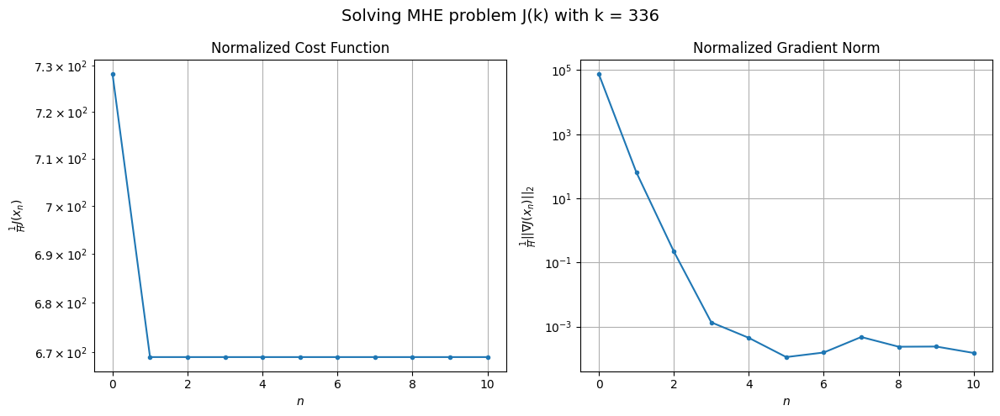

Windows:  84%|████████▍ | 308/366 [33:02<07:12,  7.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 24028.5517788589
Gradient norm: 2588254.0976170334
Global estimation error: 108.68650264610149
Initial conditions estimation errors: 4.570540012634275 m, 26.98387207155034 m, 37.24101538309498 m, 98.37082605648071 m
Position estimation errors: 11.81473868261397 m, 16.19122799109317 m, 17.482041836581494 m, 40.43348399227752 m

[Gauss-Newton] Iteration 1
Cost function: 22336.805482950087 (-7.04%)
Gradient norm: 624.4013490372934 (-99.98%)
Global estimation error: 155.11946832552366 (42.72%)
Initial conditions estimation errors: 6.361559218168723 m, 38.38998014281851 m, 47.82207465954948 m, 142.34047752901986 m
Position estimation errors: 10.180266823948674 m, 13.346784315847614 m, 14.799632948495299 m, 34.40419907779567 m

[Gauss-Newton] Iteration 2
Cost function: 22336.7919256086 (-0.00%)
Gradient norm: 0.865813830793371 (-99.86%)
Global estimation error: 153.9843398718382 (-0.73%)
Initial conditions estimation errors: 6.36155

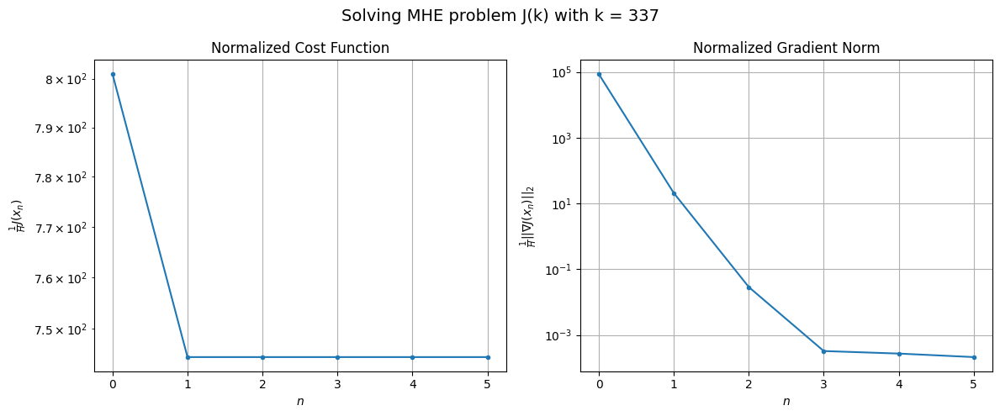

Windows:  84%|████████▍ | 309/366 [33:07<06:22,  6.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29107.26958185919
Gradient norm: 3217904.479445672
Global estimation error: 161.07845903763032
Initial conditions estimation errors: 4.029310087602129 m, 41.10370689963526 m, 47.13204502630358 m, 148.38824492295652 m
Position estimation errors: 13.075163317418777 m, 12.328686253806328 m, 15.955495305698152 m, 23.831394180005134 m

[Gauss-Newton] Iteration 1
Cost function: 27301.511339438723 (-6.20%)
Gradient norm: 225.30938735992984 (-99.99%)
Global estimation error: 183.15106632821931 (13.70%)
Initial conditions estimation errors: 5.770622395387853 m, 49.49607876699413 m, 61.50207049733233 m, 165.1624239313894 m
Position estimation errors: 11.257650230969626 m, 9.90330241641234 m, 12.692544691970213 m, 21.180301380180588 m

[Gauss-Newton] Iteration 2
Cost function: 27301.51002017477 (-0.00%)
Gradient norm: 8.87950070233357 (-96.06%)
Global estimation error: 178.9945335665743 (-2.27%)
Initial conditions estimation errors: 5.77

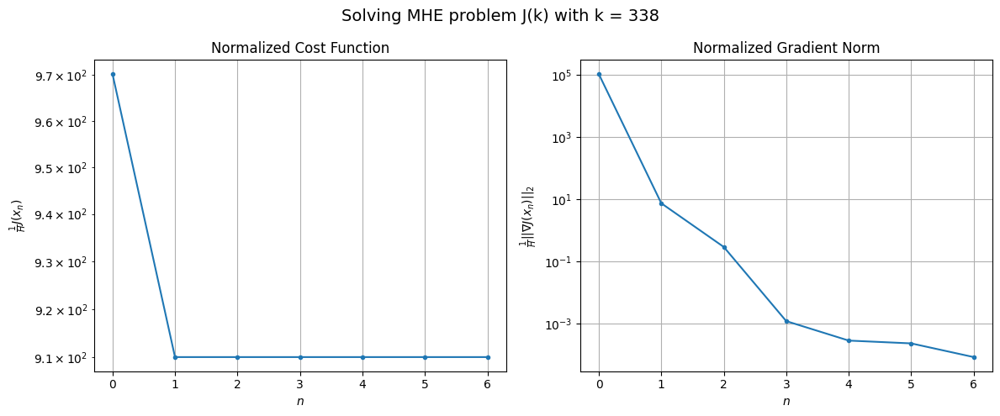

Windows:  85%|████████▍ | 310/366 [33:13<05:55,  6.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 35648.263603744315
Gradient norm: 3817313.3680722215
Global estimation error: 185.06897665978846
Initial conditions estimation errors: 4.032310991673163 m, 50.815658255360454 m, 59.733583396684445 m, 167.58258060096878 m
Position estimation errors: 14.245954539098006 m, 14.277238725345892 m, 14.74687745379253 m, 17.70424277371195 m

[Gauss-Newton] Iteration 1
Cost function: 33676.43288978286 (-5.53%)
Gradient norm: 328.5331078504125 (-99.99%)
Global estimation error: 221.72305957598587 (19.81%)
Initial conditions estimation errors: 5.707959291571121 m, 63.852378288051106 m, 70.17475691474367 m, 200.31699537438178 m
Position estimation errors: 12.251247297202541 m, 20.758215547258377 m, 17.25241593990217 m, 19.553917414228607 m

[Gauss-Newton] Iteration 2
Cost function: 33676.429232099945 (-0.00%)
Gradient norm: 5.1342958536374175 (-98.44%)
Global estimation error: 218.57700171448982 (-1.42%)
Initial conditions estimation error

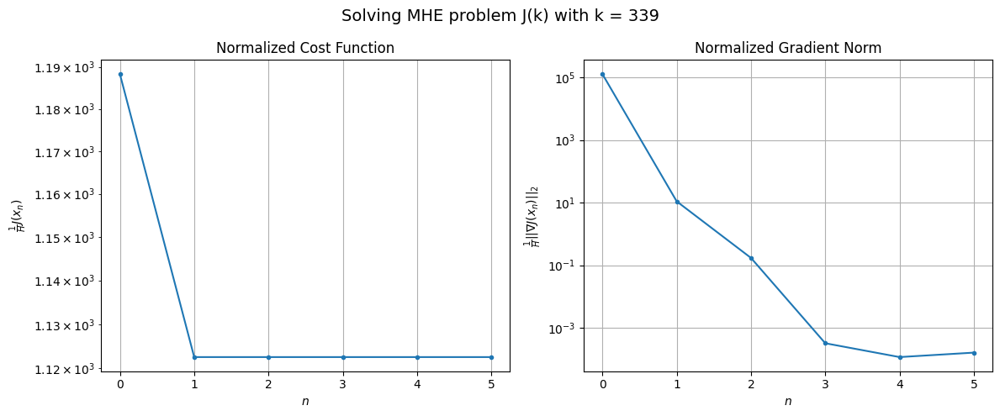

Windows:  85%|████████▍ | 311/366 [33:18<05:26,  5.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 43748.275335983824
Gradient norm: 4339914.720245384
Global estimation error: 223.17386788914342
Initial conditions estimation errors: 4.3329356573192515 m, 64.46226489257408 m, 68.49516397717474 m, 202.33838545430444 m
Position estimation errors: 15.355627671404694 m, 27.589883925491126 m, 19.333413600889763 m, 33.680257599253615 m

[Gauss-Newton] Iteration 1
Cost function: 41549.83264879049 (-5.03%)
Gradient norm: 14083.443342759438 (-99.68%)
Global estimation error: 67.99679028769147 (-69.53%)
Initial conditions estimation errors: 5.937821765998715 m, 19.598396480751802 m, 26.696262590026517 m, 59.089046166244 m
Position estimation errors: 13.166805111264852 m, 22.607755140885114 m, 11.671515316817645 m, 60.32298314989375 m

[Gauss-Newton] Iteration 2
Cost function: 41546.843313933336 (-0.01%)
Gradient norm: 71.84424852463307 (-99.49%)
Global estimation error: 76.85330075562604 (13.02%)
Initial conditions estimation errors: 

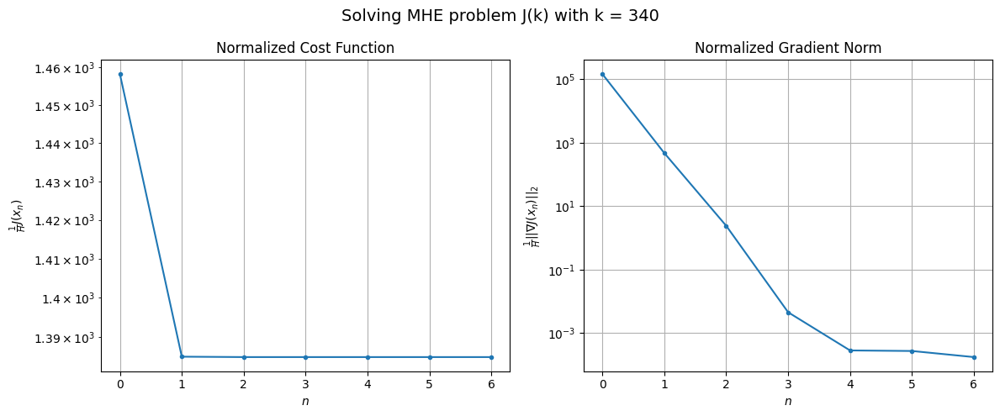

Windows:  85%|████████▌ | 312/366 [33:23<05:12,  5.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 53199.80909832049
Gradient norm: 4979863.780465444
Global estimation error: 74.92331478647635
Initial conditions estimation errors: 4.721005679820549 m, 21.842730628109322 m, 27.613661342383637 m, 65.9666120223437 m
Position estimation errors: 16.4118208553154 m, 26.55204757171644 m, 13.144949858928635 m, 63.09537078111786 m

[Gauss-Newton] Iteration 1
Cost function: 50724.53429154956 (-4.65%)
Gradient norm: 35176.067183778156 (-99.29%)
Global estimation error: 103.9601519451535 (38.76%)
Initial conditions estimation errors: 6.24689352150905 m, 25.410150648781126 m, 21.526736442632107 m, 98.28309903337421 m
Position estimation errors: 13.997398817516968 m, 42.7350311909765 m, 11.978201405567887 m, 160.92651044915974 m

[Gauss-Newton] Iteration 2
Cost function: 50714.101379928965 (-0.02%)
Gradient norm: 5.039523434246291 (-99.99%)
Global estimation error: 105.64520933810957 (1.62%)
Initial conditions estimation errors: 6.246893

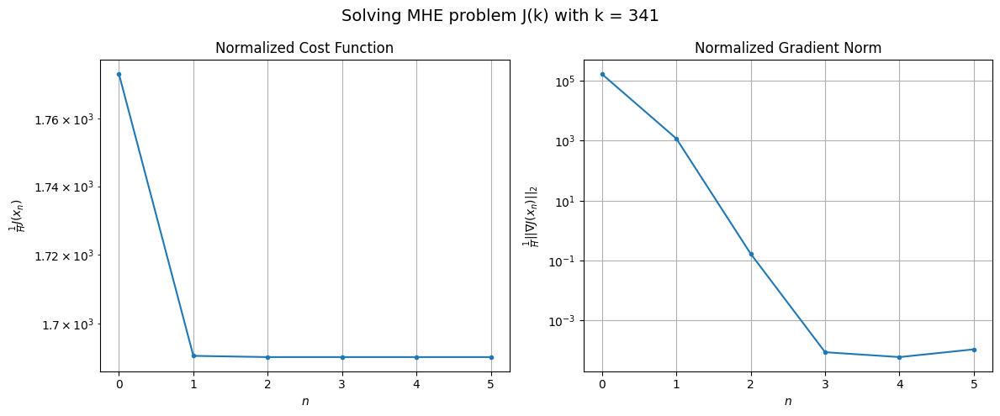

Windows:  86%|████████▌ | 313/366 [33:28<04:51,  5.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 63755.13982670618
Gradient norm: 5471481.692089757
Global estimation error: 117.48712073472521
Initial conditions estimation errors: 5.099128952565471 m, 28.01932849827579 m, 23.07879144822941 m, 111.62198085144749 m
Position estimation errors: 17.350244848240287 m, 42.29068919918324 m, 13.396036443838144 m, 149.85737261379543 m

[Gauss-Newton] Iteration 1
Cost function: 60934.73379345929 (-4.42%)
Gradient norm: 3875.021846296361 (-99.93%)
Global estimation error: 216.7226330004028 (84.47%)
Initial conditions estimation errors: 6.591311051238244 m, 53.29645680177847 m, 41.7933357941261 m, 205.7619924122813 m
Position estimation errors: 14.702895750973326 m, 40.43353469314582 m, 13.403169700282627 m, 152.7018968773143 m

[Gauss-Newton] Iteration 2
Cost function: 60934.409732100605 (-0.00%)
Gradient norm: 14.874614743913385 (-99.62%)
Global estimation error: 213.31264890902582 (-1.57%)
Initial conditions estimation errors: 6.591

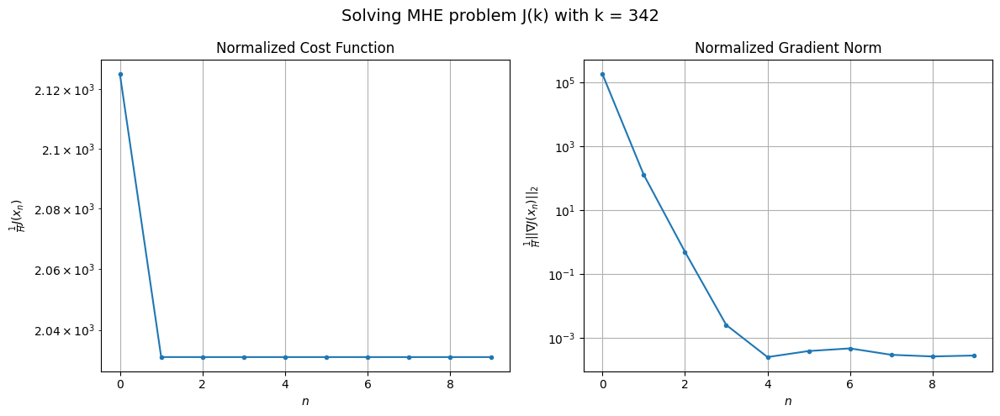

Windows:  86%|████████▌ | 314/366 [33:36<05:20,  6.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 75112.11962071154
Gradient norm: 5726248.083322929
Global estimation error: 227.29131030748619
Initial conditions estimation errors: 5.495386770971639 m, 55.05681671678032 m, 42.34419294776467 m, 216.34880156163146 m
Position estimation errors: 18.10019260384305 m, 38.892559375183296 m, 18.32729650734524 m, 134.97034770250266 m

[Gauss-Newton] Iteration 1
Cost function: 72032.7609533526 (-4.10%)
Gradient norm: 530.3636164650475 (-99.99%)
Global estimation error: 222.83832924930286 (-1.96%)
Initial conditions estimation errors: 6.948459964817225 m, 53.35851991347902 m, 42.896642613704906 m, 211.94650380196185 m
Position estimation errors: 15.264502856101721 m, 42.21341515945751 m, 14.809717657731683 m, 158.39003260091016 m

[Gauss-Newton] Iteration 2
Cost function: 72032.7602128026 (-0.00%)
Gradient norm: 0.5283983302756332 (-99.90%)
Global estimation error: 222.02656459508398 (-0.36%)
Initial conditions estimation errors: 6.94

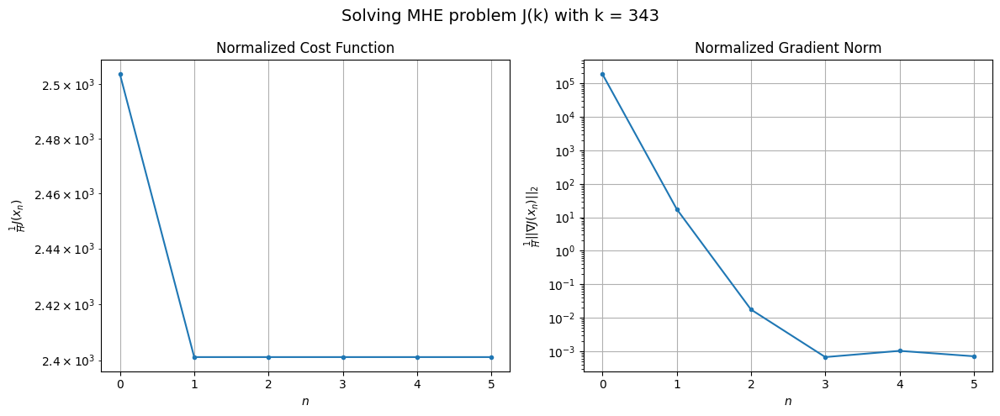

Windows:  86%|████████▌ | 315/366 [33:41<04:59,  5.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 86895.7715730055
Gradient norm: 5891883.364871184
Global estimation error: 236.43996074208903
Initial conditions estimation errors: 5.916783622615213 m, 55.902612791204135 m, 44.20927873723422 m, 225.3646533857836 m
Position estimation errors: 18.63564950147429 m, 40.579493219414616 m, 20.133174729706354 m, 141.46209467993208 m

[Gauss-Newton] Iteration 1
Cost function: 83607.74281697566 (-3.78%)
Gradient norm: 12076.951081735977 (-99.80%)
Global estimation error: 172.45052296785855 (-27.06%)
Initial conditions estimation errors: 7.329253102523524 m, 41.98335676966587 m, 33.71923050075058 m, 163.6638668054071 m
Position estimation errors: 15.64833246699399 m, 20.706328312596263 m, 26.117300967724116 m, 63.87519164533231 m

[Gauss-Newton] Iteration 2
Cost function: 83607.0395058155 (-0.00%)
Gradient norm: 1.345350939764394 (-99.99%)
Global estimation error: 174.3984595524037 (1.13%)
Initial conditions estimation errors: 7.32925

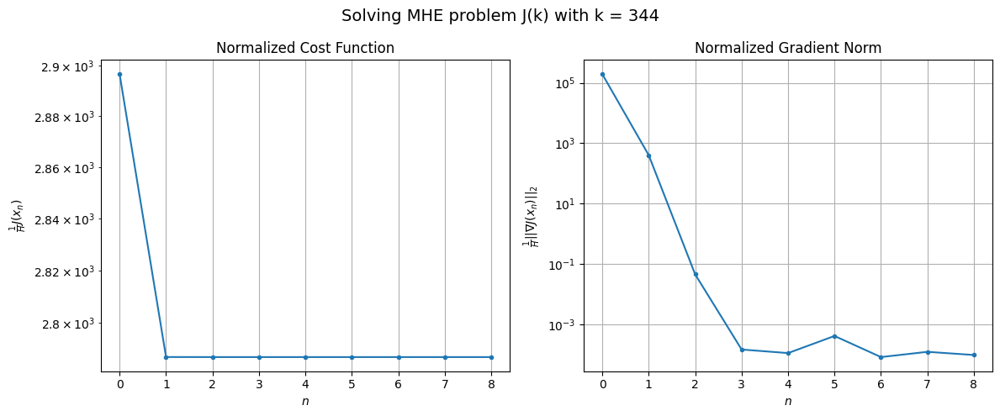

Windows:  86%|████████▋ | 316/366 [33:48<05:12,  6.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 98992.25853954178
Gradient norm: 6024747.376195625
Global estimation error: 180.86247617509053
Initial conditions estimation errors: 6.3574684908031935 m, 43.249947263584865 m, 34.565921193363955 m, 172.06232971189183 m
Position estimation errors: 18.934516349713327 m, 21.352322425006513 m, 31.73806627409711 m, 52.73655576426941 m

[Gauss-Newton] Iteration 1
Cost function: 95477.224423448 (-3.55%)
Gradient norm: 4113.668514226843 (-99.93%)
Global estimation error: 163.22244052128983 (-9.75%)
Initial conditions estimation errors: 7.761087890303257 m, 40.639697476380434 m, 28.39981637180995 m, 155.31643071922295 m
Position estimation errors: 15.810406396551695 m, 12.46420481369357 m, 35.03042251331498 m, 9.016833063273618 m

[Gauss-Newton] Iteration 2
Cost function: 95477.16475933805 (-0.00%)
Gradient norm: 0.8933512531300795 (-99.98%)
Global estimation error: 164.32563066649288 (0.68%)
Initial conditions estimation errors: 7.76

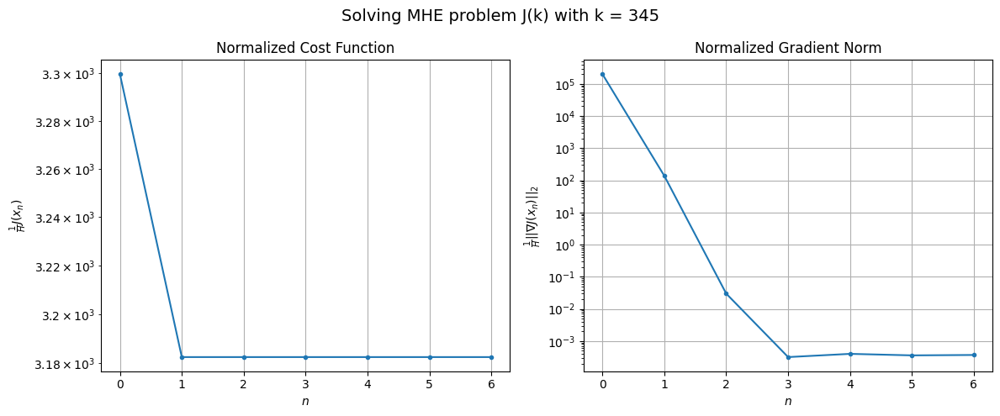

Windows:  87%|████████▋ | 317/366 [33:54<04:59,  6.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 110541.98014884754
Gradient norm: 5897113.120694996
Global estimation error: 165.45515995003726
Initial conditions estimation errors: 6.816321102648248 m, 40.23644838797366 m, 28.428234404513535 m, 157.8030737831563 m
Position estimation errors: 18.967810028611073 m, 15.32476087489544 m, 39.51845921204672 m, 15.841935012367788 m

[Gauss-Newton] Iteration 1
Cost function: 106963.88292005488 (-3.24%)
Gradient norm: 8770.431262811855 (-99.85%)
Global estimation error: 162.9138812724917 (-1.54%)
Initial conditions estimation errors: 8.216592646073938 m, 40.73850671711592 m, 28.085091817969985 m, 155.00003447533658 m
Position estimation errors: 15.801056998802382 m, 30.581240892650797 m, 53.847024884378555 m, 103.35822688617715 m

[Gauss-Newton] Iteration 2
Cost function: 106963.6637224602 (-0.00%)
Gradient norm: 13.948297794138597 (-99.84%)
Global estimation error: 161.0297118007657 (-1.16%)
Initial conditions estimation errors: 8

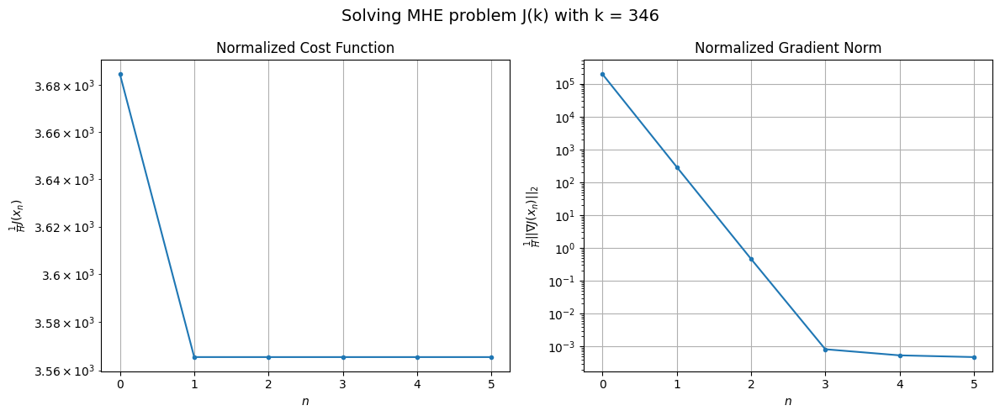

Windows:  87%|████████▋ | 318/366 [33:59<04:40,  5.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 121148.83562962493
Gradient norm: 5580254.367552706
Global estimation error: 154.32398534345197
Initial conditions estimation errors: 7.262630054265094 m, 37.617311075354785 m, 26.349753631834187 m, 147.15216902062116 m
Position estimation errors: 18.801756225490983 m, 32.7716380013883 m, 57.80903449532132 m, 112.43875698845743 m

[Gauss-Newton] Iteration 1
Cost function: 117645.74793578163 (-2.89%)
Gradient norm: 1259.9389818153388 (-99.98%)
Global estimation error: 106.0069364411705 (-31.31%)
Initial conditions estimation errors: 8.667698324908894 m, 21.389379503582127 m, 9.76290009588462 m, 103.00249132855897 m
Position estimation errors: 15.680511082296896 m, 17.774610693619685 m, 35.8631068486231 m, 80.04183495800815 m

[Gauss-Newton] Iteration 2
Cost function: 117645.73774352869 (-0.00%)
Gradient norm: 0.6213887929224299 (-99.95%)
Global estimation error: 105.0559691615775 (-0.90%)
Initial conditions estimation errors: 8

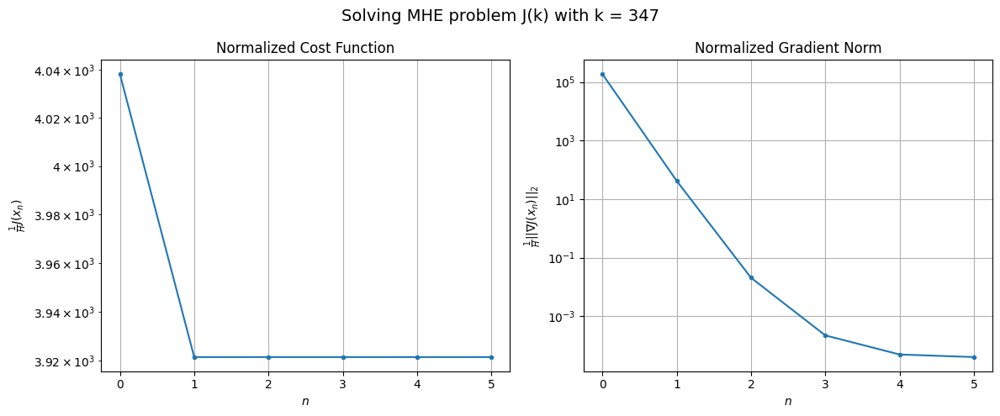

Windows:  87%|████████▋ | 319/366 [34:04<04:18,  5.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 130751.57576257648
Gradient norm: 5226492.580824939
Global estimation error: 99.45137601377468
Initial conditions estimation errors: 7.687454641454151 m, 19.0468778340218 m, 9.141587154038044 m, 96.876814396917 m
Position estimation errors: 18.508137089106675 m, 18.977628329597227 m, 38.50236782645626 m, 83.70868840488076 m

[Gauss-Newton] Iteration 1
Cost function: 127255.96855688476 (-2.67%)
Gradient norm: 37404.96563469909 (-99.28%)
Global estimation error: 28.714848754727285 (-71.13%)
Initial conditions estimation errors: 9.181839022265565 m, 5.014709300605061 m, 8.17654543594816 m, 25.458501244940674 m
Position estimation errors: 15.437364266099399 m, 52.64742512077779 m, 66.60456384860538 m, 222.2651953945661 m

[Gauss-Newton] Iteration 2
Cost function: 127249.40975977405 (-0.01%)
Gradient norm: 264.9167116691118 (-99.29%)
Global estimation error: 31.222831767825934 (8.73%)
Initial conditions estimation errors: 9.1818387

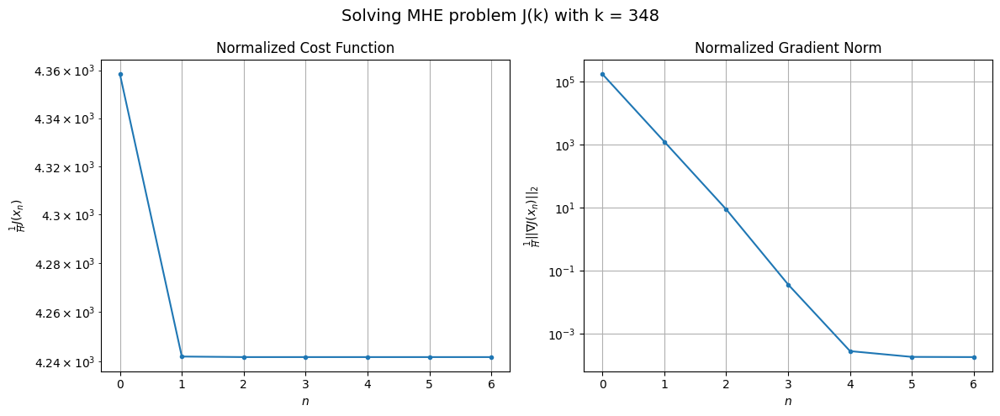

Windows:  87%|████████▋ | 320/366 [34:10<04:14,  5.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 139485.9930453305
Gradient norm: 4810808.134528616
Global estimation error: 43.50307739722544
Initial conditions estimation errors: 8.182817470930823 m, 11.093207478120737 m, 9.785114546935263 m, 40.08294163388253 m
Position estimation errors: 18.067654554016805 m, 53.6479303997138 m, 70.43748372110461 m, 228.4206216713569 m

[Gauss-Newton] Iteration 1
Cost function: 136048.97076765154 (-2.46%)
Gradient norm: 1385.6313824518293 (-99.97%)
Global estimation error: 27.462751370496353 (-36.87%)
Initial conditions estimation errors: 9.760672093823265 m, 7.692133879670908 m, 9.78508273452064 m, 22.448323730784168 m
Position estimation errors: 15.089578550133252 m, 54.14128045983603 m, 58.46040773623656 m, 211.85576093762063 m

[Gauss-Newton] Iteration 2
Cost function: 136048.9572423659 (-0.00%)
Gradient norm: 5.925694727750192 (-99.57%)
Global estimation error: 27.36842573314972 (-0.34%)
Initial conditions estimation errors: 9.76067

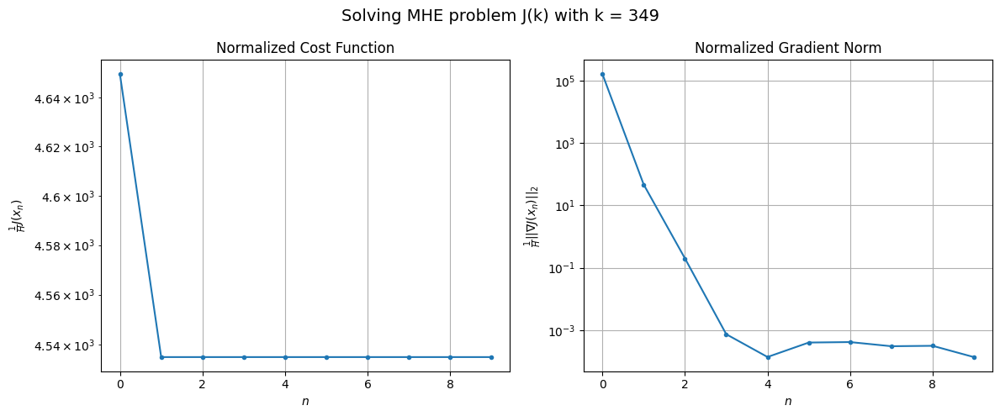

Windows:  88%|████████▊ | 321/366 [34:17<04:38,  6.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 146499.40740965895
Gradient norm: 4247218.128355689
Global estimation error: 29.45501878678261
Initial conditions estimation errors: 8.757342298157019 m, 4.315788003453102 m, 11.717425321250044 m, 25.19716809463879 m
Position estimation errors: 17.480664841872898 m, 51.10878384358355 m, 57.9400221355177 m, 202.86156814334612 m

[Gauss-Newton] Iteration 1
Cost function: 143176.96020993686 (-2.27%)
Gradient norm: 7642.106690555618 (-99.82%)
Global estimation error: 98.05681934130992 (232.90%)
Initial conditions estimation errors: 10.497403797915277 m, 21.653789971558947 m, 26.939944937222286 m, 91.16003171135318 m
Position estimation errors: 14.681546834452062 m, 65.72359533943673 m, 70.54135592621019 m, 249.3983220172924 m

[Gauss-Newton] Iteration 2
Cost function: 143176.52834676474 (-0.00%)
Gradient norm: 102.72286290721158 (-98.66%)
Global estimation error: 99.8338405384965 (1.81%)
Initial conditions estimation errors: 10.49

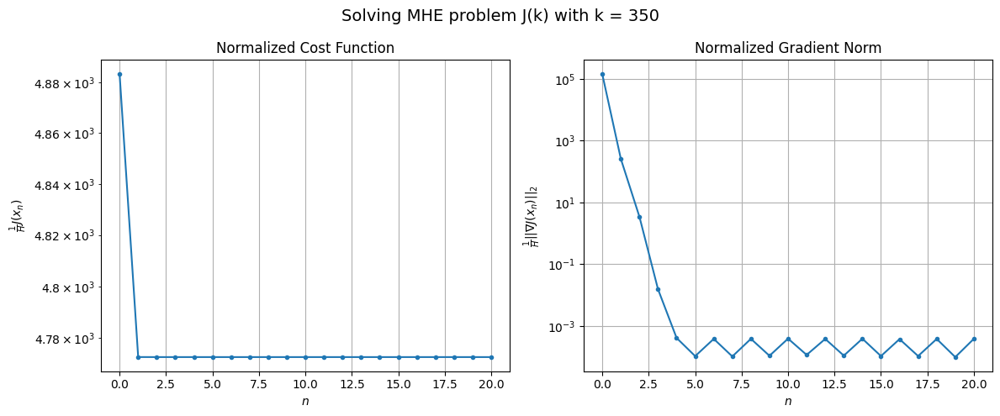

Windows:  88%|████████▊ | 322/366 [34:33<06:35,  9.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 151906.29958007124
Gradient norm: 3674297.684751356
Global estimation error: 121.61567399658027
Initial conditions estimation errors: 9.471757689208426 m, 28.706962292921 m, 30.359827074280627 m, 113.81871533062765 m
Position estimation errors: 16.788601257914074 m, 63.50405212427718 m, 71.58558322311166 m, 244.29904819571422 m

[Gauss-Newton] Iteration 1
Cost function: 148626.8620088113 (-2.16%)
Gradient norm: 708.1383106645716 (-99.98%)
Global estimation error: 82.66673674930612 (-32.03%)
Initial conditions estimation errors: 11.388055076058604 m, 17.357063482790558 m, 25.42976027218718 m, 75.8684755061628 m
Position estimation errors: 14.153787303698042 m, 66.36615213925967 m, 73.01229828922705 m, 240.9092314917482 m

[Gauss-Newton] Iteration 2
Cost function: 148626.85268803246 (-0.00%)
Gradient norm: 21.15560069305209 (-97.01%)
Global estimation error: 81.52506681442583 (-1.38%)
Initial conditions estimation errors: 11.388

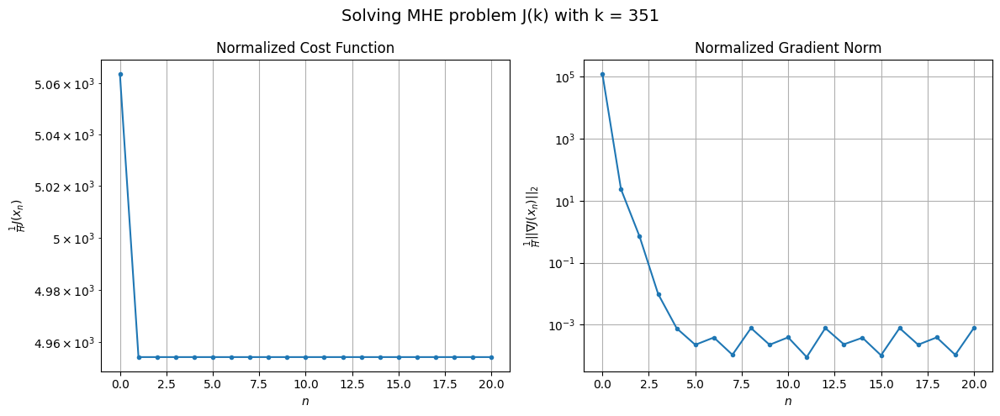

Windows:  88%|████████▊ | 323/366 [34:48<07:52, 10.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 154700.28822601982
Gradient norm: 2913685.288813081
Global estimation error: 100.16875058700523
Initial conditions estimation errors: 10.285404702813087 m, 23.175430988169516 m, 28.880505020294667 m, 92.50231336465113 m
Position estimation errors: 15.940883986823096 m, 60.462657445093775 m, 70.43196729846655 m, 223.86158085118333 m

[Gauss-Newton] Iteration 1
Cost function: 151503.8773594534 (-2.07%)
Gradient norm: 25323.24021131514 (-99.13%)
Global estimation error: 74.14274264704568 (-25.98%)
Initial conditions estimation errors: 12.402740908083866 m, 21.271976407509413 m, 36.06788245411114 m, 59.91576161503097 m
Position estimation errors: 13.539640557387717 m, 22.324386230688642 m, 31.441536804016494 m, 86.46850303906545 m

[Gauss-Newton] Iteration 2
Cost function: 151501.8648523164 (-0.00%)
Gradient norm: 348.00015833340757 (-98.63%)
Global estimation error: 69.31226807300445 (-6.52%)
Initial conditions estimation errors:

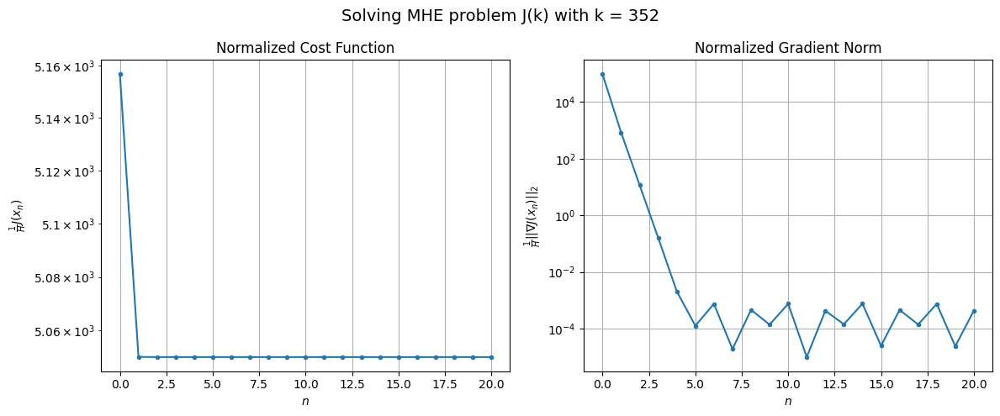

Windows:  89%|████████▊ | 324/366 [35:04<08:41, 12.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 155360.77862795602
Gradient norm: 2276316.392803224
Global estimation error: 75.14682045865227
Initial conditions estimation errors: 11.137186113481459 m, 22.766656002253573 m, 36.29462591708934 m, 60.72367330068132 m
Position estimation errors: 15.009523006216064 m, 16.39404396609625 m, 26.22501341870926 m, 62.74924222128355 m

[Gauss-Newton] Iteration 1
Cost function: 152264.60879920155 (-1.99%)
Gradient norm: 882.0219396316658 (-99.96%)
Global estimation error: 48.947825651294075 (-34.86%)
Initial conditions estimation errors: 13.389738688751384 m, 15.351263582866657 m, 32.9922144665615 m, 29.87344272165657 m
Position estimation errors: 12.838163464429078 m, 23.967102090042566 m, 31.58663320053772 m, 102.19197116987627 m

[Gauss-Newton] Iteration 2
Cost function: 152264.60557150847 (-0.00%)
Gradient norm: 1.9051534232232883 (-99.78%)
Global estimation error: 49.20752172984008 (0.53%)
Initial conditions estimation errors: 13

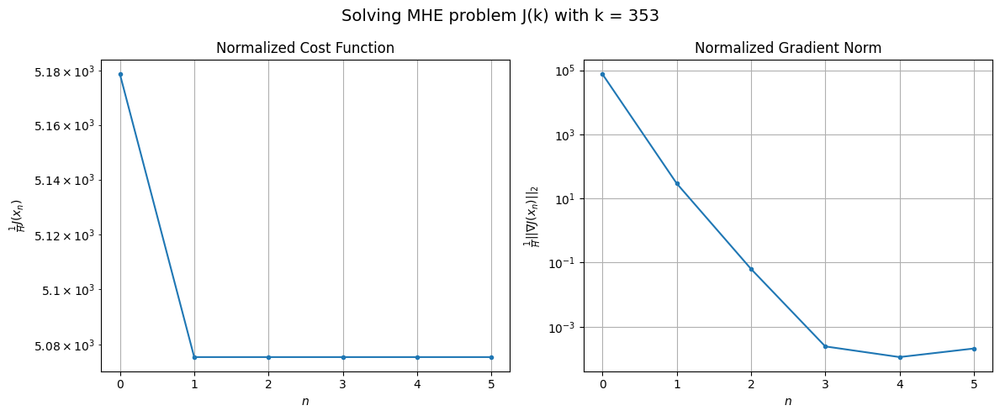

Windows:  89%|████████▉ | 325/366 [35:09<06:59, 10.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 153381.47760059877
Gradient norm: 1656850.745298279
Global estimation error: 54.15101314721597
Initial conditions estimation errors: 11.887528369980938 m, 17.549952393512793 m, 33.402126595217645 m, 36.976777259335805 m
Position estimation errors: 14.061597491762523 m, 20.433806979370697 m, 30.81566133683968 m, 94.28138176652901 m

[Gauss-Newton] Iteration 1
Cost function: 150367.63738501802 (-1.96%)
Gradient norm: 9831.61801363897 (-99.41%)
Global estimation error: 95.21312691769873 (75.83%)
Initial conditions estimation errors: 14.258033148466538 m, 25.25186352898302 m, 40.666391849225725 m, 81.06017707162253 m
Position estimation errors: 12.115652404147324 m, 40.452834434548926 m, 54.18131219240892 m, 166.1291565411183 m

[Gauss-Newton] Iteration 2
Cost function: 150367.23469745263 (-0.00%)
Gradient norm: 19.141830465095282 (-99.81%)
Global estimation error: 95.41541535824071 (0.21%)
Initial conditions estimation errors: 14

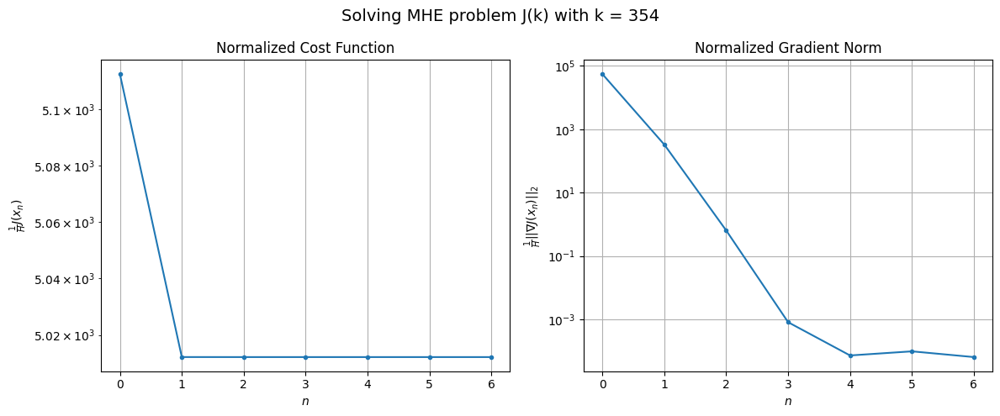

Windows:  89%|████████▉ | 326/366 [35:15<05:53,  8.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 148830.09709776597
Gradient norm: 1386207.2404849976
Global estimation error: 109.69839460908088
Initial conditions estimation errors: 12.478119006415957 m, 29.608720568679892 m, 42.44399106347319 m, 95.91549177025377 m
Position estimation errors: 13.246197544745009 m, 36.45761959824694 m, 54.20661290629867 m, 157.95671734411752 m

[Gauss-Newton] Iteration 1
Cost function: 145680.44005267255 (-2.12%)
Gradient norm: 222.12400071599623 (-99.98%)
Global estimation error: 80.47811356311148 (-26.64%)
Initial conditions estimation errors: 14.995079300044688 m, 22.250889009200172 m, 27.128782645528798 m, 70.85698884991294 m
Position estimation errors: 11.41946545944506 m, 40.495724040952176 m, 62.041680243079 m, 172.35905730559463 m

[Gauss-Newton] Iteration 2
Cost function: 145680.4364133853 (-0.00%)
Gradient norm: 3.2302513851940877 (-98.55%)
Global estimation error: 80.7890038185482 (0.39%)
Initial conditions estimation errors: 14

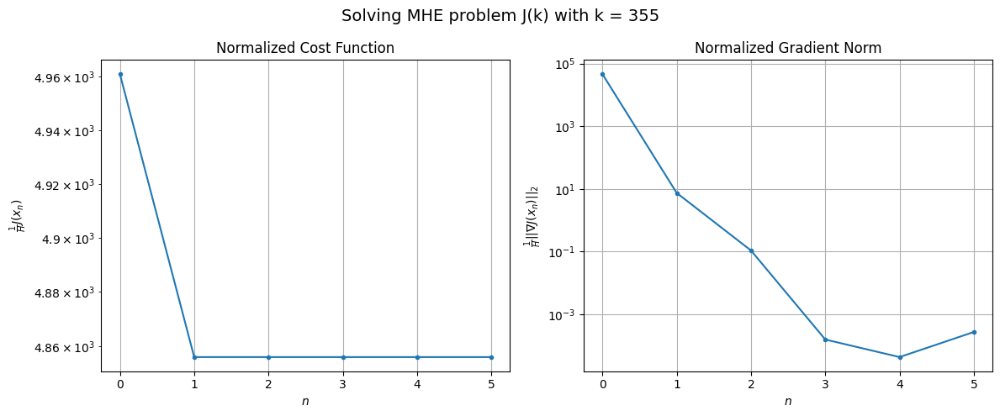

Windows:  89%|████████▉ | 327/366 [35:20<04:57,  7.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 142518.06770141004
Gradient norm: 1329387.4553433142
Global estimation error: 94.94436561489188
Initial conditions estimation errors: 12.922003156930256 m, 26.759012273705856 m, 29.27281008543 m, 85.29025177691233 m
Position estimation errors: 12.682308065537654 m, 34.47996448381023 m, 61.26967075111874 m, 158.79878888531346 m

[Gauss-Newton] Iteration 1
Cost function: 139318.9519266704 (-2.24%)
Gradient norm: 43526.7874632104 (-96.73%)
Global estimation error: 47.4370912321523 (-50.04%)
Initial conditions estimation errors: 15.495836684373236 m, 15.41743324256026 m, 30.261463803822267 m, 29.269314183821653 m
Position estimation errors: 10.93144697087497 m, 15.928174991307321 m, 9.619323070911902 m, 18.068393653279355 m

[Gauss-Newton] Iteration 2
Cost function: 139312.4670244544 (-0.00%)
Gradient norm: 66.21166635925822 (-99.85%)
Global estimation error: 45.314827764636846 (-4.47%)
Initial conditions estimation errors: 15.495

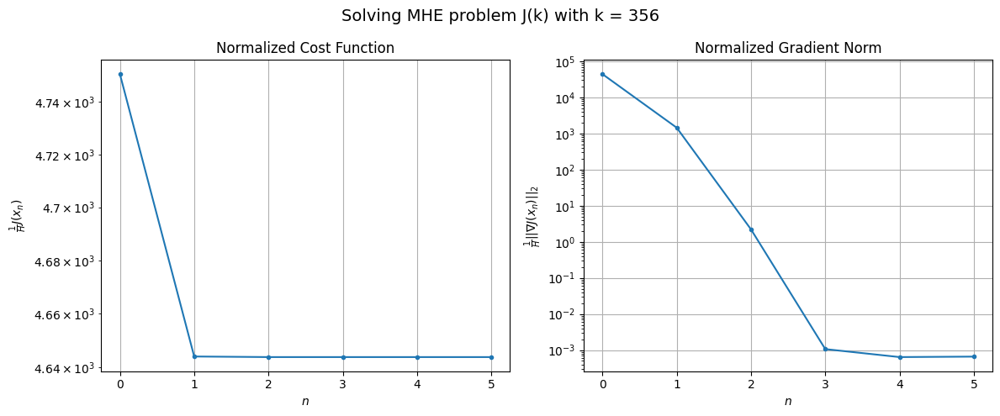

Windows:  90%|████████▉ | 328/366 [35:25<04:21,  6.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 134869.70706549863
Gradient norm: 1371470.4340231752
Global estimation error: 43.009843966506494
Initial conditions estimation errors: 13.150592481675737 m, 13.976629931729368 m, 27.551456234021067 m, 26.878785529194115 m
Position estimation errors: 12.539262704134147 m, 20.32789177257823 m, 8.700879647628232 m, 27.140366611349744 m

[Gauss-Newton] Iteration 1
Cost function: 131562.44521865784 (-2.45%)
Gradient norm: 27907.86517200247 (-97.97%)
Global estimation error: 106.12106561810087 (146.74%)
Initial conditions estimation errors: 15.769042131604962 m, 23.729890131447522 m, 36.185474617684626 m, 95.60577419338418 m
Position estimation errors: 10.806931935686443 m, 22.590546284665397 m, 43.665205267329895 m, 104.78412838350745 m

[Gauss-Newton] Iteration 2
Cost function: 131559.3012472404 (-0.00%)
Gradient norm: 0.9169368670051857 (-100.00%)
Global estimation error: 105.12359632662498 (-0.94%)
Initial conditions estimation 

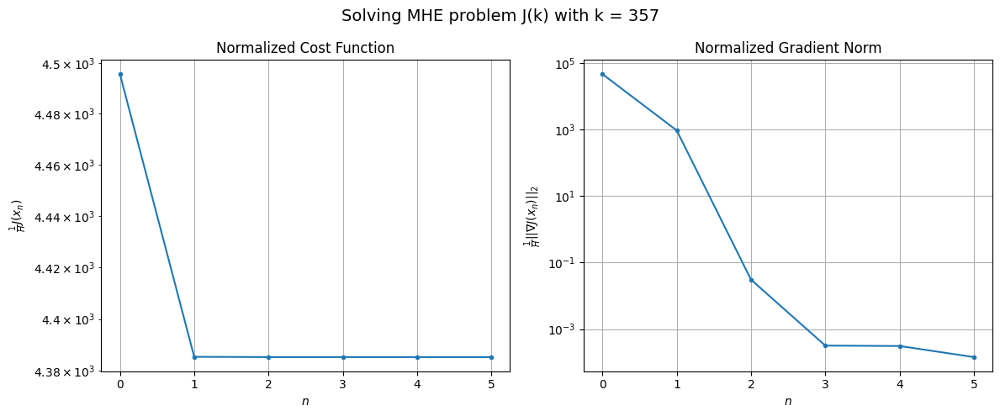

Windows:  90%|████████▉ | 329/366 [35:30<03:51,  6.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 127606.48621600277
Gradient norm: 1454816.8074175883
Global estimation error: 115.99273678191715
Initial conditions estimation errors: 13.192243320199816 m, 26.667806586008176 m, 36.050127955827044 m, 106.15762926803042 m
Position estimation errors: 12.863168436012815 m, 16.921154902654116 m, 43.9657657060454 m, 91.87276120871755 m

[Gauss-Newton] Iteration 1
Cost function: 124227.54439904203 (-2.65%)
Gradient norm: 25888.221542042345 (-98.22%)
Global estimation error: 77.80202143334289 (-32.93%)
Initial conditions estimation errors: 15.785074934037157 m, 19.074519754526182 m, 48.07648465638218 m, 55.935551018756975 m
Position estimation errors: 11.072595344221007 m, 24.147591318716454 m, 10.546668339174955 m, 36.27321118505561 m

[Gauss-Newton] Iteration 2
Cost function: 124225.26980001702 (-0.00%)
Gradient norm: 34.317380161447325 (-99.87%)
Global estimation error: 76.90334240275067 (-1.16%)
Initial conditions estimation err

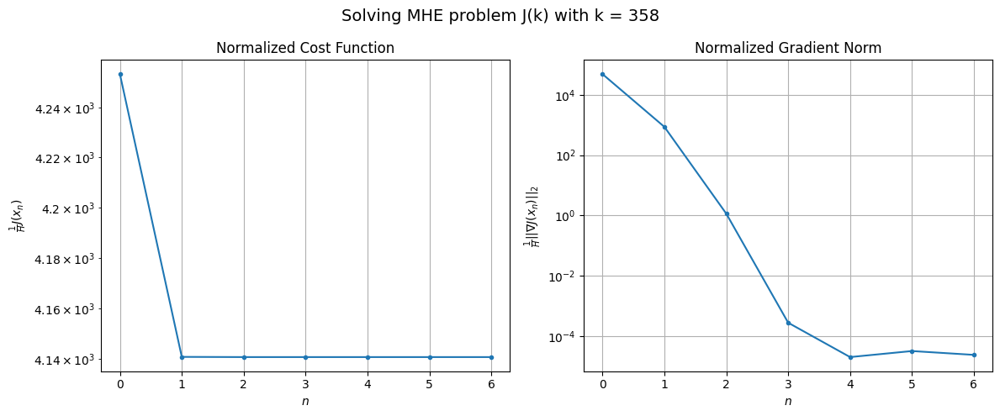

Windows:  90%|█████████ | 330/366 [35:35<03:35,  5.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 120831.17902501299
Gradient norm: 1488315.791146354
Global estimation error: 74.56782033260436
Initial conditions estimation errors: 13.034297296663093 m, 18.197346623703186 m, 45.05659175043252 m, 55.03828653938772 m
Position estimation errors: 13.556237301772144 m, 29.59453170605788 m, 11.192405407651869 m, 47.175731369090855 m

[Gauss-Newton] Iteration 1
Cost function: 117349.71337848321 (-2.88%)
Gradient norm: 1077.454764456307 (-99.93%)
Global estimation error: 58.65118467907528 (-21.35%)
Initial conditions estimation errors: 15.613073364650713 m, 15.162079800230213 m, 31.19102939991297 m, 44.64759477151708 m
Position estimation errors: 11.694971721095255 m, 16.276035059643778 m, 8.029058363467861 m, 16.296833981205435 m

[Gauss-Newton] Iteration 2
Cost function: 117349.7092452017 (-0.00%)
Gradient norm: 3.3048982273568894 (-99.69%)
Global estimation error: 58.087247936322065 (-0.96%)
Initial conditions estimation errors:

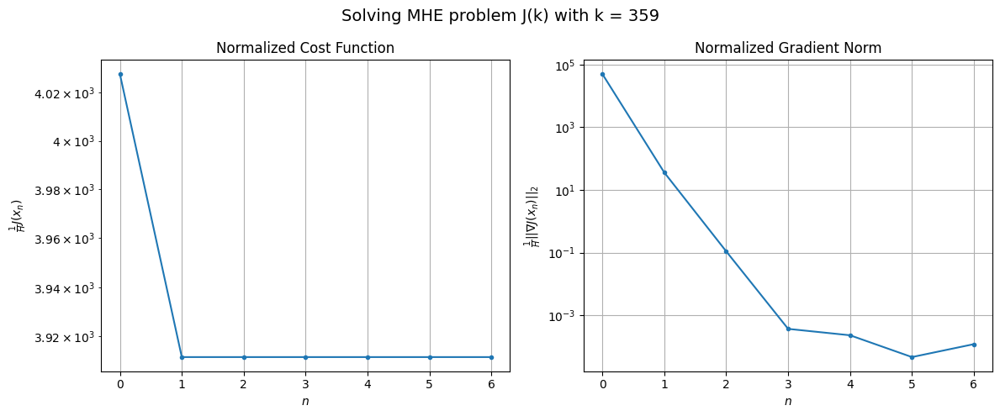

Windows:  90%|█████████ | 331/366 [35:40<03:24,  5.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 115807.34234313645
Gradient norm: 1503643.9221688602
Global estimation error: 57.361148071868456
Initial conditions estimation errors: 12.743142295538494 m, 13.719295845884345 m, 27.72805134043926 m, 46.59220692560107 m
Position estimation errors: 14.51381487970633 m, 19.321371050708144 m, 10.454493281584433 m, 20.692307458784203 m

[Gauss-Newton] Iteration 1
Cost function: 112267.57594678011 (-3.06%)
Gradient norm: 718.4648613452093 (-99.95%)
Global estimation error: 32.078217496250765 (-44.08%)
Initial conditions estimation errors: 15.25646095710639 m, 16.27252784134349 m, 14.52391976063086 m, 17.902317681155466 m
Position estimation errors: 12.550227731887922 m, 3.334726890595564 m, 25.138859832912463 m, 13.102747553621587 m

[Gauss-Newton] Iteration 2
Cost function: 112267.57016894115 (-0.00%)
Gradient norm: 5.470844647542198 (-99.24%)
Global estimation error: 32.080693280463294 (0.01%)
Initial conditions estimation errors

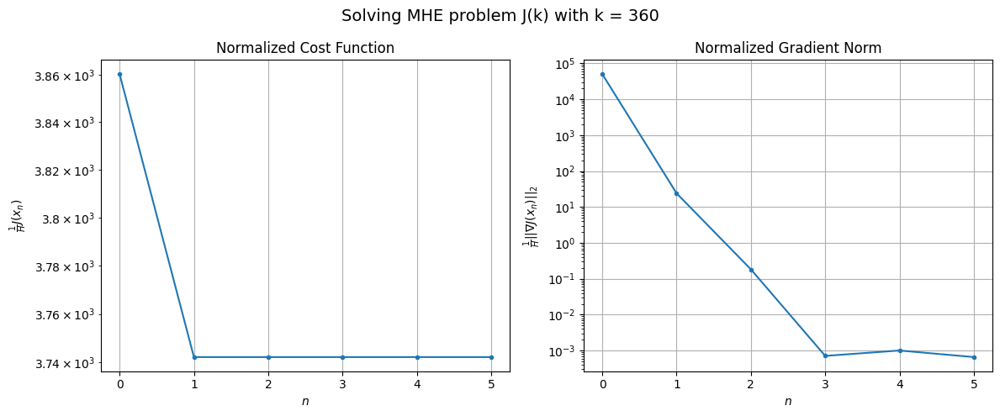

Windows:  91%|█████████ | 332/366 [35:46<03:10,  5.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 112494.47897392933
Gradient norm: 1515857.6540204172
Global estimation error: 28.54130258637154
Initial conditions estimation errors: 12.33049211354941 m, 12.651973081631992 m, 12.004525725720788 m, 18.93052296926784 m
Position estimation errors: 15.588016513148695 m, 5.005178167247108 m, 29.06957938712384 m, 10.60506521996229 m

[Gauss-Newton] Iteration 1
Cost function: 108793.492014179 (-3.29%)
Gradient norm: 34986.61262392542 (-97.69%)
Global estimation error: 43.60521631958868 (52.78%)
Initial conditions estimation errors: 14.8160510162214 m, 14.895252209906944 m, 36.06817699224152 m, 12.612642638109298 m
Position estimation errors: 13.504978139767875 m, 65.97906973597483 m, 45.89152274669038 m, 150.51751239912744 m

[Gauss-Newton] Iteration 2
Cost function: 108790.01663705875 (-0.00%)
Gradient norm: 57.16122537259633 (-99.84%)
Global estimation error: 46.46305993056252 (6.55%)
Initial conditions estimation errors: 14.8160

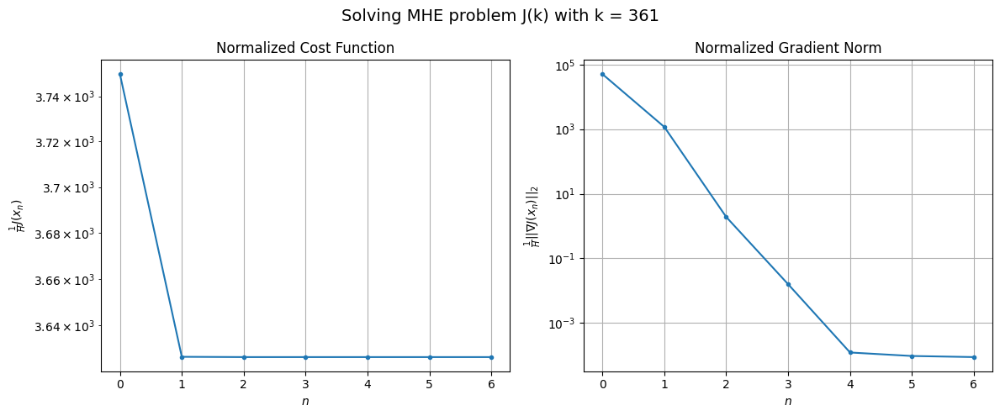

Windows:  91%|█████████ | 333/366 [35:51<03:01,  5.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 111476.97563679979
Gradient norm: 1540682.3985378435
Global estimation error: 38.68604384508349
Initial conditions estimation errors: 11.895449616493146 m, 12.11737930420624 m, 32.79620550120167 m, 11.51712089932282 m
Position estimation errors: 16.65751056050701 m, 72.27778551600137 m, 47.35239055326457 m, 158.96078946852552 m

[Gauss-Newton] Iteration 1
Cost function: 107636.34616413983 (-3.45%)
Gradient norm: 14445.100600682877 (-99.06%)
Global estimation error: 106.24305299753472 (174.63%)
Initial conditions estimation errors: 14.330882848101485 m, 31.704103013468032 m, 72.83254528369375 m, 69.0823943598863 m
Position estimation errors: 14.448333695629291 m, 117.42512413156 m, 114.50931361493875 m, 277.8447888810187 m

[Gauss-Newton] Iteration 2
Cost function: 107635.79016145531 (-0.00%)
Gradient norm: 62.56749038401191 (-99.57%)
Global estimation error: 112.34382143194014 (5.74%)
Initial conditions estimation errors: 14.3

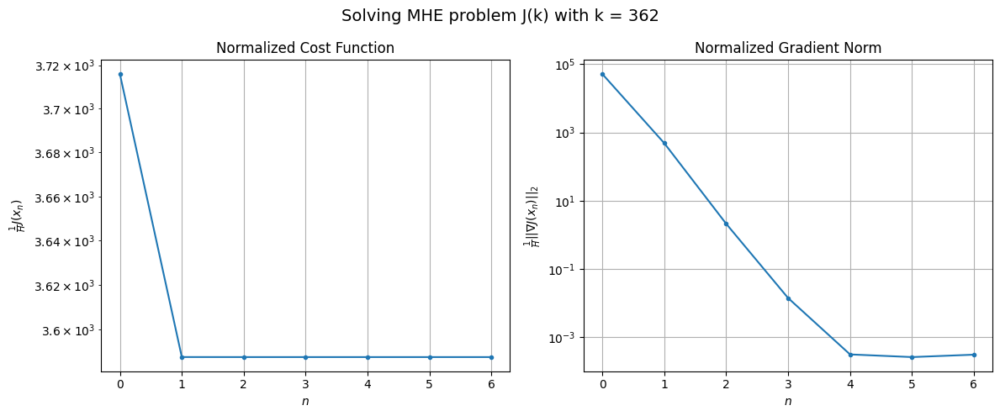

Windows:  91%|█████████▏| 334/366 [35:56<02:56,  5.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 112779.79614164971
Gradient norm: 1575582.5190788147
Global estimation error: 93.75081595360639
Initial conditions estimation errors: 11.48067732873785 m, 28.936229993369015 m, 66.02579122018122 m, 58.826715757538274 m
Position estimation errors: 17.64946399952459 m, 124.6241396172432 m, 116.93663595849578 m, 288.79084320511384 m

[Gauss-Newton] Iteration 1
Cost function: 108909.31948407514 (-3.43%)
Gradient norm: 754.7064463564556 (-99.95%)
Global estimation error: 72.51473920642326 (-22.65%)
Initial conditions estimation errors: 13.831964026732017 m, 15.348673870108016 m, 61.521303499044194 m, 32.349870849957895 m
Position estimation errors: 15.34301040565244 m, 106.04780201766232 m, 111.42924482930638 m, 251.8357120083805 m

[Gauss-Newton] Iteration 2
Cost function: 108909.3173947069 (-0.00%)
Gradient norm: 1.060611739293956 (-99.86%)
Global estimation error: 72.24725015691237 (-0.37%)
Initial conditions estimation errors: 

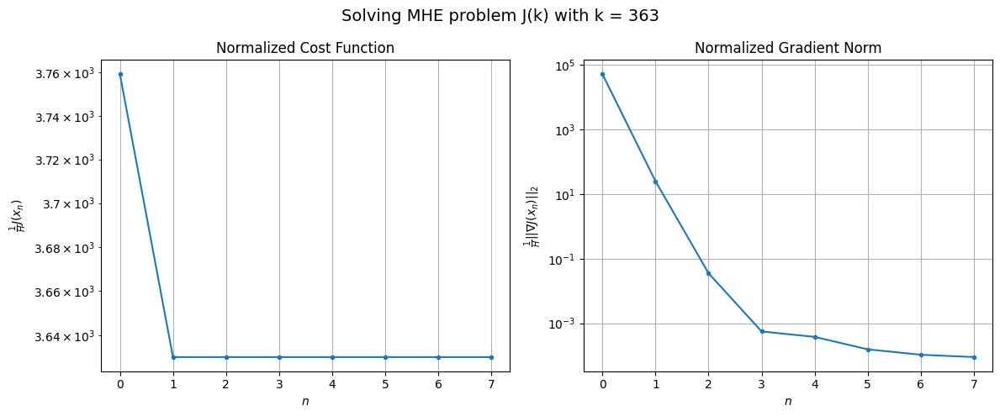

Windows:  92%|█████████▏| 335/366 [36:03<02:57,  5.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116760.29714154146
Gradient norm: 1651423.9990871735
Global estimation error: 57.31111669630278
Initial conditions estimation errors: 11.102093418015215 m, 10.642863880791051 m, 51.401534604734394 m, 20.14496451757907 m
Position estimation errors: 18.56112351552039 m, 108.00413883669711 m, 108.02278361593919 m, 250.81341608810212 m

[Gauss-Newton] Iteration 1
Cost function: 112763.70041425896 (-3.42%)
Gradient norm: 1841.5363367005716 (-99.89%)
Global estimation error: 55.910113752251235 (-2.44%)
Initial conditions estimation errors: 13.397704614270754 m, 9.47706081918635 m, 47.46195684516569 m, 24.574720752144835 m
Position estimation errors: 16.123715272975943 m, 93.10286879220347 m, 93.5718776095416 m, 213.23258751903214 m

[Gauss-Newton] Iteration 2
Cost function: 112763.6891939383 (-0.00%)
Gradient norm: 8.00147939630677 (-99.57%)
Global estimation error: 54.54183233977717 (-2.45%)
Initial conditions estimation errors: 13

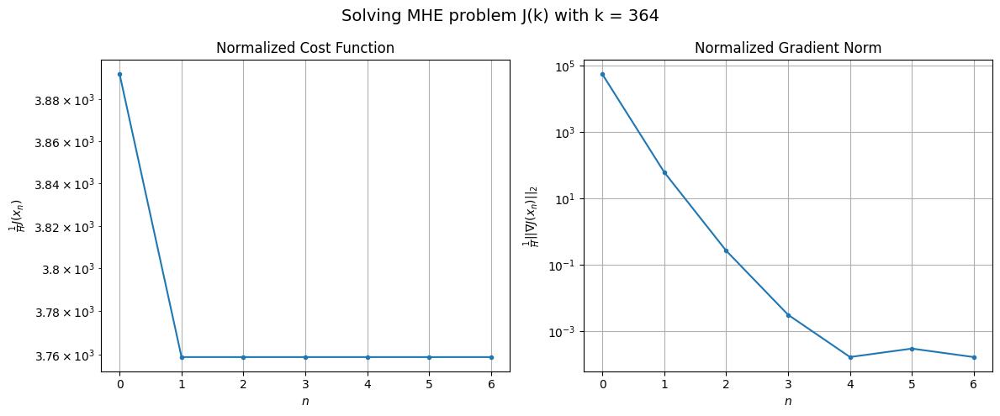

Windows:  92%|█████████▏| 336/366 [36:08<02:52,  5.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 122340.41616151808
Gradient norm: 1717156.4854794627
Global estimation error: 42.475650175275256
Initial conditions estimation errors: 10.849221987802204 m, 7.233535271942031 m, 37.62480604131801 m, 14.780128582357351 m
Position estimation errors: 19.330495139557133 m, 93.9129557719894 m, 88.37297441053644 m, 210.50700059719347 m

[Gauss-Newton] Iteration 1
Cost function: 118234.30678887172 (-3.36%)
Gradient norm: 1232.141442914747 (-99.93%)
Global estimation error: 38.54784076792494 (-9.25%)
Initial conditions estimation errors: 13.130325055407939 m, 16.949163909880838 m, 17.897560573908958 m, 26.568373989342746 m
Position estimation errors: 16.78470931996333 m, 77.63198551967639 m, 67.76538382986017 m, 170.84434514392555 m

[Gauss-Newton] Iteration 2
Cost function: 118234.29764807253 (-0.00%)
Gradient norm: 22.13904360861324 (-98.20%)
Global estimation error: 39.03726811718745 (1.27%)
Initial conditions estimation errors: 13

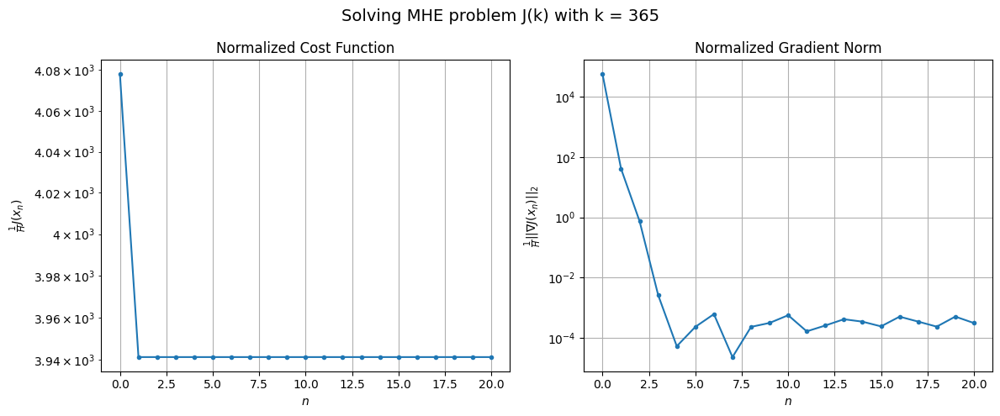

Windows:  92%|█████████▏| 337/366 [36:24<04:13,  8.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 129815.07406651534
Gradient norm: 1798258.3280823037
Global estimation error: 43.742235756188286
Initial conditions estimation errors: 10.839771637886157 m, 19.850125216657116 m, 10.519939845446235 m, 35.93235742115388 m
Position estimation errors: 19.936810158876977 m, 76.9310449538659 m, 60.21248085295535 m, 164.6957152698595 m

[Gauss-Newton] Iteration 1
Cost function: 125585.47825403784 (-3.26%)
Gradient norm: 66.67046853904401 (-100.00%)
Global estimation error: 45.82213921363043 (4.75%)
Initial conditions estimation errors: 13.136986018682165 m, 18.259786046436556 m, 18.061256558469644 m, 35.60069739314918 m
Position estimation errors: 17.293713037309004 m, 72.01208859749141 m, 63.219573020259986 m, 159.8332396013878 m

[Gauss-Newton] Iteration 2
Cost function: 125585.47810256967 (-0.00%)
Gradient norm: 0.44497204405467006 (-99.33%)
Global estimation error: 45.564993475386174 (-0.56%)
Initial conditions estimation errors

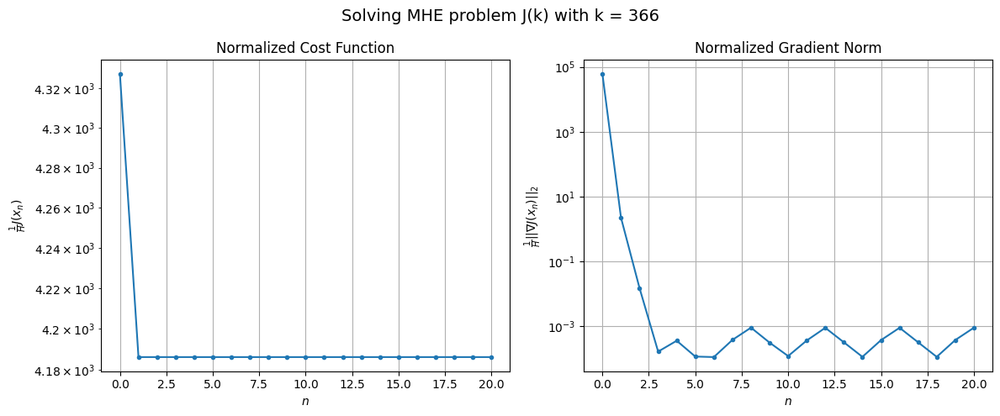

Windows:  92%|█████████▏| 338/366 [36:40<05:02, 10.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 137996.27133115748
Gradient norm: 1868977.9329381958
Global estimation error: 50.74766723857859
Initial conditions estimation errors: 11.123346693592028 m, 20.178847575925836 m, 11.934715414596495 m, 43.61107501861023 m
Position estimation errors: 20.330870283810267 m, 73.52516719387766 m, 58.992969253059044 m, 158.3664152932495 m

[Gauss-Newton] Iteration 1
Cost function: 133557.14616739756 (-3.22%)
Gradient norm: 3815.596190230318 (-99.80%)
Global estimation error: 59.237239109687614 (16.73%)
Initial conditions estimation errors: 13.53612717303273 m, 28.776118321613072 m, 9.665280565682094 m, 49.03382070021463 m
Position estimation errors: 17.595957599058522 m, 49.45187569010644 m, 32.33093227562198 m, 102.18128634535836 m

[Gauss-Newton] Iteration 2
Cost function: 133557.10473554346 (-0.00%)
Gradient norm: 21.730142462540456 (-99.43%)
Global estimation error: 61.254170507724425 (3.40%)
Initial conditions estimation errors: 

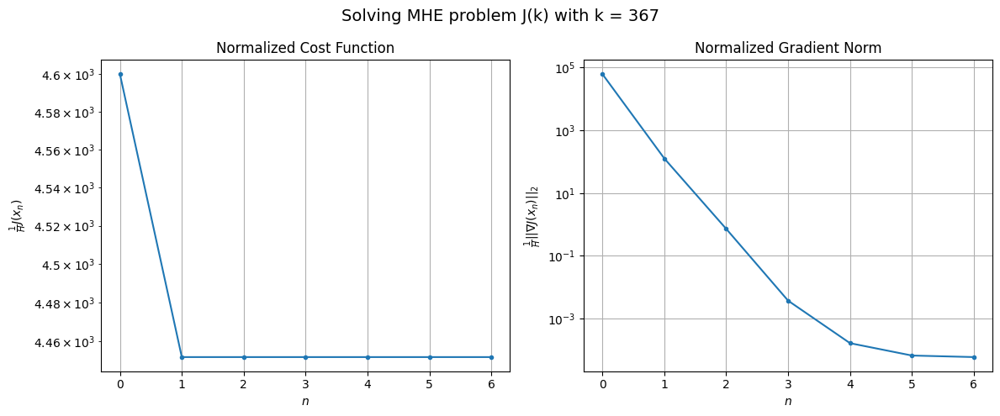

Windows:  93%|█████████▎| 339/366 [36:45<04:10,  9.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 145356.71750894148
Gradient norm: 1948169.2559542018
Global estimation error: 65.74294282964748
Initial conditions estimation errors: 11.744926243883446 m, 30.615008023183016 m, 12.287766992931989 m, 55.64082459590105 m
Position estimation errors: 20.468344761709837 m, 48.31195946247275 m, 24.49653664757952 m, 95.81609804974795 m

[Gauss-Newton] Iteration 1
Cost function: 140599.52237533987 (-3.27%)
Gradient norm: 18272.78881923912 (-99.06%)
Global estimation error: 72.48508867766309 (10.26%)
Initial conditions estimation errors: 14.327717782269941 m, 39.09585217225558 m, 19.81144849135485 m, 55.92685189078618 m
Position estimation errors: 17.639379144190034 m, 6.656950580419119 m, 33.78645044293679 m, 19.075691698816946 m

[Gauss-Newton] Iteration 2
Cost function: 140598.58456444732 (-0.00%)
Gradient norm: 23.013711060251843 (-99.87%)
Global estimation error: 75.46784645581724 (4.11%)
Initial conditions estimation errors: 14.

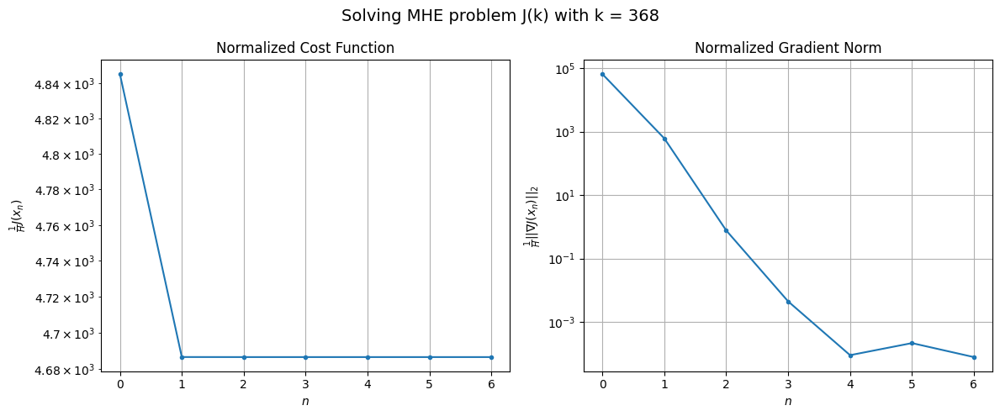

Windows:  93%|█████████▎| 340/366 [36:51<03:33,  8.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 151331.40338581012
Gradient norm: 2056932.3664403462
Global estimation error: 71.51727853818244
Initial conditions estimation errors: 12.633734606308787 m, 37.89114954289174 m, 21.919062016954136 m, 55.1263365581931 m
Position estimation errors: 20.317384228953667 m, 7.009291577465117 m, 41.21091003059313 m, 23.139676588105583 m

[Gauss-Newton] Iteration 1
Cost function: 146430.75696553942 (-3.24%)
Gradient norm: 188.86029544315974 (-99.99%)
Global estimation error: 104.75307382789225 (46.47%)
Initial conditions estimation errors: 15.323710519388156 m, 47.008743283336244 m, 27.150046470927016 m, 88.26908139341275 m
Position estimation errors: 17.46134097111656 m, 8.771276281329866 m, 45.03438865390497 m, 35.50702054561054 m

[Gauss-Newton] Iteration 2
Cost function: 146430.75528178265 (-0.00%)
Gradient norm: 0.021747352600155416 (-99.99%)
Global estimation error: 104.95875376194715 (0.20%)
Initial conditions estimation errors:

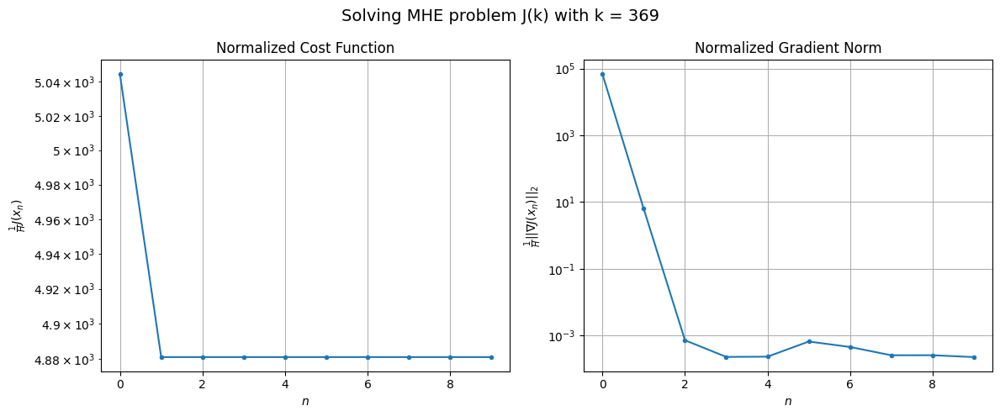

Windows:  93%|█████████▎| 341/366 [36:59<03:20,  8.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 153930.90803513597
Gradient norm: 2095966.2799497652
Global estimation error: 100.38360825281916
Initial conditions estimation errors: 13.585973856859129 m, 44.3217451833526 m, 27.39060583058863 m, 84.72080577244175 m
Position estimation errors: 19.943179779340745 m, 8.350025715687734 m, 49.62330845630608 m, 36.95297821383587 m

[Gauss-Newton] Iteration 1
Cost function: 148786.32011700995 (-3.34%)
Gradient norm: 456.16344373422373 (-99.98%)
Global estimation error: 62.75658688895562 (-37.48%)
Initial conditions estimation errors: 16.41837567372425 m, 33.19391289670922 m, 5.422421322573327 m, 50.37433317261209 m
Position estimation errors: 17.06284806002269 m, 7.636068834538299 m, 39.6504332855854 m, 31.973017832668297 m

[Gauss-Newton] Iteration 2
Cost function: 148786.31050219448 (-0.00%)
Gradient norm: 0.17892184015107904 (-99.96%)
Global estimation error: 61.8960230220213 (-1.37%)
Initial conditions estimation errors: 16.41

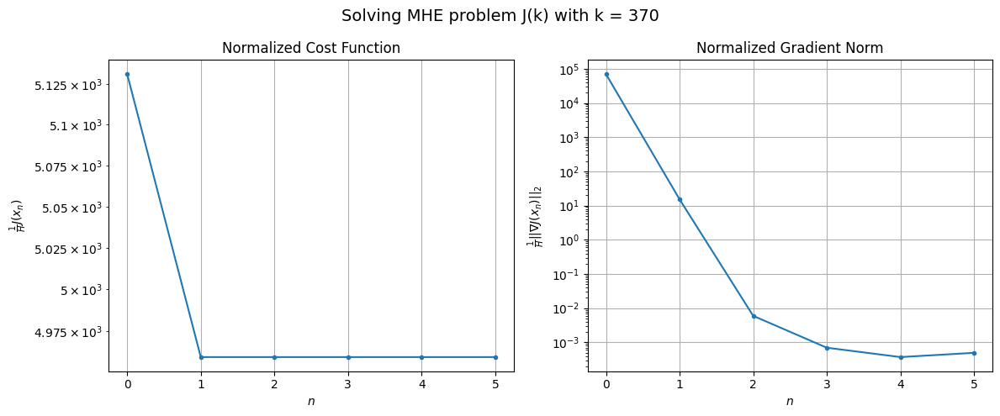

Windows:  93%|█████████▎| 342/366 [37:04<02:52,  7.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 154130.38301207707
Gradient norm: 2202282.9335480044
Global estimation error: 56.08480723720683
Initial conditions estimation errors: 14.510370529344732 m, 29.690206277517433 m, 4.820976822793811 m, 45.05762931894562 m
Position estimation errors: 19.368513540466306 m, 6.696719106461208 m, 42.277554339160595 m, 30.453372797873854 m

[Gauss-Newton] Iteration 1
Cost function: 148816.05495318642 (-3.45%)
Gradient norm: 964.6833968408023 (-99.96%)
Global estimation error: 105.57766556654836 (88.25%)
Initial conditions estimation errors: 17.41719798925985 m, 49.85019626085639 m, 24.880240882797967 m, 87.97269087151157 m
Position estimation errors: 16.462471459151985 m, 21.78698655314396 m, 57.55498325758575 m, 70.79749876125183 m

[Gauss-Newton] Iteration 2
Cost function: 148816.04452140525 (-0.00%)
Gradient norm: 5.072682896999208 (-99.47%)
Global estimation error: 107.19490713079836 (1.53%)
Initial conditions estimation errors: 17

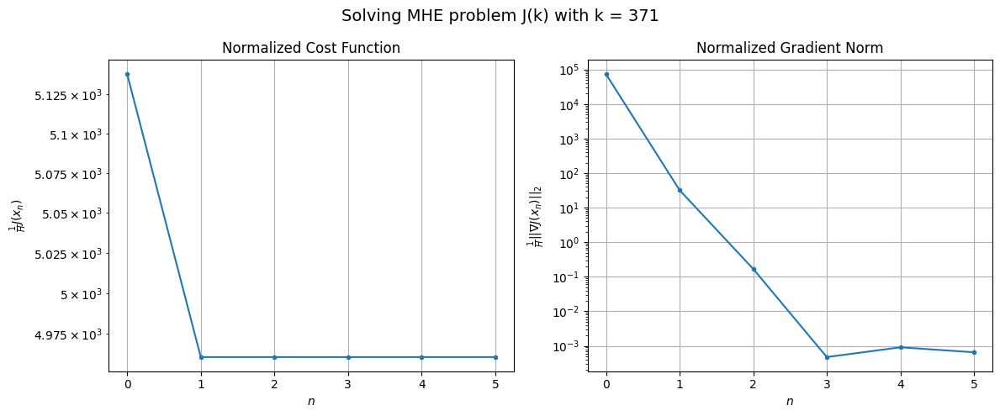

Windows:  94%|█████████▎| 343/366 [37:09<02:31,  6.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 151345.99329710496
Gradient norm: 2383662.7223231886
Global estimation error: 99.3129228743504
Initial conditions estimation errors: 15.25488643229525 m, 46.32403514791817 m, 25.476372882227434 m, 82.67622774621196 m
Position estimation errors: 18.633696004049963 m, 22.202975014430635 m, 62.865957728227585 m, 73.82125833356955 m

[Gauss-Newton] Iteration 1
Cost function: 145964.13624306503 (-3.56%)
Gradient norm: 219.86856376849838 (-99.99%)
Global estimation error: 81.07345741156104 (-18.37%)
Initial conditions estimation errors: 18.20018537450312 m, 38.745492665141555 m, 6.577008208168495 m, 68.53586352424861 m
Position estimation errors: 15.739368146371758 m, 22.606048649623332 m, 59.43367097123835 m, 66.09766998661686 m

[Gauss-Newton] Iteration 2
Cost function: 145964.1342461438 (-0.00%)
Gradient norm: 0.2901736946222152 (-99.87%)
Global estimation error: 81.36528144584514 (0.36%)
Initial conditions estimation errors: 18.

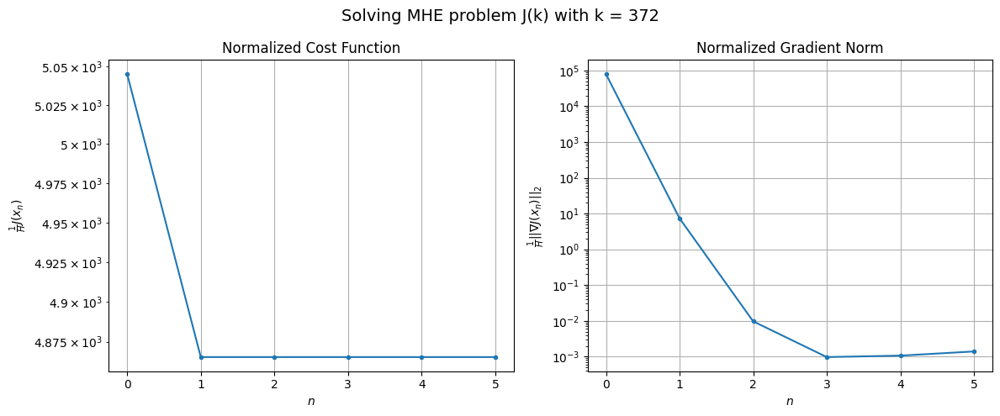

Windows:  94%|█████████▍| 344/366 [37:14<02:14,  6.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 145326.31516510813
Gradient norm: 2412010.7491581896
Global estimation error: 72.78035758991791
Initial conditions estimation errors: 15.740385198436996 m, 34.31081985069255 m, 6.802542254590091 m, 61.85214280919089 m
Position estimation errors: 17.826902927391274 m, 21.72157205853437 m, 62.24012344126738 m, 66.22246345075867 m

[Gauss-Newton] Iteration 1
Cost function: 139867.366767711 (-3.76%)
Gradient norm: 666.3729480118288 (-99.97%)
Global estimation error: 86.22779797279128 (18.48%)
Initial conditions estimation errors: 18.71493319542775 m, 39.9895489802054 m, 9.846945026078693 m, 73.40860659490913 m
Position estimation errors: 14.935615963793332 m, 33.03073555029615 m, 76.11334862796838 m, 89.27213800127056 m

[Gauss-Newton] Iteration 2
Cost function: 139867.36567960746 (-0.00%)
Gradient norm: 0.018228692014893418 (-100.00%)
Global estimation error: 86.03712180724625 (-0.22%)
Initial conditions estimation errors: 18.714

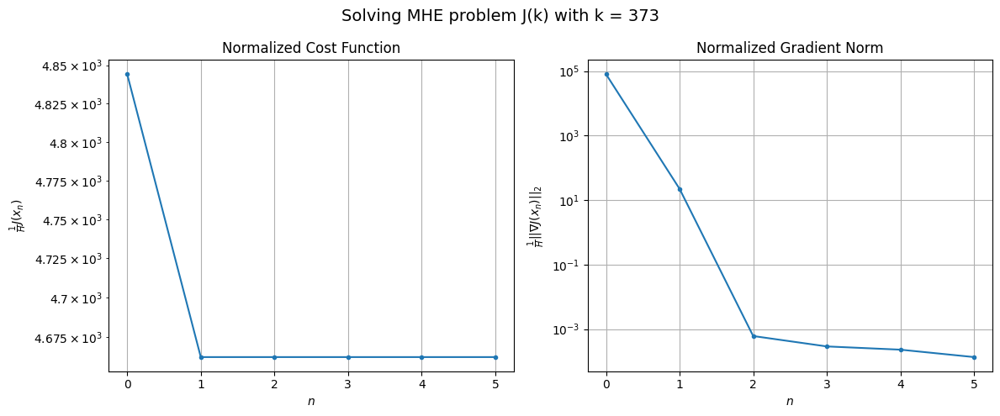

Windows:  94%|█████████▍| 345/366 [37:19<02:00,  5.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 137019.7929646926
Gradient norm: 2569127.8515445143
Global estimation error: 75.46427743243372
Initial conditions estimation errors: 15.956911597635512 m, 34.46866050341009 m, 9.163363206512264 m, 64.5611422371752 m
Position estimation errors: 16.985887512937495 m, 31.705859736549876 m, 78.26380349189232 m, 88.63783264668218 m

[Gauss-Newton] Iteration 1
Cost function: 131635.73874868522 (-3.93%)
Gradient norm: 400.4900793767773 (-99.98%)
Global estimation error: 79.77835396310303 (5.72%)
Initial conditions estimation errors: 18.900806427604646 m, 40.02797084349864 m, 10.210624294323067 m, 65.58051240632005 m
Position estimation errors: 14.125365774627314 m, 41.69818845889343 m, 85.83125849251428 m, 106.52115209273096 m

[Gauss-Newton] Iteration 2
Cost function: 131635.73828199593 (-0.00%)
Gradient norm: 0.013427041186898345 (-100.00%)
Global estimation error: 79.83915143783025 (0.08%)
Initial conditions estimation errors: 18.

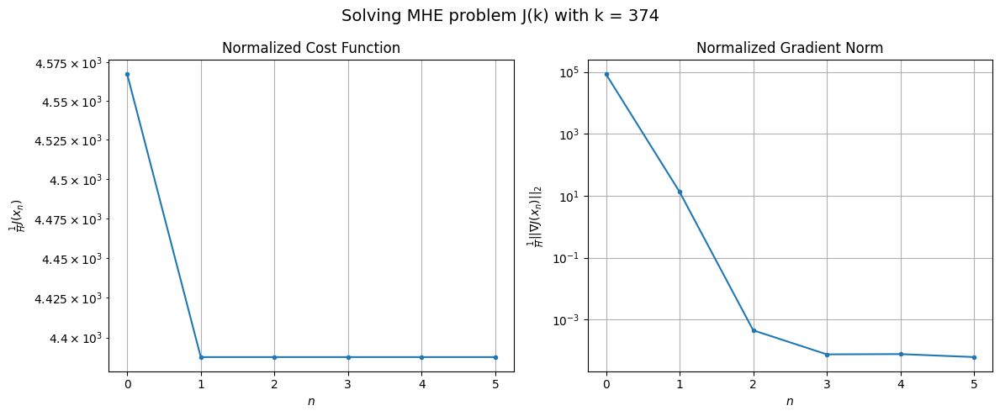

Windows:  95%|█████████▍| 346/366 [37:24<01:49,  5.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 126701.99682340227
Gradient norm: 2635177.693812873
Global estimation error: 67.45217573697505
Initial conditions estimation errors: 15.887377802364146 m, 33.77436409650688 m, 9.477890964050621 m, 55.378698295758014 m
Position estimation errors: 16.172698628454054 m, 40.18704874975001 m, 87.72457187055751 m, 105.18795471006051 m

[Gauss-Newton] Iteration 1
Cost function: 121583.38953183364 (-4.04%)
Gradient norm: 2719.7692498750143 (-99.90%)
Global estimation error: 106.70426057793695 (58.19%)
Initial conditions estimation errors: 18.749714103006617 m, 48.606893718703276 m, 14.645074344273068 m, 91.96252248181432 m
Position estimation errors: 13.393474225678583 m, 31.529396270004227 m, 62.70926562284463 m, 85.41577664584376 m

[Gauss-Newton] Iteration 2
Cost function: 121583.34924312572 (-0.00%)
Gradient norm: 0.11922308424452706 (-100.00%)
Global estimation error: 106.5395897330386 (-0.15%)
Initial conditions estimation error

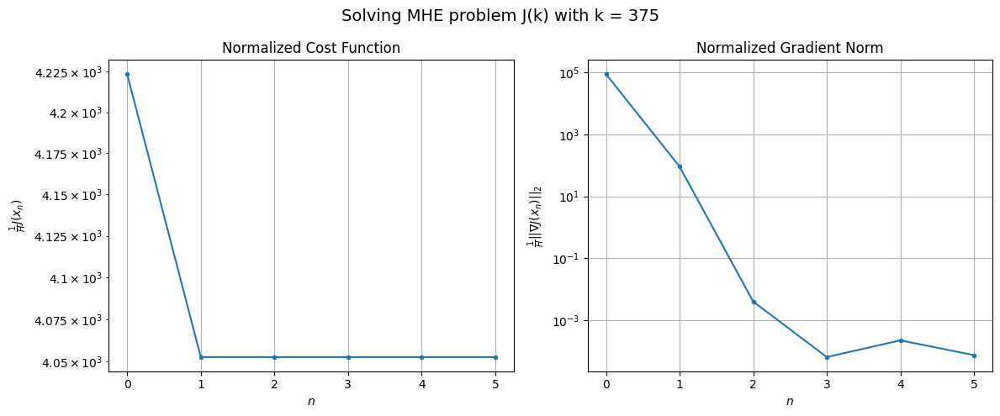

Windows:  95%|█████████▍| 347/366 [37:29<01:39,  5.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 115906.84158312739
Gradient norm: 2748391.276540868
Global estimation error: 96.43836395565269
Initial conditions estimation errors: 15.5663813027395 m, 43.08416015261006 m, 15.088200597576034 m, 83.51114710738075 m
Position estimation errors: 15.471162505549959 m, 30.869756524649077 m, 65.30786203607819 m, 86.18753527825787 m

[Gauss-Newton] Iteration 1
Cost function: 111088.48428557345 (-4.16%)
Gradient norm: 1421.5199003461526 (-99.95%)
Global estimation error: 123.97875509386097 (28.56%)
Initial conditions estimation errors: 18.324120460454953 m, 53.05200896682537 m, 15.276062492414983 m, 109.4854210779925 m
Position estimation errors: 12.759770143942477 m, 24.72014495947315 m, 45.07477153981376 m, 71.52142152207905 m

[Gauss-Newton] Iteration 2
Cost function: 111088.47443410335 (-0.00%)
Gradient norm: 0.32540232985141154 (-99.98%)
Global estimation error: 123.32748848680932 (-0.53%)
Initial conditions estimation errors: 1

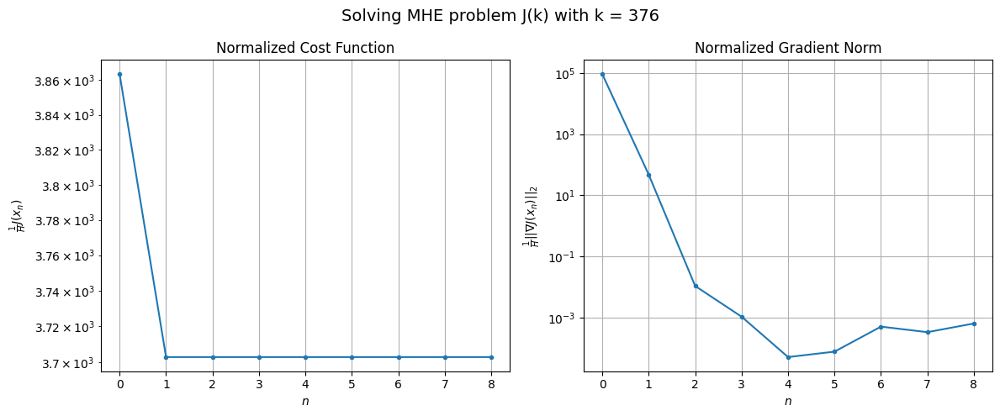

Windows:  95%|█████████▌| 348/366 [37:36<01:44,  5.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 105507.29713034147
Gradient norm: 2876574.4997503897
Global estimation error: 114.89212383040986
Initial conditions estimation errors: 15.078596947869501 m, 47.97316132394008 m, 16.72758563526406 m, 101.93905759865837 m
Position estimation errors: 14.912715157347433 m, 24.724186436178957 m, 47.99243007980278 m, 73.70185930277297 m

[Gauss-Newton] Iteration 1
Cost function: 101064.07593801775 (-4.21%)
Gradient norm: 2725.5557609411153 (-99.91%)
Global estimation error: 43.2928769752791 (-62.32%)
Initial conditions estimation errors: 17.706468754183355 m, 10.627544997929036 m, 37.34185851549254 m, 7.305766864646556 m
Position estimation errors: 12.28432265419665 m, 8.45812407248087 m, 18.372012164194334 m, 14.140948008425061 m

[Gauss-Newton] Iteration 2
Cost function: 101063.81439123783 (-0.00%)
Gradient norm: 3.9838131381814206 (-99.85%)
Global estimation error: 42.95089654992207 (-0.79%)
Initial conditions estimation errors: 

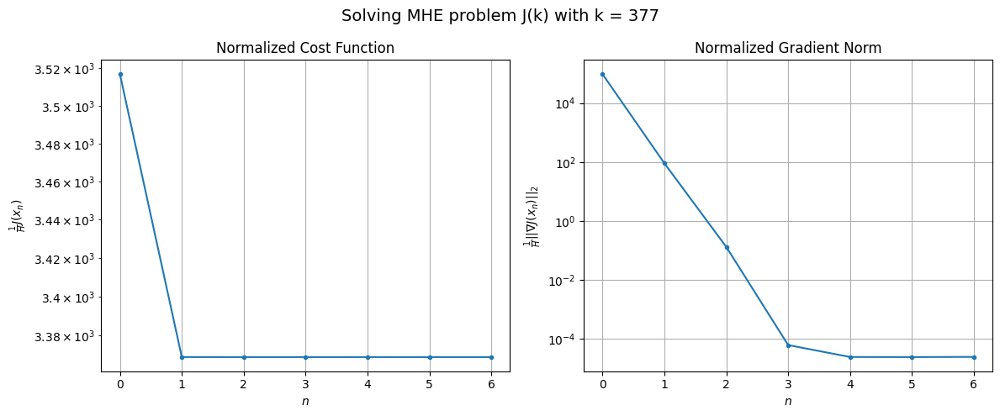

Windows:  95%|█████████▌| 349/366 [37:41<01:37,  5.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 96352.11643074002
Gradient norm: 3072340.315017274
Global estimation error: 39.169631518398184
Initial conditions estimation errors: 14.482458266608011 m, 8.955980298251534 m, 34.47582374175419 m, 7.463671188370807 m
Position estimation errors: 14.565105327478777 m, 10.614313354465455 m, 20.279473384749043 m, 14.377320303269478 m

[Gauss-Newton] Iteration 1
Cost function: 92103.23092040821 (-4.41%)
Gradient norm: 1754.3079802016302 (-99.94%)
Global estimation error: 88.91480896566715 (127.00%)
Initial conditions estimation errors: 17.035750699285618 m, 39.93522075141456 m, 8.266969881481788 m, 77.15201776137073 m
Position estimation errors: 11.951529694291327 m, 22.50016100369871 m, 40.23421128628169 m, 64.45532228178531 m

[Gauss-Newton] Iteration 2
Cost function: 92103.14267617978 (-0.00%)
Gradient norm: 3.1297249410587167 (-99.82%)
Global estimation error: 85.29875686290514 (-4.07%)
Initial conditions estimation errors: 17.

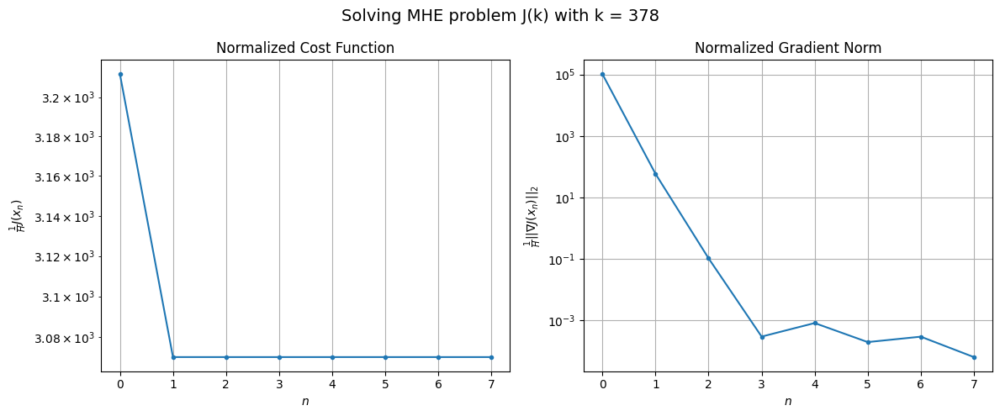

Windows:  96%|█████████▌| 350/366 [37:48<01:34,  5.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 88270.25636984641
Gradient norm: 3282646.0393589605
Global estimation error: 76.55383293719942
Initial conditions estimation errors: 13.864968575004921 m, 33.73817459659231 m, 8.364423015920316 m, 66.78320178591618 m
Position estimation errors: 14.400977871462976 m, 21.87528322318976 m, 42.45315388605557 m, 64.0887956555986 m

[Gauss-Newton] Iteration 1
Cost function: 84191.8960143844 (-4.62%)
Gradient norm: 684.7275686581037 (-99.98%)
Global estimation error: 70.62691737472295 (-7.74%)
Initial conditions estimation errors: 16.371146632818927 m, 33.11071795444334 m, 9.285453825222449 m, 59.477596858066775 m
Position estimation errors: 11.797856657289975 m, 15.40532835194659 m, 26.370605184501954 m, 42.83278548676727 m

[Gauss-Newton] Iteration 2
Cost function: 84191.89465960543 (-0.00%)
Gradient norm: 0.5525250096038528 (-99.92%)
Global estimation error: 72.04963174960693 (2.01%)
Initial conditions estimation errors: 16.371146

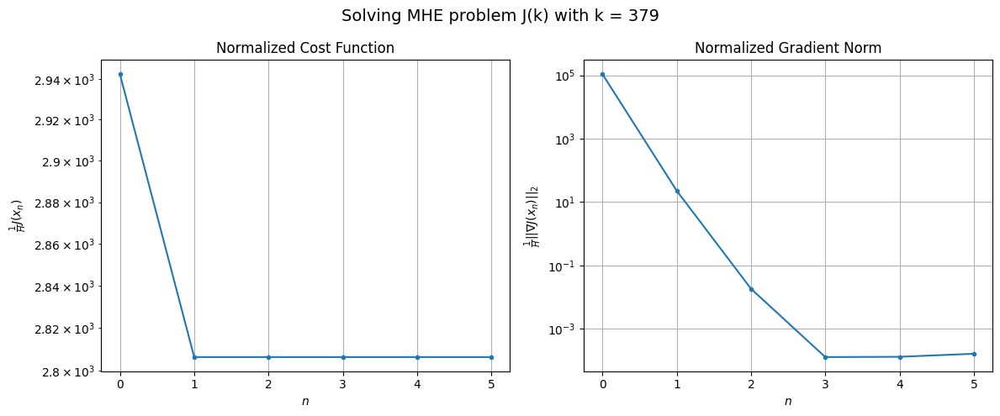

Windows:  96%|█████████▌| 351/366 [37:52<01:23,  5.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 81022.90593711581
Gradient norm: 3465676.3251642883
Global estimation error: 64.09908123771433
Initial conditions estimation errors: 13.242636892526864 m, 29.323007002204694 m, 7.933995610198067 m, 54.86815639741479 m
Position estimation errors: 14.438450031886681 m, 16.257866634241857 m, 29.454759789737288 m, 44.456251901748765 m

[Gauss-Newton] Iteration 1
Cost function: 77061.57065480278 (-4.89%)
Gradient norm: 696.117116968438 (-99.98%)
Global estimation error: 42.53556313510642 (-33.64%)
Initial conditions estimation errors: 15.737329707453503 m, 20.769273740360997 m, 22.397394442432404 m, 25.071588703076632 m
Position estimation errors: 11.839931288723223 m, 10.23159887632036 m, 13.615271511012487 m, 17.693757739421816 m

[Gauss-Newton] Iteration 2
Cost function: 77061.56743082413 (-0.00%)
Gradient norm: 0.3507967980091712 (-99.95%)
Global estimation error: 42.66452070286608 (0.30%)
Initial conditions estimation errors: 

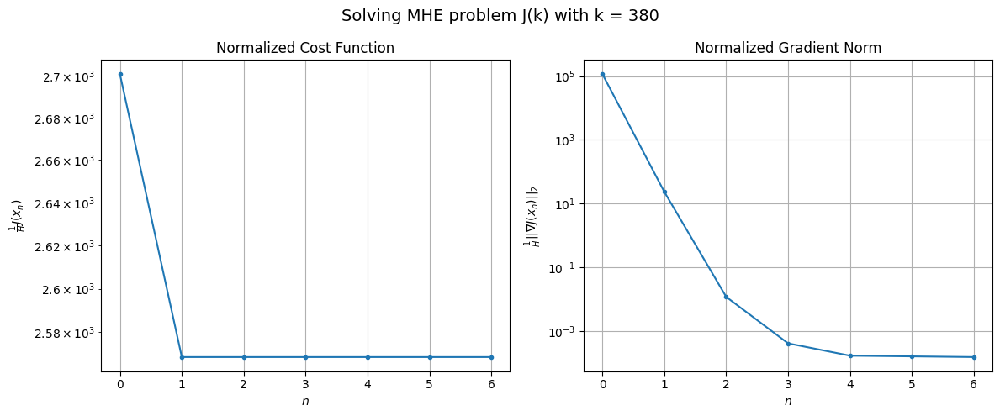

Windows:  96%|█████████▌| 352/366 [37:58<01:18,  5.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 75792.29144656911
Gradient norm: 3806547.554032565
Global estimation error: 35.21959169003226
Initial conditions estimation errors: 12.611763619443584 m, 17.003599362345998 m, 19.148906557539334 m, 20.628632720207097 m
Position estimation errors: 14.690005828550548 m, 12.361984031720958 m, 16.61565776643491 m, 18.4160989767869 m

[Gauss-Newton] Iteration 1
Cost function: 71694.6153428539 (-5.41%)
Gradient norm: 4943.299583734526 (-99.87%)
Global estimation error: 143.93467398389075 (308.68%)
Initial conditions estimation errors: 15.18586686964418 m, 64.60381868083473 m, 39.93774780760281 m, 121.31727846892286 m
Position estimation errors: 11.999895445983057 m, 11.599389509962732 m, 8.547702203015431 m, 38.21359460015203 m

[Gauss-Newton] Iteration 2
Cost function: 71693.9355968213 (-0.00%)
Gradient norm: 1.068277132221178 (-99.98%)
Global estimation error: 144.06630732435954 (0.09%)
Initial conditions estimation errors: 15.185

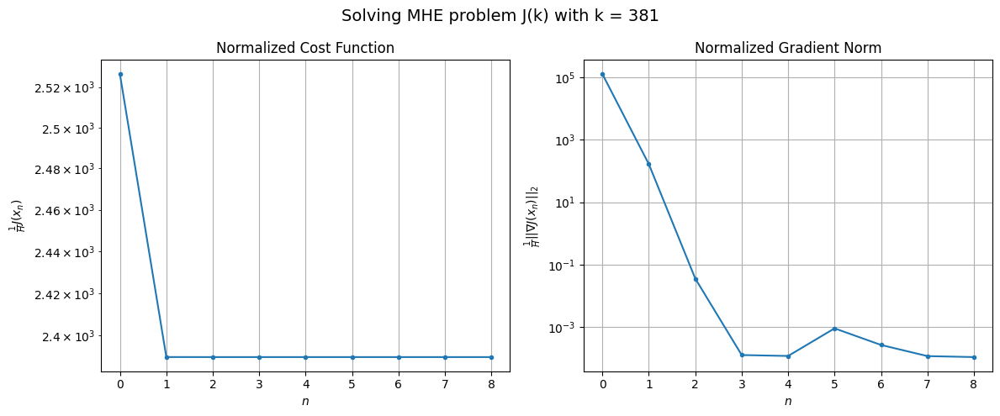

Windows:  96%|█████████▋| 353/366 [38:05<01:18,  6.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 71480.30156376338
Gradient norm: 4038129.7873390703
Global estimation error: 140.2018545972804
Initial conditions estimation errors: 12.023246547809308 m, 61.423535439182146 m, 44.57184436982674 m, 117.2709719471611 m
Position estimation errors: 15.083333700932188 m, 14.34410251251928 m, 14.01345180315104 m, 44.26694208873199 m

[Gauss-Newton] Iteration 1
Cost function: 67342.87098315895 (-5.79%)
Gradient norm: 9815.98027264642 (-99.76%)
Global estimation error: 90.97774966810472 (-35.11%)
Initial conditions estimation errors: 14.672332361143548 m, 20.9020297767571 m, 64.00246852343372 m, 59.40070768380377 m
Position estimation errors: 12.345635383455067 m, 15.267218987950994 m, 18.34995438862946 m, 24.96482147424943 m

[Gauss-Newton] Iteration 2
Cost function: 67338.33913320335 (-0.01%)
Gradient norm: 2.109208638628668 (-99.98%)
Global estimation error: 94.12305959380932 (3.46%)
Initial conditions estimation errors: 14.672332

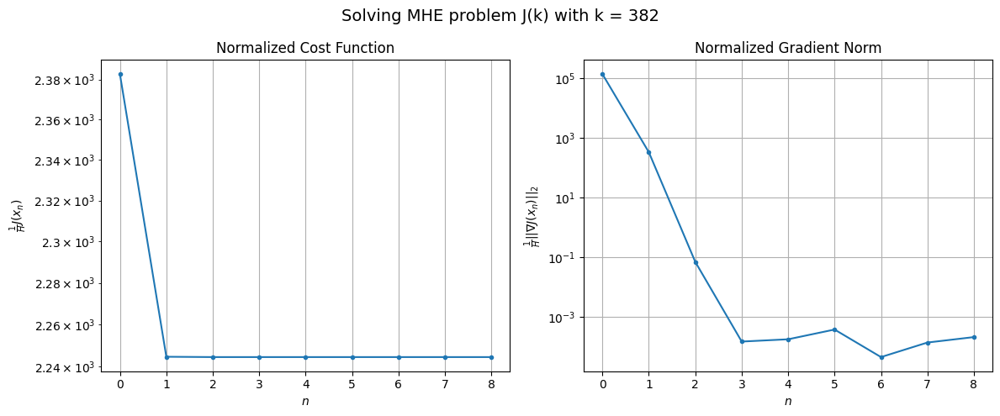

Windows:  97%|█████████▋| 354/366 [38:12<01:16,  6.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 69134.73338511921
Gradient norm: 4424939.814424512
Global estimation error: 94.16933505476166
Initial conditions estimation errors: 11.438557113080183 m, 24.583712112371508 m, 61.853481053611816 m, 65.62616797058647 m
Position estimation errors: 15.685999420080822 m, 20.78209030327802 m, 21.877663321145587 m, 33.52938490993809 m

[Gauss-Newton] Iteration 1
Cost function: 64711.97338109427 (-6.40%)
Gradient norm: 7766.10242385196 (-99.82%)
Global estimation error: 255.21885619173312 (171.02%)
Initial conditions estimation errors: 14.214862499416247 m, 81.5228764038457 m, 145.0966502230392 m, 192.9651899422391 m
Position estimation errors: 12.808506002284487 m, 23.579279347758867 m, 26.676823938003817 m, 56.35967035129141 m

[Gauss-Newton] Iteration 2
Cost function: 64710.08400377688 (-0.00%)
Gradient norm: 0.8532575395266183 (-99.99%)
Global estimation error: 254.1311754599671 (-0.43%)
Initial conditions estimation errors: 14.2

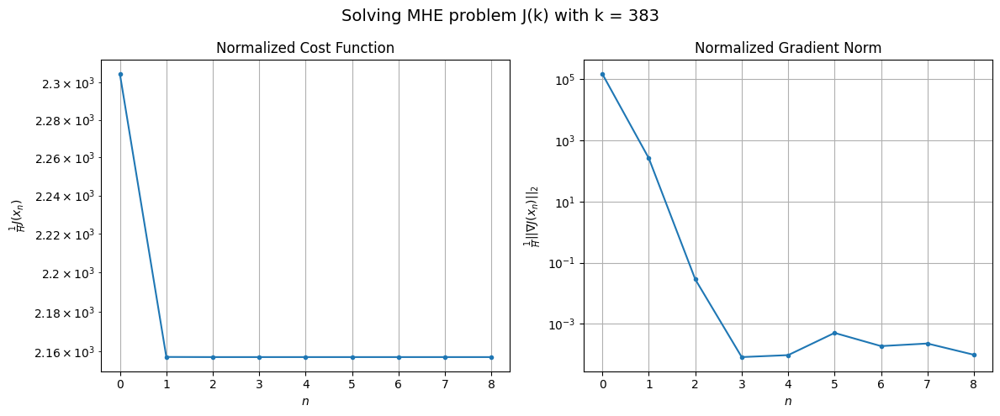

Windows:  97%|█████████▋| 355/366 [38:19<01:12,  6.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 68017.19335936957
Gradient norm: 4555508.371275543
Global estimation error: 256.92822613796216
Initial conditions estimation errors: 10.898376854853986 m, 84.74318466906809 m, 142.30784008001072 m, 196.11321606054724 m
Position estimation errors: 16.40148020420198 m, 32.56290511427638 m, 34.275007277011596 m, 71.88343294242466 m

[Gauss-Newton] Iteration 1
Cost function: 63501.96742389657 (-6.64%)
Gradient norm: 1420.9501588172632 (-99.97%)
Global estimation error: 189.18030261255464 (-26.37%)
Initial conditions estimation errors: 13.746555628209272 m, 62.240303206643986 m, 102.45373090604997 m, 145.70374531248598 m
Position estimation errors: 13.469372897589544 m, 33.89880951097997 m, 24.364112007650768 m, 66.75524933370203 m

[Gauss-Newton] Iteration 2
Cost function: 63501.90343784862 (-0.00%)
Gradient norm: 1.6738875075697817 (-99.88%)
Global estimation error: 191.46568707717435 (1.21%)
Initial conditions estimation errors:

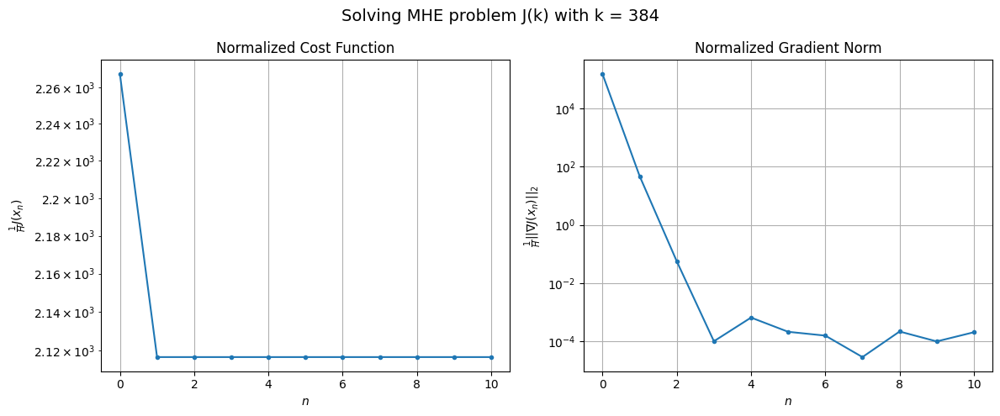

Windows:  97%|█████████▋| 356/366 [38:28<01:11,  7.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 68808.21463859527
Gradient norm: 4877615.7697906755
Global estimation error: 192.03297507453868
Initial conditions estimation errors: 10.395305561705834 m, 65.20446173555314 m, 100.92908899917923 m, 149.43321426906087 m
Position estimation errors: 17.29332255420296 m, 41.277479169249744 m, 29.966471902414845 m, 78.9122024230913 m

[Gauss-Newton] Iteration 1
Cost function: 63996.74590778021 (-6.99%)
Gradient norm: 3135.7490873284605 (-99.94%)
Global estimation error: 62.223101437219626 (-67.60%)
Initial conditions estimation errors: 13.333161470369472 m, 21.793412758875768 m, 28.410030119309205 m, 49.1105417618378 m
Position estimation errors: 14.227739402545378 m, 30.79185160623801 m, 18.807644496059183 m, 39.05043714545324 m

[Gauss-Newton] Iteration 2
Cost function: 63996.21455302426 (-0.00%)
Gradient norm: 14.712010116387253 (-99.53%)
Global estimation error: 68.16692449767314 (9.55%)
Initial conditions estimation errors: 1

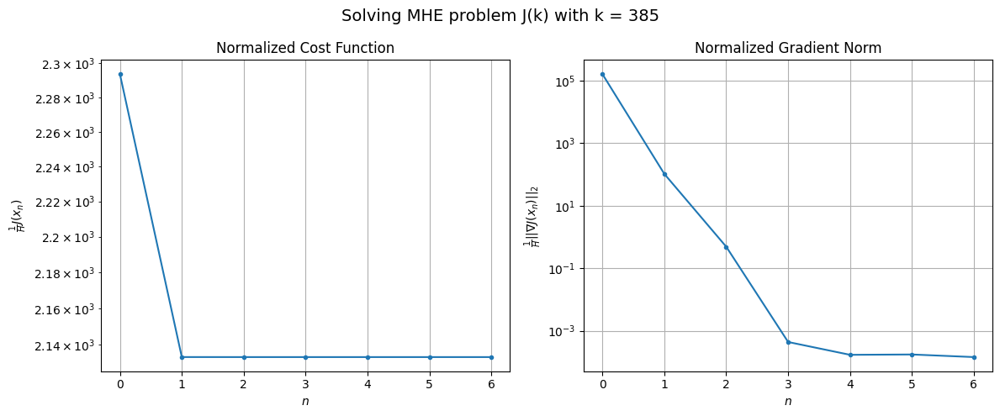

Windows:  98%|█████████▊| 357/366 [38:33<00:59,  6.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 71516.8442170757
Gradient norm: 5274377.321650571
Global estimation error: 67.92342842786161
Initial conditions estimation errors: 10.02688699309137 m, 24.79150387735568 m, 29.096426210382937 m, 55.243302957816816 m
Position estimation errors: 18.251307965725555 m, 35.414971794873374 m, 22.26147046273778 m, 45.84123295916641 m

[Gauss-Newton] Iteration 1
Cost function: 66422.070316967 (-7.12%)
Gradient norm: 1914.8297795173423 (-99.96%)
Global estimation error: 35.68484661878334 (-47.46%)
Initial conditions estimation errors: 12.999846455911111 m, 15.477995339566771 m, 16.42234928282013 m, 24.39536225774965 m
Position estimation errors: 15.03502494252148 m, 11.355769293413347 m, 31.76426736619929 m, 17.905455316174063 m

[Gauss-Newton] Iteration 2
Cost function: 66421.98667496927 (-0.00%)
Gradient norm: 4.252489222680804 (-99.78%)
Global estimation error: 33.42490215827826 (-6.33%)
Initial conditions estimation errors: 12.9998

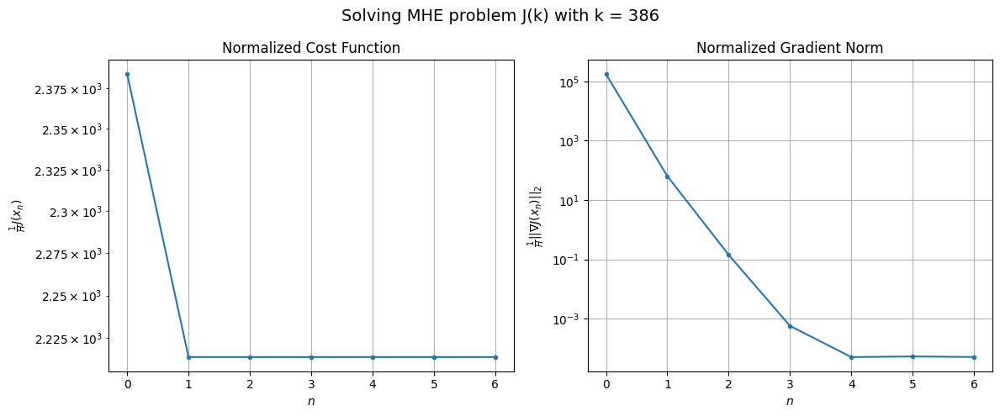

Windows:  98%|█████████▊| 358/366 [38:39<00:50,  6.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 76785.62355465372
Gradient norm: 5583317.5197255695
Global estimation error: 27.420116464030176
Initial conditions estimation errors: 9.813234250407046 m, 11.492789437545678 m, 13.816405999271325 m, 18.236571351950136 m
Position estimation errors: 19.22855359298459 m, 15.13761192521133 m, 36.28824791092099 m, 19.050672722155934 m

[Gauss-Newton] Iteration 1
Cost function: 71428.67359871694 (-6.98%)
Gradient norm: 7883.10462121102 (-99.86%)
Global estimation error: 133.16815540488972 (385.66%)
Initial conditions estimation errors: 12.791075023870894 m, 51.140980347268965 m, 63.886985297448774 m, 104.27456746679124 m
Position estimation errors: 15.87372992387891 m, 23.024736145021542 m, 14.066259508823622 m, 15.903506153938364 m

[Gauss-Newton] Iteration 2
Cost function: 71427.8512473335 (-0.00%)
Gradient norm: 45.155389718603985 (-99.43%)
Global estimation error: 140.87619029833766 (5.79%)
Initial conditions estimation errors: 

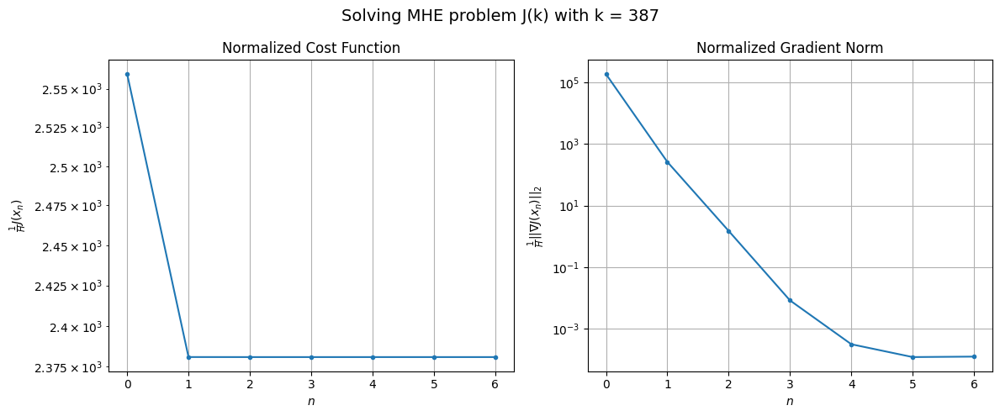

Windows:  98%|█████████▊| 359/366 [38:44<00:42,  6.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 83947.83169744062
Gradient norm: 5788823.600427623
Global estimation error: 142.39161444754612
Initial conditions estimation errors: 9.749511520430001 m, 53.88538497503313 m, 71.48176381151427 m, 110.30426447920182 m
Position estimation errors: 20.22577652360512 m, 24.728637736665945 m, 20.4325662900727 m, 20.687151405319838 m

[Gauss-Newton] Iteration 1
Cost function: 78307.8360138651 (-6.72%)
Gradient norm: 7587.730332264807 (-99.87%)
Global estimation error: 213.4131689400258 (49.88%)
Initial conditions estimation errors: 12.754147738743997 m, 82.54687935448445 m, 112.02212124130222 m, 161.30575057745716 m
Position estimation errors: 16.75055825902859 m, 39.47632232293651 m, 15.984430602593319 m, 35.45374802163342 m

[Gauss-Newton] Iteration 2
Cost function: 78307.41988413491 (-0.00%)
Gradient norm: 146.8097319523525 (-98.07%)
Global estimation error: 227.8361869279963 (6.76%)
Initial conditions estimation errors: 12.754147

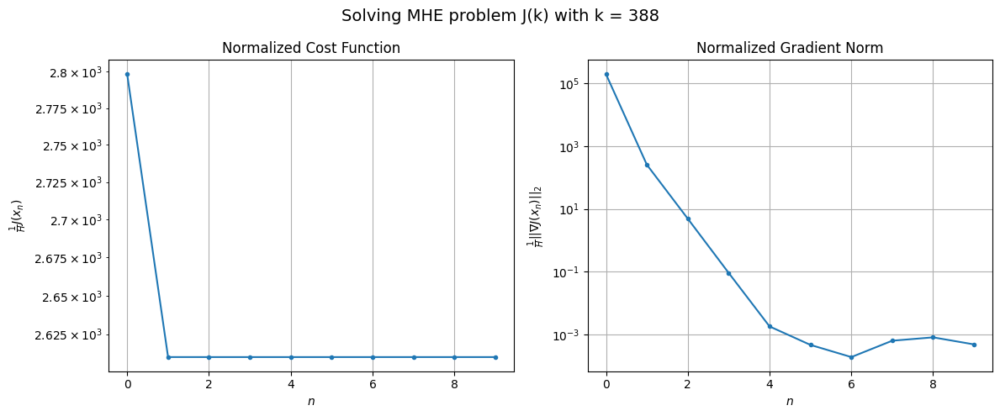

Windows:  98%|█████████▊| 360/366 [38:52<00:39,  6.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 92436.45047821273
Gradient norm: 5966255.421162436
Global estimation error: 236.50273502108078
Initial conditions estimation errors: 9.852373052732151 m, 90.70016119595036 m, 126.95606638486814 m, 177.4601118971332 m
Position estimation errors: 21.276917863648926 m, 38.86110004404158 m, 12.72537583714154 m, 32.635713979852454 m

[Gauss-Newton] Iteration 1
Cost function: 86575.64226163572 (-6.34%)
Gradient norm: 3476.2307600731747 (-99.94%)
Global estimation error: 307.29827739252795 (29.93%)
Initial conditions estimation errors: 12.884449871262813 m, 115.22964437510407 m, 174.42232148813815 m, 224.8670038797093 m
Position estimation errors: 17.724418104292578 m, 51.34273914708747 m, 12.996921104847841 m, 47.78707880136173 m

[Gauss-Newton] Iteration 2
Cost function: 86575.47557053388 (-0.00%)
Gradient norm: 56.22782805910615 (-98.38%)
Global estimation error: 315.936325413531 (2.81%)
Initial conditions estimation errors: 12.88

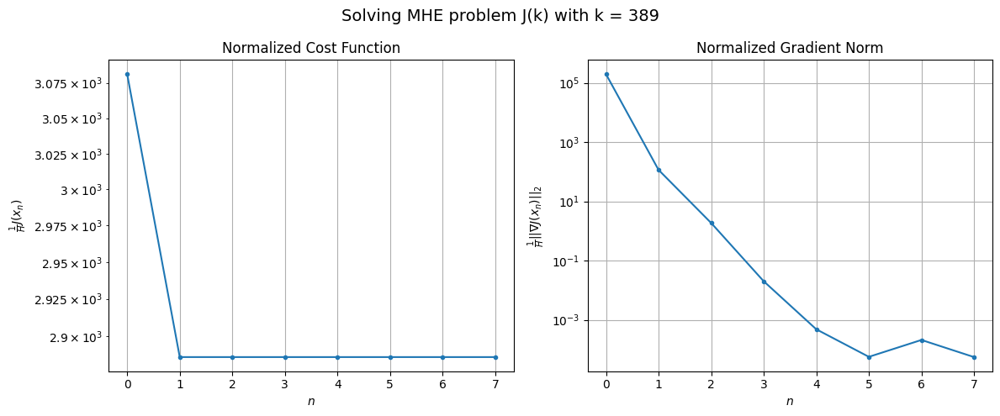

Windows:  99%|█████████▊| 361/366 [38:59<00:32,  6.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 103772.43237105075
Gradient norm: 6388093.019158758
Global estimation error: 325.8302625284194
Initial conditions estimation errors: 10.106899617699954 m, 122.26259595778306 m, 186.48942172979997 m, 237.35360735074775 m
Position estimation errors: 22.4806757751891 m, 47.742918598031004 m, 17.056338740588522 m, 41.52092503907131 m

[Gauss-Newton] Iteration 1
Cost function: 97342.91787310039 (-6.20%)
Gradient norm: 1225.1772542847386 (-99.98%)
Global estimation error: 282.8479021746113 (-13.19%)
Initial conditions estimation errors: 13.22542054791126 m, 110.17919222204294 m, 157.94513452623676 m, 206.74105528690305 m
Position estimation errors: 18.73171683436622 m, 53.421922445017074 m, 20.33517372864878 m, 66.0919892384343 m

[Gauss-Newton] Iteration 2
Cost function: 97342.91043688136 (-0.00%)
Gradient norm: 0.3524357916023865 (-99.97%)
Global estimation error: 283.84696106279523 (0.35%)
Initial conditions estimation errors: 13

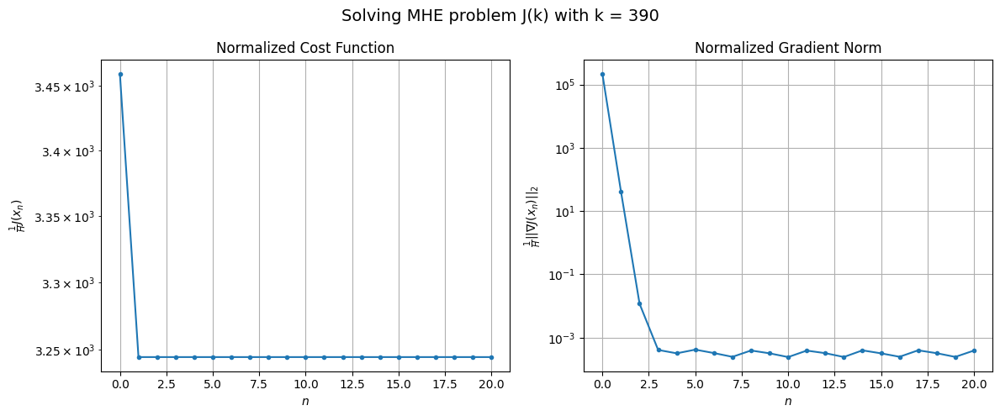

Windows:  99%|█████████▉| 362/366 [39:15<00:38,  9.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 116825.09740770259
Gradient norm: 6798828.560867094
Global estimation error: 293.35216709535416
Initial conditions estimation errors: 10.54202407618479 m, 113.83649968716888 m, 165.37093730783727 m, 213.6305981962003 m
Position estimation errors: 23.783396067963064 m, 49.597547449573625 m, 15.106622933267062 m, 57.24780349592113 m

[Gauss-Newton] Iteration 1
Cost function: 109865.36818405852 (-5.96%)
Gradient norm: 16948.808314016922 (-99.75%)
Global estimation error: 347.8259578405737 (18.57%)
Initial conditions estimation errors: 13.735755822391171 m, 131.05432959734688 m, 210.0376281705949 m, 243.93254522278005 m
Position estimation errors: 19.85130121620207 m, 94.33988671247872 m, 45.62492524544972 m, 134.7030115987376 m

[Gauss-Newton] Iteration 2
Cost function: 109864.15937376721 (-0.00%)
Gradient norm: 497.5002791133298 (-97.06%)
Global estimation error: 368.05970527113993 (5.82%)
Initial conditions estimation errors: 1

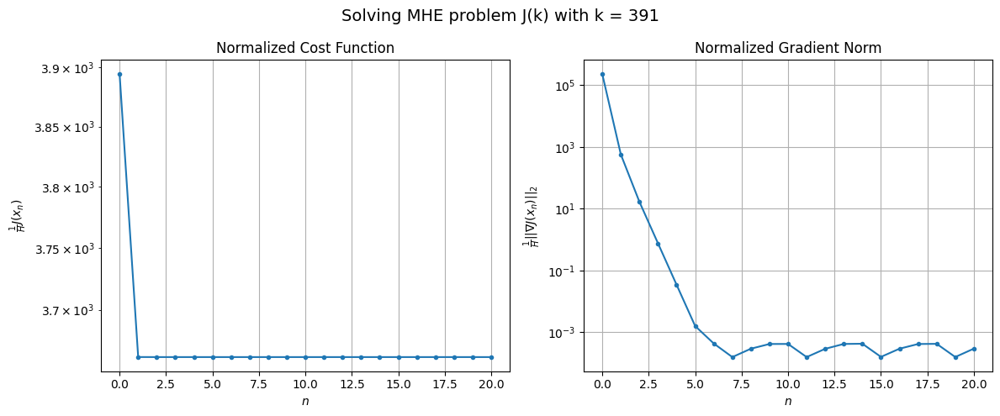

Windows:  99%|█████████▉| 363/366 [39:32<00:35, 11.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 132031.15846816558
Gradient norm: 7377602.681953319
Global estimation error: 391.67579993780447
Initial conditions estimation errors: 11.088792064675937 m, 148.08178200891322 m, 235.53728744689553 m, 275.464784594751 m
Position estimation errors: 25.249020905164166 m, 92.41512625285792 m, 36.720661595723485 m, 127.39326593442966 m

[Gauss-Newton] Iteration 1
Cost function: 124317.82454131688 (-5.84%)
Gradient norm: 101218.7257560729 (-98.63%)
Global estimation error: 63.548265204403414 (-83.78%)
Initial conditions estimation errors: 14.44416476431722 m, 25.532157932201507 m, 44.45078844148865 m, 34.66952461324209 m
Position estimation errors: 21.05924177305123 m, 36.33622303882582 m, 61.946504822453974 m, 50.42472164599125 m

[Gauss-Newton] Iteration 2
Cost function: 124212.51823102537 (-0.08%)
Gradient norm: 5429.6762644246855 (-94.64%)
Global estimation error: 33.91985681793821 (-46.62%)
Initial conditions estimation errors:

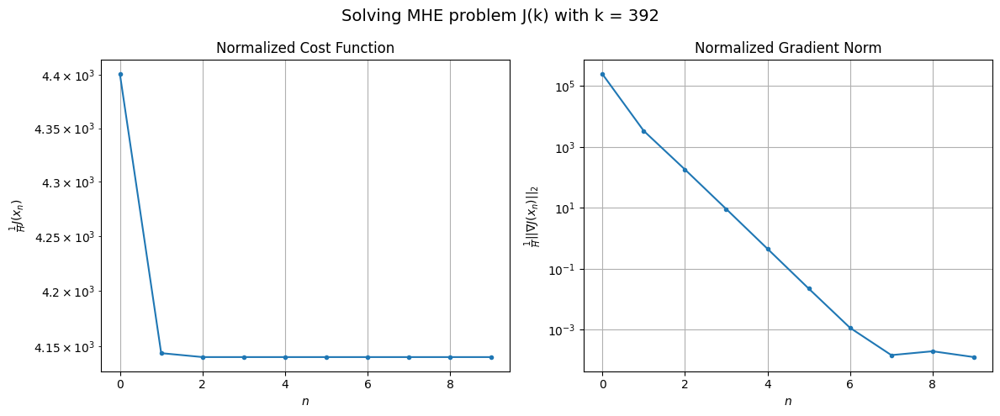

Windows:  99%|█████████▉| 364/366 [39:40<00:21, 10.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 149613.81602399825
Gradient norm: 7967045.92320894
Global estimation error: 49.60211045089447
Initial conditions estimation errors: 11.755613535342297 m, 18.11388568706107 m, 16.31702923004171 m, 41.56686398439955 m
Position estimation errors: 26.832641267922092 m, 28.34254775377652 m, 90.41567459450499 m, 34.362702945169865 m

[Gauss-Newton] Iteration 1
Cost function: 140831.76835533476 (-5.87%)
Gradient norm: 2266.2040715960693 (-99.97%)
Global estimation error: 78.93278709006611 (59.13%)
Initial conditions estimation errors: 15.274843340970806 m, 19.3698174538688 m, 55.949512599976266 m, 49.91497446597148 m
Position estimation errors: 22.355107036538318 m, 16.50842768850368 m, 74.92471494614684 m, 20.07300052884191 m

[Gauss-Newton] Iteration 2
Cost function: 140831.7381214633 (-0.00%)
Gradient norm: 9.470535203885508 (-99.58%)
Global estimation error: 81.74280700575403 (3.56%)
Initial conditions estimation errors: 15.27484

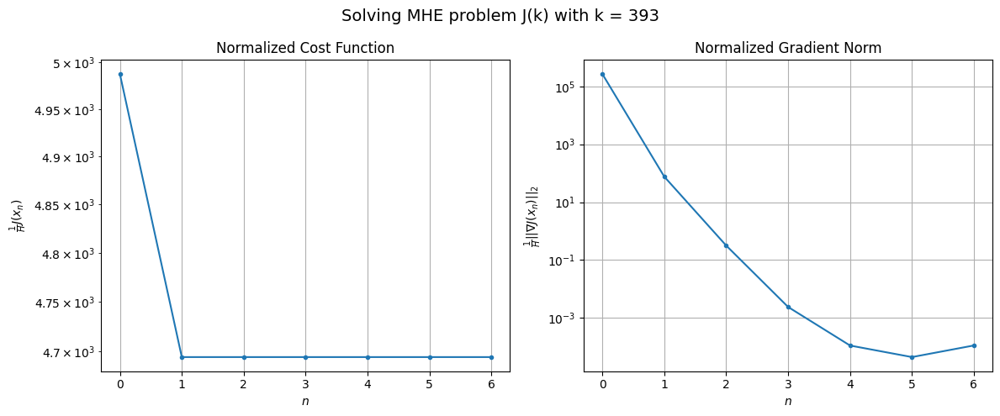

Windows: 100%|█████████▉| 365/366 [39:46<00:09,  9.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 169828.4016387348
Gradient norm: 8736735.64584431
Global estimation error: 87.18677150977717
Initial conditions estimation errors: 12.498019573187293 m, 22.763594373688314 m, 61.0846670290148 m, 56.531365065175606 m
Position estimation errors: 28.527165280204322 m, 21.267862930516223 m, 75.29364786071764 m, 21.297570775471513 m

[Gauss-Newton] Iteration 1
Cost function: 159842.83672498024 (-5.88%)
Gradient norm: 8861.934346061385 (-99.90%)
Global estimation error: 45.27237052923787 (-48.07%)
Initial conditions estimation errors: 16.186624324144955 m, 11.716289542851106 m, 29.841856215909324 m, 27.563801629713733 m
Position estimation errors: 23.695838363730374 m, 29.51291338631836 m, 38.394274966510544 m, 46.75225805345728 m

[Gauss-Newton] Iteration 2
Cost function: 159842.45800524965 (-0.00%)
Gradient norm: 6.583200644549952 (-99.93%)
Global estimation error: 47.05172786982023 (3.93%)
Initial conditions estimation errors: 16

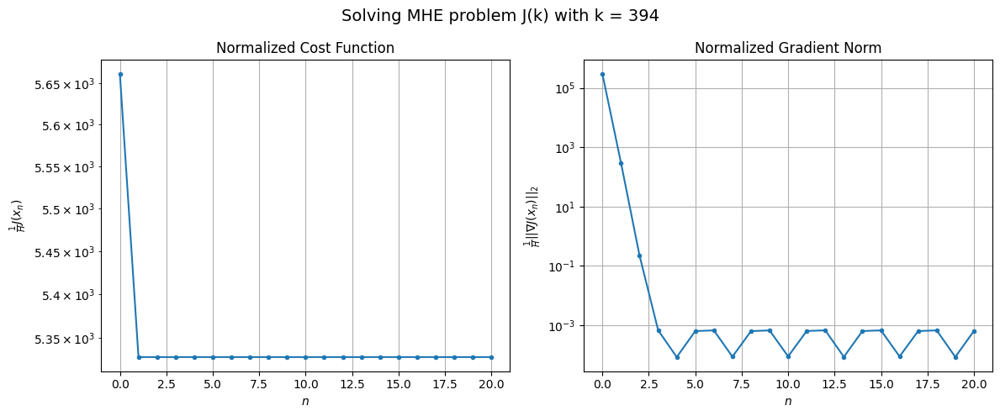

This Monte Carlo run RMSE for 366 timestamps:
RMSE_1 = 19.38478802284501
RMSE_2 = 27.797457148810356
RMSE_3 = 31.478978581358447
RMSE_4 = 61.45599563075227
CentralizedNewton applied to J(H - 1) converged with [] iterations.
CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with nan iterations on average.


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [7]:
first_round_stop_iteration = []
K_minus_H_next_rounds_stop_iteration = []

# Cold-start
x_init = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))

# Apply the algorithm
X_est = np.zeros((n, 1, K))
for k in tqdm(range(H - 1, K), desc="Windows", leave=False):
    centralized_newton.cost_values, centralized_newton.gradient_norm_values = [], []
    x_init, x_est = centralized_newton.solve_MHE_problem(k, dt, Y, x_init, X_true[:, :, k - H + 1],  X_true[:, :, k])
    X_est[:, :, k] = x_est
    
    plots(k, centralized_newton)

    # Warm-start
    x_init = dyn.f(dt, x_init)

# After each Monte Carlo Run compute the RMSE_m for each K - H + 1 timestamps
position_estimation_error_1, position_estimation_error_2, position_estimation_error_3, position_estimation_error_4 = [], [], [], []
for k in range(H - 1, K):
    position_estimation_error_1.append(np.linalg.norm(X_est[:n_p, :, k] - X_true[:n_p, :, k]))
    position_estimation_error_2.append(np.linalg.norm(X_est[n_x:n_x + n_p, :, k] - X_true[n_x:n_x + n_p, :, k]))
    position_estimation_error_3.append(np.linalg.norm(X_est[2*n_x:2*n_x + n_p, :, k] - X_true[2*n_x:2*n_x + n_p, :, k]))
    position_estimation_error_4.append(np.linalg.norm(X_est[3*n_x:3*n_x + n_p, :, k] - X_true[3*n_x:3*n_x + n_p, :, k]))
rmse_1 = np.sqrt(np.mean(np.array(position_estimation_error_1) ** 2))
rmse_2 = np.sqrt(np.mean(np.array(position_estimation_error_2) ** 2))
rmse_3 = np.sqrt(np.mean(np.array(position_estimation_error_3) ** 2))
rmse_4 = np.sqrt(np.mean(np.array(position_estimation_error_4) ** 2))
print(f'This Monte Carlo run RMSE for {K - H + 1} timestamps:')
print(f'RMSE_1 = {np.mean(rmse_1)}\nRMSE_2 = {np.mean(rmse_2)}\nRMSE_3 = {np.mean(rmse_3)}\nRMSE_4 = {np.mean(rmse_4)}')
print(f'CentralizedNewton applied to J(H - 1) converged with {first_round_stop_iteration} iterations.')
print(f'CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with {np.mean(K_minus_H_next_rounds_stop_iteration)} iterations on average.')

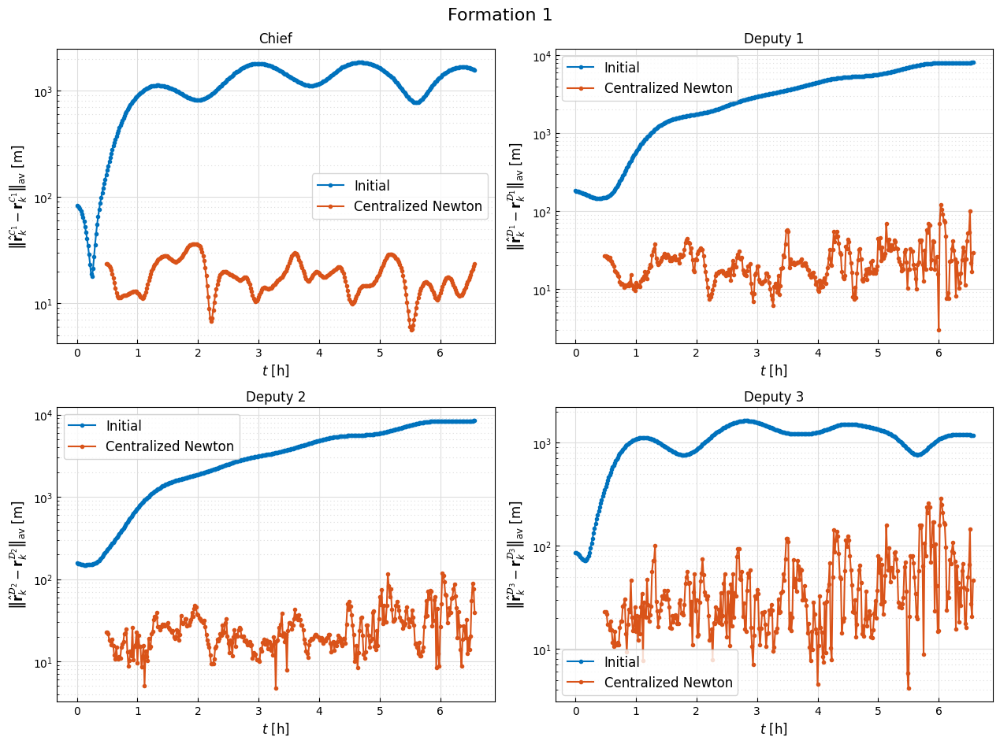

In [8]:
# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, K) / dt
algorithm = "Centralized Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, position_estimation_error_1_initial, ".-", label="Initial")
axs[0, 0].plot(time[H - 1:], position_estimation_error_1, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, position_estimation_error_2_initial, ".-", label="Initial")
axs[0, 1].plot(time[H - 1:], position_estimation_error_2, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, position_estimation_error_3_initial, ".-", label="Initial")
axs[1, 0].plot(time[H - 1:], position_estimation_error_3, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, position_estimation_error_4_initial, ".-", label="Initial")
axs[1, 1].plot(time[H - 1:], position_estimation_error_4, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [9]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["H"] = H
data["true"] = X_true
data[0] = X_est

# Save to pickle file
with open(f'gauss_newton_H{H}_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl', "wb") as file:
    pickle.dump(data, file)